<a href="https://colab.research.google.com/github/prashantkumaromar/news_based_stock_analyzer/blob/master/Stock_Jump_identify_moment_strategy.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#importing the required libraries

import pandas
from pandas_datareader import data as pdr
import yfinance as yf
import datetime
from datetime import date, timedelta

:## Jumps With threshold of 20% ------  833 stocks found with 20% jump

---



```
# This is formatted as code
```\





```
# This is formatted as code
```

##Fetching the data and dumping it to pickle file.


*   Data -  dict data = {tickers: all data of that ticker like open close.. all columns}   
*   jump_stocks: list of stocks with jump on Threshould 20% --- ticker, i, prices.iloc[i], prices.iloc[i-1], (prices.iloc[i] - prices.iloc[i-1]) / prices.iloc[i-1]))
* identify_jump_stocks : returns jump_stocks, data
* data.pickle:  with open('data.pkl', 'wb') as file: pickle.dump(data, file)



In [ ]:
import yfinance as yf
import numpy as np
import matplotlib.pyplot as plt

def identify_jump_stocks(tickers, start_date, end_date, threshold=0.2):
    jump_stocks = []
    data = {}

    for ticker in tickers:
        try:
            # Fetching data from Yahoo Finance
            data[ticker] = yf.download(ticker, start=start_date, end=end_date)
            prices = data[ticker]['Close']

            # Calculate mean and standard deviation
            mean = np.mean(prices)
            std = np.std(prices)

            # Identify jumps based on the criteria
            for i in range(1, len(prices)):
                if prices.iloc[i] > (1 + threshold) * mean and (prices.iloc[i] - prices.iloc[i-1]) / prices.iloc[i-1] > threshold:
                    jump_stocks.append((ticker, i, prices.iloc[i], prices.iloc[i-1], (prices.iloc[i] - prices.iloc[i-1]) / prices.iloc[i-1]))
                    break  # Exit loop after identifying the first jump
        except Exception as e:
            # print(f"Failed to download data for {ticker}. Skipping... Error: {e}")
            continue

    return jump_stocks, data

def plot_stock_behaviour(data, jump_stocks):
    for stock in jump_stocks[:40]:
        ticker, jump_index, jump_price, prev_price, jump_percentage = stock

        # Plotting Close price
        plt.figure(figsize=(10, 6))
        plt.plot(data[ticker]['Close'], label=ticker)
        # plt.scatter(data[ticker].index[jump_index], jump_price, color='red', label='Jump Point')
        # plt.scatter(data[ticker].index[jump_index - 1], prev_price, color='green', label='Previous Point')
        plt.title(f'Stock Price for {ticker}')
        plt.xlabel('Date')
        plt.ylabel('Close Price')
        plt.legend()
        plt.show()

def main():
    tickers = ['AACG', 'AAME', 'AAOI', 'ABEO', 'ABR', 'ABUS', 'ACER', 'ACHV', 'ACOR', 'ADXS', 'AEHR', 'AEMD', 'AGFS', 'AGMH', 'AGR', 'AGRX', 'AHPI', 'AIM', 'AKBA', 'AKTX', 'ALDX', 'ALIM', 'ALJJ', 'ALLT', 'ALNA', 'ALRN', 'ALT', 'AMPE', 'AMRS', 'AMTX', 'ANIX', 'AQB', 'AQST', 'ARAY', 'ARDS', 'ARDX', 'ARTL', 'ASLN', 'ASMB', 'ASTC', 'ATHE', 'ATNM', 'ATRA', 'ATXI', 'AUTL', 'AVCO', 'AVDL', 'AVGR', 'AVID', 'AVXL', 'AXAS', 'AXDX', 'AXGN', 'AXLA', 'AXNX', 'AYRO', 'AYTU', 'AZRX', 'BAND', 'BBI', 'BBQ', 'BBX', 'BCEL', 'BCLI', 'BCYC', 'BDR', 'BDSI', 'BGI', 'BHTG', 'BIMI', 'BIOC', 'BLCM', 'BLRX', 'BNGO', 'BNR', 'BOXL', 'BRN', 'BRQS', 'BTAI', 'BTE', 'BVS', 'BWAY', 'BXC', 'BXRX', 'BYSI', 'CAAS', 'CABA', 'CADC', 'CAI', 'CANF', 'CAPR', 'CARV', 'CASA', 'CASH', 'CATB', 'CBLI', 'CCLP', 'CCNC', 'CCXI', 'CDAK', 'CDTX', 'CEMI', 'CERC', 'CETX', 'CFB', 'CFRX', 'CGA', 'CHCI', 'CHFS', 'CHMA', 'CHNR', 'CHPM', 'CHRA', 'CHRS', 'CIDM', 'CIO', 'CIR', 'CIT', 'CLAR', 'CLDT', 'CLFD', 'CLIR', 'CLMT', 'CLNE', 'CLPR', 'CLRB', 'CLRO', 'CLSD', 'CLSK', 'CLSN', 'CLVS', 'CLWT', 'CMCM', 'CMLF', 'CMRX', 'CNCE', 'CNCN', 'CNFR', 'CNET', 'CNMD', 'CNOA', 'CNR', 'CNSL', 'CNSP', 'CNST', 'CNXN', 'COCP', 'CODA', 'CODX', 'COFS', 'COLL', 'COMT', 'CONN', 'COOP', 'COPX', 'CORR', 'CORT', 'COUP', 'CPAH', 'CPST', 'CPTA', 'CREG', 'CREX', 'CRIS', 'CRKN', 'CRMD', 'CRMT', 'CRNT', 'CRON', 'CROX', 'CRRS', 'CRSR', 'CRTD', 'CRVS', 'CRWD', 'CRWS', 'CSCW', 'CSGP', 'CSII', 'CSPI', 'CSSE', 'CSTE', 'CSTL', 'CSU', 'CSV', 'CTG', 'CTHR', 'CTIB', 'CTIC', 'CTMX', 'CTRE', 'CTRM', 'CTSO', 'CUE', 'CUR', 'CVBF', 'CVGI', 'CVGW', 'CVLT', 'CVLY', 'CVR', 'CVU', 'CWBR', 'CWCO', 'CWEN', 'CWST', 'CXDC', 'CYAD', 'CYAN', 'CYBE', 'CYCC', 'CYCN', 'CYH', 'CYRN', 'CYRX', 'CYTK', 'CZNC', 'CZR', 'DAIO', 'DALN', 'DARE', 'DAVE', 'DBI', 'DCOM', 'DCPH', 'DCTH', 'DDD', 'DDIV', 'DECK', 'DERM', 'DFFN', 'DGICA', 'DGII', 'DGLY', 'DHIL', 'DHR', 'DHT', 'DIOD', 'DISH', 'DIT', 'DJCO', 'DK', 'DLHC', 'DLLR', 'DLPN', 'DLTH', 'DLTR', 'DLX', 'DMLP', 'DMTK', 'DNLI', 'DNN', 'DOCU', 'DOMO', 'DOOO', 'DORM', 'DOV', 'DOX', 'DPW', 'DRAD', 'DRRX', 'DSGX', 'DSPG', 'DSSI', 'DSTL', 'DSX', 'DTEA', 'DTIL', 'DUK', 'DVAX', 'DVD', 'DVN', 'DXCM', 'DXF', 'DXLG', 'DXPE', 'DYAI', 'DYN', 'DYNT', 'EAF', 'EARN', 'EAST', 'EAT', 'EBIX', 'EBS', 'ECHO', 'ECL', 'ECOL', 'ECOM', 'ECOR', 'ECPG', 'ECYT', 'EDAP', 'EDIT', 'EDNT', 'EDRY', 'EDUC', 'EEFT', 'EEX', 'EFOI', 'EGBN', 'EGLE', 'EGO', 'EGP', 'EGRX', 'EGY', 'EHTH', 'EIGI', 'EIGR', 'EKSO', 'ELAN', 'ELD', 'ELF', 'ELLO', 'ELOX', 'ELSE', 'ELY', 'EMAN', 'EMKR', 'EML', 'EMN', 'EMR', 'ENB', 'ENBL', 'ENDP', 'ENG', 'ENIC', 'ENLC', 'ENLV', 'ENOB', 'ENPH', 'ENS', 'ENSV', 'ENTG', 'ENTX', 'ENV', 'ENVA', 'ENZ', 'EOLS', 'EOSE', 'EPAY', 'EPC', 'EPIX', 'EPR', 'EPSN', 'EQ', 'EQIX', 'EQNR', 'EQOS', 'EQT', 'EQX', 'ERIC', 'ERII', 'EROS', 'ESGC', 'ESGR', 'ESMT', 'ESPR', 'ESQ', 'ESSA', 'ESTC', 'ESTE', 'ETON', 'ETRN', 'ETSY', 'EURN', 'EVBG', 'EVFM', 'EVGN', 'EVH', 'EVLO', 'EVOK', 'EVOL', 'EVOP', 'EVR', 'EVRI', 'EVTC', 'EWBC', 'EXAS', 'EXEL', 'EXLS', 'EXN', 'EXPI', 'EXPO', 'EXPR', 'EXTR', 'EXXI', 'EYE', 'EYEG', 'EYEN', 'EYES', 'EZPW', 'FAMI', 'FANG', 'FANH', 'FARO', 'FAST', 'FATE', 'FBIO', 'FBM', 'FBMS', 'FBNC', 'FBRX', 'FCBC', 'FCCO', 'FCCY', 'FCEL', 'FCFS', 'FCLF', 'FCN', 'FCO', 'FCRD', 'FCX', 'FDBC', 'FDS', 'FDUS', 'FEIM', 'FENC', 'FENG', 'FET', 'FFBC', 'FFHL', 'FFIC', 'FFIN', 'FFLWF', 'FFWM', 'FGBI', 'FGEN', 'FHB', 'FHI', 'FHN', 'FICO', 'FIGS', 'FINV', 'FISI', 'FITB', 'FIVE', 'FIXX', 'FLDM', 'FLEX', 'FLGT', 'FLIC', 'FLIR', 'FLL', 'FLNT', 'FLOW', 'FLR', 'FLS', 'FLT', 'FLUX', 'FLY', 'FMNB', 'FMX', 'FN', 'FNB', 'FNCB', 'FNCH', 'FNHC', 'FNKO', 'FNSR', 'FOLD', 'FONR', 'FOR', 'FORD', 'FORM', 'FORR', 'FORTY', 'FOSL', 'FOXF', 'FPAY', 'FPH', 'FPX', 'FRAN', 'FRBA', 'FRBK', 'FRC', 'FRD', 'FREE', 'FRG', 'FRGI', 'FRME', 'FRPH', 'FRSX', 'FRTA', 'FRX', 'FSK', 'FSLR', 'FSLY', 'FSM', 'FSP', 'FSR', 'FSS', 'FSTR', 'FTAI', 'FTCH', 'FTEK', 'FTK', 'FTV', 'FUBO', 'FUN', 'FURY', 'FUTU', 'FUV', 'FVRR', 'FWONA', 'FWONK', 'FXNC', 'GABC', 'GAIA', 'GAIN', 'GALT', 'GAM', 'GAME', 'GAN', 'GASS', 'GATO', 'GBCI', 'GBDC', 'GBIO', 'GBL', 'GBX', 'GCI', 'GCO', 'GCP', 'GCV', 'GDEN', 'GDOT', 'GDRX', 'GECC', 'GEF', 'GEL', 'GENC', 'GENI', 'GEO', 'GEOS', 'GER', 'GERN', 'GES', 'GET', 'GEVO', 'GFF', 'GFI', 'GFN', 'GGG', 'GH', 'GHL', 'GHM', 'GHSI', 'GIIX', 'GIII', 'GILD', 'GILT', 'GIS', 'GIX', 'GJT', 'GLAD', 'GLBS', 'GLDD', 'GLDG', 'GLNG', 'GLOB', 'GLOG', 'GLOP', 'GLP', 'GLRE', 'GLT', 'GLUU', 'GLW', 'GMAB', 'GMBL', 'GMDA', 'GME', 'GMED', 'GMLP', 'GMS', 'GNE', 'GNFT', 'GNL', 'GNMA', 'GNOM', 'GNRC', 'GNSS', 'GNTX', 'GNUS', 'GO', 'GOAC', 'GOED', 'GOGO', 'GOL', 'GOLD', 'GOOD', 'GOOG', 'GOOGL', 'GORO', 'GOSS', 'GP', 'GPAQ', 'GPC', 'GPK', 'GPL', 'GPM', 'GPN', 'GPOR', 'GPS', 'GPX', 'GRA', 'GRAF', 'GRBK', 'GRC', 'GRFS', 'GRIL', 'GRIN', 'GRMN', 'GROW', 'GRPN', 'GRTS', 'GRUB', 'GRWG', 'GS', 'GSAH', 'GSAT', 'GSBC', 'GSBD', 'GSHD', 'GSL', 'GSM', 'GSMG', 'GSX', 'GT', 'GTEC', 'GTES', 'GTHX', 'GTIM', 'GTLS', 'GTS', 'GTT', 'GTX', 'GTXI', 'GTY', 'GTYH', 'GURE', 'GV', 'GVA', 'GWGH', 'GWPH', 'GWRE', 'GWW', 'GXGX', 'GXP', 'GYRO', 'GZT', 'HA', 'HAE', 'HAFC', 'HAIN', 'HAL', 'HALL', 'HALO', 'HARP', 'HAS', 'HASI', 'HAYN', 'HBAN', 'HBB', 'HBCP', 'HBHC', 'HBI', 'HBIO', 'HBMD', 'HBMN', 'HBNC', 'HBP', 'HBT', 'HCA', 'HCCI', 'HCFT', 'HCHC', 'HCI', 'HCKT', 'HCMA', 'HCSG', 'HDSN', 'HDVY', 'HEAR', 'HEBT', 'HEES', 'HEI', 'HELE', 'HELI', 'HES', 'HEXO', 'HFBL', 'HFC', 'HFFG', 'HFWA', 'HGEN', 'HGV', 'HHGC', 'HHR', 'HI', 'HIBB', 'HIFS', 'HIG', 'HIGA', 'HII', 'HIL', 'HIMS', 'HIO', 'HIW', 'HKD', 'HLF', 'HLIT', 'HLT', 'HLX', 'HMHC', 'HMN', 'HMPR', 'HMSY', 'HMTV', 'HMY', 'HNGR', 'HNI', 'HNRG', 'HOFT', 'HOLI', 'HOLX', 'HOMB', 'HOME', 'HON', 'HOOK', 'HOPE', 'HOTH', 'HP', 'HPK', 'HPP', 'HPQ', 'HPR', 'HPT', 'HQY', 'HR', 'HRB', 'HRC', 'HRZN', 'HSBC', 'HSC', 'HSDT', 'HSKA', 'HSNI', 'HST', 'HSTM', 'HSY', 'HT', 'HTA', 'HTBI', 'HTBK', 'HTBX', 'HTGC', 'HTH', 'HTHT', 'HTLD', 'HTLF', 'HUBG', 'HUBS', 'HUD', 'HUM', 'HUN', 'HURC', 'HURN', 'HUSA', 'HVT', 'HWBK', 'HWCC', 'HWKN', 'HXL', 'HY', 'HYFM', 'HYLN', 'HYMC', 'HYRE', 'HYSR', 'HYZN', 'HZNP', 'IAA', 'IAC', 'IAG', 'IART', 'IBEX', 'IBIO', 'IBM', 'IBN', 'IBP', 'ICBK', 'ICD', 'ICE', 'ICHR', 'ICL', 'ICON', 'ICPT', 'ICUI', 'IDA', 'IDCC', 'IDE', 'IDEX', 'IDN', 'IDRA', 'IDT', 'IDXX', 'IEF', 'IEP', 'IESC', 'IEX', 'IFF', 'IFLT', 'IFMK', 'IFRX', 'IFS', 'IFX', 'IGAC', 'IGC', 'IGIB', 'IGMS', 'IGT', 'IHRT', 'IIN', 'IIVI', 'IKNX', 'ILPT', 'ILMN', 'IMAB', 'IMAC', 'IMAX', 'IMBI', 'IMGN', 'IMH', 'IMKTA', 'IMMP', 'IMMR', 'IMMU', 'IMOS', 'IMPX', 'IMRN', 'IMTX', 'IMUX', 'IMV', 'IMVT', 'INBK', 'INBX', 'INCY', 'INDB', 'INDT', 'INFI', 'INFN', 'INFO', 'INFR', 'ING', 'INGN', 'INGR', 'INMD', 'INN', 'INO', 'INOD', 'INOV', 'INPX', 'INSG', 'INSM', 'INST', 'INSW', 'INT', 'INTA', 'INTC', 'INTEQ', 'INTG', 'INTU', 'INVA', 'INVE', 'INVH', 'INWK', 'INXN', 'IO', 'IONS', 'IOR', 'IOSP', 'IOTS', 'IOVA', 'IP', 'IPAR', 'IPDN', 'IPG', 'IPGP', 'IPHA', 'IPI', 'IPLDP', 'IPWR', 'IQ', 'IQV', 'IR', 'IRBT', 'IRDM', 'IRET', 'IRM', 'IRTC', 'IRTY', 'IRWD', 'ISBC', 'ISCA', 'ISDR', 'ISEE', 'ISIG', 'ISNS', 'ISR', 'ISRG', 'ISSC', 'ISTB', 'IT', 'ITCI', 'ITEX', 'ITGR', 'ITHX', 'ITI', 'ITIC', 'ITM', 'ITOS', 'ITP', 'ITRI', 'ITRN', 'ITT', 'ITUB', 'ITW', 'IVC', 'IVR', 'IVZ', 'IX', 'IXUS', 'IYR', 'J', 'JAGX', 'JAKK', 'JAMF', 'JAN', 'JAZZ', 'JBGS', 'JBL', 'JBLU', 'JBT', 'JCI', 'JCOM', 'JCP', 'JCS', 'JD', 'JDD', 'JEF', 'JELD', 'JHG', 'JILL', 'JKHY', 'JKS', 'JLL', 'JLS', 'JMIA', 'JNCE', 'JNJ', 'JNPR', 'JOB', 'JOBS', 'JOE', 'JOUT', 'JP', 'JPM', 'JPT', 'JQC', 'JRI', 'JRO', 'JRS', 'JSD', 'JSM', 'JST', 'JSYN', 'JTA', 'JTD', 'JTPY', 'JVA', 'JWN', 'JWS', 'JXN', 'K', 'KALA', 'KALU', 'KALV', 'KAMN', 'KAR', 'KB', 'KBAL', 'KBC', 'KBLM', 'KBR', 'KC', 'KDMN', 'KE', 'KEFI', 'KELYA', 'KEM', 'KEN', 'KEQU', 'KERN', 'KEX', 'KEY', 'KEYW', 'KF', 'KFFB', 'KFS', 'KFY', 'KGJI', 'KHC', 'KIDS', 'KIM', 'KIND', 'KINZ', 'KIQ', 'KIRK', 'KKR', 'KL', 'KLAC', 'KLAQ', 'KLDO', 'KLDX', 'KLR', 'KLXE', 'KMB', 'KMDA', 'KMI', 'KMPH', 'KMPR', 'KMT', 'KMTR', 'KMX', 'KN', 'KNDI', 'KNOP', 'KNSA', 'KNSL', 'KNX', 'KO', 'KODK', 'KOF', 'KOP', 'KOPN', 'KOS', 'KPTI', 'KRA', 'KRBP', 'KRC', 'KREF', 'KRG', 'KRMD', 'KRN', 'KRNT', 'KRO', 'KRON', 'KRP', 'KRYS', 'KSMT', 'KSS', 'KSU', 'KT', 'KTCC', 'KTF', 'KTOS', 'KTRA', 'KUKE', 'KURA', 'KVHI', 'KW', 'KWEB', 'KWR', 'KXIN', 'KYMR', 'KYN', 'L', 'LABP', 'LAC', 'LAD', 'LAIX', 'LAKE', 'LAMR', 'LAND', 'LARK', 'LASR', 'LAUR', 'LAWS', 'LAX', 'LBAI', 'LBC', 'LBRT', 'LC', 'LCA', 'LCI', 'LCID', 'LCII', 'LCTX', 'LCUT', 'LCY', 'LDOS', 'LE', 'LEA', 'LEAF', 'LEAP', 'LEDS', 'LEE', 'LEG', 'LEGH', 'LEGN', 'LEJU', 'LENS', 'LEU', 'LEVI', 'LEXX', 'LFC', 'LFLY', 'LFMD', 'LFT', 'LFUS', 'LFVN', 'LGAC', 'LGHL', 'LGIH', 'LGND', 'LGO', 'LHC', 'LHCG', 'LHX', 'LI', 'LIBY', 'LIFE', 'LILA', 'LILAK', 'LINC', 'LIND', 'LIQT', 'LITB', 'LIVE', 'LIVN', 'LIVX', 'LIXT', 'LIZI', 'LJPC', 'LKCO', 'LKFN', 'LKQ', 'LL', 'LLEX', 'LLIT', 'LLL', 'LLNW', 'LLY', 'LMAT', 'LMB', 'LMFA', 'LMND', 'LMNL', 'LMPX', 'LMRK', 'LMST', 'LMT', 'LNC', 'LNDC', 'LNG', 'LNN', 'LNSR', 'LOB', 'LOCO', 'LODE', 'LOGC', 'LOGI', 'LOGM', 'LOMA', 'LOOP', 'LOPE', 'LORL', 'LOTZ', 'LOVE', 'LOW', 'LPG', 'LPI', 'LPL', 'LPLA', 'LPRO', 'LPSN', 'LPTH', 'LPTX', 'LPX', 'LQDA', 'LQDT', 'LRMR', 'LSCC', 'LSI', 'LSPD', 'LSTR', 'LSYN', 'LTBR', 'LTC', 'LTH', 'LTHM', 'LTRN', 'LTRPA', 'LTRX', 'LUB', 'LULU', 'LUMN', 'LUNA', 'LUNG', 'LUV', 'LUXA', 'LVGO', 'LVS', 'LW', 'LWAC', 'LX', 'LXFR', 'LXRX', 'LXU', 'LYB', 'LYFT', 'LYRA', 'LYTS', 'LYV', 'LZB', 'M', 'MA', 'MAAC', 'MAC', 'MACK', 'MACU', 'MADI', 'MAG', 'MAGS', 'MAIN', 'MAN', 'MANH', 'MANT', 'MAR', 'MARA', 'MARK', 'MARPS', 'MASI', 'MASS', 'MAT', 'MATW', 'MATX', 'MAX', 'MAXN', 'MAXR', 'MAYS', 'MBCN', 'MBII', 'MBIN', 'MBIO', 'MBOT', 'MBRX', 'MC', 'MCAD', 'MCB', 'MCF', 'MCFT', 'MCHP', 'MCHX', 'MCK', 'MCMJ', 'MCN', 'MCO', 'MCRB', 'MCRI', 'MCS', 'MCV', 'MCY', 'MD', 'MDCA', 'MDCO', 'MDGL', 'MDGS', 'MDIA', 'MDJH', 'MDLZ', 'MDNA', 'MDP', 'MDRR', 'MDRX', 'MDSO', 'MDT', 'MDU', 'MDVL', 'MDWD', 'MDXG', 'ME', 'MEAC', 'MEAT', 'MEC', 'MED', 'MEDP', 'MEG', 'MEI', 'MEIP', 'MELI', 'MENB', 'MEOH', 'MERC', 'MESA', 'MESO', 'MET', 'METC', 'METX', 'MFA', 'MFC', 'MFG', 'MFGP', 'MFH', 'MFIN', 'MFLX', 'MG', 'MGA', 'MGEE', 'MGI', 'MGLN', 'MGNX', 'MGP', 'MGPI', 'MGRC', 'MGTA', 'MGTX', 'MGU', 'MGY', 'MHD', 'MHK', 'MHLD', 'MHN', 'MHNC', 'MHO', 'MHR', 'MHS', 'MHTX', 'MIC', 'MICT', 'MID', 'MIDD', 'MIE', 'MIK', 'MILN', 'MIME', 'MIN', 'MIND', 'MINM', 'MIRM', 'MIST', 'MIT', 'MITC', 'MITK', 'MITO', 'MITT', 'MIXT', 'MKC', 'MKD', 'MKFG', 'MKL', 'MKSI', 'MKTX', 'ML', 'MLAB', 'MLAC', 'MLCO', 'MLI', 'MLM', 'MLND', 'MLP', 'MLR', 'MLS', 'MLSS', 'MLVF', 'MMAC', 'MMAQ', 'MMC', 'MMEN', 'MMI', 'MMLP', 'MMM', 'MMMB', 'MMS', 'MMSI', 'MMT', 'MMU', 'MMX', 'MN', 'MNDO', 'MNOV', 'MNPR', 'MNR', 'MNRL', 'MNRO', 'MNSB', 'MNSO', 'MNTK', 'MNTX', 'MO', 'MOD', 'MODN', 'MOFG', 'MOGO', 'MOH', 'MOHO', 'MOMO', 'MON', 'MOR', 'MORF', 'MOS', 'MOSY', 'MOTS', 'MOV', 'MOVE', 'MP', 'MPAA', 'MPB', 'MPC', 'MPEL', 'MPW', 'MPWR', 'MPX', 'MQ', 'MRAI', 'MRAM', 'MRBK', 'MRC', 'MRCY', 'MREO', 'MRIN', 'MRK', 'MRKR', 'MRLN', 'MRNA', 'MRNS', 'MRO', 'MRSN', 'MRTN', 'MRTX', 'MRUS', 'MRVI', 'MRVL', 'MS', 'MSA', 'MSB', 'MSBI', 'MSBHF', 'MSCI', 'MSD', 'MSEX', 'MSFT', 'MSGE', 'MSGN', 'MSL', 'MSON', 'MSP', 'MSTB', 'MSVB', 'MT', 'MTB', 'MTC', 'MTCH', 'MTCN', 'MTD', 'MTEK', 'MTEM', 'MTEX', 'MTG', 'MTH', 'MTLS', 'MTLX', 'MTN', 'MTNB', 'MTO', 'MTP', 'MTR', 'MTRN', 'MTSI', 'MTW', 'MTX', 'MTZ', 'MU', 'MUA', 'MUC', 'MUDS', 'MUE', 'MUFG', 'MUH', 'MUI', 'MUNI', 'MUR', 'MUSA', 'MUX', 'MVC', 'MVF', 'MVIS', 'MVL', 'MVO', 'MVST', 'MVV', 'MWK', 'MX', 'MXC', 'MXE', 'MXIM', 'MXL', 'MYE', 'MYFW', 'MYGN', 'MYI', 'MYL', 'MYO', 'MYOV', 'MYSZ', 'MYT', 'MYY', 'MZA', 'MZOR', 'NAB', 'NAC', 'NAD', 'NAK', 'NAKD', 'NANO', 'NAP', 'NARI', 'NASB', 'NAT', 'NATI', 'NATR', 'NAV', 'NAVB', 'NAVI', 'NBEV', 'NBHC', 'NBIX', 'NBLX', 'NBN', 'NBR', 'NBRV', 'NBSE', 'NBTB', 'NBY', 'NC', 'NCA', 'NCLH', 'NCMI', 'NCNA', 'NCR', 'NCSM', 'NCTY', 'NCZ', 'NDAQ', 'NDLS', 'NDSN', 'NE', 'NEA', 'NEBC', 'NECB', 'NEE', 'NEGG', 'NEM', 'NEO', 'NEOG', 'NEON', 'NEP', 'NERV', 'NES', 'NEST', 'NET', 'NEU', 'NEW', 'NEWA', 'NEWP', 'NEWS', 'NEX', 'NEXA', 'NEXI', 'NEXT', 'NFBK', 'NFLX', 'NFP', 'NFRX', 'NFSB', 'NG', 'NGA', 'NGAC', 'NGD', 'NGE', 'NGL', 'NGM', 'NGMS', 'NGX', 'NGVC', 'NGVT', 'NH', 'NHC', 'NHI', 'NHIC', 'NHTC', 'NICE', 'NICK', 'NID', 'NIE', 'NIM', 'NIO', 'NISN', 'NJR', 'NKE', 'NKLA', 'NKR', 'NLOK', 'NLS', 'NLSN', 'NLY', 'NM', 'NMC', 'NMFC', 'NMI', 'NMIH', 'NML', 'NMM', 'NMR', 'NMRD', 'NMRK', 'NMS', 'NMT', 'NMTR', 'NNA', 'NNBR', 'NNDM', 'NNI', 'NNK', 'NNN', 'NNOX', 'NNP', 'NNRX', 'NNS', 'NNT', 'NNV', 'NNY', 'NOA', 'NOAH', 'NOC', 'NODK', 'NOG', 'NOGN', 'NOI', 'NOK', 'NOM', 'NOMD', 'NOV', 'NOVA', 'NOVN', 'NOW', 'NP', 'NPCE', 'NPCI', 'NPK', 'NPO', 'NPTN', 'NPV', 'NQ', 'NQP', 'NR', 'NRF', 'NRIM', 'NRIX', 'NRP', 'NRT', 'NRZ', 'NSA', 'NSC', 'NSEC', 'NSIT', 'NSL', 'NSP', 'NSPR', 'NSR', 'NSS', 'NSSC', 'NSTB', 'NSTC', 'NTC', 'NTEC', 'NTEST', 'NTFX', 'NTG', 'NTH', 'NTLA', 'NTP', 'NTR', 'NTRA', 'NTRS', 'NTRSO', 'NTS', 'NTUS', 'NTWK', 'NTX', 'NUC', 'NUE', 'NURO', 'NUS', 'NUTX', 'NUVA', 'NUZE', 'NVAX', 'NVCR', 'NVDA', 'NVEC', 'NVEE', 'NVFY', 'NVG', 'NVGS', 'NVIV', 'NVLN', 'NVMI', 'NVNO', 'NVO', 'NVR', 'NVRO', 'NVS', 'NVST', 'NVT', 'NVTA', 'NVVE', 'NWBI', 'NWBO', 'NWG', 'NWL', 'NWN', 'NWPX', 'NWS', 'NWSA', 'NX', 'NXE', 'NXGN', 'NXPI', 'NXRT', 'NXST', 'NXTD', 'NXTG', 'NXTM', 'NXTY', 'NYCB', 'NYMT', 'NYMX', 'NYSE', 'NYT', 'NYX', 'NZF', 'O', 'OAS', 'OBCI', 'OBEL', 'OBLG', 'OBNK', 'OBOR', 'OBT', 'OC', 'OCFC', 'OCGN', 'OCN', 'OCSI', 'OCDX', 'OCT', 'OCUL', 'OCUP', 'OCX', 'ODC', 'ODFL', 'ODT', 'OEC', 'OEG', 'OEL', 'OEM', 'OESX', 'OFC', 'OFED', 'OFG', 'OFIX', 'OFLX', 'OGE', 'OGEN', 'OGI', 'OGS', 'OGZPY', 'OHAI', 'OHI', 'OI', 'OII', 'OIS', 'OKE', 'OKTA', 'OLB', 'OLCF', 'OLD', 'OLED', 'OLLI', 'OLN', 'OLO', 'OLMA', 'OLP', 'OLPX', 'OM', 'OMAB', 'OMCL', 'OMED', 'OMER', 'OMEX', 'OMFG', 'OMI', 'OMP', 'ON', 'ONB', 'ONCS', 'ONCT', 'ONCY', 'ONDK', 'ONEM', 'ONEQ', 'ONG', 'ONL', 'ONLN', 'ONON', 'ONOV', 'ONT', 'ONTO', 'ONTX', 'ONVO', 'ONYX', 'OOMA', 'OP', 'OPAL', 'OPBK', 'OPCH', 'OPGN', 'OPI', 'OPIN', 'OPK', 'OPM', 'OPNT', 'OPOF', 'OPP', 'OPS', 'OPT', 'OPTN', 'OPTT', 'OPY', 'OQAL', 'OR', 'ORA', 'ORBC', 'ORCC', 'ORCL', 'ORGO', 'ORGS', 'ORI', 'ORIA', 'ORIC', 'ORLY', 'ORM', 'ORMP', 'ORN', 'OROV', 'ORPH', 'ORRF', 'ORTX', 'OSBC', 'OSIS', 'OSL', 'OSM', 'OSMT', 'OSPN', 'OSUR', 'OSW', 'OTA', 'OTD', 'OTEX', 'OTIC', 'OTIS', 'OTLK', 'OTLY', 'OTM', 'OTRK', 'OTTR', 'OTTW', 'OUT', 'OVID', 'OVLY', 'OVV', 'OXBR', 'OXLCO', 'OXM', 'OXPS', 'OXSQ', 'OXY', 'OYST', 'OZK', 'OZON', 'PAA', 'PAC', 'PACB', 'PACE', 'PACK', 'PACW', 'PAG', 'PAGP', 'PAGS', 'PAHC', 'PAIC', 'PAID', 'PAM', 'PANL', 'PANW', 'PAR', 'PARA', 'PARD', 'PARR', 'PASG', 'PATH', 'PATI', 'PATK', 'PAVM', 'PAY', 'PAYA', 'PAYC', 'PAYO', 'PAYS', 'PB', 'PBA', 'PBB', 'PBBI', 'PBCT', 'PBCY', 'PBF', 'PBFS', 'PBFX', 'PBH', 'PBI', 'PBLA', 'PBPB', 'PBR', 'PBS', 'PBT', 'PBTS', 'PBYI', 'PCAR', 'PCB', 'PCC', 'PCEF', 'PCH', 'PCI', 'PCK', 'PCLN', 'PCM', 'PCN', 'PCOM', 'PCQ', 'PCR', 'PCSA', 'PCRX', 'PCS', 'PCT', 'PCTI', 'PCTY', 'PCY', 'PCYG', 'PCYO', 'PD', 'PDCE', 'PDCO', 'PDFS', 'PDI', 'PDLI', 'PDM', 'PDN', 'PDP', 'PDS', 'PDSB', 'PDT', 'PE', 'PEAK', 'PEB', 'PEBO', 'PECO', 'PED', 'PEGA', 'PEI', 'PEN', 'PENN', 'PEO', 'PEOP', 'PEP', 'PERI', 'PESI', 'PETQ', 'PETS', 'PETZ', 'PFBC', 'PFC', 'PFDR', 'PFE', 'PFG', 'PFGC', 'PFHD', 'PFIE', 'PFIU', 'PFMT', 'PFNX', 'PFO', 'PFS', 'PFSI', 'PFSW', 'PFTA', 'PFX', 'PG', 'PGC', 'PGEM', 'PGEN', 'PGNY', 'PGR', 'PGRE', 'PGTI', 'PH', 'PHAR', 'PHAS', 'PHAT', 'PHCF', 'PHD', 'PHG', 'PHGE', 'PHI', 'PHIC', 'PHK', 'PHM', 'PHO', 'PHR', 'PHT', 'PHY', 'PHX', 'PIAI', 'PICO', 'PIE', 'PII', 'PIKE', 'PIL', 'PIM', 'PINE', 'PING', 'PINS', 'PIOP', 'PIP', 'PIPR', 'PIRS', 'PIS', 'PIT', 'PIVOT', 'PIXY', 'PJC', 'PJP', 'PJT', 'PK', 'PKBK', 'PKD', 'PKG', 'PKI', 'PKO', 'PKOH', 'PKX', 'PL', 'PLAB', 'PLACE', 'PLBC', 'PLBY', 'PLCE', 'PLD', 'PLG', 'PLIN', 'PLL', 'PLM', 'PLMI', 'PLMR', 'PLNT', 'PLOW', 'PLPC', 'PLS', 'PLSE', 'PLTK', 'PLTR', 'PLUG', 'PLUS', 'PLX', 'PLXP', 'PLYA', 'PM', 'PMBC', 'PMD', 'PME', 'PMF', 'PMGM', 'PMI', 'PMO', 'PMP', 'PMS', 'PMT', 'PMVP', 'PNBK', 'PNC', 'PNFP', 'PNG', 'PNI', 'PNM', 'PNNT', 'PNR', 'PNRG', 'PNT', 'PNTG', 'PNW', 'POAI', 'PODD', 'POET', 'POL', 'POLA', 'POLE', 'POLL', 'POLY', 'POM', 'POND', 'POOL', 'POR', 'PORT', 'POSH', 'POST', 'POW', 'POWI', 'POWL', 'POWR', 'POWW', 'PPBI', 'PPC', 'PPD', 'PPDI', 'PPG', 'PPH', 'PPHM', 'PPL', 'PPMC', 'PPMH', 'PPP', 'PPPW', 'PPR', 'PPSI', 'PPT', 'PPX', 'PQG', 'PRA', 'PRAA', 'PRAH', 'PRAX', 'PRCH', 'PRCY', 'PRE', 'PRED', 'PREF', 'PREK', 'PREP', 'PRF', 'PRFT', 'PRFX', 'PRGO', 'PRGS', 'PRH', 'PRI', 'PRIM', 'PRK', 'PRKR', 'PRM', 'PRMW', 'PRN', 'PRNB', 'PRO', 'PROG', 'PROS', 'PROT', 'PROV', 'PRPH', 'PRPL', 'PRPO', 'PRQR', 'PRS', 'PRSC', 'PRSP', 'PRST', 'PRT', 'PRTA', 'PRTC', 'PRTH', 'PRTK', 'PRTS', 'PRTY', 'PRU', 'PRVB', 'PRVL', 'PS', 'PSA', 'PSAC', 'PSB', 'PSEC', 'PSHG', 'PSI', 'PSIX', 'PSMT', 'PSN', 'PSNL', 'PSO', 'PSP', 'PSQ', 'PSR', 'PSTG', 'PSTH', 'PSTI', 'PSTL', 'PSTV', 'PSX', 'PT', 'PTC', 'PTCT', 'PTD', 'PTE', 'PTEK', 'PTEN', 'PTGX', 'PTI', 'PTIC', 'PTIE', 'PTIX', 'PTMN', 'PTN', 'PTNR', 'PTON', 'PTR', 'PTSI', 'PTV', 'PTVE', 'PTX', 'PTY', 'PUB', 'PUK', 'PULM', 'PUMP', 'PURE', 'PUYI', 'PV', 'PVAC', 'PVAL', 'PVB', 'PVC', 'PVCT', 'PVG', 'PVH', 'PVI', 'PVL', 'PVR', 'PVTL', 'PW', 'PWB', 'PWFL', 'PWR', 'PWRD', 'PWSC', 'PWT', 'PX', 'PXD', 'PXE', 'PXF', 'PXG', 'PXH', 'PXI', 'PXJ', 'PXJR', 'PXLC', 'PXLG', 'PXLR', 'PXLS', 'PXLT', 'PXMV', 'PXQ', 'PXSG', 'PXSJ', 'PXT', 'PXU', 'PXUS', 'PXV', 'PXW', 'PY', 'PYCR', 'PYDS', 'PYPL', 'PYPD', 'PYPE', 'PYS', 'PYT', 'PYX', 'PYZ', 'PZA', 'PZC', 'PZD', 'PZE', 'PZG', 'PZN', 'PZO', 'PZQ', 'PZR', 'PZS', 'PZT', 'PZU', 'PZUS', 'PZV', 'PZW', 'PZY', 'PZZA', 'QABA', 'QADA', 'QADB', 'QAI', 'QAT', 'QBAK', 'QBIO', 'QCLN', 'QCOM', 'QCRH', 'QD', 'QDEL', 'QDYN', 'QED', 'QEFA', 'QELL', 'QEMM', 'QEP', 'QFIN', 'QFTA', 'QGEN', 'QID', 'QIWI', 'QK', 'QLGN', 'QLI', 'QLIK', 'QLTA', 'QLTY', 'QLVD', 'QLVE', 'QLYS', 'QMCO', 'QMJ', 'QMOM', 'QNST', 'QQQ', 'QQQX', 'QQXT', 'QRHC', 'QRL', 'QRM', 'QRO', 'QRT', 'QSR', 'QTNT', 'QTRX', 'QUAD', 'QUOT', 'QURE', 'QVAL', 'QVCC', 'QVCD', 'QVIG', 'QVML', 'QVMM', 'QVMV', 'QVR', 'QVT', 'QVVO', 'QWLD', 'QXGG', 'QXTR', 'QYLD', 'QYLG', 'QYLS', 'R', 'RACE', 'RAD', 'RADA', 'RADR', 'RAIL', 'RAMP', 'RAND', 'RARE', 'RAS', 'RATL', 'RAVE', 'RBA', 'RBB', 'RBBN', 'RBC', 'RBCAA', 'RBCN', 'RBKB', 'RBLX', 'RBN', 'RBNC', 'RBS', 'RBZ', 'RC', 'RCA', 'RCB', 'RCC', 'RCD', 'RCEL', 'RCF', 'RCG', 'RCHG', 'RCI', 'RCII', 'RCMT', 'RCON', 'RCP', 'RCS', 'RCT', 'RDHL', 'RDIB', 'RDI', 'RDN', 'RDNT', 'RDUS', 'RDVT', 'RDWR', 'RE', 'REAL', 'RECN', 'REDU', 'REED', 'REEM', 'REET', 'REG', 'REGI', 'REGN', 'REI', 'REK', 'RELY', 'REM', 'REMX', 'RENN', 'RENT', 'REPL', 'REPX', 'RES', 'RESI', 'RETA', 'REV', 'REVG', 'REW', 'REX', 'REXR', 'REYN', 'REZ', 'REZI', 'RF', 'RFIL', 'RFL', 'RFP', 'RGA', 'RGEN', 'RGLD', 'RGLS', 'RGNX', 'RGP', 'RGR', 'RGS', 'RGT', 'RHI', 'RHP', 'RIBT', 'RICK', 'RIDE', 'RIDL', 'RIG', 'RIGL', 'RILY', 'RING', 'RIO', 'RIOT', 'RISE', 'RIV', 'RIVN', 'RJA', 'RJF', 'RJI', 'RJN', 'RJZ', 'RKDA', 'RKT', 'RKTA', 'RL', 'RLI', 'RLOG', 'RLX', 'RMAX', 'RMBS', 'RMD', 'RMED', 'RMGB', 'RMG', 'RMNI', 'RMPL', 'RMR', 'RMS', 'RMT', 'RMTI', 'RNA', 'RNDB', 'RNET', 'RNG', 'RNGR', 'RNLX', 'RNP', 'RNR', 'RNST', 'RNW', 'ROAD', 'ROAN', 'ROBO', 'ROCK', 'ROG', 'ROIC', 'ROIV', 'ROK', 'ROKU', 'ROL', 'ROP', 'ROSE', 'ROST', 'RPAI', 'RPAY', 'RPM', 'RPRX', 'RPT', 'RPV', 'RQI', 'RRBI', 'RRC', 'RRGB', 'RRR', 'RRTS', 'RS', 'RSG', 'RSLS', 'RSP', 'RSSS', 'RST', 'RSX', 'RTIX', 'RTLR', 'RTN', 'RTP', 'RTPY', 'RTX', 'RUBY', 'RUN', 'RUSHA', 'RUSHB', 'RUTH', 'RVI', 'RVLT', 'RVMD', 'RVNC', 'RVPH', 'RVSB', 'RWLK', 'RWT', 'RXDX', 'RXN', 'RY', 'RYAAY', 'RYAM', 'RYB', 'RYCE', 'RYI', 'RYN', 'RYTM', 'RZA', 'RZB', 'S', 'SAA', 'SABR', 'SAFE', 'SAFM', 'SAFT', 'SAGE', 'SAH', 'SAIA', 'SAIC', 'SAIL', 'SAK', 'SAL', 'SALM', 'SAM', 'SAMG', 'SAN', 'SAND', 'SANM', 'SANW', 'SAP', 'SAR', 'SASR', 'SATS', 'SAVE', 'SB', 'SBA', 'SBAC', 'SBBP', 'SBCF', 'SBFG', 'SBGI', 'SBH', 'SBI', 'SBLK', 'SBOW', 'SBR', 'SBS', 'SBSI', 'SBSW', 'SBUX', 'SC', 'SCAI', 'SCCO', 'SCD', 'SCE', 'SCHE', 'SCHF', 'SCHG', 'SCHL', 'SCHN', 'SCHO', 'SCHP', 'SCHR', 'SCHV', 'SCHW', 'SCI', 'SCID', 'SCIX', 'SCL', 'SCM', 'SCOR', 'SCPH', 'SCPL', 'SCPS', 'SCR', 'SCSC', 'SCU', 'SCVL', 'SCWX', 'SCYX', 'SCZ', 'SD', 'SDC', 'SDGR', 'SDHY', 'SDOW', 'SDP', 'SDPI', 'SDS', 'SDY', 'SE', 'SEA', 'SEAC', 'SEAL', 'SEAS', 'SEB', 'SECO', 'SEDG', 'SEE', 'SEED', 'SEEL', 'SEER', 'SEF', 'SEIC', 'SELB', 'SELF', 'SEM', 'SEMG', 'SEMR', 'SEN', 'SENS', 'SEO', 'SEPZ', 'SERV', 'SES', 'SESN', 'SF', 'SFBC', 'SFB', 'SFBS', 'SFE', 'SFIX', 'SFL', 'SFM', 'SFNC', 'SFST', 'SFT', 'SFTW', 'SFX', 'SG', 'SGA', 'SGAM', 'SGB', 'SGBX', 'SGC', 'SGDJ', 'SGEN', 'SGG', 'SGH', 'SGI', 'SGMA', 'SGMO', 'SGMZ', 'SGNL', 'SGO', 'SGRP', 'SGRY', 'SGTX', 'SH', 'SHAK', 'SHBI', 'SHC', 'SHEN', 'SHG', 'SHI', 'SHIP', 'SHLS', 'SHLX', 'SHO', 'SHOP', 'SHSP', 'SHW', 'SI', 'SID', 'SIEB', 'SIEN', 'SIF', 'SIFY', 'SIG', 'SIGA', 'SIGI', 'SIGIP', 'SII', 'SIJ', 'SIL', 'SILC', 'SILK', 'SIM', 'SIMO', 'SINA', 'SINO', 'SINT', 'SINV', 'SIOX', 'SIRI', 'SITC', 'SITE', 'SIVB', 'SIX', 'SIXA', 'SJI', 'SJIU', 'SJM', 'SJNK', 'SJR', 'SJS', 'SJT', 'SJW', 'SKIN', 'SKLZ', 'SKM', 'SKT', 'SKX', 'SKY', 'SLAB', 'SLB', 'SLCA', 'SLCR', 'SLD', 'SLDB', 'SLE', 'SLF', 'SLG', 'SLGG', 'SLGN', 'SLI', 'SLM', 'SLN', 'SLP', 'SLQT', 'SLRC', 'SLS', 'SM', 'SMAR', 'SMBC', 'SMBK', 'SMC', 'SMCI', 'SMED', 'SMFG', 'SMG', 'SMHI', 'SMID', 'SMIT', 'SMLP', 'SMM', 'SMMF', 'SMN', 'SMPL', 'SMRT', 'SMSI', 'SMT', 'SMTS', 'SMWB', 'SMX', 'SNAP', 'SNBR', 'SNCR', 'SNCY', 'SNE', 'SNES', 'SNEX', 'SNFCA', 'SNGX', 'SNLN', 'SNN', 'SNP', 'SNPR', 'SNPS', 'SNR', 'SNSR', 'SNT', 'SNTG', 'SNV', 'SNX', 'SNY', 'SO', 'SOAC', 'SOFI', 'SOFO', 'SOHU', 'SOI', 'SOJC', 'SOL', 'SOLN', 'SOLY', 'SON', 'SOND', 'SONG', 'SONM', 'SONO', 'SONY', 'SOPH', 'SOR', 'SORL', 'SOVO', 'SP', 'SPB', 'SPCE', 'SPG', 'SPGI', 'SPH', 'SPHD', 'SPHQ', 'SPI', 'SPKE', 'SPLK', 'SPLP', 'SPNE', 'SPNS', 'SPOK', 'SPOX', 'SPR', 'SPRB', 'SPRQ', 'SPRO', 'SPSB', 'SPT', 'SPTN', 'SPWH', 'SPWR', 'SPXC', 'SPXL', 'SPXS', 'SPXX', 'SPY', 'SQ', 'SQBG', 'SQFT', 'SQM', 'SQQQ', 'SQZ', 'SR', 'SRAC', 'SRAX', 'SRC', 'SRCE', 'SRCL', 'SRDX', 'SRE', 'SREV', 'SRG', 'SRGA', 'SRNE', 'SRRK', 'SRS', 'SRT', 'SRTS', 'SRV', 'SRVR', 'SRYB', 'SSBI', 'SSBK', 'SSC', 'SSD', 'SSE', 'SSI', 'SSL', 'SSMX', 'SSNC', 'SSNT', 'SSP', 'SSPK', 'SSRM', 'SSTI', 'SSTK', 'SSTR', 'SSY', 'SSYS', 'ST', 'STAA', 'STAG', 'STAR', 'STAY', 'STBA', 'STC', 'STCN', 'STE', 'STEP', 'STFC', 'STG', 'STIM', 'STKL', 'STKS', 'STLD', 'STM', 'STN', 'STNE', 'STNG', 'STOK', 'STON', 'STOR', 'STRA', 'STRL', 'STRM', 'STRO', 'STRS', 'STRT', 'STSA', 'STT', 'STWD', 'STX', 'STZ', 'SU', 'SUB', 'SUI', 'SUM', 'SUMO', 'SUN', 'SUNS', 'SUP', 'SUPN', 'SURF', 'SUSA', 'SUSC', 'SUSHI', 'SUSL', 'SUV', 'SUZ', 'SV', 'SVAC', 'SVBI', 'SVC', 'SVFA', 'SVFB', 'SVFD', 'SVG', 'SVI', 'SVIN', 'SVM', 'SVMK', 'SVN', 'SVO', 'SVRA', 'SVVC', 'SVXY', 'SWAV', 'SWBI', 'SWCH', 'SWI', 'SWIR', 'SWK', 'SWKS', 'SWM', 'SWN', 'SWP', 'SWTX', 'SWX', 'SXC', 'SXI', 'SXT', 'SY', 'SYBT', 'SYBX', 'SYF', 'SYK', 'SYKE', 'SYKES', 'SYNA', 'SYNC', 'SYNH', 'SYPR', 'SYS', 'SYTA', 'SYX', 'SYY', 'SZC', 'T', 'TA', 'TAC', 'TACT', 'TAE', 'TAG', 'TAGS', 'TAIL', 'TAK', 'TAL', 'TALO', 'TAN', 'TANH', 'TAOP', 'TAP', 'TARA', 'TARS', 'TASK', 'TAST', 'TAT', 'TATT', 'TAYD', 'TBBK', 'TBIO', 'TBK', 'TBLA', 'TBLT', 'TBNK', 'TBPH', 'TBRG', 'TBT', 'TBX', 'TC', 'TCBI', 'TCBK', 'TCCO', 'TCEHY', 'TCMD', 'TCOM', 'TCON', 'TCPC', 'TCPH', 'TCRR', 'TCS', 'TCX', 'TD', 'TDC', 'TDF', 'TDG', 'TDI', 'TDIV', 'TDOC', 'TDS', 'TDW', 'TDY', 'TEAF', 'TEAM', 'TECH', 'TEDU', 'TEI', 'TEKK', 'TEL', 'TELA', 'TELL', 'TEN', 'TENB', 'TENX', 'TER', 'TERN', 'TESS', 'TETC', 'TEUM', 'TEX', 'TFC', 'TFFP', 'TFI', 'TFII', 'TFLX', 'TFM', 'TFSL', 'TFX', 'TG', 'TGA', 'TGNA', 'TGP', 'TGS', 'TGT', 'TGTX', 'TH', 'THC', 'THCB', 'THG', 'THMO', 'THO', 'THR', 'THRM', 'THRX', 'THS', 'THTX', 'TIF', 'TIG', 'TIGR', 'TIL', 'TILE', 'TILT', 'TIMB', 'TINV', 'TIO', 'TIP', 'TIPT', 'TIRC', 'TISI', 'TITN', 'TIVO', 'TJX', 'TK', 'TKAT', 'TKC', 'TKR', 'TLAB', 'TLGT', 'TLK', 'TLMD', 'TLRY', 'TLS', 'TLSA', 'TLT', 'TLX', 'TM', 'TMC', 'TMHC', 'TMKR', 'TMO', 'TMP', 'TMQ', 'TMRK', 'TMS', 'TMTS', 'TMUS', 'TMX', 'TNAV', 'TNC', 'TNDM', 'TNET', 'TNK', 'TNL', 'TNP', 'TNXP', 'TOCA', 'TOD', 'TOI', 'TOK', 'TOL', 'TOMZ', 'TOPS', 'TORC', 'TOT', 'TOUR', 'TOWN', 'TPB', 'TPC', 'TPIC', 'TPL', 'TPR', 'TPRE', 'TPTX', 'TPVG', 'TPX', 'TQD', 'TQQQ', 'TR', 'TRC', 'TRCA', 'TRCH', 'TREE', 'TREX', 'TRGP', 'TRHC', 'TRI', 'TRIB', 'TRIL', 'TRIP', 'TRIT', 'TRMB', 'TRMD', 'TRMK', 'TRMT', 'TRN', 'TRNO', 'TRNS', 'TROX', 'TROW', 'TROX', 'TRP', 'TRQ', 'TRS', 'TRST', 'TRT', 'TRTN', 'TRTX', 'TRU', 'TRUE', 'TRUP', 'TRV', 'TRVG', 'TRVN', 'TRX', 'TRY', 'TRZ', 'TS', 'TSC', 'TSCO', 'TSE', 'TSEM', 'TSHA', 'TSLA', 'TSLX', 'TSM', 'TSN', 'TSP', 'TSRX', 'TSS', 'TSU', 'TT', 'TTC', 'TTCF', 'TTD', 'TTE', 'TTEC', 'TTEK', 'TTGT', 'TTI', 'TTM', 'TTMI', 'TTOO', 'TTP', 'TTPH', 'TTS', 'TTT', 'TTWO', 'TTX', 'TUP', 'TUR', 'TURN', 'TUSA', 'TV', 'TVAC', 'TVC', 'TVTX', 'TW', 'TWI', 'TWLO', 'TWNK', 'TWOU', 'TWST', 'TWTR', 'TX', 'TXG', 'TXMD', 'TXN', 'TXRH', 'TXT', 'TY', 'TYG', 'TYL', 'TYME', 'TYN', 'TYPE', 'TYR', 'TZA', 'U', 'UA', 'UAA', 'UAL', 'UAMY', 'UAN', 'UAVS', 'UBA', 'UBCP', 'UBER', 'UBFO', 'UBS', 'UBSI', 'UBT', 'UBX', 'UCBI', 'UCL', 'UCTT', 'UDOW', 'UDR', 'UE', 'UEC', 'UEIC', 'UEPS', 'UFAB', 'UFCS', 'UFI', 'UFPI', 'UFPT', 'UFS', 'UGI', 'UGP', 'UGRO', 'UHAL', 'UI', 'UIL', 'UIS', 'UK', 'UL', 'ULBI', 'ULCC', 'ULH', 'ULI', 'ULTA', 'ULTI', 'ULTR', 'UMBF', 'UMC', 'UMDD', 'UMH', 'UMPQ', 'UNAM', 'UNB', 'UNF', 'UNFI', 'UNH', 'UNI', 'UNIT', 'UNM', 'UNP', 'UNS', 'UNTY', 'UNVR', 'UONE', 'UONEK', 'UPL', 'UPLD', 'UPRO', 'UPS', 'UPST', 'UPWK', 'URA', 'URBN', 'URE', 'URI', 'UROV', 'URTH', 'USA', 'USAC', 'USAS', 'USAU', 'USB', 'USC', 'USEG', 'USFD', 'USG', 'USHY', 'USIG', 'USL', 'USM', 'USNA', 'USO', 'USPH', 'USP', 'USR', 'USSG', 'UST', 'USTB', 'USV', 'USVM', 'USWS', 'USX', 'UTG', 'UTHR', 'UTI', 'UTL', 'UTMD', 'UTP', 'UTSI', 'UTX', 'UUU', 'UUUU', 'UVSP', 'UVV', 'UVE', 'UVXY', 'UWMC', 'UXIN', 'V', 'VALE', 'VALN', 'VALU', 'VAMO', 'VAN', 'VAP', 'VAR', 'VAW', 'VB', 'VBF', 'VBIV', 'VBLT', 'VBR', 'VBTX', 'VC', 'VCEL', 'VCF', 'VCI', 'VCNX', 'VCR', 'VCSH', 'VCTR', 'VCX', 'VCYT', 'VDC', 'VDE', 'VDSI', 'VEA', 'VEC', 'VECO', 'VEDL', 'VEEV', 'VEON', 'VER', 'VERB', 'VERI', 'VERO', 'VERS', 'VET', 'VFC', 'VFF', 'VFIAX', 'VFINX', 'VFL', 'VFMF', 'VFMO', 'VFO', 'VFORX', 'VFOX', 'VFSAX', 'VFSUX', 'VFWAX', 'VFWIX', 'VG', 'VGAC', 'VGCX', 'VGI', 'VGLT', 'VGSH', 'VGT', 'VHC', 'VHI', 'VIA', 'VIAC', 'VIACA', 'VIAX', 'VIBAX', 'VICI', 'VICR', 'VIEW', 'VIG', 'VII', 'VIIIX', 'VINC', 'VINO', 'VIP', 'VIPIX', 'VIR', 'VIRI', 'VIRT', 'VIS', 'VISA', 'VISL', 'VIST', 'VITL', 'VIV', 'VIVO', 'VIX', 'VIXM', 'VIXY', 'VJET', 'VKI', 'VKQ', 'VKTX', 'VLGEA', 'VLO', 'VLRS', 'VLT', 'VLTA', 'VLY', 'VMAR', 'VMC', 'VMD', 'VMI', 'VMOT', 'VMO', 'VMS', 'VMW', 'VNCE', 'VNDA', 'VNET', 'VNO', 'VNOM', 'VNRX', 'VNT', 'VNTR', 'VOD', 'VOE', 'VOG', 'VOICE', 'VOL', 'VOLC', 'VOLTA', 'VONE', 'VOO', 'VOOG', 'VOYA', 'VPC', 'VPG', 'VPL', 'VPU', 'VPV', 'VQTS', 'VR', 'VRAY', 'VRE', 'VREX', 'VRIG', 'VRM', 'VRNA', 'VRNS', 'VRNT', 'VRO', 'VRS', 'VRSK', 'VRSN', 'VRT', 'VRTV', 'VRX', 'VSCO', 'VSEC', 'VSH', 'VSI', 'VSL', 'VSLR', 'VSM', 'VSS', 'VST', 'VSTO', 'VTA', 'VTGN', 'VTHR', 'VTI', 'VTIP', 'VTNR', 'VTR', 'VTRS', 'VTRU', 'VTV', 'VTWG', 'VTWO', 'VTYX', 'VUG', 'VUZI', 'VV', 'VVI', 'VVNT', 'VVR', 'VVV', 'VWDRF', 'VWOB', 'VWO', 'VXF', 'VXRT', 'VXUS', 'VXX', 'VYGR', 'VYM', 'VYMI', 'VZ', 'W', 'WAB', 'WABC', 'WAFD', 'WAFU', 'WAL', 'WARR', 'WASH', 'WAT', 'WATT', 'WB', 'WBA', 'WBAI', 'WBC', 'WBENC', 'WBS', 'WBT', 'WCAGY', 'WCC', 'WCG', 'WCIC', 'WCN', 'WDAY', 'WDC', 'WDFC', 'WDHR', 'WDR', 'WEC', 'WEI', 'WELL', 'WEN', 'WERN', 'WES', 'WETF', 'WEX', 'WEYS', 'WF', 'WFC', 'WFCF', 'WFH', 'WFRD', 'WGO', 'WH', 'WHD', 'WHF', 'WHG', 'WHLM', 'WHLR', 'WHR', 'WIA', 'WILC', 'WINA', 'WING', 'WINT', 'WIRE', 'WISH', 'WIT', 'WIX', 'WK', 'WKEY', 'WLFC', 'WLH', 'WLK', 'WLKP', 'WLL', 'WLTW', 'WM', 'WMB', 'WMC', 'WMG', 'WMT', 'WNC', 'WNEB', 'WNS', 'WNW', 'WOLF', 'WOOD', 'WOR', 'WORK', 'WORX', 'WOW', 'WPC', 'WPG', 'WPM', 'WPP', 'WPRT', 'WPS', 'WRAP', 'WRB', 'WRE', 'WRK', 'WRLD', 'WRN', 'WSBF', 'WSBC', 'WSC', 'WSM', 'WSO', 'WSR', 'WST', 'WSTG', 'WTBA', 'WTER', 'WTM', 'WTRE', 'WTRG', 'WTRH', 'WTS', 'WTT', 'WTTR', 'WTW', 'WU', 'WVE', 'WVFC', 'WVVI', 'WW', 'WWE', 'WWR', 'WWW', 'WY', 'WYNN', 'WYY', 'X', 'XAIR', 'XAN', 'XAR', 'XBIO', 'XBIT', 'XBIOW', 'XBKS', 'XEL', 'XELA', 'XELB', 'XENE', 'XENT', 'XERS', 'XFLT', 'XFOR', 'XGN', 'XHR', 'XIN', 'XING', 'XINN', 'XJET', 'XL', 'XLB', 'XLC', 'XLE', 'XLG', 'XLI', 'XLK', 'XLP', 'XLRN', 'XLS', 'XLU', 'XLV', 'XLY', 'XME', 'XMS', 'XMTR', 'XNCR', 'XNET', 'XOM', 'XOMA', 'XONE', 'XOXO', 'XPEL', 'XPER', 'XPEV', 'XPL', 'XPO', 'XPOA', 'XPP', 'XPRO', 'XRAY', 'XRT', 'XRX', 'XS', 'XSD', 'XSPA', 'XTL', 'XTNT', 'XUE', 'XVZ', 'XWEB', 'XXII', 'XYF', 'XYLA', 'XYL', 'Y', 'YALA', 'YANG', 'YCBD', 'YELP', 'YETI', 'YEXT', 'YGYI', 'YI', 'YIN', 'YINN', 'YLD', 'YLDE', 'YMAB', 'YMM', 'YMTX', 'YNDX', 'YOLO', 'YORW', 'YPF', 'YQ', 'YRD', 'YRL', 'YSG', 'YTEN', 'YTPG', 'YUM', 'YUMC', 'Z', 'ZAGG', 'ZBH', 'ZBRA', 'ZD', 'ZDGE', 'ZEN', 'ZEPP', 'ZEST', 'ZETA', 'ZEV', 'ZG', 'ZGNX', 'ZGYH', 'ZI', 'ZIM', 'ZION', 'ZIOP', 'ZIP', 'ZIXI', 'ZKIN', 'ZLAB', 'ZM', 'ZNGA', 'ZNH', 'ZNTL', 'ZOM', 'ZROZ', 'ZS', 'ZSAN', 'ZSL', 'ZTO', 'ZTR', 'ZTS', 'ZUMZ', 'ZUO', 'ZVO', 'ZVZZT', 'ZWZZT', 'ZXIET', 'ZYME', 'ZYNE', 'ZYXI']
    start_date = '2019-01-01'
    end_date = '2024-01-01'

    jump_stocks, data = identify_jump_stocks(tickers, start_date, end_date)
    print(f"Number of jump stocks found: {len(jump_stocks)}")
    plot_stock_behaviour(data, jump_stocks)


    import pickle

# Assuming 'data' is your DataFrame or any data structure
    with open('data.pkl', 'wb') as file:
      pickle.dump(data, file)

if __name__ == "__main__":
    main()


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3643: FutureWarning: The behavior of DataFrame.std with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return std(axis=axis, dtype=dtype, out=out, ddof=ddof, **kwargs)
[*********************100%***********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3643: FutureWarning: The behavior of DataFrame.std with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return std(axis=axis, dtype=dtype, out=out, ddof=ddof, **kwargs)
[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['RTN']: YFTzMissingError('$%ticker%: possibly delisted; no tim

Number of jump stocks found: 0


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
def plot_jump_stocks(tickers_with_jumps):
    for ticker in tickers_with_jumps[:50]:
        # Fetching data from Yahoo Finance
        data = yf.download(ticker, start="2019-01-01", end="2024-01-01")
        # Plotting Close price
        plt.figure(figsize=(10, 6))
        plt.plot(data['Close'], label=ticker)
        plt.title(f'Stock Price for {ticker}')
        plt.xlabel('Date')
        plt.ylabel('Close Price')
        plt.legend()
        plt.show()

In [ ]:
   # Current date

def get_stock_data(tickers, start_date, end_date):
    data = yf.download(tickers, start=start_date, end=end_date)
    return data
start_date = '2019-02-20'  # 5 years ago from the current date
end_date = '2024-02-20'
get_stock_data(['ACOR', 'BKYI', 'CHNR', 'DHX'], start_date, end_date)

NameError: name 'yf' is not defined



```
# This is formatted as code
```

## With threshold of 50%

In [ ]:


def identify_all_jumps_for_stock(ticker, start_date, end_date, threshold=0.2):
    jumps = []
    try:
        # Fetching data from Yahoo Finance
        data = yf.download(ticker, start=start_date, end=end_date)
        prices = data['Close']

        # Calculate mean
        mean = np.mean(prices)

        # Identify jumps based on the criteria
        for i in range(1, len(prices)):
            if prices.iloc[i] > (1 + threshold) * mean and (prices.iloc[i] - prices.iloc[i-1]) / prices.iloc[i-1] > threshold:
                jumps.append((i, prices.iloc[i], prices.iloc[i-1]))
    except Exception as e:
        print(f"Failed to download data for {ticker}. Error: {e}")

    return jumps, data

def plot_jumps_for_stock(ticker, jumps, data):
    plt.figure(figsize=(14, 7))
    plt.plot(data.index, data['Close'], label='Close Price', zorder=1)

    for jump in jumps:
        jump_index, jump_price, prev_price = jump
        plt.scatter(data.index[jump_index], jump_price, color='red', marker='^', label='Jump Point' if jump == jumps[0] else "", zorder=2)
        plt.scatter(data.index[jump_index - 1], prev_price, color='green', marker='v', label='Previous Point' if jump == jumps[0] else "", zorder=2)

    # This ensures that the legend does not repeat labels
    handles, labels = plt.gca().get_legend_handles_labels()
    by_label = dict(zip(labels, handles))
    plt.legend(by_label.values(), by_label.keys())

    plt.title(f'Stock Price and Jumps for {ticker}')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.show()

def main():
    tickers = ['ACOR', 'BKYI', 'CHNR', 'DHX', 'EDAP', 'FFHL', 'GNC', 'HUSA', 'IPI', 'JAGX',
               'KODK', 'LEDS', 'MRIN', 'NAKD', 'OBLG', 'PTE', 'QK', 'REI', 'SINO', 'TNXP', 'NAKD', 'OBLG', 'PTE', 'QK', 'REI', 'SINO', 'TNXP',
                     'UUU', 'VHC', 'WYY', 'XELB', 'YVR', 'ZN', 'AAME', 'BRN', 'CYAN', 'DSS',
                     'EDNT', 'FAMI', 'GNCA', 'HEPA', 'IMTE', 'KTRA', 'LTRN', 'MDLY', 'NVIV',
                     'OEG', 'PHUN', 'REKR', 'SINT', 'TRCH', 'UUU', 'VXRT', 'WISA', 'XELA',
                     'YVR', 'ZDGE', 'AACG', 'BRQS', 'CYCC', 'DMAC', 'EYES', 'FORK', 'GTEC',
                     'HLTH', 'INUV', 'KIRK', 'LXRX', 'MEDS', 'NNVC', 'OBLG', 'PULM', 'RETO',
                     'SNGX', 'TBLT', 'UMRX', 'VTVT', 'WWR', 'XFOR', 'YVR', 'ZSAN', 'ABEO',
                     'BBI', 'CCNC', 'DARE', 'EOLS', 'FLDM', 'GLTO', 'HEPA', 'IMMP', 'KIN',
                     'LIZI', 'MCRB', 'NK', 'OGEN', 'PLAG', 'RVP', 'SINT', 'TBLT', 'UXIN',
                     'VBLT', 'WKHS', 'XELA', 'YVR', 'ZSAN',
                     'ABR', 'BBQ', 'CRBP', 'DSSI', 'ENPH', 'FUV', 'GTX', 'HTBX', 'IIIN',
                     'JFU', 'KALA', 'LMFA', 'NLSP', 'OSMT', 'PHAS', 'QD', 'RXT', 'TCON', 'UAVS', 'VBIV', 'WTRH', 'XERS', 'YCBD', 'ZCMD','AEYE', 'BDR', 'COHN', 'DEH', 'ESE', 'FUV', 'GBR', 'HBCP', 'ICD', 'JRJC',
                          'KMPH', 'LXU', 'MDXG', 'NBY', 'OCG', 'PAYS', 'QK', 'RMED', 'SNSS', 'TTNP',
                          'URG', 'VIH', 'WRAP', 'XRF', 'YQ', 'ZCMD', 'ALIM', 'BHTG', 'CETX', 'DARE',
                          'ESEA', 'FAMI', 'GMBL', 'HUGE', 'IHT', 'JAN', 'KALA', 'LEJU', 'MCF', 'NIO',
                          'OGEN', 'PTE', 'QRHC', 'RIBT', 'SINO', 'TEDU', 'UONE', 'VHC', 'WISA', 'XELA',
                          'YCBD', 'ZSAN', 'AGMH', 'BTX', 'CRBP', 'DTSS', 'EYEG', 'FENG', 'GHSI', 'HOV',
                          'IMMP', 'JAGX', 'KLR', 'LMNL', 'MIND', 'NBRV', 'OESX', 'PDS', 'QD', 'RCON',
                          'SIFY', 'TAT', 'USEG', 'VBLT', 'WISA', 'XELA', 'YGYI', 'ZKIN', 'AMTX', 'BKYI',
                          'CBAT', 'DTEA', 'EYES', 'FAMI', 'GNUS', 'HEPA', 'IMRN', 'JAKK', 'KLXE', 'LMFA',
                          'MDGS', 'NTEC', 'OCGN', 'PLG', 'RETO', 'SELB', 'TLSA', 'UAVS', 'VKTX', 'WISA']  # Example list of stock tickers
    start_date = '2019-01-01'
    end_date = '2024-01-01'

    for ticker in tickers:
        print(f"Processing {ticker}")
        jumps, data = identify_all_jumps_for_stock(ticker, start_date, end_date)
        if jumps:  # If there are any jumps found
            plot_jumps_for_stock(ticker, jumps, data)
        else:
            print(f"No significant jumps found for {ticker}")

if __name__ == "__main__":
    main()


Processing ACOR


[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['ACOR']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')
[*********************100%***********************]  1 of 1 completed


No significant jumps found for ACOR
Processing BKYI
Failed to download data for BKYI. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for BKYI
Processing CHNR


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Failed to download data for CHNR. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for CHNR
Processing DHX
Failed to download data for DHX. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for DHX
Processing EDAP


[*********************100%***********************]  1 of 1 completed


Failed to download data for EDAP. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for EDAP
Processing FFHL


[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['FFHL']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')


No significant jumps found for FFHL
Processing GNC


[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['GNC']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')
[*********************100%***********************]  1 of 1 completed


No significant jumps found for GNC
Processing HUSA
Failed to download data for HUSA. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for HUSA
Processing IPI


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

Failed to download data for IPI. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for IPI
Processing JAGX
Failed to download data for JAGX. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for JAGX
Processing KODK



[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

Failed to download data for KODK. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for KODK
Processing LEDS
Failed to download data for LEDS. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for LEDS
Processing MRIN


Failed to download data for MRIN. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for MRIN
Processing NAKD


[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['NAKD']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')
[*********************100%***********************]  1 of 1 completed


No significant jumps found for NAKD
Processing OBLG
Failed to download data for OBLG. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for OBLG
Processing PTE


[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['PTE']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')


No significant jumps found for PTE
Processing QK


[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['QK']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')
[*********************100%***********************]  1 of 1 completed


No significant jumps found for QK
Processing REI
Failed to download data for REI. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for REI
Processing SINO


[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['SINO']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['NAKD']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['PTE']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')


No significant jumps found for SINO
Processing TNXP
Failed to download data for TNXP. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for TNXP
Processing NAKD
No significant jumps found for NAKD
Processing OBLG
Failed to download data for OBLG. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for OBLG
Processing PTE
No significant jumps found for PTE
Processing QK


[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['QK']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['SINO']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

No significant jumps found for QK
Processing REI
Failed to download data for REI. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for REI
Processing SINO
No significant jumps found for SINO
Processing TNXP
Failed to download data for TNXP. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for TNXP
Processing UUU



[*********************100%***********************]  1 of 1 completed


Failed to download data for UUU. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for UUU
Processing VHC
Failed to download data for VHC. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for VHC
Processing WYY


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Failed to download data for WYY. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for WYY
Processing XELB
Failed to download data for XELB. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for XELB
Processing YVR


[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['YVR']: YFPricesMissingError('$%ticker%: possibly delisted; no price data found  (1d 2019-01-01 -> 2024-01-01)')


No significant jumps found for YVR
Processing ZN


[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['ZN']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')
[*********************100%***********************]  1 of 1 completed


No significant jumps found for ZN
Processing AAME
Failed to download data for AAME. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for AAME
Processing BRN


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Failed to download data for BRN. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for BRN
Processing CYAN
Failed to download data for CYAN. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for CYAN
Processing DSS


[*********************100%***********************]  1 of 1 completed


Failed to download data for DSS. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for DSS
Processing EDNT


[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['EDNT']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')
[*********************100%***********************]  1 of 1 completed


No significant jumps found for EDNT
Processing FAMI
Failed to download data for FAMI. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for FAMI
Processing GNCA


[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['GNCA']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')


No significant jumps found for GNCA
Processing HEPA


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Failed to download data for HEPA. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for HEPA
Processing IMTE
Failed to download data for IMTE. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for IMTE
Processing KTRA


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Failed to download data for KTRA. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for KTRA
Processing LTRN
Failed to download data for LTRN. Error: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
No significant jumps found for LTRN
Processing MDLY


[*********************100%***********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['MDLY']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')


No significant jumps found for MDLY
Processing NVIV


KeyboardInterrupt: 

## was within 20% of its mean value before 60 days and sudenly jumped by more than 50%. and profit in selling in the day after the jump day i.e afte[link text](*https://*)r 2 days

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import random
import pickle

# Load the complete data from a pickle file
with open('data.pkl', 'rb') as file:
    all_data = pickle.load(file)

def identify_jumps_with_steadiness(data, threshold=0.4, steadiness_threshold=0.20):
    jumps = []
    prices = data['Close']

    # Identify jumps with previous 60 days steadiness condition
    for i in range(60, len(prices)):  # Starting from day 60 to ensure a 60-day window
        prev_60d_mean = prices.iloc[i-60:i].mean()
        steady = ((abs(prev_60d_prices - prev_60d_mean) / prev_60d_mean) < steadiness_threshold).all()

        if steady and (prices.iloc[i] - prices.iloc[i-1]) / prices.iloc[i-1] > threshold:
            jumps.append((i, prices.iloc[i], prices.iloc[i-1]))
    # print(f"len of jumps is {len(jumps)}")
    return jumps

def calculate_returns(data, jumps, investment_per_jump=10):
    returns_details = []
    total_investment = 0
    total_return = 0
    num_profitable = 0
    num_unprofitable = 0

    for jump in jumps:
        jump_index, jump_price, prev_price = jump
        if jump_index + 1 < len(data):  # Ensure there's data for the next day after the jump
            sell_price = data['Close'].iloc[jump_index + 1]
            buy_price = jump_price
            profit = (sell_price - buy_price) * investment_per_jump / buy_price
            total_investment += investment_per_jump
            total_return += profit
            returns_details.append((data.index[jump_index], buy_price, data.index[jump_index + 1], sell_price, profit))
            if profit > 0:
                num_profitable += 1
            else:
                num_unprofitable += 1

    return returns_details, total_investment, total_return, num_profitable, num_unprofitable

def select_random_jumps(jumps, percentage=100):
    k = max(1, int(len(jumps) * percentage / 100))
    return random.sample(jumps, k)

def main():
    tickers = list(all_data.keys())  # Get list of tickers from all_data
    total_investment = 0
    total_profit = 0
    plot_data = []
    total_trades = 0
    total_profitable = 0
    total_unprofitable = 0

    for ticker in tickers:  # Process a limited number of tickers for demonstration
        data = all_data.get(ticker, pd.DataFrame())  # Get data for ticker or an empty DataFrame if not available
        if not data.empty:
            jumps = identify_jumps_with_steadiness(data, threshold=0.5, steadiness_threshold=0.20)
            if jumps:
                print(f"Processing {ticker}")
                random_jumps = select_random_jumps(jumps)  # Get random 20% of the jumps
                returns_details, investment, profit, num_profitable, num_unprofitable = calculate_returns(data, random_jumps)
                total_investment += investment
                total_profit += profit
                total_trades += len(returns_details)
                total_profitable += num_profitable
                total_unprofitable += num_unprofitable
                print(f"Total money profited for {ticker}: ${profit:.2f}, Profitable trades: {num_profitable}, Unprofitable trades: {num_unprofitable}")
                for detail in returns_details:
                    print(f"Buy on {detail[0]} at ${detail[1]:.2f}, Sell on {detail[2]} at ${detail[3]:.2f}, Return: ${detail[4]:.2f}")
                if len(plot_data) < 10:
                    plot_data.append((ticker, random_jumps, data))
            else:
                continue  #print(f"No significant jumps found for {ticker}")
        else:
            continue  #print(f"No data available for {ticker}")

    # Plot for the first 10 tickers processed
    for pdata in plot_data:
        plot_jumps_for_stock(*pdata)

    print(f"Total investment: ${total_investment}, Total profit: ${total_profit:.2f}, Total trades: {total_trades}, Profitable trades: {total_profitable}, Unprofitable trades: {total_unprofitable}")

if __name__ == "__main__":
    main()


NameError: name 'prev_60d_prices' is not defined

[link text](https://)## Same thing as above with just 20% jump not steady as before 60 days with giving list of thresholds = [0.2, 0.3, 0.4, 0.5, 0.6] and printing total profit in each thresold.


Processing low stocks with threshold 15.0%
Number of low-priced stocks: 1863
Total investment for low stocks: $18610, Total profit for low stocks: $-44.71


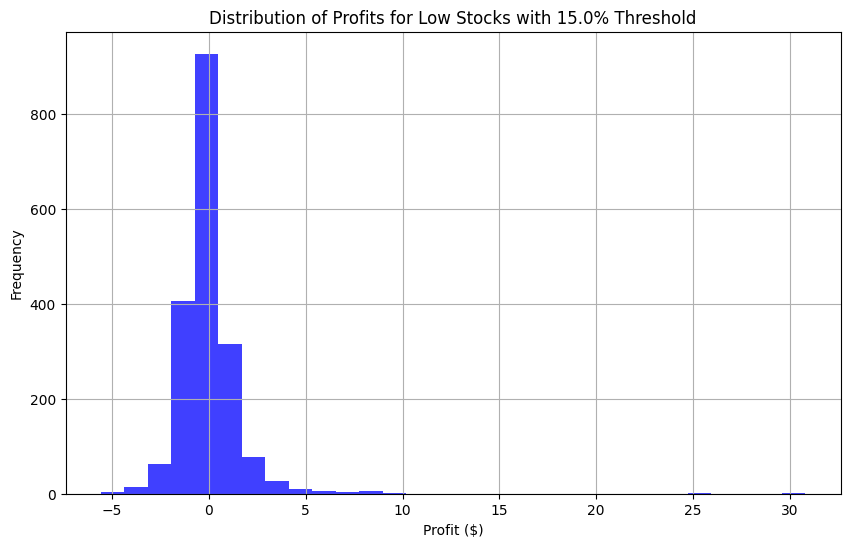

Processing high stocks with threshold 5.0%
Number of high-priced stocks: 11550
Total investment for high stocks: $115500, Total profit for high stocks: $-232.01


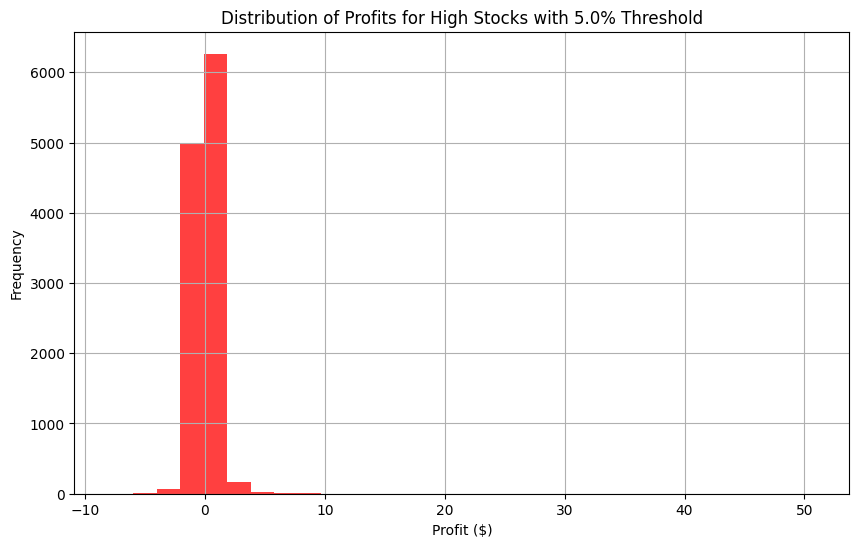

Processing low stocks with threshold 10.0%
Number of low-priced stocks: 4346
Total investment for low stocks: $43390, Total profit for low stocks: $-49.09


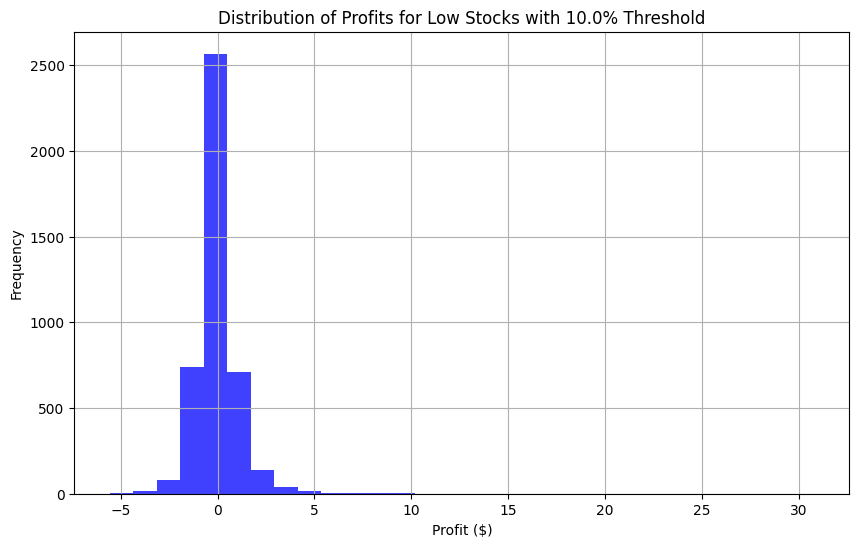

Processing high stocks with threshold 5.0%
Number of high-priced stocks: 11550
Total investment for high stocks: $115500, Total profit for high stocks: $-232.01


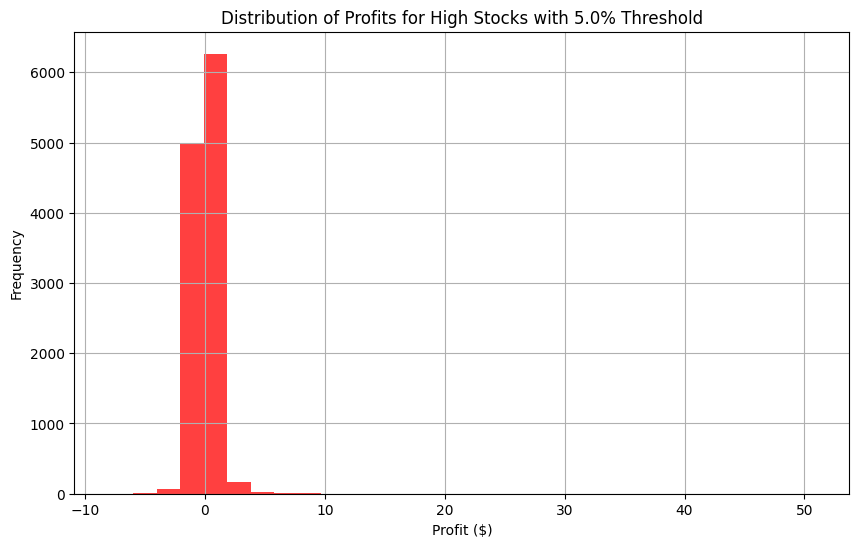

Processing low stocks with threshold 7.000000000000001%
Number of low-priced stocks: 8397
Total investment for low stocks: $83860, Total profit for low stocks: $102.42


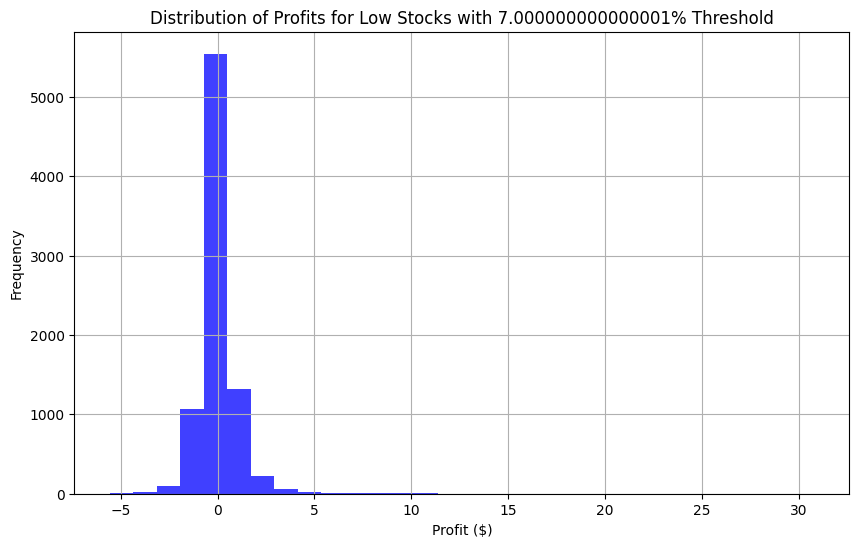

Processing high stocks with threshold 5.0%
Number of high-priced stocks: 11550
Total investment for high stocks: $115500, Total profit for high stocks: $-232.01


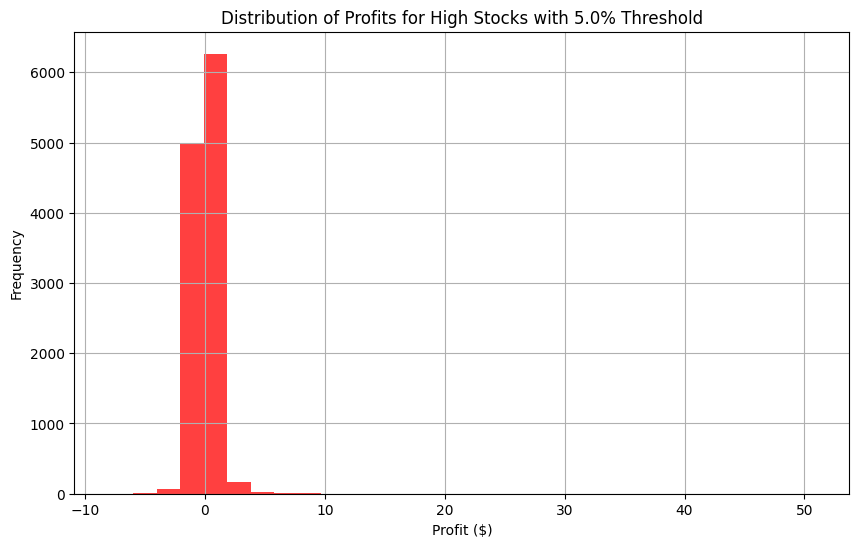

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pickle

# Identify jump stocks with different thresholds for low and high-priced stocks
def identify_jump_stocks_advanced(tickers, data, low_threshold, high_threshold):
    jump_stocks_low = []
    jump_stocks_high = []
    for ticker in tickers:
        for i in range(1, len(data[ticker])):
            prev_price = data[ticker]['Close'].iloc[i - 1]
            current_price = data[ticker]['Close'].iloc[i]
            jump_percentage = (current_price - prev_price) / prev_price
            # Apply different thresholds based on previous closing price
            if prev_price < 10:
                if jump_percentage > low_threshold:
                    jump_stocks_low.append((ticker, i, current_price, prev_price, jump_percentage))
            else:
                if jump_percentage > high_threshold:
                    jump_stocks_high.append((ticker, i, current_price, prev_price, jump_percentage))
    return jump_stocks_low, jump_stocks_high

# Apply trading strategies to identified stocks
def apply_trading_strategy(data, jump_stocks, investment_per_stock=10):
    returns_details = []
    total_investment = 0
    total_return = 0
    for stock in jump_stocks:
        ticker, jump_index, jump_price, prev_price, jump_percentage = stock
        if jump_index + 1 < len(data[ticker]):  # Ensure there's data for the next day
            sell_price = data[ticker]['Close'].iloc[jump_index + 1]
            profit = (sell_price - jump_price) * investment_per_stock / jump_price
            strategy = "Buy/Sell" if prev_price < 10 else "Options Trading"
            total_investment += investment_per_stock
            total_return += profit
            returns_details.append((ticker, strategy, data[ticker].index[jump_index], jump_price, data[ticker].index[jump_index + 1], sell_price, profit))
    return returns_details, total_investment, total_return

# Main function to run the strategies
def main():
    # Load data from a pickle file
    with open('data.pkl', 'rb') as file:
        data = pickle.load(file)
        tickers = list(data.keys())  # Extract tickers from the keys of the data dictionary

    low_thresholds = [0.15, 0.10, 0.07]  # Thresholds for low-priced stocks
    high_threshold = 0.05  # Threshold for high-priced stocks

    for low_threshold in low_thresholds:
        print(f"Processing low stocks with threshold {low_threshold * 100}%")
        jump_stocks_low, jump_stocks_high = identify_jump_stocks_advanced(tickers, data, low_threshold, high_threshold)

        print(f"Number of low-priced stocks: {len(jump_stocks_low)}")
        returns_details_low, total_investment_low, total_profit_low = apply_trading_strategy(data, jump_stocks_low)
        print(f"Total investment for low stocks: ${total_investment_low}, Total profit for low stocks: ${total_profit_low:.2f}")

        # Plotting distribution of profits for low stocks
        profits = [details[-1] for details in returns_details_low]
        plt.figure(figsize=(10, 6))
        plt.hist(profits, bins=30, alpha=0.75, color='blue')
        plt.title(f'Distribution of Profits for Low Stocks with {low_threshold * 100}% Threshold')
        plt.xlabel('Profit ($)')
        plt.ylabel('Frequency')
        plt.grid(True)
        plt.show()

        print(f"Processing high stocks with threshold {high_threshold * 100}%")
        print(f"Number of high-priced stocks: {len(jump_stocks_high)}")
        returns_details_high, total_investment_high, total_profit_high = apply_trading_strategy(data, jump_stocks_high)
        print(f"Total investment for high stocks: ${total_investment_high}, Total profit for high stocks: ${total_profit_high:.2f}")

        # Plotting distribution of profits for high stocks
        profits_high = [details[-1] for details in returns_details_high]
        plt.figure(figsize=(10, 6))
        plt.hist(profits_high, bins=30, alpha=0.75, color='red')
        plt.title(f'Distribution of Profits for High Stocks with {high_threshold * 100}% Threshold')
        plt.xlabel('Profit ($)')
        plt.ylabel('Frequency')
        plt.grid(True)
        plt.show()

if __name__ == "__main__":
    main()


## # Function to calculate the distribution of percentage changes


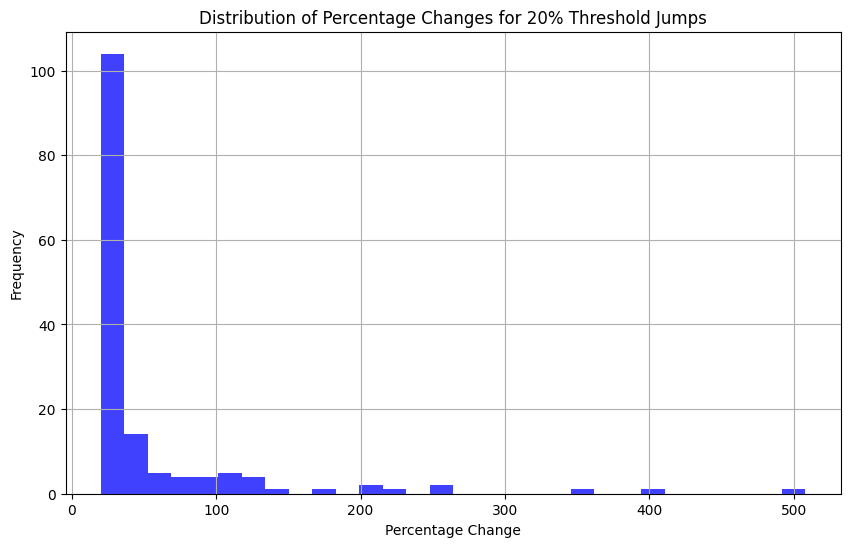

In [ ]:
# Function to calculate the distribution of percentage changes
def calculate_percentage_changes(jump_stocks):
    percentage_changes = []
    for stock in jump_stocks:
        ticker, index, jump_price, previous_price, jump_percentage = stock
        percentage_change = (jump_price - previous_price) / previous_price * 100  # Calculate percentage change
        percentage_changes.append(percentage_change)

    return percentage_changes

# Calculate the distribution of percentage changes for the 20% threshold jump stocks
if 'data' in locals() and 'tickers' in locals():  # Check if data and tickers are loaded
    jump_stocks_20 = identify_jump_stocks(tickers, data, 0.2)  # Re-identify jump stocks for 20% threshold
    percentage_changes_20 = calculate_percentage_changes(jump_stocks_20)

    # Plot the distribution of percentage changes
    plt.figure(figsize=(10, 6))
    plt.hist(percentage_changes_20, bins=30, alpha=0.75, color='blue')
    plt.title('Distribution of Percentage Changes for 20% Threshold Jumps')
    plt.xlabel('Percentage Change')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()
else:
    print("Data not loaded properly, please check the dataset and tickers.")


Mean of differences: $93.16
Standard deviation of differences: $428.41


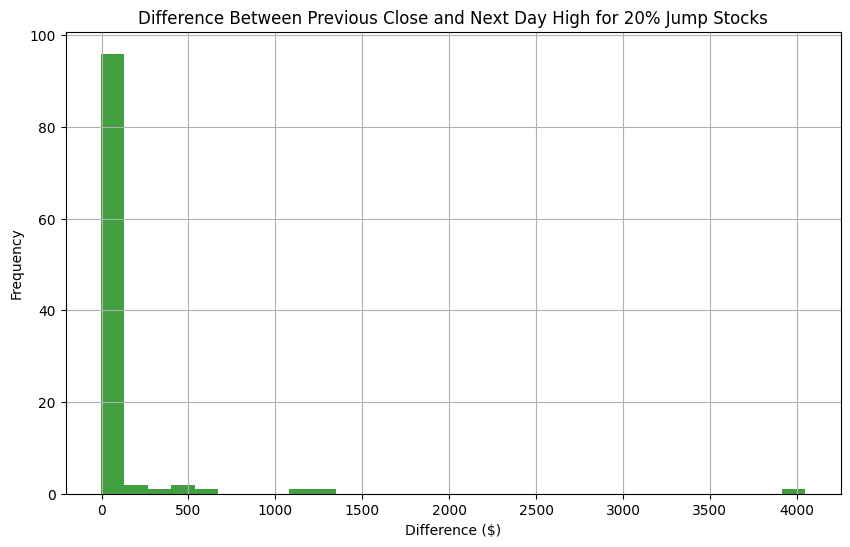

In [ ]:
# Assuming `identify_jump_stocks` is already defined and imported from another cell

# Function to apply trading strategies based on stock prices before jump
def apply_trading_strategy(data, jump_stocks, investment_per_jump=10):
    returns_details = []
    total_investment = 0
    total_return = 0
    for stock in jump_stocks:
        ticker, jump_index, jump_price, prev_price, jump_percentage = stock
        if jump_index + 1 < len(data[ticker]):  # Ensure there's data for the next day after the jump
            sell_price = data[ticker]['Close'].iloc[jump_index + 1]

            if prev_price < 10:  # Condition for stocks with closing price less than $10 before the jump
                profit = (sell_price - jump_price) * investment_per_jump / jump_price
                strategy = "Buy/Sell"
            else:  # Condition for stocks with closing price of $10 or more
                profit = max(sell_price - jump_price, 0) * investment_per_jump  # Simplified option profit model
                strategy = "Options Trading"

            total_investment += investment_per_jump
            total_return += profit
            returns_details.append((ticker, strategy, data[ticker].index[jump_index], jump_price, data[ticker].index[jump_index + 1], sell_price, profit))
    return returns_details, total_investment, total_return

def main():
    thresholds = [0.2]  # Example threshold for simplicity

    for threshold in thresholds:
        print(f"Processing with threshold {threshold * 100}%")
        jump_stocks = identify_jump_stocks(tickers, data, threshold)
        print(f"Number of jump stocks found: {len(jump_stocks)}")

        if jump_stocks:
            returns_details, total_investment, total_profit = apply_trading_strategy(data, jump_stocks)
            print(f"Total investment: ${total_investment}, Total profit: ${total_profit:.2f}")
            for detail in returns_details:
                print(f"Ticker: {detail[0]}, Strategy: {detail[1]}, Buy on {detail[2]} at ${detail[3]:.2f}, Sell on {detail[4]} at ${detail[5]:.2f}, Profit: ${detail[6]:.2f}")

        print("\n")  # Newline for better separation of threshold outputs

if __name__ == "__main__":
    main()


Processing with threshold 20.0%
Number of jump stocks found: 150
Total investment: $1500, Total profit: $57185.11
Ticker: AACG, Strategy: Buy/Sell, Buy on 2019-04-09 00:00:00 at $2.12, Sell on 2019-04-10 00:00:00 at $3.85, Profit: $8.16
Ticker: AAME, Strategy: Buy/Sell, Buy on 2021-02-05 00:00:00 at $5.20, Sell on 2021-02-08 00:00:00 at $6.50, Profit: $2.50
Ticker: AAOI, Strategy: Buy/Sell, Buy on 2023-08-04 00:00:00 at $11.01, Sell on 2023-08-07 00:00:00 at $12.38, Profit: $1.24
Ticker: ABEO, Strategy: Options Trading, Buy on 2019-09-03 00:00:00 at $73.50, Sell on 2019-09-04 00:00:00 at $74.25, Profit: $7.50
Ticker: ABUS, Strategy: Buy/Sell, Buy on 2020-07-23 00:00:00 at $6.20, Sell on 2020-07-24 00:00:00 at $4.96, Profit: $-2.00
Ticker: ACHV, Strategy: Options Trading, Buy on 2019-01-15 00:00:00 at $28.40, Sell on 2019-01-16 00:00:00 at $25.20, Profit: $0.00
Ticker: ADXS, Strategy: Options Trading, Buy on 2021-02-11 00:00:00 at $19.95, Sell on 2021-02-12 00:00:00 at $20.53, Profit: $

Processing low stocks with threshold 15.0%
Number of low-priced stocks: 1863
Total investment for low stocks: $18610, Total profit for low stocks: $-44.71


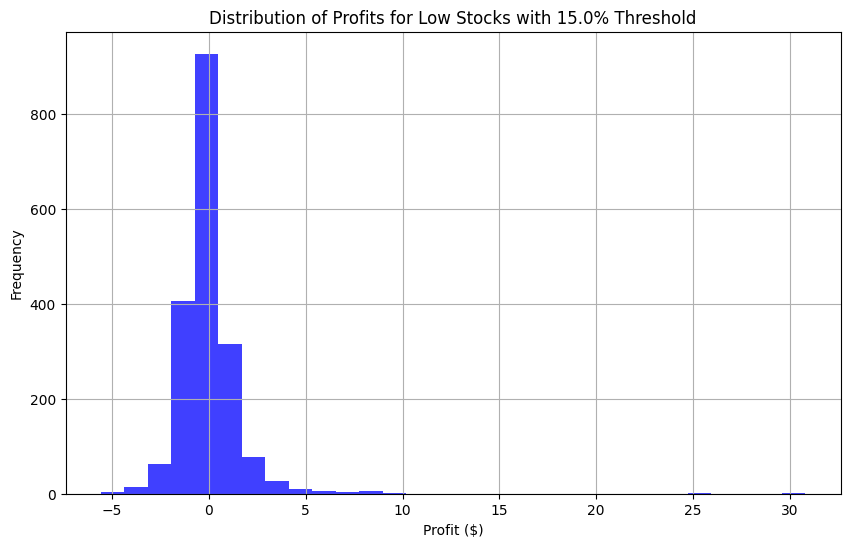

Processing high stocks with threshold 5.0%
Number of high-priced stocks: 11550
Total investment for high stocks: $115500, Total profit for high stocks: $-232.01


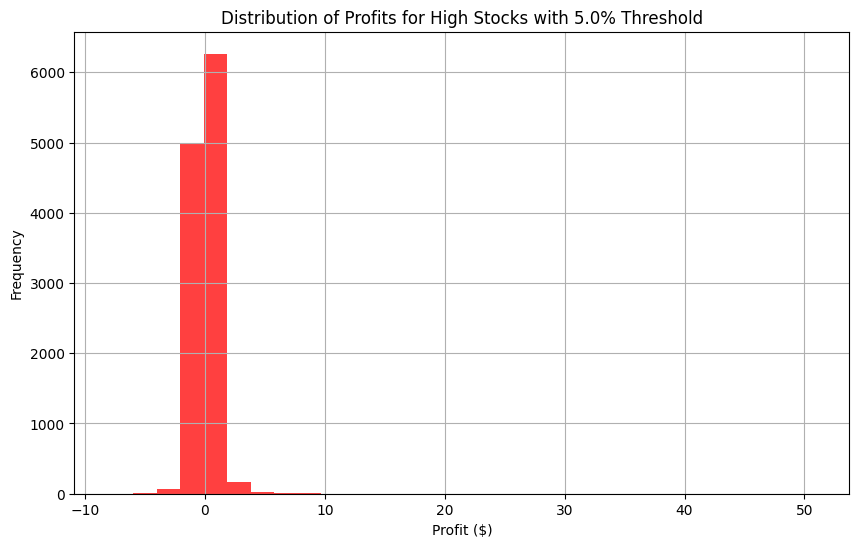

Processing low stocks with threshold 10.0%
Number of low-priced stocks: 4346
Total investment for low stocks: $43390, Total profit for low stocks: $-49.09


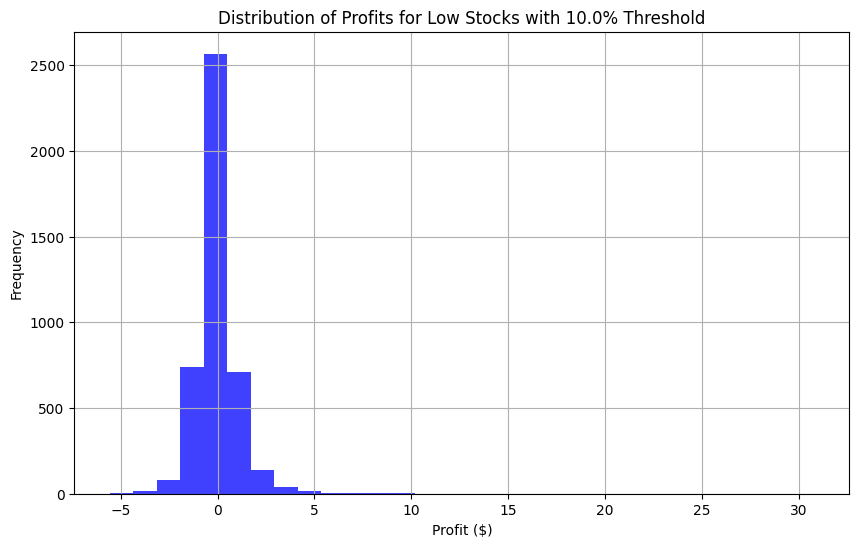

Processing high stocks with threshold 5.0%
Number of high-priced stocks: 11550
Total investment for high stocks: $115500, Total profit for high stocks: $-232.01


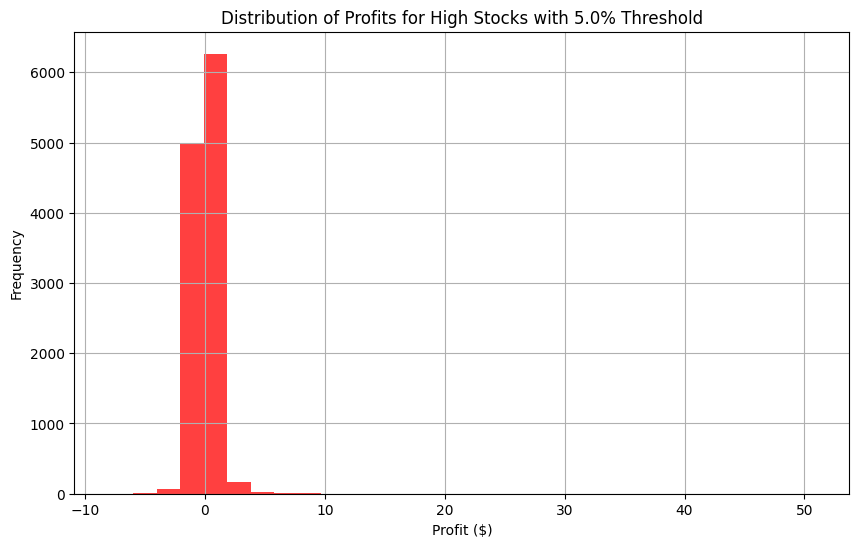

Processing low stocks with threshold 7.000000000000001%
Number of low-priced stocks: 8397
Total investment for low stocks: $83860, Total profit for low stocks: $102.42


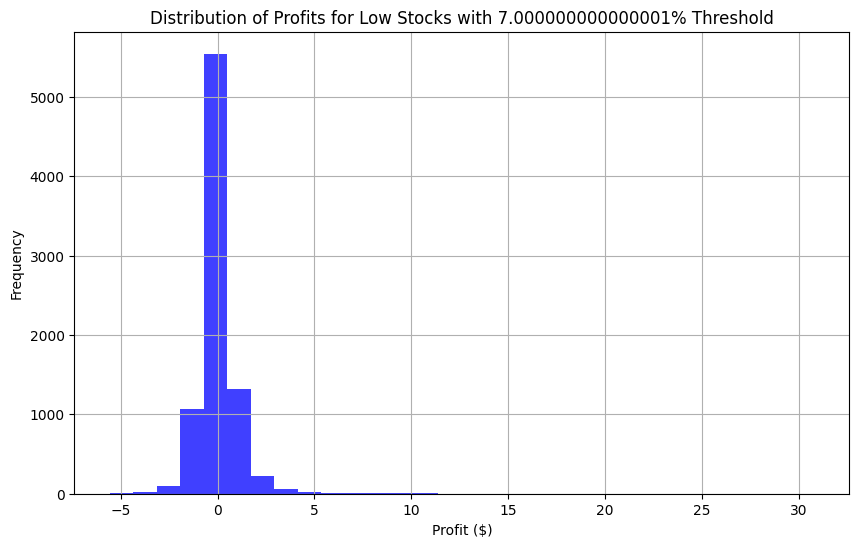

Processing high stocks with threshold 5.0%
Number of high-priced stocks: 11550
Total investment for high stocks: $115500, Total profit for high stocks: $-232.01


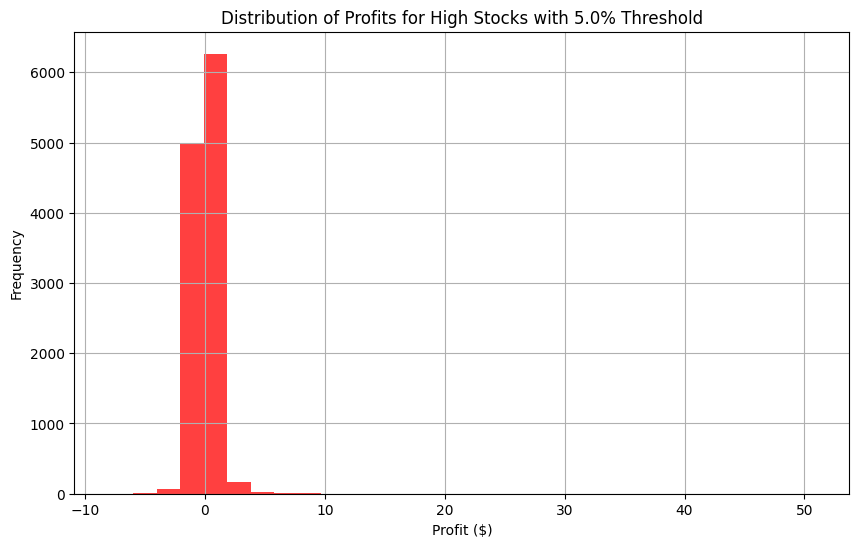

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Identify jump stocks with different thresholds for low and high-priced stocks
def identify_jump_stocks_advanced(tickers, data, low_threshold, high_threshold):
    jump_stocks_low = []
    jump_stocks_high = []
    for ticker in tickers:
        for i in range(1, len(data[ticker])):
            prev_price = data[ticker]['Close'].iloc[i - 1]
            current_price = data[ticker]['Close'].iloc[i]
            jump_percentage = (current_price - prev_price) / prev_price
            # Apply different thresholds based on previous closing price
            if prev_price < 10:
                if jump_percentage > low_threshold:
                    jump_stocks_low.append((ticker, i, current_price, prev_price, jump_percentage))
            else:
                if jump_percentage > high_threshold:
                    jump_stocks_high.append((ticker, i, current_price, prev_price, jump_percentage))
    return jump_stocks_low, jump_stocks_high

# Apply trading strategies to identified stocks
def apply_trading_strategy(data, jump_stocks, investment_per_stock=10):
    returns_details = []
    total_investment = 0
    total_return = 0
    # Iterate through each jump stock to simulate the trade
    for stock in jump_stocks:
        ticker, jump_index, jump_price, prev_price, jump_percentage = stock
        if jump_index + 1 < len(data[ticker]):  # Ensure there's data for the next day
            sell_price = data[ticker]['Close'].iloc[jump_index + 1]
            profit = (sell_price - jump_price) * investment_per_stock / jump_price
            strategy = "Buy/Sell" if prev_price < 10 else "Options Trading"
            total_investment += investment_per_stock
            total_return += profit
            returns_details.append((ticker, strategy, data[ticker].index[jump_index], jump_price, data[ticker].index[jump_index + 1], sell_price, profit))
    return returns_details, total_investment, total_return

# Main function to run the strategies
def main():
    low_thresholds = [0.15, 0.10, 0.07]  # Thresholds for low-priced stocks
    high_threshold = 0.05  # Threshold for high-priced stocks

    for low_threshold in low_thresholds:
        print(f"Processing low stocks with threshold {low_threshold * 100}%")
        jump_stocks_low, jump_stocks_high = identify_jump_stocks_advanced(tickers, data, low_threshold, high_threshold)

        print(f"Number of low-priced stocks: {len(jump_stocks_low)}")
        returns_details_low, total_investment_low, total_profit_low = apply_trading_strategy(data, jump_stocks_low)
        print(f"Total investment for low stocks: ${total_investment_low}, Total profit for low stocks: ${total_profit_low:.2f}")

        # Plotting distribution of profits for low stocks
        profits = [details[-1] for details in returns_details_low]
        plt.figure(figsize=(10, 6))
        plt.hist(profits, bins=30, alpha=0.75, color='blue')
        plt.title(f'Distribution of Profits for Low Stocks with {low_threshold * 100}% Threshold')
        plt.xlabel('Profit ($)')
        plt.ylabel('Frequency')
        plt.grid(True)
        plt.show()

        print(f"Processing high stocks with threshold {high_threshold * 100}%")
        print(f"Number of high-priced stocks: {len(jump_stocks_high)}")
        returns_details_high, total_investment_high, total_profit_high = apply_trading_strategy(data, jump_stocks_high)
        print(f"Total investment for high stocks: ${total_investment_high}, Total profit for high stocks: ${total_profit_high:.2f}")

        # Plotting distribution of profits for high stocks
        profits_high = [details[-1] for details in returns_details_high]
        plt.figure(figsize=(10, 6))
        plt.hist(profits_high, bins=30, alpha=0.75, color='red')
        plt.title(f'Distribution of Profits for High Stocks with {high_threshold * 100}% Threshold')
        plt.xlabel('Profit ($)')
        plt.ylabel('Frequency')
        plt.grid(True)
        plt.show()

if __name__ == "__main__":
    main()


##List of all data to be added back in previous tickers list

In [ ]:
tickers = ['AACG', 'AAME', 'AAOI', 'ABEO', 'ABR', 'ABUS', 'ACER', 'ACHV', 'ACOR', 'ADXS', 'AEHR', 'AEMD', 'AGFS', 'AGMH', 'AGR', 'AGRX', 'AHPI', 'AIM', 'AKBA', 'AKTX', 'ALDX', 'ALIM', 'ALJJ', 'ALLT', 'ALNA', 'ALRN', 'ALT', 'AMPE', 'AMRS', 'AMTX', 'ANIX', 'AQB', 'AQST', 'ARAY', 'ARDS', 'ARDX', 'ARTL', 'ASLN', 'ASMB', 'ASTC', 'ATHE', 'ATNM', 'ATRA', 'ATXI', 'AUTL', 'AVCO', 'AVDL', 'AVGR', 'AVID', 'AVXL', 'AXAS', 'AXDX', 'AXGN', 'AXLA', 'AXNX', 'AYRO', 'AYTU', 'AZRX', 'BAND', 'BBI', 'BBQ', 'BBX', 'BCEL', 'BCLI', 'BCYC', 'BDR', 'BDSI', 'BGI', 'BHTG', 'BIMI', 'BIOC', 'BLCM', 'BLRX', 'BNGO', 'BNR', 'BOXL', 'BRN', 'BRQS', 'BTAI', 'BTE', 'BVS', 'BWAY', 'BXC', 'BXRX', 'BYSI', 'CAAS', 'CABA', 'CADC', 'CAI', 'CANF', 'CAPR', 'CARV', 'CASA', 'CASH', 'CATB', 'CBLI', 'CCLP', 'CCNC', 'CCXI', 'CDAK', 'CDTX', 'CEMI', 'CERC', 'CETX', 'CFB', 'CFRX', 'CGA', 'CHCI', 'CHFS', 'CHMA', 'CHNR', 'CHPM', 'CHRA', 'CHRS', 'CIDM', 'CIO', 'CIR', 'CIT', 'CLAR', 'CLDT', 'CLFD', 'CLIR', 'CLMT', 'CLNE', 'CLPR', 'CLRB', 'CLRO', 'CLSD', 'CLSK', 'CLSN', 'CLVS', 'CLWT', 'CMCM', 'CMLF', 'CMRX', 'CNCE', 'CNCN', 'CNFR', 'CNET', 'CNMD', 'CNOA', 'CNR', 'CNSL', 'CNSP', 'CNST', 'CNXN', 'COCP', 'CODA', 'CODX', 'COFS', 'COLL', 'COMT', 'CONN', 'COOP', 'COPX', 'CORR', 'CORT', 'COUP', 'CPAH', 'CPST', 'CPTA', 'CREG', 'CREX', 'CRIS', 'CRKN', 'CRMD', 'CRMT', 'CRNT', 'CRON', 'CROX', 'CRRS', 'CRSR', 'CRTD', 'CRVS', 'CRWD', 'CRWS', 'CSCW', 'CSGP', 'CSII', 'CSPI', 'CSSE', 'CSTE', 'CSTL', 'CSU', 'CSV', 'CTG', 'CTHR', 'CTIB', 'CTIC', 'CTMX', 'CTRE', 'CTRM', 'CTSO', 'CUE', 'CUR', 'CVBF', 'CVGI', 'CVGW', 'CVLT', 'CVLY', 'CVR', 'CVU', 'CWBR', 'CWCO', 'CWEN', 'CWST', 'CXDC', 'CYAD', 'CYAN', 'CYBE', 'CYCC', 'CYCN', 'CYH', 'CYRN', 'CYRX', 'CYTK', 'CZNC', 'CZR', 'DAIO', 'DALN', 'DARE', 'DAVE', 'DBI', 'DCOM', 'DCPH', 'DCTH', 'DDD', 'DDIV', 'DECK', 'DERM', 'DFFN', 'DGICA', 'DGII', 'DGLY', 'DHIL', 'DHR', 'DHT', 'DIOD', 'DISH', 'DIT', 'DJCO', 'DK', 'DLHC', 'DLLR', 'DLPN', 'DLTH', 'DLTR', 'DLX', 'DMLP', 'DMTK', 'DNLI', 'DNN', 'DOCU', 'DOMO', 'DOOO', 'DORM', 'DOV', 'DOX', 'DPW', 'DRAD', 'DRRX', 'DSGX', 'DSPG', 'DSSI', 'DSTL', 'DSX', 'DTEA', 'DTIL', 'DUK', 'DVAX', 'DVD', 'DVN', 'DXCM', 'DXF', 'DXLG', 'DXPE', 'DYAI', 'DYN', 'DYNT', 'EAF', 'EARN', 'EAST', 'EAT', 'EBIX', 'EBS', 'ECHO', 'ECL', 'ECOL', 'ECOM', 'ECOR', 'ECPG', 'ECYT', 'EDAP', 'EDIT', 'EDNT', 'EDRY', 'EDUC', 'EEFT', 'EEX', 'EFOI', 'EGBN', 'EGLE', 'EGO', 'EGP', 'EGRX', 'EGY', 'EHTH', 'EIGI', 'EIGR', 'EKSO', 'ELAN', 'ELD', 'ELF', 'ELLO', 'ELOX', 'ELSE', 'ELY', 'EMAN', 'EMKR', 'EML', 'EMN', 'EMR', 'ENB', 'ENBL', 'ENDP', 'ENG', 'ENIC', 'ENLC', 'ENLV', 'ENOB', 'ENPH', 'ENS', 'ENSV', 'ENTG', 'ENTX', 'ENV', 'ENVA', 'ENZ', 'EOLS', 'EOSE', 'EPAY', 'EPC', 'EPIX', 'EPR', 'EPSN', 'EQ', 'EQIX', 'EQNR', 'EQOS', 'EQT', 'EQX', 'ERIC', 'ERII', 'EROS', 'ESGC', 'ESGR', 'ESMT', 'ESPR', 'ESQ', 'ESSA', 'ESTC', 'ESTE', 'ETON', 'ETRN', 'ETSY', 'EURN', 'EVBG', 'EVFM', 'EVGN', 'EVH', 'EVLO', 'EVOK', 'EVOL', 'EVOP', 'EVR', 'EVRI', 'EVTC', 'EWBC', 'EXAS', 'EXEL', 'EXLS', 'EXN', 'EXPI', 'EXPO', 'EXPR', 'EXTR', 'EXXI', 'EYE', 'EYEG', 'EYEN', 'EYES', 'EZPW', 'FAMI', 'FANG', 'FANH', 'FARO', 'FAST', 'FATE', 'FBIO', 'FBM', 'FBMS', 'FBNC', 'FBRX', 'FCBC', 'FCCO', 'FCCY', 'FCEL', 'FCFS', 'FCLF', 'FCN', 'FCO', 'FCRD', 'FCX', 'FDBC', 'FDS', 'FDUS', 'FEIM', 'FENC', 'FENG', 'FET', 'FFBC', 'FFHL', 'FFIC', 'FFIN', 'FFLWF', 'FFWM', 'FGBI', 'FGEN', 'FHB', 'FHI', 'FHN', 'FICO', 'FIGS', 'FINV', 'FISI', 'FITB', 'FIVE', 'FIXX', 'FLDM', 'FLEX', 'FLGT', 'FLIC', 'FLIR', 'FLL', 'FLNT', 'FLOW', 'FLR', 'FLS', 'FLT', 'FLUX', 'FLY', 'FMNB', 'FMX', 'FN', 'FNB', 'FNCB', 'FNCH', 'FNHC', 'FNKO', 'FNSR', 'FOLD', 'FONR', 'FOR', 'FORD', 'FORM', 'FORR', 'FORTY', 'FOSL', 'FOXF', 'FPAY', 'FPH', 'FPX', 'FRAN', 'FRBA', 'FRBK', 'FRC', 'FRD', 'FREE', 'FRG', 'FRGI', 'FRME', 'FRPH', 'FRSX', 'FRTA', 'FRX', 'FSK', 'FSLR', 'FSLY', 'FSM', 'FSP', 'FSR', 'FSS', 'FSTR', 'FTAI', 'FTCH', 'FTEK', 'FTK', 'FTV', 'FUBO', 'FUN', 'FURY', 'FUTU', 'FUV', 'FVRR', 'FWONA', 'FWONK', 'FXNC', 'GABC', 'GAIA', 'GAIN', 'GALT', 'GAM', 'GAME', 'GAN', 'GASS', 'GATO', 'GBCI', 'GBDC', 'GBIO', 'GBL', 'GBX', 'GCI', 'GCO', 'GCP', 'GCV', 'GDEN', 'GDOT', 'GDRX', 'GECC', 'GEF', 'GEL', 'GENC', 'GENI', 'GEO', 'GEOS', 'GER', 'GERN', 'GES', 'GET', 'GEVO', 'GFF', 'GFI', 'GFN', 'GGG', 'GH', 'GHL', 'GHM', 'GHSI', 'GIIX', 'GIII', 'GILD', 'GILT', 'GIS', 'GIX', 'GJT', 'GLAD', 'GLBS', 'GLDD', 'GLDG', 'GLNG', 'GLOB', 'GLOG', 'GLOP', 'GLP', 'GLRE', 'GLT', 'GLUU', 'GLW', 'GMAB', 'GMBL', 'GMDA', 'GME', 'GMED', 'GMLP', 'GMS', 'GNE', 'GNFT', 'GNL', 'GNMA', 'GNOM', 'GNRC', 'GNSS', 'GNTX', 'GNUS', 'GO', 'GOAC', 'GOED', 'GOGO', 'GOL', 'GOLD', 'GOOD', 'GOOG', 'GOOGL', 'GORO', 'GOSS', 'GP', 'GPAQ', 'GPC', 'GPK', 'GPL', 'GPM', 'GPN', 'GPOR', 'GPS', 'GPX', 'GRA', 'GRAF', 'GRBK', 'GRC', 'GRFS', 'GRIL', 'GRIN', 'GRMN', 'GROW', 'GRPN', 'GRTS', 'GRUB', 'GRWG', 'GS', 'GSAH', 'GSAT', 'GSBC', 'GSBD', 'GSHD', 'GSL', 'GSM', 'GSMG', 'GSX', 'GT', 'GTEC', 'GTES', 'GTHX', 'GTIM', 'GTLS', 'GTS', 'GTT', 'GTX', 'GTXI', 'GTY', 'GTYH', 'GURE', 'GV', 'GVA', 'GWGH', 'GWPH', 'GWRE', 'GWW', 'GXGX', 'GXP', 'GYRO', 'GZT', 'HA', 'HAE', 'HAFC', 'HAIN', 'HAL', 'HALL', 'HALO', 'HARP', 'HAS', 'HASI', 'HAYN', 'HBAN', 'HBB', 'HBCP', 'HBHC', 'HBI', 'HBIO', 'HBMD', 'HBMN', 'HBNC', 'HBP', 'HBT', 'HCA', 'HCCI', 'HCFT', 'HCHC', 'HCI', 'HCKT', 'HCMA', 'HCSG', 'HDSN', 'HDVY', 'HEAR', 'HEBT', 'HEES', 'HEI', 'HELE', 'HELI', 'HES', 'HEXO', 'HFBL', 'HFC', 'HFFG', 'HFWA', 'HGEN', 'HGV', 'HHGC', 'HHR', 'HI', 'HIBB', 'HIFS', 'HIG', 'HIGA', 'HII', 'HIL', 'HIMS', 'HIO', 'HIW', 'HKD', 'HLF', 'HLIT', 'HLT', 'HLX', 'HMHC', 'HMN', 'HMPR', 'HMSY', 'HMTV', 'HMY', 'HNGR', 'HNI', 'HNRG', 'HOFT', 'HOLI', 'HOLX', 'HOMB', 'HOME', 'HON', 'HOOK', 'HOPE', 'HOTH', 'HP', 'HPK', 'HPP', 'HPQ', 'HPR', 'HPT', 'HQY', 'HR', 'HRB', 'HRC', 'HRZN', 'HSBC', 'HSC', 'HSDT', 'HSKA', 'HSNI', 'HST', 'HSTM', 'HSY', 'HT', 'HTA', 'HTBI', 'HTBK', 'HTBX', 'HTGC', 'HTH', 'HTHT', 'HTLD', 'HTLF', 'HUBG', 'HUBS', 'HUD', 'HUM', 'HUN', 'HURC', 'HURN', 'HUSA', 'HVT', 'HWBK', 'HWCC', 'HWKN', 'HXL', 'HY', 'HYFM', 'HYLN', 'HYMC', 'HYRE', 'HYSR', 'HYZN', 'HZNP', 'IAA', 'IAC', 'IAG', 'IART', 'IBEX', 'IBIO', 'IBM', 'IBN', 'IBP', 'ICBK', 'ICD', 'ICE', 'ICHR', 'ICL', 'ICON', 'ICPT', 'ICUI', 'IDA', 'IDCC', 'IDE', 'IDEX', 'IDN', 'IDRA', 'IDT', 'IDXX', 'IEF', 'IEP', 'IESC', 'IEX', 'IFF', 'IFLT', 'IFMK', 'IFRX', 'IFS', 'IFX', 'IGAC', 'IGC', 'IGIB', 'IGMS', 'IGT', 'IHRT', 'IIN', 'IIVI', 'IKNX', 'ILPT', 'ILMN', 'IMAB', 'IMAC', 'IMAX', 'IMBI', 'IMGN', 'IMH', 'IMKTA', 'IMMP', 'IMMR', 'IMMU', 'IMOS', 'IMPX', 'IMRN', 'IMTX', 'IMUX', 'IMV', 'IMVT', 'INBK', 'INBX', 'INCY', 'INDB', 'INDT', 'INFI', 'INFN', 'INFO', 'INFR', 'ING', 'INGN', 'INGR', 'INMD', 'INN', 'INO', 'INOD', 'INOV', 'INPX', 'INSG', 'INSM', 'INST', 'INSW', 'INT', 'INTA', 'INTC', 'INTEQ', 'INTG', 'INTU', 'INVA', 'INVE', 'INVH', 'INWK', 'INXN', 'IO', 'IONS', 'IOR', 'IOSP', 'IOTS', 'IOVA', 'IP', 'IPAR', 'IPDN', 'IPG', 'IPGP', 'IPHA', 'IPI', 'IPLDP', 'IPWR', 'IQ', 'IQV', 'IR', 'IRBT', 'IRDM', 'IRET', 'IRM', 'IRTC', 'IRTY', 'IRWD', 'ISBC', 'ISCA', 'ISDR', 'ISEE', 'ISIG', 'ISNS', 'ISR', 'ISRG', 'ISSC', 'ISTB', 'IT', 'ITCI', 'ITEX', 'ITGR', 'ITHX', 'ITI', 'ITIC', 'ITM', 'ITOS', 'ITP', 'ITRI', 'ITRN', 'ITT', 'ITUB', 'ITW', 'IVC', 'IVR', 'IVZ', 'IX', 'IXUS', 'IYR', 'J', 'JAGX', 'JAKK', 'JAMF', 'JAN', 'JAZZ', 'JBGS', 'JBL', 'JBLU', 'JBT', 'JCI', 'JCOM', 'JCP', 'JCS', 'JD', 'JDD', 'JEF', 'JELD', 'JHG', 'JILL', 'JKHY', 'JKS', 'JLL', 'JLS', 'JMIA', 'JNCE', 'JNJ', 'JNPR', 'JOB', 'JOBS', 'JOE', 'JOUT', 'JP', 'JPM', 'JPT', 'JQC', 'JRI', 'JRO', 'JRS', 'JSD', 'JSM', 'JST', 'JSYN', 'JTA', 'JTD', 'JTPY', 'JVA', 'JWN', 'JWS', 'JXN', 'K', 'KALA', 'KALU', 'KALV', 'KAMN', 'KAR', 'KB', 'KBAL', 'KBC', 'KBLM', 'KBR', 'KC', 'KDMN', 'KE', 'KEFI', 'KELYA', 'KEM', 'KEN', 'KEQU', 'KERN', 'KEX', 'KEY', 'KEYW', 'KF', 'KFFB', 'KFS', 'KFY', 'KGJI', 'KHC', 'KIDS', 'KIM', 'KIND', 'KINZ', 'KIQ', 'KIRK', 'KKR', 'KL', 'KLAC', 'KLAQ', 'KLDO', 'KLDX', 'KLR', 'KLXE', 'KMB', 'KMDA', 'KMI', 'KMPH', 'KMPR', 'KMT', 'KMTR', 'KMX', 'KN', 'KNDI', 'KNOP', 'KNSA', 'KNSL', 'KNX', 'KO', 'KODK', 'KOF', 'KOP', 'KOPN', 'KOS', 'KPTI', 'KRA', 'KRBP', 'KRC', 'KREF', 'KRG', 'KRMD', 'KRN', 'KRNT', 'KRO', 'KRON', 'KRP', 'KRYS', 'KSMT', 'KSS', 'KSU', 'KT', 'KTCC', 'KTF', 'KTOS', 'KTRA', 'KUKE', 'KURA', 'KVHI', 'KW', 'KWEB', 'KWR', 'KXIN', 'KYMR', 'KYN', 'L', 'LABP', 'LAC', 'LAD', 'LAIX', 'LAKE', 'LAMR', 'LAND', 'LARK', 'LASR', 'LAUR', 'LAWS', 'LAX', 'LBAI', 'LBC', 'LBRT', 'LC', 'LCA', 'LCI', 'LCID', 'LCII', 'LCTX', 'LCUT', 'LCY', 'LDOS', 'LE', 'LEA', 'LEAF', 'LEAP', 'LEDS', 'LEE', 'LEG', 'LEGH', 'LEGN', 'LEJU', 'LENS', 'LEU', 'LEVI', 'LEXX', 'LFC', 'LFLY', 'LFMD', 'LFT', 'LFUS', 'LFVN', 'LGAC', 'LGHL', 'LGIH', 'LGND', 'LGO', 'LHC', 'LHCG', 'LHX', 'LI', 'LIBY', 'LIFE', 'LILA', 'LILAK', 'LINC', 'LIND', 'LIQT', 'LITB', 'LIVE', 'LIVN', 'LIVX', 'LIXT', 'LIZI', 'LJPC', 'LKCO', 'LKFN', 'LKQ', 'LL', 'LLEX', 'LLIT', 'LLL', 'LLNW', 'LLY', 'LMAT', 'LMB', 'LMFA', 'LMND', 'LMNL', 'LMPX', 'LMRK', 'LMST', 'LMT', 'LNC', 'LNDC', 'LNG', 'LNN', 'LNSR', 'LOB', 'LOCO', 'LODE', 'LOGC', 'LOGI', 'LOGM', 'LOMA', 'LOOP', 'LOPE', 'LORL', 'LOTZ', 'LOVE', 'LOW', 'LPG', 'LPI', 'LPL', 'LPLA', 'LPRO', 'LPSN', 'LPTH', 'LPTX', 'LPX', 'LQDA', 'LQDT', 'LRMR', 'LSCC', 'LSI', 'LSPD', 'LSTR', 'LSYN', 'LTBR', 'LTC', 'LTH', 'LTHM', 'LTRN', 'LTRPA', 'LTRX', 'LUB', 'LULU', 'LUMN', 'LUNA', 'LUNG', 'LUV', 'LUXA', 'LVGO', 'LVS', 'LW', 'LWAC', 'LX', 'LXFR', 'LXRX', 'LXU', 'LYB', 'LYFT', 'LYRA', 'LYTS', 'LYV', 'LZB', 'M', 'MA', 'MAAC', 'MAC', 'MACK', 'MACU', 'MADI', 'MAG', 'MAGS', 'MAIN', 'MAN', 'MANH', 'MANT', 'MAR', 'MARA', 'MARK', 'MARPS', 'MASI', 'MASS', 'MAT', 'MATW', 'MATX', 'MAX', 'MAXN', 'MAXR', 'MAYS', 'MBCN', 'MBII', 'MBIN', 'MBIO', 'MBOT', 'MBRX', 'MC', 'MCAD', 'MCB', 'MCF', 'MCFT', 'MCHP', 'MCHX', 'MCK', 'MCMJ', 'MCN', 'MCO', 'MCRB', 'MCRI', 'MCS', 'MCV', 'MCY', 'MD', 'MDCA', 'MDCO', 'MDGL', 'MDGS', 'MDIA', 'MDJH', 'MDLZ', 'MDNA', 'MDP', 'MDRR', 'MDRX', 'MDSO', 'MDT', 'MDU', 'MDVL', 'MDWD', 'MDXG', 'ME', 'MEAC', 'MEAT', 'MEC', 'MED', 'MEDP', 'MEG', 'MEI', 'MEIP', 'MELI', 'MENB', 'MEOH', 'MERC', 'MESA', 'MESO', 'MET', 'METC', 'METX', 'MFA', 'MFC', 'MFG', 'MFGP', 'MFH', 'MFIN', 'MFLX', 'MG', 'MGA', 'MGEE', 'MGI', 'MGLN', 'MGNX', 'MGP', 'MGPI', 'MGRC', 'MGTA', 'MGTX', 'MGU', 'MGY', 'MHD', 'MHK', 'MHLD', 'MHN', 'MHNC', 'MHO', 'MHR', 'MHS', 'MHTX', 'MIC', 'MICT', 'MID', 'MIDD', 'MIE', 'MIK', 'MILN', 'MIME', 'MIN', 'MIND', 'MINM', 'MIRM', 'MIST', 'MIT', 'MITC', 'MITK', 'MITO', 'MITT', 'MIXT', 'MKC', 'MKD', 'MKFG', 'MKL', 'MKSI', 'MKTX', 'ML', 'MLAB', 'MLAC', 'MLCO', 'MLI', 'MLM', 'MLND', 'MLP', 'MLR', 'MLS', 'MLSS', 'MLVF', 'MMAC', 'MMAQ', 'MMC', 'MMEN', 'MMI', 'MMLP', 'MMM', 'MMMB', 'MMS', 'MMSI', 'MMT', 'MMU', 'MMX', 'MN', 'MNDO', 'MNOV', 'MNPR', 'MNR', 'MNRL', 'MNRO', 'MNSB', 'MNSO', 'MNTK', 'MNTX', 'MO', 'MOD', 'MODN', 'MOFG', 'MOGO', 'MOH', 'MOHO', 'MOMO', 'MON', 'MOR', 'MORF', 'MOS', 'MOSY', 'MOTS', 'MOV', 'MOVE', 'MP', 'MPAA', 'MPB', 'MPC', 'MPEL', 'MPW', 'MPWR', 'MPX', 'MQ', 'MRAI', 'MRAM', 'MRBK', 'MRC', 'MRCY', 'MREO', 'MRIN', 'MRK', 'MRKR', 'MRLN', 'MRNA', 'MRNS', 'MRO', 'MRSN', 'MRTN', 'MRTX', 'MRUS', 'MRVI', 'MRVL', 'MS', 'MSA', 'MSB', 'MSBI', 'MSBHF', 'MSCI', 'MSD', 'MSEX', 'MSFT', 'MSGE', 'MSGN', 'MSL', 'MSON', 'MSP', 'MSTB', 'MSVB', 'MT', 'MTB', 'MTC', 'MTCH', 'MTCN', 'MTD', 'MTEK', 'MTEM', 'MTEX', 'MTG', 'MTH', 'MTLS', 'MTLX', 'MTN', 'MTNB', 'MTO', 'MTP', 'MTR', 'MTRN', 'MTSI', 'MTW', 'MTX', 'MTZ', 'MU', 'MUA', 'MUC', 'MUDS', 'MUE', 'MUFG', 'MUH', 'MUI', 'MUNI', 'MUR', 'MUSA', 'MUX', 'MVC', 'MVF', 'MVIS', 'MVL', 'MVO', 'MVST', 'MVV', 'MWK', 'MX', 'MXC', 'MXE', 'MXIM', 'MXL', 'MYE', 'MYFW', 'MYGN', 'MYI', 'MYL', 'MYO', 'MYOV', 'MYSZ', 'MYT', 'MYY', 'MZA', 'MZOR', 'NAB', 'NAC', 'NAD', 'NAK', 'NAKD', 'NANO', 'NAP', 'NARI', 'NASB', 'NAT', 'NATI', 'NATR', 'NAV', 'NAVB', 'NAVI', 'NBEV', 'NBHC', 'NBIX', 'NBLX', 'NBN', 'NBR', 'NBRV', 'NBSE', 'NBTB', 'NBY', 'NC', 'NCA', 'NCLH', 'NCMI', 'NCNA', 'NCR', 'NCSM', 'NCTY', 'NCZ', 'NDAQ', 'NDLS', 'NDSN', 'NE', 'NEA', 'NEBC', 'NECB', 'NEE', 'NEGG', 'NEM', 'NEO', 'NEOG', 'NEON', 'NEP', 'NERV', 'NES', 'NEST', 'NET', 'NEU', 'NEW', 'NEWA', 'NEWP', 'NEWS', 'NEX', 'NEXA', 'NEXI', 'NEXT', 'NFBK', 'NFLX', 'NFP', 'NFRX', 'NFSB', 'NG', 'NGA', 'NGAC', 'NGD', 'NGE', 'NGL', 'NGM', 'NGMS', 'NGX', 'NGVC', 'NGVT', 'NH', 'NHC', 'NHI', 'NHIC', 'NHTC', 'NICE', 'NICK', 'NID', 'NIE', 'NIM', 'NIO', 'NISN', 'NJR', 'NKE', 'NKLA', 'NKR', 'NLOK', 'NLS', 'NLSN', 'NLY', 'NM', 'NMC', 'NMFC', 'NMI', 'NMIH', 'NML', 'NMM', 'NMR', 'NMRD', 'NMRK', 'NMS', 'NMT', 'NMTR', 'NNA', 'NNBR', 'NNDM', 'NNI', 'NNK', 'NNN', 'NNOX', 'NNP', 'NNRX', 'NNS', 'NNT', 'NNV', 'NNY', 'NOA', 'NOAH', 'NOC', 'NODK', 'NOG', 'NOGN', 'NOI', 'NOK', 'NOM', 'NOMD', 'NOV', 'NOVA', 'NOVN', 'NOW', 'NP', 'NPCE', 'NPCI', 'NPK', 'NPO', 'NPTN', 'NPV', 'NQ', 'NQP', 'NR', 'NRF', 'NRIM', 'NRIX', 'NRP', 'NRT', 'NRZ', 'NSA', 'NSC', 'NSEC', 'NSIT', 'NSL', 'NSP', 'NSPR', 'NSR', 'NSS', 'NSSC', 'NSTB', 'NSTC', 'NTC', 'NTEC', 'NTEST', 'NTFX', 'NTG', 'NTH', 'NTLA', 'NTP', 'NTR', 'NTRA', 'NTRS', 'NTRSO', 'NTS', 'NTUS', 'NTWK', 'NTX', 'NUC', 'NUE', 'NURO', 'NUS', 'NUTX', 'NUVA', 'NUZE', 'NVAX', 'NVCR', 'NVDA', 'NVEC', 'NVEE', 'NVFY', 'NVG', 'NVGS', 'NVIV', 'NVLN', 'NVMI', 'NVNO', 'NVO', 'NVR', 'NVRO', 'NVS', 'NVST', 'NVT', 'NVTA', 'NVVE', 'NWBI', 'NWBO', 'NWG', 'NWL', 'NWN', 'NWPX', 'NWS', 'NWSA', 'NX', 'NXE', 'NXGN', 'NXPI', 'NXRT', 'NXST', 'NXTD', 'NXTG', 'NXTM', 'NXTY', 'NYCB', 'NYMT', 'NYMX', 'NYSE', 'NYT', 'NYX', 'NZF', 'O', 'OAS', 'OBCI', 'OBEL', 'OBLG', 'OBNK', 'OBOR', 'OBT', 'OC', 'OCFC', 'OCGN', 'OCN', 'OCSI', 'OCDX', 'OCT', 'OCUL', 'OCUP', 'OCX', 'ODC', 'ODFL', 'ODT', 'OEC', 'OEG', 'OEL', 'OEM', 'OESX', 'OFC', 'OFED', 'OFG', 'OFIX', 'OFLX', 'OGE', 'OGEN', 'OGI', 'OGS', 'OGZPY', 'OHAI', 'OHI', 'OI', 'OII', 'OIS', 'OKE', 'OKTA', 'OLB', 'OLCF', 'OLD', 'OLED', 'OLLI', 'OLN', 'OLO', 'OLMA', 'OLP', 'OLPX', 'OM', 'OMAB', 'OMCL', 'OMED', 'OMER', 'OMEX', 'OMFG', 'OMI', 'OMP', 'ON', 'ONB', 'ONCS', 'ONCT', 'ONCY', 'ONDK', 'ONEM', 'ONEQ', 'ONG', 'ONL', 'ONLN', 'ONON', 'ONOV', 'ONT', 'ONTO', 'ONTX', 'ONVO', 'ONYX', 'OOMA', 'OP', 'OPAL', 'OPBK', 'OPCH', 'OPGN', 'OPI', 'OPIN', 'OPK', 'OPM', 'OPNT', 'OPOF', 'OPP', 'OPS', 'OPT', 'OPTN', 'OPTT', 'OPY', 'OQAL', 'OR', 'ORA', 'ORBC', 'ORCC', 'ORCL', 'ORGO', 'ORGS', 'ORI', 'ORIA', 'ORIC', 'ORLY', 'ORM', 'ORMP', 'ORN', 'OROV', 'ORPH', 'ORRF', 'ORTX', 'OSBC', 'OSIS', 'OSL', 'OSM', 'OSMT', 'OSPN', 'OSUR', 'OSW', 'OTA', 'OTD', 'OTEX', 'OTIC', 'OTIS', 'OTLK', 'OTLY', 'OTM', 'OTRK', 'OTTR', 'OTTW', 'OUT', 'OVID', 'OVLY', 'OVV', 'OXBR', 'OXLCO', 'OXM', 'OXPS', 'OXSQ', 'OXY', 'OYST', 'OZK', 'OZON', 'PAA', 'PAC', 'PACB', 'PACE', 'PACK', 'PACW', 'PAG', 'PAGP', 'PAGS', 'PAHC', 'PAIC', 'PAID', 'PAM', 'PANL', 'PANW', 'PAR', 'PARA', 'PARD', 'PARR', 'PASG', 'PATH', 'PATI', 'PATK', 'PAVM', 'PAY', 'PAYA', 'PAYC', 'PAYO', 'PAYS', 'PB', 'PBA', 'PBB', 'PBBI', 'PBCT', 'PBCY', 'PBF', 'PBFS', 'PBFX', 'PBH', 'PBI', 'PBLA', 'PBPB', 'PBR', 'PBS', 'PBT', 'PBTS', 'PBYI', 'PCAR', 'PCB', 'PCC', 'PCEF', 'PCH', 'PCI', 'PCK', 'PCLN', 'PCM', 'PCN', 'PCOM', 'PCQ', 'PCR', 'PCSA', 'PCRX', 'PCS', 'PCT', 'PCTI', 'PCTY', 'PCY', 'PCYG', 'PCYO', 'PD', 'PDCE', 'PDCO', 'PDFS', 'PDI', 'PDLI', 'PDM', 'PDN', 'PDP', 'PDS', 'PDSB', 'PDT', 'PE', 'PEAK', 'PEB', 'PEBO', 'PECO', 'PED', 'PEGA', 'PEI', 'PEN', 'PENN', 'PEO', 'PEOP', 'PEP', 'PERI', 'PESI', 'PETQ', 'PETS', 'PETZ', 'PFBC', 'PFC', 'PFDR', 'PFE', 'PFG', 'PFGC', 'PFHD', 'PFIE', 'PFIU', 'PFMT', 'PFNX', 'PFO', 'PFS', 'PFSI', 'PFSW', 'PFTA', 'PFX', 'PG', 'PGC', 'PGEM', 'PGEN', 'PGNY', 'PGR', 'PGRE', 'PGTI', 'PH', 'PHAR', 'PHAS', 'PHAT', 'PHCF', 'PHD', 'PHG', 'PHGE', 'PHI', 'PHIC', 'PHK', 'PHM', 'PHO', 'PHR', 'PHT', 'PHY', 'PHX', 'PIAI', 'PICO', 'PIE', 'PII', 'PIKE', 'PIL', 'PIM', 'PINE', 'PING', 'PINS', 'PIOP', 'PIP', 'PIPR', 'PIRS', 'PIS', 'PIT', 'PIVOT', 'PIXY', 'PJC', 'PJP', 'PJT', 'PK', 'PKBK', 'PKD', 'PKG', 'PKI', 'PKO', 'PKOH', 'PKX', 'PL', 'PLAB', 'PLACE', 'PLBC', 'PLBY', 'PLCE', 'PLD', 'PLG', 'PLIN', 'PLL', 'PLM', 'PLMI', 'PLMR', 'PLNT', 'PLOW', 'PLPC', 'PLS', 'PLSE', 'PLTK', 'PLTR', 'PLUG', 'PLUS', 'PLX', 'PLXP', 'PLYA', 'PM', 'PMBC', 'PMD', 'PME', 'PMF', 'PMGM', 'PMI', 'PMO', 'PMP', 'PMS', 'PMT', 'PMVP', 'PNBK', 'PNC', 'PNFP', 'PNG', 'PNI', 'PNM', 'PNNT', 'PNR', 'PNRG', 'PNT', 'PNTG', 'PNW', 'POAI', 'PODD', 'POET', 'POL', 'POLA', 'POLE', 'POLL', 'POLY', 'POM', 'POND', 'POOL', 'POR', 'PORT', 'POSH', 'POST', 'POW', 'POWI', 'POWL', 'POWR', 'POWW', 'PPBI', 'PPC', 'PPD', 'PPDI', 'PPG', 'PPH', 'PPHM', 'PPL', 'PPMC', 'PPMH', 'PPP', 'PPPW', 'PPR', 'PPSI', 'PPT', 'PPX', 'PQG', 'PRA', 'PRAA', 'PRAH', 'PRAX', 'PRCH', 'PRCY', 'PRE', 'PRED', 'PREF', 'PREK', 'PREP', 'PRF', 'PRFT', 'PRFX', 'PRGO', 'PRGS', 'PRH', 'PRI', 'PRIM', 'PRK', 'PRKR', 'PRM', 'PRMW', 'PRN', 'PRNB', 'PRO', 'PROG', 'PROS', 'PROT', 'PROV', 'PRPH', 'PRPL', 'PRPO', 'PRQR', 'PRS', 'PRSC', 'PRSP', 'PRST', 'PRT', 'PRTA', 'PRTC', 'PRTH', 'PRTK', 'PRTS', 'PRTY', 'PRU', 'PRVB', 'PRVL', 'PS', 'PSA', 'PSAC', 'PSB', 'PSEC', 'PSHG', 'PSI', 'PSIX', 'PSMT', 'PSN', 'PSNL', 'PSO', 'PSP', 'PSQ', 'PSR', 'PSTG', 'PSTH', 'PSTI', 'PSTL', 'PSTV', 'PSX', 'PT', 'PTC', 'PTCT', 'PTD', 'PTE', 'PTEK', 'PTEN', 'PTGX', 'PTI', 'PTIC', 'PTIE', 'PTIX', 'PTMN', 'PTN', 'PTNR', 'PTON', 'PTR', 'PTSI', 'PTV', 'PTVE', 'PTX', 'PTY', 'PUB', 'PUK', 'PULM', 'PUMP', 'PURE', 'PUYI', 'PV', 'PVAC', 'PVAL', 'PVB', 'PVC', 'PVCT', 'PVG', 'PVH', 'PVI', 'PVL', 'PVR', 'PVTL', 'PW', 'PWB', 'PWFL', 'PWR', 'PWRD', 'PWSC', 'PWT', 'PX', 'PXD', 'PXE', 'PXF', 'PXG', 'PXH', 'PXI', 'PXJ', 'PXJR', 'PXLC', 'PXLG', 'PXLR', 'PXLS', 'PXLT', 'PXMV', 'PXQ', 'PXSG', 'PXSJ', 'PXT', 'PXU', 'PXUS', 'PXV', 'PXW', 'PY', 'PYCR', 'PYDS', 'PYPL', 'PYPD', 'PYPE', 'PYS', 'PYT', 'PYX', 'PYZ', 'PZA', 'PZC', 'PZD', 'PZE', 'PZG', 'PZN', 'PZO', 'PZQ', 'PZR', 'PZS', 'PZT', 'PZU', 'PZUS', 'PZV', 'PZW', 'PZY', 'PZZA', 'QABA', 'QADA', 'QADB', 'QAI', 'QAT', 'QBAK', 'QBIO', 'QCLN', 'QCOM', 'QCRH', 'QD', 'QDEL', 'QDYN', 'QED', 'QEFA', 'QELL', 'QEMM', 'QEP', 'QFIN', 'QFTA', 'QGEN', 'QID', 'QIWI', 'QK', 'QLGN', 'QLI', 'QLIK', 'QLTA', 'QLTY', 'QLVD', 'QLVE', 'QLYS', 'QMCO', 'QMJ', 'QMOM', 'QNST', 'QQQ', 'QQQX', 'QQXT', 'QRHC', 'QRL', 'QRM', 'QRO', 'QRT', 'QSR', 'QTNT', 'QTRX', 'QUAD', 'QUOT', 'QURE', 'QVAL', 'QVCC', 'QVCD', 'QVIG', 'QVML', 'QVMM', 'QVMV', 'QVR', 'QVT', 'QVVO', 'QWLD', 'QXGG', 'QXTR', 'QYLD', 'QYLG', 'QYLS', 'R', 'RACE', 'RAD', 'RADA', 'RADR', 'RAIL', 'RAMP', 'RAND', 'RARE', 'RAS', 'RATL', 'RAVE', 'RBA', 'RBB', 'RBBN', 'RBC', 'RBCAA', 'RBCN', 'RBKB', 'RBLX', 'RBN', 'RBNC', 'RBS', 'RBZ', 'RC', 'RCA', 'RCB', 'RCC', 'RCD', 'RCEL', 'RCF', 'RCG', 'RCHG', 'RCI', 'RCII', 'RCMT', 'RCON', 'RCP', 'RCS', 'RCT', 'RDHL', 'RDIB', 'RDI', 'RDN', 'RDNT', 'RDUS', 'RDVT', 'RDWR', 'RE', 'REAL', 'RECN', 'REDU', 'REED', 'REEM', 'REET', 'REG', 'REGI', 'REGN', 'REI', 'REK', 'RELY', 'REM', 'REMX', 'RENN', 'RENT', 'REPL', 'REPX', 'RES', 'RESI', 'RETA', 'REV', 'REVG', 'REW', 'REX', 'REXR', 'REYN', 'REZ', 'REZI', 'RF', 'RFIL', 'RFL', 'RFP', 'RGA', 'RGEN', 'RGLD', 'RGLS', 'RGNX', 'RGP', 'RGR', 'RGS', 'RGT', 'RHI', 'RHP', 'RIBT', 'RICK', 'RIDE', 'RIDL', 'RIG', 'RIGL', 'RILY', 'RING', 'RIO', 'RIOT', 'RISE', 'RIV', 'RIVN', 'RJA', 'RJF', 'RJI', 'RJN', 'RJZ', 'RKDA', 'RKT', 'RKTA', 'RL', 'RLI', 'RLOG', 'RLX', 'RMAX', 'RMBS', 'RMD', 'RMED', 'RMGB', 'RMG', 'RMNI', 'RMPL', 'RMR', 'RMS', 'RMT', 'RMTI', 'RNA', 'RNDB', 'RNET', 'RNG', 'RNGR', 'RNLX', 'RNP', 'RNR', 'RNST', 'RNW', 'ROAD', 'ROAN', 'ROBO', 'ROCK', 'ROG', 'ROIC', 'ROIV', 'ROK', 'ROKU', 'ROL', 'ROP', 'ROSE', 'ROST', 'RPAI', 'RPAY', 'RPM', 'RPRX', 'RPT', 'RPV', 'RQI', 'RRBI', 'RRC', 'RRGB', 'RRR', 'RRTS', 'RS', 'RSG', 'RSLS', 'RSP', 'RSSS', 'RST', 'RSX', 'RTIX', 'RTLR', 'RTN', 'RTP', 'RTPY', 'RTX', 'RUBY', 'RUN', 'RUSHA', 'RUSHB', 'RUTH', 'RVI', 'RVLT', 'RVMD', 'RVNC', 'RVPH', 'RVSB', 'RWLK', 'RWT', 'RXDX', 'RXN', 'RY', 'RYAAY', 'RYAM', 'RYB', 'RYCE', 'RYI', 'RYN', 'RYTM', 'RZA', 'RZB', 'S', 'SAA', 'SABR', 'SAFE', 'SAFM', 'SAFT', 'SAGE', 'SAH', 'SAIA', 'SAIC', 'SAIL', 'SAK', 'SAL', 'SALM', 'SAM', 'SAMG', 'SAN', 'SAND', 'SANM', 'SANW', 'SAP', 'SAR', 'SASR', 'SATS', 'SAVE', 'SB', 'SBA', 'SBAC', 'SBBP', 'SBCF', 'SBFG', 'SBGI', 'SBH', 'SBI', 'SBLK', 'SBOW', 'SBR', 'SBS', 'SBSI', 'SBSW', 'SBUX', 'SC', 'SCAI', 'SCCO', 'SCD', 'SCE', 'SCHE', 'SCHF', 'SCHG', 'SCHL', 'SCHN', 'SCHO', 'SCHP', 'SCHR', 'SCHV', 'SCHW', 'SCI', 'SCID', 'SCIX', 'SCL', 'SCM', 'SCOR', 'SCPH', 'SCPL', 'SCPS', 'SCR', 'SCSC', 'SCU', 'SCVL', 'SCWX', 'SCYX', 'SCZ', 'SD', 'SDC', 'SDGR', 'SDHY', 'SDOW', 'SDP', 'SDPI', 'SDS', 'SDY', 'SE', 'SEA', 'SEAC', 'SEAL', 'SEAS', 'SEB', 'SECO', 'SEDG', 'SEE', 'SEED', 'SEEL', 'SEER', 'SEF', 'SEIC', 'SELB', 'SELF', 'SEM', 'SEMG', 'SEMR', 'SEN', 'SENS', 'SEO', 'SEPZ', 'SERV', 'SES', 'SESN', 'SF', 'SFBC', 'SFB', 'SFBS', 'SFE', 'SFIX', 'SFL', 'SFM', 'SFNC', 'SFST', 'SFT', 'SFTW', 'SFX', 'SG', 'SGA', 'SGAM', 'SGB', 'SGBX', 'SGC', 'SGDJ', 'SGEN', 'SGG', 'SGH', 'SGI', 'SGMA', 'SGMO', 'SGMZ', 'SGNL', 'SGO', 'SGRP', 'SGRY', 'SGTX', 'SH', 'SHAK', 'SHBI', 'SHC', 'SHEN', 'SHG', 'SHI', 'SHIP', 'SHLS', 'SHLX', 'SHO', 'SHOP', 'SHSP', 'SHW', 'SI', 'SID', 'SIEB', 'SIEN', 'SIF', 'SIFY', 'SIG', 'SIGA', 'SIGI', 'SIGIP', 'SII', 'SIJ', 'SIL', 'SILC', 'SILK', 'SIM', 'SIMO', 'SINA', 'SINO', 'SINT', 'SINV', 'SIOX', 'SIRI', 'SITC', 'SITE', 'SIVB', 'SIX', 'SIXA', 'SJI', 'SJIU', 'SJM', 'SJNK', 'SJR', 'SJS', 'SJT', 'SJW', 'SKIN', 'SKLZ', 'SKM', 'SKT', 'SKX', 'SKY', 'SLAB', 'SLB', 'SLCA', 'SLCR', 'SLD', 'SLDB', 'SLE', 'SLF', 'SLG', 'SLGG', 'SLGN', 'SLI', 'SLM', 'SLN', 'SLP', 'SLQT', 'SLRC', 'SLS', 'SM', 'SMAR', 'SMBC', 'SMBK', 'SMC', 'SMCI', 'SMED', 'SMFG', 'SMG', 'SMHI', 'SMID', 'SMIT', 'SMLP', 'SMM', 'SMMF', 'SMN', 'SMPL', 'SMRT', 'SMSI', 'SMT', 'SMTS', 'SMWB', 'SMX', 'SNAP', 'SNBR', 'SNCR', 'SNCY', 'SNE', 'SNES', 'SNEX', 'SNFCA', 'SNGX', 'SNLN', 'SNN', 'SNP', 'SNPR', 'SNPS', 'SNR', 'SNSR', 'SNT', 'SNTG', 'SNV', 'SNX', 'SNY', 'SO', 'SOAC', 'SOFI', 'SOFO', 'SOHU', 'SOI', 'SOJC', 'SOL', 'SOLN', 'SOLY', 'SON', 'SOND', 'SONG', 'SONM', 'SONO', 'SONY', 'SOPH', 'SOR', 'SORL', 'SOVO', 'SP', 'SPB', 'SPCE', 'SPG', 'SPGI', 'SPH', 'SPHD', 'SPHQ', 'SPI', 'SPKE', 'SPLK', 'SPLP', 'SPNE', 'SPNS', 'SPOK', 'SPOX', 'SPR', 'SPRB', 'SPRQ', 'SPRO', 'SPSB', 'SPT', 'SPTN', 'SPWH', 'SPWR', 'SPXC', 'SPXL', 'SPXS', 'SPXX', 'SPY', 'SQ', 'SQBG', 'SQFT', 'SQM', 'SQQQ', 'SQZ', 'SR', 'SRAC', 'SRAX', 'SRC', 'SRCE', 'SRCL', 'SRDX', 'SRE', 'SREV', 'SRG', 'SRGA', 'SRNE', 'SRRK', 'SRS', 'SRT', 'SRTS', 'SRV', 'SRVR', 'SRYB', 'SSBI', 'SSBK', 'SSC', 'SSD', 'SSE', 'SSI', 'SSL', 'SSMX', 'SSNC', 'SSNT', 'SSP', 'SSPK', 'SSRM', 'SSTI', 'SSTK', 'SSTR', 'SSY', 'SSYS', 'ST', 'STAA', 'STAG', 'STAR', 'STAY', 'STBA', 'STC', 'STCN', 'STE', 'STEP', 'STFC', 'STG', 'STIM', 'STKL', 'STKS', 'STLD', 'STM', 'STN', 'STNE', 'STNG', 'STOK', 'STON', 'STOR', 'STRA', 'STRL', 'STRM', 'STRO', 'STRS', 'STRT', 'STSA', 'STT', 'STWD', 'STX', 'STZ', 'SU', 'SUB', 'SUI', 'SUM', 'SUMO', 'SUN', 'SUNS', 'SUP', 'SUPN', 'SURF', 'SUSA', 'SUSC', 'SUSHI', 'SUSL', 'SUV', 'SUZ', 'SV', 'SVAC', 'SVBI', 'SVC', 'SVFA', 'SVFB', 'SVFD', 'SVG', 'SVI', 'SVIN', 'SVM', 'SVMK', 'SVN', 'SVO', 'SVRA', 'SVVC', 'SVXY', 'SWAV', 'SWBI', 'SWCH', 'SWI', 'SWIR', 'SWK', 'SWKS', 'SWM', 'SWN', 'SWP', 'SWTX', 'SWX', 'SXC', 'SXI', 'SXT', 'SY', 'SYBT', 'SYBX', 'SYF', 'SYK', 'SYKE', 'SYKES', 'SYNA', 'SYNC', 'SYNH', 'SYPR', 'SYS', 'SYTA', 'SYX', 'SYY', 'SZC', 'T', 'TA', 'TAC', 'TACT', 'TAE', 'TAG', 'TAGS', 'TAIL', 'TAK', 'TAL', 'TALO', 'TAN', 'TANH', 'TAOP', 'TAP', 'TARA', 'TARS', 'TASK', 'TAST', 'TAT', 'TATT', 'TAYD', 'TBBK', 'TBIO', 'TBK', 'TBLA', 'TBLT', 'TBNK', 'TBPH', 'TBRG', 'TBT', 'TBX', 'TC', 'TCBI', 'TCBK', 'TCCO', 'TCEHY', 'TCMD', 'TCOM', 'TCON', 'TCPC', 'TCPH', 'TCRR', 'TCS', 'TCX', 'TD', 'TDC', 'TDF', 'TDG', 'TDI', 'TDIV', 'TDOC', 'TDS', 'TDW', 'TDY', 'TEAF', 'TEAM', 'TECH', 'TEDU', 'TEI', 'TEKK', 'TEL', 'TELA', 'TELL', 'TEN', 'TENB', 'TENX', 'TER', 'TERN', 'TESS', 'TETC', 'TEUM', 'TEX', 'TFC', 'TFFP', 'TFI', 'TFII', 'TFLX', 'TFM', 'TFSL', 'TFX', 'TG', 'TGA', 'TGNA', 'TGP', 'TGS', 'TGT', 'TGTX', 'TH', 'THC', 'THCB', 'THG', 'THMO', 'THO', 'THR', 'THRM', 'THRX', 'THS', 'THTX', 'TIF', 'TIG', 'TIGR', 'TIL', 'TILE', 'TILT', 'TIMB', 'TINV', 'TIO', 'TIP', 'TIPT', 'TIRC', 'TISI', 'TITN', 'TIVO', 'TJX', 'TK', 'TKAT', 'TKC', 'TKR', 'TLAB', 'TLGT', 'TLK', 'TLMD', 'TLRY', 'TLS', 'TLSA', 'TLT', 'TLX', 'TM', 'TMC', 'TMHC', 'TMKR', 'TMO', 'TMP', 'TMQ', 'TMRK', 'TMS', 'TMTS', 'TMUS', 'TMX', 'TNAV', 'TNC', 'TNDM', 'TNET', 'TNK', 'TNL', 'TNP', 'TNXP', 'TOCA', 'TOD', 'TOI', 'TOK', 'TOL', 'TOMZ', 'TOPS', 'TORC', 'TOT', 'TOUR', 'TOWN', 'TPB', 'TPC', 'TPIC', 'TPL', 'TPR', 'TPRE', 'TPTX', 'TPVG', 'TPX', 'TQD', 'TQQQ', 'TR', 'TRC', 'TRCA', 'TRCH', 'TREE', 'TREX', 'TRGP', 'TRHC', 'TRI', 'TRIB', 'TRIL', 'TRIP', 'TRIT', 'TRMB', 'TRMD', 'TRMK', 'TRMT', 'TRN', 'TRNO', 'TRNS', 'TROX', 'TROW', 'TROX', 'TRP', 'TRQ', 'TRS', 'TRST', 'TRT', 'TRTN', 'TRTX', 'TRU', 'TRUE', 'TRUP', 'TRV', 'TRVG', 'TRVN', 'TRX', 'TRY', 'TRZ', 'TS', 'TSC', 'TSCO', 'TSE', 'TSEM', 'TSHA', 'TSLA', 'TSLX', 'TSM', 'TSN', 'TSP', 'TSRX', 'TSS', 'TSU', 'TT', 'TTC', 'TTCF', 'TTD', 'TTE', 'TTEC', 'TTEK', 'TTGT', 'TTI', 'TTM', 'TTMI', 'TTOO', 'TTP', 'TTPH', 'TTS', 'TTT', 'TTWO', 'TTX', 'TUP', 'TUR', 'TURN', 'TUSA', 'TV', 'TVAC', 'TVC', 'TVTX', 'TW', 'TWI', 'TWLO', 'TWNK', 'TWOU', 'TWST', 'TWTR', 'TX', 'TXG', 'TXMD', 'TXN', 'TXRH', 'TXT', 'TY', 'TYG', 'TYL', 'TYME', 'TYN', 'TYPE', 'TYR', 'TZA', 'U', 'UA', 'UAA', 'UAL', 'UAMY', 'UAN', 'UAVS', 'UBA', 'UBCP', 'UBER', 'UBFO', 'UBS', 'UBSI', 'UBT', 'UBX', 'UCBI', 'UCL', 'UCTT', 'UDOW', 'UDR', 'UE', 'UEC', 'UEIC', 'UEPS', 'UFAB', 'UFCS', 'UFI', 'UFPI', 'UFPT', 'UFS', 'UGI', 'UGP', 'UGRO', 'UHAL', 'UI', 'UIL', 'UIS', 'UK', 'UL', 'ULBI', 'ULCC', 'ULH', 'ULI', 'ULTA', 'ULTI', 'ULTR', 'UMBF', 'UMC', 'UMDD', 'UMH', 'UMPQ', 'UNAM', 'UNB', 'UNF', 'UNFI', 'UNH', 'UNI', 'UNIT', 'UNM', 'UNP', 'UNS', 'UNTY', 'UNVR', 'UONE', 'UONEK', 'UPL', 'UPLD', 'UPRO', 'UPS', 'UPST', 'UPWK', 'URA', 'URBN', 'URE', 'URI', 'UROV', 'URTH', 'USA', 'USAC', 'USAS', 'USAU', 'USB', 'USC', 'USEG', 'USFD', 'USG', 'USHY', 'USIG', 'USL', 'USM', 'USNA', 'USO', 'USPH', 'USP', 'USR', 'USSG', 'UST', 'USTB', 'USV', 'USVM', 'USWS', 'USX', 'UTG', 'UTHR', 'UTI', 'UTL', 'UTMD', 'UTP', 'UTSI', 'UTX', 'UUU', 'UUUU', 'UVSP', 'UVV', 'UVE', 'UVXY', 'UWMC', 'UXIN', 'V', 'VALE', 'VALN', 'VALU', 'VAMO', 'VAN', 'VAP', 'VAR', 'VAW', 'VB', 'VBF', 'VBIV', 'VBLT', 'VBR', 'VBTX', 'VC', 'VCEL', 'VCF', 'VCI', 'VCNX', 'VCR', 'VCSH', 'VCTR', 'VCX', 'VCYT', 'VDC', 'VDE', 'VDSI', 'VEA', 'VEC', 'VECO', 'VEDL', 'VEEV', 'VEON', 'VER', 'VERB', 'VERI', 'VERO', 'VERS', 'VET', 'VFC', 'VFF', 'VFIAX', 'VFINX', 'VFL', 'VFMF', 'VFMO', 'VFO', 'VFORX', 'VFOX', 'VFSAX', 'VFSUX', 'VFWAX', 'VFWIX', 'VG', 'VGAC', 'VGCX', 'VGI', 'VGLT', 'VGSH', 'VGT', 'VHC', 'VHI', 'VIA', 'VIAC', 'VIACA', 'VIAX', 'VIBAX', 'VICI', 'VICR', 'VIEW', 'VIG', 'VII', 'VIIIX', 'VINC', 'VINO', 'VIP', 'VIPIX', 'VIR', 'VIRI', 'VIRT', 'VIS', 'VISA', 'VISL', 'VIST', 'VITL', 'VIV', 'VIVO', 'VIX', 'VIXM', 'VIXY', 'VJET', 'VKI', 'VKQ', 'VKTX', 'VLGEA', 'VLO', 'VLRS', 'VLT', 'VLTA', 'VLY', 'VMAR', 'VMC', 'VMD', 'VMI', 'VMOT', 'VMO', 'VMS', 'VMW', 'VNCE', 'VNDA', 'VNET', 'VNO', 'VNOM', 'VNRX', 'VNT', 'VNTR', 'VOD', 'VOE', 'VOG', 'VOICE', 'VOL', 'VOLC', 'VOLTA', 'VONE', 'VOO', 'VOOG', 'VOYA', 'VPC', 'VPG', 'VPL', 'VPU', 'VPV', 'VQTS', 'VR', 'VRAY', 'VRE', 'VREX', 'VRIG', 'VRM', 'VRNA', 'VRNS', 'VRNT', 'VRO', 'VRS', 'VRSK', 'VRSN', 'VRT', 'VRTV', 'VRX', 'VSCO', 'VSEC', 'VSH', 'VSI', 'VSL', 'VSLR', 'VSM', 'VSS', 'VST', 'VSTO', 'VTA', 'VTGN', 'VTHR', 'VTI', 'VTIP', 'VTNR', 'VTR', 'VTRS', 'VTRU', 'VTV', 'VTWG', 'VTWO', 'VTYX', 'VUG', 'VUZI', 'VV', 'VVI', 'VVNT', 'VVR', 'VVV', 'VWDRF', 'VWOB', 'VWO', 'VXF', 'VXRT', 'VXUS', 'VXX', 'VYGR', 'VYM', 'VYMI', 'VZ', 'W', 'WAB', 'WABC', 'WAFD', 'WAFU', 'WAL', 'WARR', 'WASH', 'WAT', 'WATT', 'WB', 'WBA', 'WBAI', 'WBC', 'WBENC', 'WBS', 'WBT', 'WCAGY', 'WCC', 'WCG', 'WCIC', 'WCN', 'WDAY', 'WDC', 'WDFC', 'WDHR', 'WDR', 'WEC', 'WEI', 'WELL', 'WEN', 'WERN', 'WES', 'WETF', 'WEX', 'WEYS', 'WF', 'WFC', 'WFCF', 'WFH', 'WFRD', 'WGO', 'WH', 'WHD', 'WHF', 'WHG', 'WHLM', 'WHLR', 'WHR', 'WIA', 'WILC', 'WINA', 'WING', 'WINT', 'WIRE', 'WISH', 'WIT', 'WIX', 'WK', 'WKEY', 'WLFC', 'WLH', 'WLK', 'WLKP', 'WLL', 'WLTW', 'WM', 'WMB', 'WMC', 'WMG', 'WMT', 'WNC', 'WNEB', 'WNS', 'WNW', 'WOLF', 'WOOD', 'WOR', 'WORK', 'WORX', 'WOW', 'WPC', 'WPG', 'WPM', 'WPP', 'WPRT', 'WPS', 'WRAP', 'WRB', 'WRE', 'WRK', 'WRLD', 'WRN', 'WSBF', 'WSBC', 'WSC', 'WSM', 'WSO', 'WSR', 'WST', 'WSTG', 'WTBA', 'WTER', 'WTM', 'WTRE', 'WTRG', 'WTRH', 'WTS', 'WTT', 'WTTR', 'WTW', 'WU', 'WVE', 'WVFC', 'WVVI', 'WW', 'WWE', 'WWR', 'WWW', 'WY', 'WYNN', 'WYY', 'X', 'XAIR', 'XAN', 'XAR', 'XBIO', 'XBIT', 'XBIOW', 'XBKS', 'XEL', 'XELA', 'XELB', 'XENE', 'XENT', 'XERS', 'XFLT', 'XFOR', 'XGN', 'XHR', 'XIN', 'XING', 'XINN', 'XJET', 'XL', 'XLB', 'XLC', 'XLE', 'XLG', 'XLI', 'XLK', 'XLP', 'XLRN', 'XLS', 'XLU', 'XLV', 'XLY', 'XME', 'XMS', 'XMTR', 'XNCR', 'XNET', 'XOM', 'XOMA', 'XONE', 'XOXO', 'XPEL', 'XPER', 'XPEV', 'XPL', 'XPO', 'XPOA', 'XPP', 'XPRO', 'XRAY', 'XRT', 'XRX', 'XS', 'XSD', 'XSPA', 'XTL', 'XTNT', 'XUE', 'XVZ', 'XWEB', 'XXII', 'XYF', 'XYLA', 'XYL', 'Y', 'YALA', 'YANG', 'YCBD', 'YELP', 'YETI', 'YEXT', 'YGYI', 'YI', 'YIN', 'YINN', 'YLD', 'YLDE', 'YMAB', 'YMM', 'YMTX', 'YNDX', 'YOLO', 'YORW', 'YPF', 'YQ', 'YRD', 'YRL', 'YSG', 'YTEN', 'YTPG', 'YUM', 'YUMC', 'Z', 'ZAGG', 'ZBH', 'ZBRA', 'ZD', 'ZDGE', 'ZEN', 'ZEPP', 'ZEST', 'ZETA', 'ZEV', 'ZG', 'ZGNX', 'ZGYH', 'ZI', 'ZIM', 'ZION', 'ZIOP', 'ZIP', 'ZIXI', 'ZKIN', 'ZLAB', 'ZM', 'ZNGA', 'ZNH', 'ZNTL', 'ZOM', 'ZROZ', 'ZS', 'ZSAN', 'ZSL', 'ZTO', 'ZTR', 'ZTS', 'ZUMZ', 'ZUO', 'ZVO', 'ZVZZT', 'ZWZZT', 'ZXIET', 'ZYME', 'ZYNE', 'ZYXI']

# OCT 4






* #    **Stability and Growth Periods**: The function find_stable_then_growing_periods now includes logic to identify periods where the stock price is stable for at least 15 days and then grows for at least 5 days.
* #    **Moving Average: The moving average** is calculated only for the duration from the start of the stable period to the end of the growth period, ensuring it reflects the behavior within these defined constraints.
* #   **Plotting:** Each found period is plotted with both the closing prices and the moving average for that specific period.





In [29]:
import numpy as np
import pandas as pd
import plotly.graph_objs as go
import pickle

# Load the complete data from a pickle file
with open('data.pkl', 'rb') as file:
    all_data = pickle.load(file)

def find_stable_then_growing_periods(prices, stability_threshold=0.10, min_stable_days=15, min_growth_days=5):
    stable_periods = []
    n = len(prices)
    i = 0

    # Search for stable periods
    while i < n:
        start = i
        current_mean = prices.iloc[start]
        while i < n - 1:
            next_price = prices.iloc[i + 1].iloc[0]
            current_mean = prices.iloc[start:i+2].mean()   #use .iloc[] to fix error  # Recalculate mean to include next price
            price_deviation = abs(next_price - current_mean) / current_mean

            if price_deviation <= stability_threshold:
                i += 1
            else:
                break

        end = i
        # Check if the period length meets the minimum stable days criteria
        if end - start + 1 >= min_stable_days:
            # Append the stable period to the list
            stable_periods.append((start, end))

        i += 1  # Move to the next index to check for another stable period

    return stable_periods

def plot_stable_periods(data, periods):
    fig = go.Figure()

    for start, end in periods:
        # Data for plotting
        stable_data = data.iloc[start:end+1]

        # Calculate moving average over the stable period
        moving_avg = stable_data.rolling(window=20, min_periods=1).mean()

        # Plot the stable period data and moving average
        fig.add_trace(go.Scatter(x=stable_data.index, y=stable_data, mode='lines', name=f'Close Prices from Day {start} to {end}'))
        fig.add_trace(go.Scatter(x=stable_data.index, y=moving_avg, mode='lines', name='Moving Average', line=dict(color='red')))

    # Update plot layout
    fig.update_layout(title='Analysis of Stock Price Stability and Growth', xaxis_title='Date', yaxis_title='Price', showlegend=True)
    fig.show()

def main():
    tickers = list(all_data.keys())

    for ticker in tickers[:10]:  # Limit to the first 10 tickers for demonstration
        print(f"Analyzing {ticker}")
        data = all_data.get(ticker, pd.DataFrame())
        if not data.empty:
            prices = data['Close']
            stable_periods = find_stable_then_growing_periods(prices)
            if stable_periods:
                print(f"Found stable periods for {ticker}: {stable_periods}")
                plot_stable_periods(prices, stable_periods)
            else:
                print(f"No suitable periods found for {ticker}")
        else:
            print(f"No data available for {ticker}")

if __name__ == "__main__":
    main()


Analyzing AACG


ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

# OCT 25
So now I want to take these kinds of 1000 examples of stocks having this behaviour of stability for 15 days and seeing its behaviour.
So first I will invest $10 in each of these stocks and will see whats the profit. So after the stable period ends if stock goes up by 10% from the moving average then on that day I will buy the stock and will hold it for next 5 days.
 Now I will see the behaviour here in these 5 days. Now 2 cases are there
1)if on these 5 days at any day in between if stock goes down by 3% of the price on 10% day, we will sell it.
2) if its still up after 5 days we will keep it and will see the profit on the 5th days.
3) f after 5 days it becomes to the price equal to price on 10% initial day then also we will sell it and take the 0 profit.

## First one code

In [26]:
import numpy as np
import pandas as pd
import plotly.graph_objs as go
import pickle

# So now I want to take these kinds of 1000 examples of stocks having this behaviour of stability for 15 days and
# seeing its behaviour. So first I will invest $10 in each of these stocks and will see whats the profit. So after the
# stable period ends if stock goes up by 10% from the moving average then on that day I will buy the stock and will hold
# it for next 5 days. Now I will see the behaviour here in these 5 days. Now 2 cases are there
#1) If on these 5 days at any day in between if stock goes down by 3% of the price on 10% day, we will sell it.

#2) If its still up after 5 days we will keep it and will see the profit on the 5th days after selling it.

#3) If after 5 days it becomes to the price equal to price on 10% initial day then also we will sell it
# and take the 0 profit.







# Load the complete data from a pickle file to be used for analysis.
with open("/content/data.pkl", 'rb') as file:
    all_data = pickle.load(file)

def find_stable_periods_and_buy_points(data, stability_threshold=0.10, min_stable_days=15, hold_days=5, drop_threshold=-0.03, ma_period=10):
    """Identifies periods where stock prices are stable and then grow, and calculates potential investment returns."""

    # Ensure the data contains a 'Close' column, else return empty list.
    if 'Close' not in data.columns:
        return []

    # Calculate the moving average for the 'Close' prices using the specified period.
    prices = data['Close'].squeeze()
    print(prices)
    print(type(prices))
    moving_avg = prices.rolling(window=ma_period, min_periods=1).mean()
    n = len(prices)
    investments = []

    # Loop through the data to find stable and growing periods according to the defined thresholds.
    for i in range(min_stable_days, n - hold_days):
        mean_price = prices[i-min_stable_days:i].mean()
        print(f"mean: {mean_price}")
        print(f"iloc: {prices.iloc[1]}")

        if all(abs(prices.iloc[j] - mean_price) / mean_price <= stability_threshold for j in range(i-min_stable_days, i)):
            # Check if the price at the end of the stable period is above the moving average by at least the growth threshold.
            print(f" price: {prices[16], moving_avg[16]}")
            if prices[i] >= moving_avg[i] * (1.10):
                buy_price = prices[i]
                sell_day = i + hold_days
                min_price = buy_price * (1 + drop_threshold)
                sold_price = None

                # Check daily to decide the optimal day to sell within the hold period.
                for j in range(i+1, i+1+hold_days):
                    if prices[j] <= min_price:
                        sold_price = prices[j]
                        break

                if sold_price is None:
                    sold_price = prices[sell_day]

                # Record the investment details including the buy and sell dates, prices, and profit.
                profit = (sold_price - buy_price) * 10 / buy_price
                investments.append((i, buy_price, sold_price, profit))

    return investments

def plot_stable_and_growth_period(data, investments):
    """Plots the price data alongside identified investment points."""
    fig = go.Figure()

    # Add traces for the close prices and their moving average to the figure.
    moving_avg = data['Close'].rolling(window=10, min_periods=1).mean()
    fig.add_trace(go.Scatter(x=data.index, y=data['Close'], mode='lines', name='Close Prices'))
    fig.add_trace(go.Scatter(x=data.index, y=moving_avg, mode='lines', name='10-Day Moving Average', line=dict(color='red')))

    # Highlight buy and sell points on the graph.
    for invest in investments:
        buy_day, buy_price, sold_price, _ = invest
        fig.add_trace(go.Scatter(x=[data.index[buy_day]], y=[buy_price], mode='markers', marker=dict(color='green', size=10), name='Buy'))
        fig.add_trace(go.Scatter(x=[data.index[buy_day+5]], y=[sold_price], mode='markers', marker=dict(color='red', size=10), name='Sell'))

    # Finalize and display the plot.
    fig.update_layout(title='Analysis of Stock Price Stability and Subsequent Investment Results', xaxis_title='Date', yaxis_title='Price', showlegend=True)
    fig.show()

def main():
    """Executes analysis across specified tickers and sums up investment results."""
    tickers = list(all_data.keys())
    results = []

    # Analyze each ticker for investment opportunities.
    for ticker in tickers[:100]:  # Limit to first 1000 for demonstration.
        print(f"Analyzing {ticker}")
        data = all_data.get(ticker, pd.DataFrame())
        if not data.empty and 'Close' in data.columns:
            investments = find_stable_periods_and_buy_points(data)
            if investments:
                print(f"Simulated investments for {ticker} found: {len(investments)} occurrences.")
                plot_stable_and_growth_period(data, investments)
                results.extend(investments)
            else:
                print(f"No suitable investment opportunities found for {ticker}.")
        else:
            print(f"No data available for {ticker}")

    # Calculate and print total profit from all investments.
    total_profit = sum(profit for _, _, _, profit in results)
    print(f"Total profit from all simulations: ${total_profit:.2f}")

if __name__ == "__main__":
    main()


Analyzing AACG
Date
2019-01-02 00:00:00+00:00    0.94
2019-01-03 00:00:00+00:00    0.94
2019-01-04 00:00:00+00:00    0.93
2019-01-07 00:00:00+00:00    0.94
2019-01-08 00:00:00+00:00    0.99
                             ... 
2023-12-22 00:00:00+00:00    0.81
2023-12-26 00:00:00+00:00    0.84
2023-12-27 00:00:00+00:00    1.05
2023-12-28 00:00:00+00:00    1.14
2023-12-29 00:00:00+00:00    1.16
Name: AACG, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 0.9866666634877522
iloc: 0.9399999976158142
 price: (1.0700000524520874, 0.9980000019073486)
mean: 0.9893333315849304
iloc: 0.9399999976158142
 price: (1.0700000524520874, 0.9980000019073486)
mean: 0.9980000019073486
iloc: 0.9399999976158142
 price: (1.0700000524520874, 0.9980000019073486)
mean: 1.002666668097178
iloc: 0.9399999976158142
 price: (1.0700000524520874, 0.9980000019073486)
mean: 1.0099999984105428
iloc: 0.9399999976158142
 price: (1.0700000524520874, 0.9980000019073486)
mean: 1.0113333304723104
iloc: 0.93

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

mean: 2.4313333511352537
iloc: 0.9399999976158142
mean: 2.45666667620341
iloc: 0.9399999976158142
mean: 2.478000005086263
iloc: 0.9399999976158142
mean: 2.5026666641235353
iloc: 0.9399999976158142
mean: 2.5240000089009604
iloc: 0.9399999976158142
mean: 2.546666685740153
iloc: 0.9399999976158142
mean: 2.56866668065389
iloc: 0.9399999976158142
 price: (1.0700000524520874, 0.9980000019073486)
mean: 2.574666674931844
iloc: 0.9399999976158142
 price: (1.0700000524520874, 0.9980000019073486)
mean: 2.571333328882853
iloc: 0.9399999976158142
 price: (1.0700000524520874, 0.9980000019073486)
mean: 2.5733333269755048
iloc: 0.9399999976158142
 price: (1.0700000524520874, 0.9980000019073486)
mean: 2.5919999917348227
iloc: 0.9399999976158142
 price: (1.0700000524520874, 0.9980000019073486)
mean: 2.600666650136312
iloc: 0.9399999976158142
 price: (1.0700000524520874, 0.9980000019073486)
mean: 2.6073333104451497
iloc: 0.9399999976158142
 price: (1.0700000524520874, 0.9980000019073486)
mean: 2.60933332

Analyzing AAME
Date
2019-01-02 00:00:00+00:00    2.49
2019-01-03 00:00:00+00:00    2.65
2019-01-04 00:00:00+00:00    2.95
2019-01-07 00:00:00+00:00    2.77
2019-01-08 00:00:00+00:00    2.65
                             ... 
2023-12-22 00:00:00+00:00    2.11
2023-12-26 00:00:00+00:00    2.09
2023-12-27 00:00:00+00:00    2.16
2023-12-28 00:00:00+00:00    2.20
2023-12-29 00:00:00+00:00    2.45
Name: AAME, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 2.617333348592122
iloc: 2.6500000953674316
mean: 2.6393333435058595
iloc: 2.6500000953674316
mean: 2.640000009536743
iloc: 2.6500000953674316
mean: 2.620666678746541
iloc: 2.6500000953674316
 price: (2.6600000858306885, 2.5990000009536742)
mean: 2.6133333524068196
iloc: 2.6500000953674316
 price: (2.6600000858306885, 2.5990000009536742)
mean: 2.605333344141642
iloc: 2.6500000953674316
 price: (2.6600000858306885, 2.5990000009536742)
mean: 2.5993333498636884
iloc: 2.6500000953674316
 price: (2.6600000858306885, 2.59900

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

mean: 2.3779999732971193
iloc: 2.6500000953674316
 price: (2.6600000858306885, 2.5990000009536742)
mean: 2.3813333034515383
iloc: 2.6500000953674316
 price: (2.6600000858306885, 2.5990000009536742)
mean: 2.3726666450500487
iloc: 2.6500000953674316
 price: (2.6600000858306885, 2.5990000009536742)
mean: 2.3726666450500487
iloc: 2.6500000953674316
 price: (2.6600000858306885, 2.5990000009536742)
mean: 2.3733333110809327
iloc: 2.6500000953674316
 price: (2.6600000858306885, 2.5990000009536742)
mean: 2.3726666450500487
iloc: 2.6500000953674316
 price: (2.6600000858306885, 2.5990000009536742)
mean: 2.371999979019165
iloc: 2.6500000953674316
 price: (2.6600000858306885, 2.5990000009536742)
mean: 2.3699999809265138
iloc: 2.6500000953674316
 price: (2.6600000858306885, 2.5990000009536742)
mean: 2.371999979019165
iloc: 2.6500000953674316
 price: (2.6600000858306885, 2.5990000009536742)
mean: 2.378666655222575
iloc: 2.6500000953674316
 price: (2.6600000858306885, 2.5990000009536742)
mean: 2.38533

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



 price: (2.6600000858306885, 2.5990000009536742)
mean: 2.15799994468689
iloc: 2.6500000953674316
 price: (2.6600000858306885, 2.5990000009536742)
mean: 2.153999948501587
iloc: 2.6500000953674316
 price: (2.6600000858306885, 2.5990000009536742)
mean: 2.175999943415324
iloc: 2.6500000953674316
mean: 2.1746666113535564
iloc: 2.6500000953674316
mean: 2.182666603724162
iloc: 2.6500000953674316
mean: 2.190666611989339
iloc: 2.6500000953674316
mean: 2.1986666043599445
iloc: 2.6500000953674316
mean: 2.2079999446868896
iloc: 2.6500000953674316
mean: 2.2173332850138348
iloc: 2.6500000953674316
mean: 2.225333293279012
iloc: 2.6500000953674316
mean: 2.2413332939147947
iloc: 2.6500000953674316
mean: 2.26266663869222
iloc: 2.6500000953674316
mean: 2.2819999853769937
iloc: 2.6500000953674316
mean: 2.3053333282470705
iloc: 2.6500000953674316
mean: 2.325333340962728
iloc: 2.6500000953674316
mean: 2.358666674296061
iloc: 2.6500000953674316
mean: 2.3866666634877522
iloc: 2.6500000953674316
 price: (2.660

Analyzing AAOI
Date
2019-01-02 00:00:00+00:00    15.88
2019-01-03 00:00:00+00:00    15.06
2019-01-04 00:00:00+00:00    15.54
2019-01-07 00:00:00+00:00    15.68
2019-01-08 00:00:00+00:00    16.01
                             ...  
2023-12-22 00:00:00+00:00    20.90
2023-12-26 00:00:00+00:00    22.82
2023-12-27 00:00:00+00:00    22.52
2023-12-28 00:00:00+00:00    21.90
2023-12-29 00:00:00+00:00    19.32
Name: AAOI, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 16.008000119527182
iloc: 15.0600004196167
 price: (17.450000762939453, 16.372999954223634)
mean: 16.06400006612142
iloc: 15.0600004196167
 price: (17.450000762939453, 16.372999954223634)
mean: 16.223333422342936
iloc: 15.0600004196167
 price: (17.450000762939453, 16.372999954223634)
mean: 16.313333384195964
iloc: 15.0600004196167
 price: (17.450000762939453, 16.372999954223634)
mean: 16.391333389282227
iloc: 15.0600004196167
 price: (17.450000762939453, 16.372999954223634)
mean: 16.478666687011717
iloc: 15.

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 15.0600004196167
mean: 9.6013334274292
iloc: 15.0600004196167
 price: (17.450000762939453, 16.372999954223634)
mean: 9.581333414713542
iloc: 15.0600004196167
 price: (17.450000762939453, 16.372999954223634)
mean: 9.583333460489909
iloc: 15.0600004196167
 price: (17.450000762939453, 16.372999954223634)
mean: 9.582666778564453
iloc: 15.0600004196167
 price: (17.450000762939453, 16.372999954223634)
mean: 9.571333440144857
iloc: 15.0600004196167
 price: (17.450000762939453, 16.372999954223634)
mean: 9.591333452860514
iloc: 15.0600004196167
 price: (17.450000762939453, 16.372999954223634)
mean: 9.626666768391926
iloc: 15.0600004196167
 price: (17.450000762939453, 16.372999954223634)
mean: 9.713333384195964
iloc: 15.0600004196167
mean: 9.776666704813639
iloc: 15.0600004196167
mean: 9.820666694641114
iloc: 15.0600004196167
mean: 9.856666692097981
iloc: 15.0600004196167
mean: 9.844000053405761
iloc: 15.0600004196167
mean: 9.824000040690104
iloc: 15.0600004196167
mean: 9.819333330790203


Analyzing ABEO
Date
2019-01-02 00:00:00+00:00    175.75
2019-01-03 00:00:00+00:00    165.50
2019-01-04 00:00:00+00:00    175.50
2019-01-07 00:00:00+00:00    187.75
2019-01-08 00:00:00+00:00    182.75
                              ...  
2023-12-22 00:00:00+00:00      4.97
2023-12-26 00:00:00+00:00      5.09
2023-12-27 00:00:00+00:00      5.12
2023-12-28 00:00:00+00:00      5.14
2023-12-29 00:00:00+00:00      5.01
Name: ABEO, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 177.31666666666666
iloc: 165.5
 price: (176.0, 175.775)
mean: 177.11666666666667
iloc: 165.5
 price: (176.0, 175.775)
mean: 177.81666666666666
iloc: 165.5
 price: (176.0, 175.775)
mean: 177.68333333333334
iloc: 165.5
 price: (176.0, 175.775)
mean: 175.93333333333334
iloc: 165.5
 price: (176.0, 175.775)
mean: 174.73333333333332
iloc: 165.5
 price: (176.0, 175.775)
mean: 173.86666666666667
iloc: 165.5
 price: (176.0, 175.775)
mean: 173.16666666666666
iloc: 165.5
 price: (176.0, 175.775)
mean: 173.9

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

mean: 75.38333333333334
iloc: 165.5
mean: 74.26666666666667
iloc: 165.5
mean: 73.4
iloc: 165.5
mean: 72.15
iloc: 165.5
mean: 70.66666666666667
iloc: 165.5
mean: 69.16666666666667
iloc: 165.5
mean: 67.7
iloc: 165.5
mean: 66.5
iloc: 165.5
mean: 65.48333333333333
iloc: 165.5
mean: 64.43333333333334
iloc: 165.5
mean: 62.78333333333333
iloc: 165.5
mean: 61.05
iloc: 165.5
mean: 59.35
iloc: 165.5
mean: 58.18333333333333
iloc: 165.5
mean: 58.1
iloc: 165.5
mean: 57.85
iloc: 165.5
mean: 57.71666666666667
iloc: 165.5
mean: 57.233333333333334
iloc: 165.5
mean: 57.233333333333334
iloc: 165.5
mean: 57.416666666666664
iloc: 165.5
mean: 57.7
iloc: 165.5
mean: 57.733333333333334
iloc: 165.5
mean: 58.15
iloc: 165.5
mean: 58.46666666666667
iloc: 165.5
mean: 58.81666666666667
iloc: 165.5
mean: 59.31666666666667
iloc: 165.5
mean: 59.6
iloc: 165.5
mean: 60.083333333333336
iloc: 165.5
mean: 60.88333333333333
iloc: 165.5
mean: 60.833333333333336
iloc: 165.5
mean: 61.11666666666667
iloc: 165.5
mean: 61.8833333

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



Analyzing ABR
Date
2019-01-02 00:00:00+00:00    10.18
2019-01-03 00:00:00+00:00    10.34
2019-01-04 00:00:00+00:00    10.62
2019-01-07 00:00:00+00:00    10.88
2019-01-08 00:00:00+00:00    11.05
                             ...  
2023-12-22 00:00:00+00:00    15.76
2023-12-26 00:00:00+00:00    16.17
2023-12-27 00:00:00+00:00    16.09
2023-12-28 00:00:00+00:00    15.81
2023-12-29 00:00:00+00:00    15.18
Name: ABR, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 11.066666730244954
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 11.140000025431315
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 11.215333366394043
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 11.27800006866455
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 11.329333368937174
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 11.38200003306071
iloc: 1

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




mean: 12.211333338419596
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 12.231333351135254
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 12.251333300272623
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 12.247999954223634
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 12.249999936421712
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 12.251333300272623
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 12.240666643778484
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 12.225999959309895
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 12.213333320617675
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 12.213333320617675
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 12.2039999643

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:60: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

mean: 6.5600000063578285
iloc: 10.34000015258789
mean: 6.621999994913737
iloc: 10.34000015258789
mean: 6.650666650136312
iloc: 10.34000015258789
mean: 6.669999980926514
iloc: 10.34000015258789
mean: 6.689333311716715
iloc: 10.34000015258789
mean: 6.719999980926514
iloc: 10.34000015258789
mean: 6.790666643778483
iloc: 10.34000015258789
mean: 6.844666639963786
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 6.873333326975504
iloc: 10.34000015258789
mean: 6.9206666628519695
iloc: 10.34000015258789
 price: (11.470000267028809, 11.317000007629394)
mean: 7.001333332061767
iloc: 10.34000015258789
mean: 7.109333324432373
iloc: 10.34000015258789
mean: 7.224666659037272
iloc: 10.34000015258789
mean: 7.349333349863688
iloc: 10.34000015258789
mean: 7.44800001780192
iloc: 10.34000015258789
mean: 7.521999994913737
iloc: 10.34000015258789
mean: 7.640666675567627
iloc: 10.34000015258789
mean: 7.8179999987284345
iloc: 10.34000015258789
mean: 8.02066666285197
iloc: 10.3400

Analyzing ABUS
Date
2019-01-02 00:00:00+00:00    4.00
2019-01-03 00:00:00+00:00    3.77
2019-01-04 00:00:00+00:00    4.10
2019-01-07 00:00:00+00:00    4.20
2019-01-08 00:00:00+00:00    4.05
                             ... 
2023-12-22 00:00:00+00:00    2.37
2023-12-26 00:00:00+00:00    2.39
2023-12-27 00:00:00+00:00    2.48
2023-12-28 00:00:00+00:00    2.54
2023-12-29 00:00:00+00:00    2.50
Name: ABUS, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 3.8040000120798747
iloc: 3.7699999809265137
mean: 3.771333344777425
iloc: 3.7699999809265137
mean: 3.784000015258789
iloc: 3.7699999809265137
mean: 3.7513333479563395
iloc: 3.7699999809265137
mean: 3.7073333581288654
iloc: 3.7699999809265137
 price: (3.9600000381469727, 3.684000039100647)
mean: 3.6846666812896727
iloc: 3.7699999809265137
 price: (3.9600000381469727, 3.684000039100647)
mean: 3.6760000228881835
iloc: 3.7699999809265137
 price: (3.9600000381469727, 3.684000039100647)
mean: 3.684000015258789
iloc: 3.76999

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


mean: 1.5139999866485596
iloc: 3.7699999809265137
mean: 1.5299999872843424
iloc: 3.7699999809265137
 price: (3.9600000381469727, 3.684000039100647)
mean: 1.5433333237965903
iloc: 3.7699999809265137
 price: (3.9600000381469727, 3.684000039100647)
mean: 1.5806666533152263
iloc: 3.7699999809265137
mean: 1.6326666514078776
iloc: 3.7699999809265137
mean: 1.6793333212534587
iloc: 3.7699999809265137
mean: 1.7299999872843423
iloc: 3.7699999809265137
mean: 1.7866666475931803
iloc: 3.7699999809265137
mean: 1.8453333059946695
iloc: 3.7699999809265137
mean: 1.906666644414266
iloc: 3.7699999809265137
mean: 1.9653333187103272
iloc: 3.7699999809265137
mean: 2.0206666469573973
iloc: 3.7699999809265137
mean: 2.0673333168029786
iloc: 3.7699999809265137
mean: 2.1139999866485595
iloc: 3.7699999809265137
mean: 2.1546666542689006
iloc: 3.7699999809265137
mean: 2.196666653951009
iloc: 3.7699999809265137
mean: 2.277999997138977
iloc: 3.7699999809265137
mean: 2.352666664123535
iloc: 3.7699999809265137
mean: 2

Analyzing ACER
No data available for ACER
Analyzing ACHV
Date
2019-01-02 00:00:00+00:00    25.600000
2019-01-03 00:00:00+00:00    26.200001
2019-01-04 00:00:00+00:00    27.000000
2019-01-07 00:00:00+00:00    27.000000
2019-01-08 00:00:00+00:00    26.600000
                               ...    
2023-12-22 00:00:00+00:00     3.670000
2023-12-26 00:00:00+00:00     4.040000
2023-12-27 00:00:00+00:00     4.110000
2023-12-28 00:00:00+00:00     4.160000
2023-12-29 00:00:00+00:00     4.120000
Name: ACHV, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 25.92000020345052
iloc: 26.200000762939453
mean: 26.160000228881835
iloc: 26.200000762939453
mean: 26.360000228881837
iloc: 26.200000762939453
mean: 26.426666895548504
iloc: 26.200000762939453
mean: 26.520000203450522
iloc: 26.200000762939453
mean: 26.69333356221517
iloc: 26.200000762939453
mean: 26.933333587646484
iloc: 26.200000762939453
mean: 27.493333435058595
iloc: 26.200000762939453
mean: 28.080000178019205
iloc: 26.

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 26.200000762939453
mean: 12.973333422342936
iloc: 26.200000762939453
mean: 12.293333498636882
iloc: 26.200000762939453
mean: 11.813333447774252
iloc: 26.200000762939453
mean: 11.413333384195964
iloc: 26.200000762939453
mean: 11.25333340962728
iloc: 26.200000762939453
mean: 10.77333335876465
iloc: 26.200000762939453
mean: 10.493333371480306
iloc: 26.200000762939453
mean: 10.586666679382324
iloc: 26.200000762939453
 price: (29.200000762939453, 26.32000026702881)
mean: 10.720000012715657
iloc: 26.200000762939453
mean: 10.813333320617676
iloc: 26.200000762939453
mean: 10.933333269755046
iloc: 26.200000762939453
mean: 11.013333257039388
iloc: 26.200000762939453
mean: 11.146666590372721
iloc: 26.200000762939453
mean: 11.29333324432373
iloc: 26.200000762939453
mean: 11.38666655222575
iloc: 26.200000762939453
mean: 11.49333324432373
iloc: 26.200000762939453
mean: 11.573333231608073
iloc: 26.200000762939453
mean: 11.63999989827474
iloc: 26.200000762939453
 price: (29.200000762939453, 26.

Analyzing ACOR
No data available for ACOR
Analyzing ADXS
Date
2020-05-08 00:00:00+00:00    15.030
2020-05-11 00:00:00+00:00    15.150
2020-05-12 00:00:00+00:00    15.000
2020-05-13 00:00:00+00:00    15.000
2020-05-14 00:00:00+00:00    15.000
                              ...  
2023-12-22 00:00:00+00:00     0.630
2023-12-26 00:00:00+00:00     0.670
2023-12-27 00:00:00+00:00     0.650
2023-12-28 00:00:00+00:00     0.750
2023-12-29 00:00:00+00:00     0.667
Name: ADXS, Length: 918, dtype: float64
<class 'pandas.core.series.Series'>
mean: 15.195333353678386
iloc: 15.149999618530273
 price: (15.6899995803833, 15.32200002670288)
mean: 15.240000025431316
iloc: 15.149999618530273
 price: (15.6899995803833, 15.32200002670288)
mean: 15.276000022888184
iloc: 15.149999618530273
 price: (15.6899995803833, 15.32200002670288)
mean: 15.276000022888184
iloc: 15.149999618530273
 price: (15.6899995803833, 15.32200002670288)
mean: 15.304000027974446
iloc: 15.149999618530273
 price: (15.6899995803833, 15.32

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

iloc: 15.149999618530273
mean: 12.840900039672851
iloc: 15.149999618530273
mean: 13.07356669108073
iloc: 15.149999618530273
mean: 13.156900024414062
iloc: 15.149999618530273
mean: 13.161566734313965
iloc: 15.149999618530273
mean: 13.172233390808106
iloc: 15.149999618530273
mean: 13.261333338419597
iloc: 15.149999618530273
mean: 13.33733336130778
iloc: 15.149999618530273
mean: 13.42800006866455
iloc: 15.149999618530273
 price: (15.6899995803833, 15.32200002670288)
mean: 13.51933339436849
iloc: 15.149999618530273
 price: (15.6899995803833, 15.32200002670288)
mean: 13.634666760762533
iloc: 15.149999618530273
 price: (15.6899995803833, 15.32200002670288)
mean: 13.685333442687988
iloc: 15.149999618530273
 price: (15.6899995803833, 15.32200002670288)
mean: 13.691333389282226
iloc: 15.149999618530273
 price: (15.6899995803833, 15.32200002670288)
mean: 13.634666697184246
iloc: 15.149999618530273
 price: (15.6899995803833, 15.32200002670288)
mean: 14.091333389282227
iloc: 15.149999618530273
mea

Analyzing AEHR
Date
2019-01-02 00:00:00+00:00     1.540000
2019-01-03 00:00:00+00:00     1.490000
2019-01-04 00:00:00+00:00     1.440000
2019-01-07 00:00:00+00:00     1.360000
2019-01-08 00:00:00+00:00     1.360000
                               ...    
2023-12-22 00:00:00+00:00    28.200001
2023-12-26 00:00:00+00:00    29.309999
2023-12-27 00:00:00+00:00    28.900000
2023-12-28 00:00:00+00:00    27.879999
2023-12-29 00:00:00+00:00    26.530001
Name: AEHR, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 1.3333333333333333
iloc: 1.4900000095367432
mean: 1.3020000060399373
iloc: 1.4900000095367432
mean: 1.2760000069936117
iloc: 1.4900000095367432
mean: 1.2586666663487753
iloc: 1.4900000095367432
mean: 1.25
iloc: 1.4900000095367432
mean: 1.240666667620341
iloc: 1.4900000095367432
mean: 1.224666666984558
iloc: 1.4900000095367432
mean: 1.1866666634877523
iloc: 1.4900000095367432
mean: 1.1800000031789144
iloc: 1.4900000095367432
mean: 1.1806666692097982
iloc: 1.4900000

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

mean: 1.7666666587193807
iloc: 1.4900000095367432
 price: (1.100000023841858, 1.1620000004768372)
mean: 1.7746666590372722
iloc: 1.4900000095367432
 price: (1.100000023841858, 1.1620000004768372)
mean: 1.784666657447815
iloc: 1.4900000095367432
 price: (1.100000023841858, 1.1620000004768372)
mean: 1.7833333253860473
iloc: 1.4900000095367432
 price: (1.100000023841858, 1.1620000004768372)
mean: 1.775333325068156
iloc: 1.4900000095367432
 price: (1.100000023841858, 1.1620000004768372)
mean: 1.7693333228429158
iloc: 1.4900000095367432
 price: (1.100000023841858, 1.1620000004768372)
mean: 1.7686666568120322
iloc: 1.4900000095367432
 price: (1.100000023841858, 1.1620000004768372)
mean: 1.7633333206176758
iloc: 1.4900000095367432
 price: (1.100000023841858, 1.1620000004768372)
mean: 1.7559999863306681
iloc: 1.4900000095367432
 price: (1.100000023841858, 1.1620000004768372)
mean: 1.7453333218892415
iloc: 1.4900000095367432
 price: (1.100000023841858, 1.1620000004768372)
mean: 1.73133331934611

Analyzing AEMD
Date
2019-01-02 00:00:00+00:00    237.00
2019-01-03 00:00:00+00:00    223.50
2019-01-04 00:00:00+00:00    222.00
2019-01-07 00:00:00+00:00    226.50
2019-01-08 00:00:00+00:00    225.00
                              ...  
2023-12-22 00:00:00+00:00      1.89
2023-12-26 00:00:00+00:00      1.92
2023-12-27 00:00:00+00:00      2.08
2023-12-28 00:00:00+00:00      2.18
2023-12-29 00:00:00+00:00      2.19
Name: AEMD, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 212.7
iloc: 223.5
mean: 210.8
iloc: 223.5
 price: (205.5, 203.1)
mean: 209.6
iloc: 223.5
 price: (205.5, 203.1)
mean: 208.3
iloc: 223.5
 price: (205.5, 203.1)
mean: 206.7
iloc: 223.5
mean: 205.2
iloc: 223.5
mean: 203.3
iloc: 223.5
 price: (205.5, 203.1)
mean: 202.3
iloc: 223.5
 price: (205.5, 203.1)
mean: 202.0
iloc: 223.5
 price: (205.5, 203.1)
mean: 202.0
iloc: 223.5
 price: (205.5, 203.1)
mean: 202.1
iloc: 223.5
 price: (205.5, 203.1)
mean: 202.4
iloc: 223.5
 price: (205.5, 203.1)
mean: 202.0


<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

mean: 14.620000076293945
iloc: 223.5
mean: 14.673333422342937
iloc: 223.5
mean: 14.620000076293945
iloc: 223.5
mean: 14.426666768391927
iloc: 223.5
mean: 14.25333340962728
iloc: 223.5
mean: 14.186666742960613
iloc: 223.5
mean: 14.20666675567627
iloc: 223.5
mean: 14.320000076293946
iloc: 223.5
mean: 14.32666670481364
iloc: 223.5
mean: 14.360000038146973
iloc: 223.5
mean: 14.260000038146973
iloc: 223.5
mean: 14.206666692097981
iloc: 223.5
mean: 14.15333334604899
iloc: 223.5
mean: 14.2
iloc: 223.5
mean: 14.279999987284343
iloc: 223.5
mean: 14.4
iloc: 223.5
mean: 14.493333307902018
iloc: 223.5
mean: 14.586666679382324
iloc: 223.5
 price: (205.5, 203.1)
mean: 14.620000012715657
iloc: 223.5
 price: (205.5, 203.1)
mean: 14.673333358764648
iloc: 223.5
 price: (205.5, 203.1)
mean: 14.660000038146972
iloc: 223.5
 price: (205.5, 203.1)
mean: 14.586666679382324
iloc: 223.5
 price: (205.5, 203.1)
mean: 14.486666679382324
iloc: 223.5
 price: (205.5, 203.1)
mean: 14.353333346048991
iloc: 223.5
mean: 

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



iloc: 223.5
mean: 38.05999984741211
iloc: 223.5
mean: 38.25999984741211
iloc: 223.5
mean: 38.41999969482422
iloc: 223.5
mean: 38.51333312988281
iloc: 223.5
mean: 38.506666564941405
iloc: 223.5
mean: 38.493333180745445
iloc: 223.5
mean: 38.606666564941406
iloc: 223.5
mean: 38.766666666666666
iloc: 223.5
mean: 38.87333323160807
iloc: 223.5
mean: 38.95999984741211
iloc: 223.5
mean: 38.766666412353516
iloc: 223.5
mean: 37.80666656494141
iloc: 223.5
mean: 37.266666412353516
iloc: 223.5
mean: 36.75333302815755
iloc: 223.5
mean: 36.23999989827474
iloc: 223.5
mean: 35.766666666666666
iloc: 223.5
 price: (205.5, 203.1)
mean: 35.63333333333333
iloc: 223.5
 price: (205.5, 203.1)
mean: 35.4466667175293
iloc: 223.5
 price: (205.5, 203.1)
mean: 35.233333333333334
iloc: 223.5
 price: (205.5, 203.1)
mean: 35.23999989827474
iloc: 223.5
 price: (205.5, 203.1)
mean: 35.253333282470706
iloc: 223.5
 price: (205.5, 203.1)
mean: 35.153333282470705
iloc: 223.5
 price: (205.5, 203.1)
mean: 34.9066665649414
ilo

Analyzing AGFS
No data available for AGFS
Analyzing AGMH
Date
2019-01-02 00:00:00+00:00    30.752001
2019-01-03 00:00:00+00:00    27.320000
2019-01-04 00:00:00+00:00    27.320000
2019-01-07 00:00:00+00:00    28.900000
2019-01-08 00:00:00+00:00    28.900000
                               ...    
2023-12-22 00:00:00+00:00     1.800000
2023-12-26 00:00:00+00:00     1.890000
2023-12-27 00:00:00+00:00     1.890000
2023-12-28 00:00:00+00:00     1.907000
2023-12-29 00:00:00+00:00     1.810000
Name: AGMH, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 28.757600021362304
iloc: 27.31999969482422
 price: (24.0, 28.342200088500977)
mean: 28.584133275349934
iloc: 27.31999969482422
 price: (24.0, 28.342200088500977)
mean: 28.362799962361652
iloc: 27.31999969482422
mean: 28.33479995727539
iloc: 27.31999969482422
mean: 28.115466690063478
iloc: 27.31999969482422
mean: 28.035866673787435
iloc: 27.31999969482422
mean: 27.956266657511392
iloc: 27.31999969482422
mean: 27.82426668802

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

mean: 17.047666676839192
iloc: 27.31999969482422
 price: (24.0, 28.342200088500977)
mean: 16.95633341471354
iloc: 27.31999969482422
 price: (24.0, 28.342200088500977)
mean: 16.960333379109702
iloc: 27.31999969482422
 price: (24.0, 28.342200088500977)
mean: 16.98833325703939
iloc: 27.31999969482422
 price: (24.0, 28.342200088500977)
mean: 17.03099988301595
iloc: 27.31999969482422
 price: (24.0, 28.342200088500977)
mean: 16.996333185831705
iloc: 27.31999969482422
 price: (24.0, 28.342200088500977)
mean: 16.992999903361003
iloc: 27.31999969482422
 price: (24.0, 28.342200088500977)
mean: 16.962333297729494
iloc: 27.31999969482422
 price: (24.0, 28.342200088500977)
mean: 16.845333290100097
iloc: 27.31999969482422
 price: (24.0, 28.342200088500977)
mean: 16.764933331807455
iloc: 27.31999969482422
 price: (24.0, 28.342200088500977)
mean: 16.714266649882
iloc: 27.31999969482422
 price: (24.0, 28.342200088500977)
mean: 16.622400093078614
iloc: 27.31999969482422
mean: 16.473733456929526
iloc: 27

Analyzing AGR
Date
2019-01-02 00:00:00+00:00    48.689999
2019-01-03 00:00:00+00:00    48.540001
2019-01-04 00:00:00+00:00    49.230000
2019-01-07 00:00:00+00:00    48.410000
2019-01-08 00:00:00+00:00    49.250000
                               ...    
2023-12-22 00:00:00+00:00    32.340000
2023-12-26 00:00:00+00:00    32.590000
2023-12-27 00:00:00+00:00    32.400002
2023-12-28 00:00:00+00:00    32.770000
2023-12-29 00:00:00+00:00    32.410000
Name: AGR, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 48.90533320109049
iloc: 48.540000915527344
 price: (49.150001525878906, 49.00599975585938)
mean: 48.97066650390625
iloc: 48.540000915527344
 price: (49.150001525878906, 49.00599975585938)
mean: 49.01133321126302
iloc: 48.540000915527344
 price: (49.150001525878906, 49.00599975585938)
mean: 48.96533330281576
iloc: 48.540000915527344
 price: (49.150001525878906, 49.00599975585938)
mean: 48.986000061035156
iloc: 48.540000915527344
 price: (49.150001525878906, 49.005999

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




mean: 50.66133371988932
iloc: 48.540000915527344
 price: (49.150001525878906, 49.00599975585938)
mean: 50.505333709716794
iloc: 48.540000915527344
 price: (49.150001525878906, 49.00599975585938)
mean: 50.33733367919922
iloc: 48.540000915527344
 price: (49.150001525878906, 49.00599975585938)
mean: 50.26266708374023
iloc: 48.540000915527344
 price: (49.150001525878906, 49.00599975585938)
mean: 50.202666982014975
iloc: 48.540000915527344
 price: (49.150001525878906, 49.00599975585938)
mean: 50.17600021362305
iloc: 48.540000915527344
 price: (49.150001525878906, 49.00599975585938)
mean: 50.10200017293294
iloc: 48.540000915527344
 price: (49.150001525878906, 49.00599975585938)
mean: 50.080666605631514
iloc: 48.540000915527344
 price: (49.150001525878906, 49.00599975585938)
mean: 50.08599980672201
iloc: 48.540000915527344
 price: (49.150001525878906, 49.00599975585938)
mean: 50.0826665242513
iloc: 48.540000915527344
 price: (49.150001525878906, 49.00599975585938)
mean: 50.106666564941406
il

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

mean: 2945.3333333333335
iloc: 1480.0
 price: (1698.0, 1656.1)
mean: 2946.6666666666665
iloc: 1480.0
 price: (1698.0, 1656.1)
mean: 2938.6666666666665
iloc: 1480.0
 price: (1698.0, 1656.1)
mean: 2933.3333333333335
iloc: 1480.0
 price: (1698.0, 1656.1)
mean: 2937.3333333333335
iloc: 1480.0
 price: (1698.0, 1656.1)
mean: 2944.0
iloc: 1480.0
 price: (1698.0, 1656.1)
mean: 2938.6666666666665
iloc: 1480.0
 price: (1698.0, 1656.1)
mean: 2928.0
iloc: 1480.0
 price: (1698.0, 1656.1)
mean: 2914.6666666666665
iloc: 1480.0
 price: (1698.0, 1656.1)
mean: 2909.3333333333335
iloc: 1480.0
 price: (1698.0, 1656.1)
mean: 2897.3333333333335
iloc: 1480.0
 price: (1698.0, 1656.1)
mean: 2882.6666666666665
iloc: 1480.0
 price: (1698.0, 1656.1)
mean: 2868.0
iloc: 1480.0
 price: (1698.0, 1656.1)
mean: 2853.3333333333335
iloc: 1480.0
 price: (1698.0, 1656.1)
mean: 2833.3333333333335
iloc: 1480.0
 price: (1698.0, 1656.1)
mean: 2810.6666666666665
iloc: 1480.0
 price: (1698.0, 1656.1)
mean: 2782.6666666666665
ilo

Analyzing AHPI
No data available for AHPI
Analyzing AIM
Date
2019-01-02 00:00:00+00:00     7.92
2019-01-03 00:00:00+00:00     7.92
2019-01-04 00:00:00+00:00     8.36
2019-01-07 00:00:00+00:00     8.80
2019-01-08 00:00:00+00:00    10.56
                             ...  
2023-12-22 00:00:00+00:00     0.49
2023-12-26 00:00:00+00:00     0.50
2023-12-27 00:00:00+00:00     0.49
2023-12-28 00:00:00+00:00     0.48
2023-12-29 00:00:00+00:00     0.44
Name: AIM, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 9.357333564758301
iloc: 7.920000076293945
mean: 9.474666913350424
iloc: 7.920000076293945
mean: 9.592000261942546
iloc: 7.920000076293945
mean: 9.680000305175781
iloc: 7.920000076293945
 price: (9.680000305175781, 9.680000305175781)
mean: 9.797333653767904
iloc: 7.920000076293945
 price: (9.680000305175781, 9.680000305175781)
mean: 9.738666979471843
iloc: 7.920000076293945
 price: (9.680000305175781, 9.680000305175781)
mean: 9.768000284830729
iloc: 7.920000076293945
 

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 7.920000076293945
mean: 2.8026666084925336
iloc: 7.920000076293945
mean: 2.7986666123072306
iloc: 7.920000076293945
mean: 2.569333291053772
iloc: 7.920000076293945
mean: 2.4899999539057416
iloc: 7.920000076293945
mean: 2.4046666383743287
iloc: 7.920000076293945
mean: 2.324666651089986
iloc: 7.920000076293945
mean: 2.3166666587193805
iloc: 7.920000076293945
mean: 2.3586666504542033
iloc: 7.920000076293945
mean: 2.3766666491826376
iloc: 7.920000076293945
mean: 2.3893333196640016
iloc: 7.920000076293945
mean: 2.4199999888737995
iloc: 7.920000076293945
mean: 2.4413333177566527
iloc: 7.920000076293945
mean: 2.46133333047231
iloc: 7.920000076293945
mean: 2.487333337465922
iloc: 7.920000076293945
mean: 2.528000005086263
iloc: 7.920000076293945
mean: 2.5580000082651773
iloc: 7.920000076293945
mean: 2.5820000171661377
iloc: 7.920000076293945
mean: 2.561333338419596
iloc: 7.920000076293945
mean: 2.5266666730244953
iloc: 7.920000076293945
mean: 2.4613333384195966
iloc: 7.920000076293945
me

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




iloc: 7.920000076293945
 price: (9.680000305175781, 9.680000305175781)
mean: 0.44066666563351947
iloc: 7.920000076293945
 price: (9.680000305175781, 9.680000305175781)
mean: 0.44066666563351947
iloc: 7.920000076293945
 price: (9.680000305175781, 9.680000305175781)
mean: 0.4439999977747599
iloc: 7.920000076293945
 price: (9.680000305175781, 9.680000305175781)
mean: 0.4459999978542328
iloc: 7.920000076293945
mean: 0.44799999793370565
iloc: 7.920000076293945
mean: 0.45133333206176757
iloc: 7.920000076293945
mean: 0.45733333230018614
iloc: 7.920000076293945
mean: 0.46333333253860476
iloc: 7.920000076293945
mean: 0.46733333269755045
iloc: 7.920000076293945
mean: 0.47266666690508524
iloc: 7.920000076293945
mean: 0.4806666652361552
iloc: 7.920000076293945
mean: 0.48733332951863606
iloc: 7.920000076293945
mean: 0.4899999956289927
iloc: 7.920000076293945
mean: 0.49266666173934937
iloc: 7.920000076293945
mean: 0.49666666189829506
iloc: 7.920000076293945
mean: 0.49799999594688416
iloc: 7.9200000

Analyzing AKBA
Date
2019-01-02 00:00:00+00:00    5.80
2019-01-03 00:00:00+00:00    5.64
2019-01-04 00:00:00+00:00    6.04
2019-01-07 00:00:00+00:00    6.25
2019-01-08 00:00:00+00:00    6.60
                             ... 
2023-12-22 00:00:00+00:00    1.19
2023-12-26 00:00:00+00:00    1.19
2023-12-27 00:00:00+00:00    1.20
2023-12-28 00:00:00+00:00    1.28
2023-12-29 00:00:00+00:00    1.24
Name: AKBA, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 6.147333335876465
iloc: 5.639999866485596
 price: (5.889999866485596, 6.088000011444092)
mean: 6.153999996185303
iloc: 5.639999866485596
 price: (5.889999866485596, 6.088000011444092)
mean: 6.1706666628519695
iloc: 5.639999866485596
 price: (5.889999866485596, 6.088000011444092)
mean: 6.135999997456868
iloc: 5.639999866485596
mean: 6.082000001271566
iloc: 5.639999866485596
mean: 6.0233333269755045
iloc: 5.639999866485596
 price: (5.889999866485596, 6.088000011444092)
mean: 5.957333342234294
iloc: 5.639999866485596
 pr

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 5.639999866485596
mean: 7.381333287556966
iloc: 5.639999866485596
mean: 7.47533327738444
iloc: 5.639999866485596
mean: 7.5559999465942385
iloc: 5.639999866485596
mean: 7.616666603088379
iloc: 5.639999866485596
mean: 7.641999944051107
iloc: 5.639999866485596
mean: 7.654666582743327
iloc: 5.639999866485596
mean: 7.711666584014893
iloc: 5.639999866485596
mean: 7.803666591644287
iloc: 5.639999866485596
mean: 7.892333221435547
iloc: 5.639999866485596
 price: (5.889999866485596, 6.088000011444092)
mean: 7.95699987411499
iloc: 5.639999866485596
 price: (5.889999866485596, 6.088000011444092)
mean: 8.007666524251302
iloc: 5.639999866485596
 price: (5.889999866485596, 6.088000011444092)
mean: 8.07233320871989
iloc: 5.639999866485596
mean: 8.148333199818929
iloc: 5.639999866485596
mean: 8.184333197275798
iloc: 5.639999866485596
mean: 8.212999884287516
iloc: 5.639999866485596
mean: 8.267666562398274
iloc: 5.639999866485596
mean: 8.359666538238525
iloc: 5.639999866485596
mean: 8.483666515350

<ipython-input-26-25bfc70b9ab3>:60: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




iloc: 5.639999866485596
 price: (5.889999866485596, 6.088000011444092)
mean: 2.9929999828338625
iloc: 5.639999866485596
 price: (5.889999866485596, 6.088000011444092)
mean: 3.0169999917348225
iloc: 5.639999866485596
 price: (5.889999866485596, 6.088000011444092)
mean: 3.0456666628519695
iloc: 5.639999866485596
 price: (5.889999866485596, 6.088000011444092)
mean: 3.0703333218892417
iloc: 5.639999866485596
 price: (5.889999866485596, 6.088000011444092)
mean: 3.1309999942779543
iloc: 5.639999866485596
mean: 3.186666663487752
iloc: 5.639999866485596
mean: 3.2239999930063883
iloc: 5.639999866485596
mean: 3.252999989191691
iloc: 5.639999866485596
mean: 3.2643333276112876
iloc: 5.639999866485596
mean: 3.284666665395101
iloc: 5.639999866485596
mean: 3.315333334604899
iloc: 5.639999866485596
mean: 3.374666674931844
iloc: 5.639999866485596
mean: 3.425333340962728
iloc: 5.639999866485596
mean: 3.514666684468587
iloc: 5.639999866485596
mean: 3.6486666838328046
iloc: 5.639999866485596
mean: 3.7626

Analyzing AKTX
Date
2019-01-02 00:00:00+00:00    33.299999
2019-01-03 00:00:00+00:00    33.799999
2019-01-04 00:00:00+00:00    35.799999
2019-01-07 00:00:00+00:00    36.400002
2019-01-08 00:00:00+00:00    36.380001
                               ...    
2023-12-22 00:00:00+00:00     3.050000
2023-12-26 00:00:00+00:00     3.010000
2023-12-27 00:00:00+00:00     3.140000
2023-12-28 00:00:00+00:00     3.000000
2023-12-29 00:00:00+00:00     3.120000
Name: AKTX, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 37.24800033569336
iloc: 33.79999923706055
mean: 37.561333719889326
iloc: 33.79999923706055
mean: 37.814667002360025
iloc: 33.79999923706055
 price: (37.599998474121094, 38.542000198364256)
mean: 38.09466705322266
iloc: 33.79999923706055
 price: (37.599998474121094, 38.542000198364256)
mean: 38.2413335164388
iloc: 33.79999923706055
 price: (37.599998474121094, 38.542000198364256)
mean: 38.48266677856445
iloc: 33.79999923706055
 price: (37.599998474121094, 38.542000

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 33.79999923706055
mean: 37.413333129882815
iloc: 33.79999923706055
 price: (37.599998474121094, 38.542000198364256)
mean: 37.13333307902018
iloc: 33.79999923706055
 price: (37.599998474121094, 38.542000198364256)
mean: 36.846666463216145
iloc: 33.79999923706055
 price: (37.599998474121094, 38.542000198364256)
mean: 36.5
iloc: 33.79999923706055
 price: (37.599998474121094, 38.542000198364256)
mean: 36.14000015258789
iloc: 33.79999923706055
 price: (37.599998474121094, 38.542000198364256)
mean: 35.926666768391925
iloc: 33.79999923706055
 price: (37.599998474121094, 38.542000198364256)
mean: 35.686666615804036
iloc: 33.79999923706055
 price: (37.599998474121094, 38.542000198364256)
mean: 35.393333435058594
iloc: 33.79999923706055
 price: (37.599998474121094, 38.542000198364256)
mean: 35.12666676839193
iloc: 33.79999923706055
 price: (37.599998474121094, 38.542000198364256)
mean: 34.926666768391925
iloc: 33.79999923706055
 price: (37.599998474121094, 38.542000198364256)
mean: 34.886

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



Analyzing ALDX
Date
2019-01-02 00:00:00+00:00    8.51
2019-01-03 00:00:00+00:00    8.87
2019-01-04 00:00:00+00:00    9.78
2019-01-07 00:00:00+00:00    9.77
2019-01-08 00:00:00+00:00    9.85
                             ... 
2023-12-22 00:00:00+00:00    3.48
2023-12-26 00:00:00+00:00    3.44
2023-12-27 00:00:00+00:00    3.63
2023-12-28 00:00:00+00:00    3.61
2023-12-29 00:00:00+00:00    3.51
Name: ALDX, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 9.136666742960612
iloc: 8.869999885559082
 price: (8.65999984741211, 8.823999977111816)
mean: 9.138000043233236
iloc: 8.869999885559082
 price: (8.65999984741211, 8.823999977111816)
mean: 9.124000040690104
iloc: 8.869999885559082
 price: (8.65999984741211, 8.823999977111816)
mean: 9.028666750590007
iloc: 8.869999885559082
 price: (8.65999984741211, 8.823999977111816)
mean: 8.941333389282226
iloc: 8.869999885559082
mean: 8.873333358764649
iloc: 8.869999885559082
 price: (8.65999984741211, 8.823999977111816)
mean: 8.813

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

mean: 5.6993333498636884
iloc: 8.869999885559082
 price: (8.65999984741211, 8.823999977111816)
mean: 5.746000003814697
iloc: 8.869999885559082
mean: 5.79466667175293
iloc: 8.869999885559082
 price: (8.65999984741211, 8.823999977111816)
mean: 5.822666676839193
iloc: 8.869999885559082
 price: (8.65999984741211, 8.823999977111816)
mean: 5.842000039418538
iloc: 8.869999885559082
 price: (8.65999984741211, 8.823999977111816)
mean: 5.830000050862631
iloc: 8.869999885559082
 price: (8.65999984741211, 8.823999977111816)
mean: 5.8480000495910645
iloc: 8.869999885559082
 price: (8.65999984741211, 8.823999977111816)
mean: 5.859666697184244
iloc: 8.869999885559082
 price: (8.65999984741211, 8.823999977111816)
mean: 5.868333371480306
iloc: 8.869999885559082
 price: (8.65999984741211, 8.823999977111816)
mean: 5.878333377838135
iloc: 8.869999885559082
 price: (8.65999984741211, 8.823999977111816)
mean: 5.898333390553792
iloc: 8.869999885559082
 price: (8.65999984741211, 8.823999977111816)
mean: 5.911

Analyzing ALIM
Date
2019-01-02 00:00:00+00:00    12.749936
2019-01-03 00:00:00+00:00    13.499932
2019-01-04 00:00:00+00:00    13.499932
2019-01-07 00:00:00+00:00    13.259933
2019-01-08 00:00:00+00:00    13.199934
                               ...    
2023-12-22 00:00:00+00:00     3.860000
2023-12-26 00:00:00+00:00     3.810000
2023-12-27 00:00:00+00:00     3.850000
2023-12-28 00:00:00+00:00     3.880000
2023-12-29 00:00:00+00:00     4.320000
Name: ALIM, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 12.919335110982258
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 12.93383502960205
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 12.902835146586101
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 12.852935409545898
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 12.82893549601237
iloc: 13.499932289123535
 price: (13.034934043884277, 1

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

mean: 13.837030410766602
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 13.837030410766602
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 13.796630605061848
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 13.776630719502768
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 13.736330922444662
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 13.701331075032552
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 13.6652312596639
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 13.62663148244222
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 13.596631622314453
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 13.551631863911947
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 13.5116

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



 price: (13.034934043884277, 12.718285942077637)
mean: 4.678666623433431
iloc: 13.499932289123535
mean: 4.635333315531413
iloc: 13.499932289123535
mean: 4.567333316802978
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 4.510000006357829
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 4.471999994913737
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 4.446000003814698
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 4.417999998728434
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 4.38666664759318
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 4.353333314259847
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 4.318666648864746
iloc: 13.499932289123535
 price: (13.034934043884277, 12.718285942077637)
mean: 4.290666643778483
iloc: 13.499932289123535
 price: (13.034934043

Analyzing ALJJ
No data available for ALJJ
Analyzing ALLT
Date
2019-01-02 00:00:00+00:00    6.09
2019-01-03 00:00:00+00:00    5.96
2019-01-04 00:00:00+00:00    6.14
2019-01-07 00:00:00+00:00    6.18
2019-01-08 00:00:00+00:00    6.16
                             ... 
2023-12-22 00:00:00+00:00    1.64
2023-12-26 00:00:00+00:00    1.60
2023-12-27 00:00:00+00:00    1.62
2023-12-28 00:00:00+00:00    1.64
2023-12-29 00:00:00+00:00    1.65
Name: ALLT, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 6.235999965667725
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 6.256666628519694
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 6.292666625976563
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 6.318666648864746
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 6.350666650136312
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 6.389999993642172
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
m

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

mean: 7.531999969482422
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 7.473999977111816
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 7.447999986012777
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 7.437333329518636
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 7.427333323160807
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 7.409333324432373
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 7.385999997456868
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 7.369333330790202
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 7.346000003814697
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 7.321333344777425
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 7.288000011444092
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 7.270000012715657
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 7.261999988555909
iloc

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 8.678666559855143
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 8.733333269755045
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 8.805999946594238
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 8.879333241780598
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 8.960666592915853
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 9.047333272298177
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 9.125999895731608
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 9.209999910990398
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 9.305333264668782
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 9.381999905904134
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 9.428666559855143
iloc: 5.960000038146973
 price: (6.5, 6.323999977111816)
mean: 9.464666557312011
iloc: 5.960000038146973
 pri

Analyzing ALNA
No data available for ALNA
Analyzing ALRN
Date
2019-01-02 00:00:00+00:00    20.400000
2019-01-03 00:00:00+00:00    21.400000
2019-01-04 00:00:00+00:00    20.740000
2019-01-07 00:00:00+00:00    21.600000
2019-01-08 00:00:00+00:00    24.799999
                               ...    
2023-12-22 00:00:00+00:00     3.150000
2023-12-26 00:00:00+00:00     3.230000
2023-12-27 00:00:00+00:00     3.270000
2023-12-28 00:00:00+00:00     3.180000
2023-12-29 00:00:00+00:00     3.049000
Name: ALRN, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 22.945333099365236
iloc: 21.399999618530273
mean: 23.051999791463217
iloc: 21.399999618530273
mean: 23.131999842325847
iloc: 21.399999618530273
mean: 23.215999857584634
iloc: 21.399999618530273
mean: 23.20266647338867
iloc: 21.399999618530273
mean: 22.989333216349284
iloc: 21.399999618530273
mean: 22.93599993387858
iloc: 21.399999618530273
mean: 23.309333292643228
iloc: 21.399999618530273
mean: 24.331999842325846
iloc: 21.

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

iloc: 21.399999618530273
mean: 12.235999806722004
iloc: 21.399999618530273
mean: 11.566666539510091
iloc: 21.399999618530273
mean: 11.065333239237468
iloc: 21.399999618530273
mean: 10.578666496276856
iloc: 21.399999618530273
mean: 9.966666539510092
iloc: 21.399999618530273
mean: 9.421333249409994
iloc: 21.399999618530273
mean: 9.074666595458984
iloc: 21.399999618530273
 price: (22.600000381469727, 23.423999977111816)
mean: 9.015999921162923
iloc: 21.399999618530273
mean: 8.969333267211914
iloc: 21.399999618530273
mean: 8.911999956766765
iloc: 21.399999618530273
mean: 8.855999946594238
iloc: 21.399999618530273
 price: (22.600000381469727, 23.423999977111816)
mean: 8.851999918619791
iloc: 21.399999618530273
 price: (22.600000381469727, 23.423999977111816)
mean: 8.85599988301595
iloc: 21.399999618530273
 price: (22.600000381469727, 23.423999977111816)
mean: 8.825333213806152
iloc: 21.399999618530273
 price: (22.600000381469727, 23.423999977111816)
mean: 8.818666585286458
iloc: 21.39999961

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




iloc: 21.399999618530273
mean: 21.242666880289715
iloc: 21.399999618530273
mean: 21.069333521525063
iloc: 21.399999618530273
mean: 20.83200022379557
iloc: 21.399999618530273
mean: 20.577333450317383
iloc: 21.399999618530273
mean: 20.297333399454754
iloc: 21.399999618530273
mean: 20.037333424886068
iloc: 21.399999618530273
mean: 19.797333399454754
iloc: 21.399999618530273
mean: 19.544000116984048
iloc: 21.399999618530273
mean: 19.290666834513345
iloc: 21.399999618530273
mean: 19.32933349609375
iloc: 21.399999618530273
mean: 19.63066685994466
iloc: 21.399999618530273
mean: 20.32400016784668
iloc: 21.399999618530273
mean: 21.084000142415366
iloc: 21.399999618530273
mean: 21.617333475748698
iloc: 21.399999618530273
mean: 21.830666732788085
iloc: 21.399999618530273
mean: 22.11066665649414
iloc: 21.399999618530273
mean: 22.28400001525879
iloc: 21.399999618530273
mean: 22.854666646321615
iloc: 21.399999618530273
mean: 23.44266675313314
iloc: 21.399999618530273
mean: 23.94933344523112
iloc: 2

Analyzing ALT
Date
2019-01-02 00:00:00+00:00     2.60
2019-01-03 00:00:00+00:00     2.54
2019-01-04 00:00:00+00:00     2.62
2019-01-07 00:00:00+00:00     2.85
2019-01-08 00:00:00+00:00     2.80
                             ...  
2023-12-22 00:00:00+00:00     9.27
2023-12-26 00:00:00+00:00    10.97
2023-12-27 00:00:00+00:00    11.35
2023-12-28 00:00:00+00:00    11.62
2023-12-29 00:00:00+00:00    11.25
Name: ALT, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 2.8606666405995687
iloc: 2.5399999618530273
mean: 2.915333318710327
iloc: 2.5399999618530273
mean: 2.9733333269755047
iloc: 2.5399999618530273
mean: 3.01200000445048
iloc: 2.5399999618530273
mean: 3.0253333409627277
iloc: 2.5399999618530273
mean: 3.060000006357829
iloc: 2.5399999618530273
mean: 3.0886666774749756
iloc: 2.5399999618530273
mean: 3.12400000890096
iloc: 2.5399999618530273
mean: 3.167999998728434
iloc: 2.5399999618530273
mean: 3.205999994277954
iloc: 2.5399999618530273
mean: 3.243999989827474
iloc

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

iloc: 2.5399999618530273
 price: (3.4100000858306885, 3.0770000219345093)
mean: 2.073533296585083
iloc: 2.5399999618530273
 price: (3.4100000858306885, 3.0770000219345093)
mean: 2.0755332946777343
iloc: 2.5399999618530273
 price: (3.4100000858306885, 3.0770000219345093)
mean: 2.0728666305541994
iloc: 2.5399999618530273
 price: (3.4100000858306885, 3.0770000219345093)
mean: 2.079533306757609
iloc: 2.5399999618530273
 price: (3.4100000858306885, 3.0770000219345093)
mean: 2.080199972788493
iloc: 2.5399999618530273
 price: (3.4100000858306885, 3.0770000219345093)
mean: 2.0848666350046794
iloc: 2.5399999618530273
 price: (3.4100000858306885, 3.0770000219345093)
mean: 2.0868666489919026
iloc: 2.5399999618530273
 price: (3.4100000858306885, 3.0770000219345093)
mean: 2.0946666558583575
iloc: 2.5399999618530273
 price: (3.4100000858306885, 3.0770000219345093)
mean: 2.1039999961853026
iloc: 2.5399999618530273
 price: (3.4100000858306885, 3.0770000219345093)
mean: 2.1140000025431314
iloc: 2.53999

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




iloc: 2.5399999618530273
mean: 15.69733320871989
iloc: 2.5399999618530273
mean: 16.229999860127766
iloc: 2.5399999618530273
mean: 16.746666526794435
iloc: 2.5399999618530273
mean: 17.35799986521403
iloc: 2.5399999618530273
mean: 17.882666460673015
iloc: 2.5399999618530273
mean: 18.17933317820231
iloc: 2.5399999618530273
mean: 18.72266648610433
iloc: 2.5399999618530273
mean: 19.382666524251302
iloc: 2.5399999618530273
mean: 20.01466655731201
iloc: 2.5399999618530273
mean: 20.366666539510092
iloc: 2.5399999618530273
mean: 20.529999923706054
iloc: 2.5399999618530273
mean: 20.66866658528646
iloc: 2.5399999618530273
mean: 20.650666681925454
iloc: 2.5399999618530273
mean: 20.533999951680503
iloc: 2.5399999618530273
mean: 20.403999900817873
iloc: 2.5399999618530273
mean: 20.177333259582518
iloc: 2.5399999618530273
mean: 19.696666590372722
iloc: 2.5399999618530273
mean: 19.170666631062826
iloc: 2.5399999618530273
mean: 18.56133327484131
iloc: 2.5399999618530273
mean: 17.952666664123534
iloc: 

Analyzing AMPE
Date
2019-01-02 00:00:00+00:00    132.000000
2019-01-03 00:00:00+00:00    129.000000
2019-01-04 00:00:00+00:00    129.089996
2019-01-07 00:00:00+00:00    139.800003
2019-01-08 00:00:00+00:00    155.369995
                                ...    
2023-12-22 00:00:00+00:00      1.920000
2023-12-26 00:00:00+00:00      1.830000
2023-12-27 00:00:00+00:00      2.200000
2023-12-28 00:00:00+00:00      2.360000
2023-12-29 00:00:00+00:00      2.050000
Name: AMPE, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 144.6979990641276
iloc: 129.0
mean: 145.63799947102865
iloc: 129.0
mean: 146.8959991455078
iloc: 129.0
mean: 147.91199951171876
iloc: 129.0
 price: (147.8699951171875, 148.725)
mean: 148.1259989420573
iloc: 129.0
 price: (147.8699951171875, 148.725)
mean: 147.76799926757812
iloc: 129.0
 price: (147.8699951171875, 148.725)
mean: 148.13799947102865
iloc: 129.0
 price: (147.8699951171875, 148.725)
mean: 148.8480000813802
iloc: 129.0
 price: (147.8699951171

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


mean: 141.78399963378905
iloc: 129.0
 price: (147.8699951171875, 148.725)
mean: 140.4980000813802
iloc: 129.0
 price: (147.8699951171875, 148.725)
mean: 139.3740000406901
iloc: 129.0
 price: (147.8699951171875, 148.725)
mean: 138.61800028483074
iloc: 129.0
 price: (147.8699951171875, 148.725)
mean: 137.98399963378907
iloc: 129.0
 price: (147.8699951171875, 148.725)
mean: 136.96199951171874
iloc: 129.0
 price: (147.8699951171875, 148.725)
mean: 136.40399983723958
iloc: 129.0
 price: (147.8699951171875, 148.725)
mean: 135.75399983723958
iloc: 129.0
 price: (147.8699951171875, 148.725)
mean: 135.38599955240886
iloc: 129.0
 price: (147.8699951171875, 148.725)
mean: 135.0279998779297
iloc: 129.0
 price: (147.8699951171875, 148.725)
mean: 134.1700002034505
iloc: 129.0
 price: (147.8699951171875, 148.725)
mean: 131.96000010172526
iloc: 129.0
mean: 130.36000010172526
iloc: 129.0
mean: 128.93400014241536
iloc: 129.0
mean: 127.30400034586589
iloc: 129.0
mean: 126.03200073242188
iloc: 129.0
mean

Analyzing AMRS
No data available for AMRS
Analyzing AMTX
Date
2019-01-02 00:00:00+00:00    0.639
2019-01-03 00:00:00+00:00    0.625
2019-01-04 00:00:00+00:00    0.690
2019-01-07 00:00:00+00:00    0.671
2019-01-08 00:00:00+00:00    0.700
                             ...  
2023-12-22 00:00:00+00:00    5.450
2023-12-26 00:00:00+00:00    5.870
2023-12-27 00:00:00+00:00    5.900
2023-12-28 00:00:00+00:00    5.530
2023-12-29 00:00:00+00:00    5.240
Name: AMTX, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 0.8203333338101705
iloc: 0.625
mean: 0.8410666664441426
iloc: 0.625
mean: 0.8633999983469646
iloc: 0.625
mean: 0.8833999991416931
iloc: 0.625
mean: 0.905999998251597
iloc: 0.625
mean: 0.9273333311080932
iloc: 0.625
mean: 0.9506666620572408
iloc: 0.625
mean: 0.9666666626930237
iloc: 0.625
mean: 0.984666661421458
iloc: 0.625
mean: 1.0046666582425436
iloc: 0.625
mean: 1.0200666546821595
iloc: 0.625
mean: 1.0323999842007956
iloc: 0.625
mean: 1.0343999902407328
iloc: 0.6

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 0.625
 price: (0.9599999785423279, 0.9439999997615814)
mean: 0.9833333293596903
iloc: 0.625
 price: (0.9599999785423279, 0.9439999997615814)
mean: 0.9799999992052714
iloc: 0.625
 price: (0.9599999785423279, 0.9439999997615814)
mean: 0.9819999972979228
iloc: 0.625
 price: (0.9599999785423279, 0.9439999997615814)
mean: 0.9816666642824808
iloc: 0.625
 price: (0.9599999785423279, 0.9439999997615814)
mean: 0.9903333306312561
iloc: 0.625
 price: (0.9599999785423279, 0.9439999997615814)
mean: 0.997599995136261
iloc: 0.625
 price: (0.9599999785423279, 0.9439999997615814)
mean: 0.9985999941825867
iloc: 0.625
 price: (0.9599999785423279, 0.9439999997615814)
mean: 0.9985999941825867
iloc: 0.625
 price: (0.9599999785423279, 0.9439999997615814)
mean: 0.9965999921162924
iloc: 0.625
 price: (0.9599999785423279, 0.9439999997615814)
mean: 0.9943999926249186
iloc: 0.625
 price: (0.9599999785423279, 0.9439999997615814)
mean: 0.9945333242416382
iloc: 0.625
 price: (0.9599999785423279, 0.94399999976

Analyzing ANIX
Date
2019-01-02 00:00:00+00:00    3.95
2019-01-03 00:00:00+00:00    3.95
2019-01-04 00:00:00+00:00    4.00
2019-01-07 00:00:00+00:00    3.97
2019-01-08 00:00:00+00:00    3.93
                             ... 
2023-12-22 00:00:00+00:00    3.90
2023-12-26 00:00:00+00:00    3.86
2023-12-27 00:00:00+00:00    3.94
2023-12-28 00:00:00+00:00    3.89
2023-12-29 00:00:00+00:00    3.88
Name: ANIX, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 4.076666720708212
iloc: 3.950000047683716
mean: 4.1426667213439945
iloc: 3.950000047683716
mean: 4.176000038782756
iloc: 3.950000047683716
mean: 4.240000041325887
iloc: 3.950000047683716
mean: 4.324666690826416
iloc: 3.950000047683716
mean: 4.404000012079875
iloc: 3.950000047683716
mean: 4.486000013351441
iloc: 3.950000047683716
mean: 4.56733333269755
iloc: 3.950000047683716
mean: 4.641333341598511
iloc: 3.950000047683716
mean: 4.712666686375936
iloc: 3.950000047683716
mean: 4.784666697184245
iloc: 3.950000047683716
m

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




iloc: 3.950000047683716
 price: (4.449999809265137, 4.294000029563904)
mean: 4.376666641235351
iloc: 3.950000047683716
 price: (4.449999809265137, 4.294000029563904)
mean: 4.403333314259847
iloc: 3.950000047683716
 price: (4.449999809265137, 4.294000029563904)
mean: 4.43133331934611
iloc: 3.950000047683716
 price: (4.449999809265137, 4.294000029563904)
mean: 4.440666643778483
iloc: 3.950000047683716
 price: (4.449999809265137, 4.294000029563904)
mean: 4.447333304087321
iloc: 3.950000047683716
 price: (4.449999809265137, 4.294000029563904)
mean: 4.4353333155314125
iloc: 3.950000047683716
 price: (4.449999809265137, 4.294000029563904)
mean: 4.4399999936421715
iloc: 3.950000047683716
 price: (4.449999809265137, 4.294000029563904)
mean: 4.436666679382324
iloc: 3.950000047683716
 price: (4.449999809265137, 4.294000029563904)
mean: 4.440666675567627
iloc: 3.950000047683716
 price: (4.449999809265137, 4.294000029563904)
mean: 4.425333340962728
iloc: 3.950000047683716
 price: (4.4499998092651

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



mean: 3.4326666990915933
iloc: 3.950000047683716
 price: (4.449999809265137, 4.294000029563904)
mean: 3.4173333644866943
iloc: 3.950000047683716
 price: (4.449999809265137, 4.294000029563904)
mean: 3.386666695276896
iloc: 3.950000047683716
 price: (4.449999809265137, 4.294000029563904)
mean: 3.3540000279744464
iloc: 3.950000047683716
mean: 3.3286666870117188
iloc: 3.950000047683716
mean: 3.2946666876475015
iloc: 3.950000047683716
mean: 3.2566666920979817
iloc: 3.950000047683716
mean: 3.2140000184377033
iloc: 3.950000047683716
mean: 3.1600000063578286
iloc: 3.950000047683716
mean: 3.0859999974568684
iloc: 3.950000047683716
mean: 2.9946666717529298
iloc: 3.950000047683716
mean: 2.90533332824707
iloc: 3.950000047683716
mean: 2.7993333260218303
iloc: 3.950000047683716
mean: 2.7153333107630413
iloc: 3.950000047683716
mean: 2.6226666450500487
iloc: 3.950000047683716
mean: 2.5426666418711346
iloc: 3.950000047683716
mean: 2.443999973932902
iloc: 3.950000047683716
mean: 2.3606666485468546
iloc:

<ipython-input-26-25bfc70b9ab3>:60: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




mean: 5.158666642506917
iloc: 3.950000047683716
mean: 5.133999951680502
iloc: 3.950000047683716
mean: 5.086666615804036
iloc: 3.950000047683716
 price: (4.449999809265137, 4.294000029563904)
mean: 5.050666618347168
iloc: 3.950000047683716
 price: (4.449999809265137, 4.294000029563904)
mean: 4.987333297729492
iloc: 3.950000047683716
mean: 4.940666643778483
iloc: 3.950000047683716
mean: 4.903333314259847
iloc: 3.950000047683716
mean: 4.895999972025553
iloc: 3.950000047683716
mean: 4.9399999936421715
iloc: 3.950000047683716
mean: 4.995333353678386
iloc: 3.950000047683716
mean: 5.103999996185303
iloc: 3.950000047683716
mean: 5.244666639963786
iloc: 3.950000047683716
mean: 5.365333302815755
iloc: 3.950000047683716
mean: 5.492666625976563
iloc: 3.950000047683716
mean: 5.602666632334391
iloc: 3.950000047683716
mean: 5.592666657765706
iloc: 3.950000047683716
mean: 5.55
iloc: 3.950000047683716
mean: 5.559333324432373
iloc: 3.950000047683716
mean: 5.578666655222575
iloc: 3.950000047683716
mean:

Analyzing AQB
Date
2019-01-02 00:00:00+00:00    47.799999
2019-01-03 00:00:00+00:00    42.660000
2019-01-04 00:00:00+00:00    47.000000
2019-01-07 00:00:00+00:00    47.000000
2019-01-08 00:00:00+00:00    45.000000
                               ...    
2023-12-22 00:00:00+00:00     2.300000
2023-12-26 00:00:00+00:00     2.340000
2023-12-27 00:00:00+00:00     2.420000
2023-12-28 00:00:00+00:00     2.930000
2023-12-29 00:00:00+00:00     2.850000
Name: AQB, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 45.82800013224284
iloc: 42.65999984741211
 price: (45.79999923706055, 45.736000061035156)
mean: 45.61466674804687
iloc: 42.65999984741211
 price: (45.79999923706055, 45.736000061035156)
mean: 45.8240000406901
iloc: 42.65999984741211
 price: (45.79999923706055, 45.736000061035156)
mean: 45.66399993896484
iloc: 42.65999984741211
 price: (45.79999923706055, 45.736000061035156)
mean: 45.59733327229818
iloc: 42.65999984741211
 price: (45.79999923706055, 45.73600006103515

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


mean: 53.733333079020184
iloc: 42.65999984741211
mean: 52.90666631062825
iloc: 42.65999984741211
mean: 52.15999984741211
iloc: 42.65999984741211
mean: 51.29333318074544
iloc: 42.65999984741211
mean: 50.71999969482422
iloc: 42.65999984741211
 price: (45.79999923706055, 45.736000061035156)
mean: 50.15999984741211
iloc: 42.65999984741211
 price: (45.79999923706055, 45.736000061035156)
mean: 49.70666656494141
iloc: 42.65999984741211
 price: (45.79999923706055, 45.736000061035156)
mean: 49.48000005086263
iloc: 42.65999984741211
 price: (45.79999923706055, 45.736000061035156)
mean: 49.506666564941405
iloc: 42.65999984741211
 price: (45.79999923706055, 45.736000061035156)
mean: 49.67999979654948
iloc: 42.65999984741211
 price: (45.79999923706055, 45.736000061035156)
mean: 49.63999989827474
iloc: 42.65999984741211
 price: (45.79999923706055, 45.736000061035156)
mean: 49.666666666666664
iloc: 42.65999984741211
 price: (45.79999923706055, 45.736000061035156)
mean: 49.51999994913737
iloc: 42.659

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



mean: 58.01333312988281
iloc: 42.65999984741211
mean: 58.813333129882814
iloc: 42.65999984741211
mean: 59.4533332824707
iloc: 42.65999984741211
mean: 60.493333180745445
iloc: 42.65999984741211
mean: 61.45333302815755
iloc: 42.65999984741211
mean: 62.266666666666666
iloc: 42.65999984741211
mean: 63.25333302815755
iloc: 42.65999984741211
mean: 64.17333323160807
iloc: 42.65999984741211
 price: (45.79999923706055, 45.736000061035156)
mean: 64.83999989827474
iloc: 42.65999984741211
 price: (45.79999923706055, 45.736000061035156)
mean: 65.9599998474121
iloc: 42.65999984741211
mean: 67.61333287556967
iloc: 42.65999984741211
mean: 68.22666600545247
iloc: 42.65999984741211
mean: 68.87999903361002
iloc: 42.65999984741211
mean: 70.10666580200196
iloc: 42.65999984741211
mean: 71.43999913533528
iloc: 42.65999984741211
mean: 72.71999893188476
iloc: 42.65999984741211
mean: 73.91999893188476
iloc: 42.65999984741211
mean: 75.38666534423828
iloc: 42.65999984741211
mean: 76.26666514078777
iloc: 42.659999

Analyzing AQST
Date
2019-01-02 00:00:00+00:00    7.18
2019-01-03 00:00:00+00:00    7.14
2019-01-04 00:00:00+00:00    7.96
2019-01-07 00:00:00+00:00    7.97
2019-01-08 00:00:00+00:00    7.90
                             ... 
2023-12-22 00:00:00+00:00    2.00
2023-12-26 00:00:00+00:00    2.00
2023-12-27 00:00:00+00:00    2.01
2023-12-28 00:00:00+00:00    2.00
2023-12-29 00:00:00+00:00    2.02
Name: AQST, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 7.589333248138428
iloc: 7.139999866485596
 price: (7.920000076293945, 7.581499910354614)
mean: 7.625666586558024
iloc: 7.139999866485596
 price: (7.920000076293945, 7.581499910354614)
mean: 7.677666600545248
iloc: 7.139999866485596
 price: (7.920000076293945, 7.581499910354614)
mean: 7.678999932607015
iloc: 7.139999866485596
 price: (7.920000076293945, 7.581499910354614)
mean: 7.659666601816813
iloc: 7.139999866485596
 price: (7.920000076293945, 7.581499910354614)
mean: 7.609666601816813
iloc: 7.139999866485596
 price

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 7.139999866485596
mean: 4.135333395004272
iloc: 7.139999866485596
mean: 4.168666728337606
iloc: 7.139999866485596
mean: 4.191333373387654
iloc: 7.139999866485596
mean: 4.206000057856242
iloc: 7.139999866485596
mean: 4.232666730880737
iloc: 7.139999866485596
mean: 4.246666701634725
iloc: 7.139999866485596
 price: (7.920000076293945, 7.581499910354614)
mean: 4.24933336575826
iloc: 7.139999866485596
 price: (7.920000076293945, 7.581499910354614)
mean: 4.254000027974446
iloc: 7.139999866485596
 price: (7.920000076293945, 7.581499910354614)
mean: 4.256666692097982
iloc: 7.139999866485596
 price: (7.920000076293945, 7.581499910354614)
mean: 4.226000022888184
iloc: 7.139999866485596
mean: 4.1993333498636884
iloc: 7.139999866485596
mean: 4.170000012715658
iloc: 7.139999866485596
mean: 4.102666680018107
iloc: 7.139999866485596
mean: 4.078666671117147
iloc: 7.139999866485596
mean: 4.055999994277954
iloc: 7.139999866485596
mean: 4.0186666488647464
iloc: 7.139999866485596
mean: 3.9393333117

Analyzing ARAY
Date
2019-01-02 00:00:00+00:00    3.50
2019-01-03 00:00:00+00:00    3.32
2019-01-04 00:00:00+00:00    3.43
2019-01-07 00:00:00+00:00    3.55
2019-01-08 00:00:00+00:00    3.62
                             ... 
2023-12-22 00:00:00+00:00    2.87
2023-12-26 00:00:00+00:00    2.97
2023-12-27 00:00:00+00:00    3.01
2023-12-28 00:00:00+00:00    2.91
2023-12-29 00:00:00+00:00    2.83
Name: ARAY, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 3.7913333257039388
iloc: 3.319999933242798
mean: 3.8413333257039386
iloc: 3.319999933242798
mean: 3.9179999828338623
iloc: 3.319999933242798
mean: 3.9726666450500487
iloc: 3.319999933242798
mean: 4.031999985376994
iloc: 3.319999933242798
mean: 4.084666649500529
iloc: 3.319999933242798
 price: (4.46999979019165, 4.057999992370606)
mean: 4.128666655222575
iloc: 3.319999933242798
 price: (4.46999979019165, 4.057999992370606)
mean: 4.160666656494141
iloc: 3.319999933242798
 price: (4.46999979019165, 4.057999992370606)
mea

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



iloc: 3.319999933242798
mean: 3.068666632970174
iloc: 3.319999933242798
mean: 3.0013332843780516
iloc: 3.319999933242798
mean: 2.929333289464315
iloc: 3.319999933242798
mean: 2.8706666310628255
iloc: 3.319999933242798
mean: 2.8113332907358806
iloc: 3.319999933242798
mean: 2.7533332824707033
iloc: 3.319999933242798
mean: 2.707333294550578
iloc: 3.319999933242798
mean: 2.691333293914795
iloc: 3.319999933242798
 price: (4.46999979019165, 4.057999992370606)
mean: 2.70066663424174
iloc: 3.319999933242798
 price: (4.46999979019165, 4.057999992370606)
mean: 2.7153333028157554
iloc: 3.319999933242798
mean: 2.7386666456858317
iloc: 3.319999933242798
mean: 2.755999978383382
iloc: 3.319999933242798
mean: 2.775333309173584
iloc: 3.319999933242798
mean: 2.8099999904632567
iloc: 3.319999933242798
mean: 2.840666659673055
iloc: 3.319999933242798
mean: 2.8633333365122478
iloc: 3.319999933242798
mean: 2.881333351135254
iloc: 3.319999933242798
 price: (4.46999979019165, 4.057999992370606)
mean: 2.9040000

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:60: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

 price: (4.46999979019165, 4.057999992370606)
mean: 4.2340000629425045
iloc: 3.319999933242798
 price: (4.46999979019165, 4.057999992370606)
mean: 4.260000054041544
iloc: 3.319999933242798
 price: (4.46999979019165, 4.057999992370606)
mean: 4.291333373387655
iloc: 3.319999933242798
 price: (4.46999979019165, 4.057999992370606)
mean: 4.3273333549499515
iloc: 3.319999933242798
 price: (4.46999979019165, 4.057999992370606)
mean: 4.346666685740153
iloc: 3.319999933242798
 price: (4.46999979019165, 4.057999992370606)
mean: 4.355333360036214
iloc: 3.319999933242798
 price: (4.46999979019165, 4.057999992370606)
mean: 4.375333340962728
iloc: 3.319999933242798
 price: (4.46999979019165, 4.057999992370606)
mean: 4.402666664123535
iloc: 3.319999933242798
 price: (4.46999979019165, 4.057999992370606)
mean: 4.406666660308838
iloc: 3.319999933242798
 price: (4.46999979019165, 4.057999992370606)
mean: 4.421333312988281
iloc: 3.319999933242798
 price: (4.46999979019165, 4.057999992370606)
mean: 4.4399

Analyzing ARDS
Date
2019-01-02 00:00:00+00:00    10.50000
2019-01-03 00:00:00+00:00    10.07600
2019-01-04 00:00:00+00:00    10.00000
2019-01-07 00:00:00+00:00     9.99000
2019-01-08 00:00:00+00:00     9.50000
                               ...   
2023-12-22 00:00:00+00:00     0.06885
2023-12-26 00:00:00+00:00     0.06800
2023-12-27 00:00:00+00:00     0.06990
2023-12-28 00:00:00+00:00     0.06800
2023-12-29 00:00:00+00:00     0.07010
Name: ARDS, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 9.411253420511882
iloc: 10.076000213623047
mean: 9.29192008972168
iloc: 10.076000213623047
 price: (8.699999809265137, 8.888690090179443)
mean: 9.200186729431152
iloc: 10.076000213623047
 price: (8.699999809265137, 8.888690090179443)
mean: 9.12944672902425
iloc: 10.076000213623047
 price: (8.699999809265137, 8.888690090179443)
mean: 9.026780064900716
iloc: 10.076000213623047
 price: (8.699999809265137, 8.888690090179443)
mean: 9.003546714782715
iloc: 10.076000213623047
 pric

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 10.076000213623047
mean: 10.507246653238932
iloc: 10.076000213623047
mean: 10.520579973856607
iloc: 10.076000213623047
mean: 10.578579966227213
iloc: 10.076000213623047
mean: 10.585913276672363
iloc: 10.076000213623047
mean: 10.353913243611654
iloc: 10.076000213623047
mean: 10.058579921722412
iloc: 10.076000213623047
mean: 9.798579915364583
iloc: 10.076000213623047
mean: 9.517579905192058
iloc: 10.076000213623047
mean: 9.233579889933269
iloc: 10.076000213623047
mean: 8.981913248697916
iloc: 10.076000213623047
mean: 8.646579933166503
iloc: 10.076000213623047
mean: 8.279913266499838
iloc: 10.076000213623047
mean: 7.959246603647868
iloc: 10.076000213623047
mean: 7.689913241068522
iloc: 10.076000213623047
mean: 7.462913227081299
iloc: 10.076000213623047
mean: 7.365333239237468
iloc: 10.076000213623047
mean: 7.266666603088379
iloc: 10.076000213623047
mean: 7.145999940236409
iloc: 10.076000213623047
mean: 7.0333333015441895
iloc: 10.076000213623047
 price: (8.699999809265137, 8.888690

Analyzing ARDX
Date
2019-01-02 00:00:00+00:00    2.00
2019-01-03 00:00:00+00:00    1.88
2019-01-04 00:00:00+00:00    2.06
2019-01-07 00:00:00+00:00    2.24
2019-01-08 00:00:00+00:00    2.34
                             ... 
2023-12-22 00:00:00+00:00    6.35
2023-12-26 00:00:00+00:00    6.47
2023-12-27 00:00:00+00:00    6.52
2023-12-28 00:00:00+00:00    6.42
2023-12-29 00:00:00+00:00    6.20
Name: ARDX, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 2.2076666752497354
iloc: 1.8799999952316284
mean: 2.2083333412806194
iloc: 1.8799999952316284
mean: 2.217666673660278
iloc: 1.8799999952316284
mean: 2.213000011444092
iloc: 1.8799999952316284
mean: 2.1976666768391926
iloc: 1.8799999952316284
mean: 2.18166667620341
iloc: 1.8799999952316284
mean: 2.161666663487752
iloc: 1.8799999952316284
mean: 2.1429999987284343
iloc: 1.8799999952316284
mean: 2.1276666641235353
iloc: 1.8799999952316284
 price: (2.0199999809265137, 2.1815000057220457)
mean: 2.115666659673055
iloc: 1.879

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


mean: 4.687333329518636
iloc: 1.8799999952316284
 price: (2.0199999809265137, 2.1815000057220457)
mean: 4.7493333180745445
iloc: 1.8799999952316284
mean: 4.797999986012777
iloc: 1.8799999952316284
 price: (2.0199999809265137, 2.1815000057220457)
mean: 4.828666655222575
iloc: 1.8799999952316284
mean: 4.892000007629394
iloc: 1.8799999952316284
mean: 4.954666678110758
iloc: 1.8799999952316284
mean: 5.0086666742960615
iloc: 1.8799999952316284
 price: (2.0199999809265137, 2.1815000057220457)
mean: 5.065333334604899
iloc: 1.8799999952316284
mean: 5.151333332061768
iloc: 1.8799999952316284
mean: 5.225333340962728
iloc: 1.8799999952316284
mean: 5.294000021616617
iloc: 1.8799999952316284
mean: 5.368000030517578
iloc: 1.8799999952316284
mean: 5.454666709899902
iloc: 1.8799999952316284
mean: 5.528000036875407
iloc: 1.8799999952316284
mean: 5.622000026702881
iloc: 1.8799999952316284
mean: 5.755333360036214
iloc: 1.8799999952316284
mean: 5.868000030517578
iloc: 1.8799999952316284
mean: 5.962000020

Analyzing ARTL
Date
2019-06-21 00:00:00+00:00    69.750000
2019-06-24 00:00:00+00:00    73.949997
2019-06-25 00:00:00+00:00    69.000000
2019-06-26 00:00:00+00:00    73.500000
2019-06-27 00:00:00+00:00    73.949997
                               ...    
2023-12-22 00:00:00+00:00     1.350000
2023-12-26 00:00:00+00:00     1.340000
2023-12-27 00:00:00+00:00     1.340000
2023-12-28 00:00:00+00:00     1.403000
2023-12-29 00:00:00+00:00     1.400000
Name: ARTL, Length: 1140, dtype: float64
<class 'pandas.core.series.Series'>
mean: 65.32999979654947
iloc: 73.94999694824219
mean: 64.36999969482422
iloc: 73.94999694824219
mean: 62.82999979654948
iloc: 73.94999694824219
mean: 61.47999979654948
iloc: 73.94999694824219
mean: 59.699999745686846
iloc: 73.94999694824219
mean: 57.93999989827474
iloc: 73.94999694824219
mean: 56.52999979654948
iloc: 73.94999694824219
mean: 55.91999969482422
iloc: 73.94999694824219
mean: 55.154999542236325
iloc: 73.94999694824219
mean: 54.3499994913737
iloc: 73.94999694

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

mean: 18.65
iloc: 73.94999694824219
mean: 18.540000025431315
iloc: 73.94999694824219
mean: 18.447999954223633
iloc: 73.94999694824219
mean: 18.342999903361
iloc: 73.94999694824219
mean: 18.342999903361
iloc: 73.94999694824219
mean: 18.33299992879232
iloc: 73.94999694824219
mean: 18.272999954223632
iloc: 73.94999694824219
mean: 18.153000005086263
iloc: 73.94999694824219
mean: 18.023000081380207
iloc: 73.94999694824219
mean: 17.903000132242838
iloc: 73.94999694824219
 price: (50.849998474121094, 59.7)
mean: 17.773000081380207
iloc: 73.94999694824219
 price: (50.849998474121094, 59.7)
mean: 17.733000055948892
iloc: 73.94999694824219
 price: (50.849998474121094, 59.7)
mean: 17.638000106811525
iloc: 73.94999694824219
 price: (50.849998474121094, 59.7)
mean: 17.55800005594889
iloc: 73.94999694824219
 price: (50.849998474121094, 59.7)
mean: 17.628000005086264
iloc: 73.94999694824219
 price: (50.849998474121094, 59.7)
mean: 17.747999954223634
iloc: 73.94999694824219
 price: (50.849998474121094

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




mean: 17.27999979654948
iloc: 73.94999694824219
 price: (50.849998474121094, 59.7)
mean: 17.119999758402507
iloc: 73.94999694824219
mean: 16.869999758402507
iloc: 73.94999694824219
mean: 16.62999979654948
iloc: 73.94999694824219
mean: 16.399999809265136
iloc: 73.94999694824219
mean: 16.229999860127766
iloc: 73.94999694824219
 price: (50.849998474121094, 59.7)
mean: 16.089999834696453
iloc: 73.94999694824219
 price: (50.849998474121094, 59.7)
mean: 15.949999809265137
iloc: 73.94999694824219
mean: 15.819999821980794
iloc: 73.94999694824219
mean: 15.679999860127767
iloc: 73.94999694824219
 price: (50.849998474121094, 59.7)
mean: 15.659999910990397
iloc: 73.94999694824219
 price: (50.849998474121094, 59.7)
mean: 15.63999989827474
iloc: 73.94999694824219
 price: (50.849998474121094, 59.7)
mean: 15.51999994913737
iloc: 73.94999694824219
 price: (50.849998474121094, 59.7)
mean: 15.379999923706055
iloc: 73.94999694824219
 price: (50.849998474121094, 59.7)
mean: 15.25
iloc: 73.94999694824219
 

Analyzing ASLN
No data available for ASLN
Analyzing ASMB
Date
2019-01-02 00:00:00+00:00    276.480011
2019-01-03 00:00:00+00:00    269.640015
2019-01-04 00:00:00+00:00    285.720001
2019-01-07 00:00:00+00:00    299.160004
2019-01-08 00:00:00+00:00    289.440002
                                ...    
2023-12-22 00:00:00+00:00      9.480000
2023-12-26 00:00:00+00:00      9.840000
2023-12-27 00:00:00+00:00      9.720000
2023-12-28 00:00:00+00:00      9.720000
2023-12-29 00:00:00+00:00      9.840000
Name: ASMB, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 261.8800018310547
iloc: 269.6400146484375
mean: 260.1840006510417
iloc: 269.6400146484375
mean: 259.1279998779297
iloc: 269.6400146484375
mean: 256.92799987792966
iloc: 269.6400146484375
mean: 253.86399943033854
iloc: 269.6400146484375
mean: 252.15999959309895
iloc: 269.6400146484375
 price: (253.8000030517578, 250.90799865722656)
mean: 252.78399861653645
iloc: 269.6400146484375
 price: (253.8000030517578, 250.9

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 269.6400146484375
mean: 233.3999989827474
iloc: 269.6400146484375
 price: (253.8000030517578, 250.90799865722656)
mean: 230.83199869791667
iloc: 269.6400146484375
 price: (253.8000030517578, 250.90799865722656)
mean: 228.0799987792969
iloc: 269.6400146484375
mean: 225.5279988606771
iloc: 269.6400146484375
mean: 223.05599873860677
iloc: 269.6400146484375
mean: 220.18399963378906
iloc: 269.6400146484375
mean: 217.90399983723958
iloc: 269.6400146484375
mean: 215.56000061035155
iloc: 269.6400146484375
mean: 213.13600056966146
iloc: 269.6400146484375
mean: 211.64800109863282
iloc: 269.6400146484375
 price: (253.8000030517578, 250.90799865722656)
mean: 211.19200134277344
iloc: 269.6400146484375
 price: (253.8000030517578, 250.90799865722656)
mean: 211.91200154622396
iloc: 269.6400146484375
mean: 213.3040018717448
iloc: 269.6400146484375
mean: 215.42400207519532
iloc: 269.6400146484375
mean: 217.73600260416666
iloc: 269.6400146484375
mean: 220.04000244140624
iloc: 269.6400146484375
mea

<ipython-input-26-25bfc70b9ab3>:60: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




mean: 181.90399881998698
iloc: 269.6400146484375
 price: (253.8000030517578, 250.90799865722656)
mean: 182.28799947102866
iloc: 269.6400146484375
 price: (253.8000030517578, 250.90799865722656)
mean: 173.6879992167155
iloc: 269.6400146484375
mean: 165.70399856567383
iloc: 269.6400146484375
mean: 157.80799891153973
iloc: 269.6400146484375
mean: 149.70399907430013
iloc: 269.6400146484375
mean: 141.79999974568685
iloc: 269.6400146484375
mean: 134.39999974568684
iloc: 269.6400146484375
mean: 127.264000193278
iloc: 269.6400146484375
mean: 119.90400009155273
iloc: 269.6400146484375
mean: 112.2240005493164
iloc: 269.6400146484375
mean: 104.52800038655599
iloc: 269.6400146484375
mean: 97.08799997965495
iloc: 269.6400146484375
mean: 89.67999979654948
iloc: 269.6400146484375
mean: 82.19199981689454
iloc: 269.6400146484375
mean: 73.92000020345053
iloc: 269.6400146484375
mean: 66.0
iloc: 269.6400146484375
mean: 66.71999994913737
iloc: 269.6400146484375
 price: (253.8000030517578, 250.907998657226

Analyzing ASTC
Date
2019-01-02 00:00:00+00:00    138.600006
2019-01-03 00:00:00+00:00    152.399994
2019-01-04 00:00:00+00:00    156.300003
2019-01-07 00:00:00+00:00    154.500000
2019-01-08 00:00:00+00:00    151.199997
                                ...    
2023-12-22 00:00:00+00:00      8.130000
2023-12-26 00:00:00+00:00      8.130000
2023-12-27 00:00:00+00:00      8.470000
2023-12-28 00:00:00+00:00      8.470000
2023-12-29 00:00:00+00:00      8.490000
Name: ASTC, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 144.12000020345053
iloc: 152.39999389648438
 price: (154.5, 142.20000152587892)
mean: 144.9799997965495
iloc: 152.39999389648438
 price: (154.5, 142.20000152587892)
mean: 145.12000020345053
iloc: 152.39999389648438
mean: 144.72000020345052
iloc: 152.39999389648438
 price: (154.5, 142.20000152587892)
mean: 144.44000040690105
iloc: 152.39999389648438
 price: (154.5, 142.20000152587892)
mean: 144.4000010172526
iloc: 152.39999389648438
 price: (154.5, 142.2

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


mean: 51.13999989827474
iloc: 152.39999389648438
mean: 50.5
iloc: 152.39999389648438
mean: 50.12000020345052
iloc: 152.39999389648438
mean: 50.26000010172526
iloc: 152.39999389648438
mean: 50.28000005086263
iloc: 152.39999389648438
mean: 50.48000005086263
iloc: 152.39999389648438
mean: 50.41999994913737
iloc: 152.39999389648438
mean: 50.1
iloc: 152.39999389648438
mean: 49.38000005086263
iloc: 152.39999389648438
mean: 48.62000020345052
iloc: 152.39999389648438
mean: 47.98000030517578
iloc: 152.39999389648438
mean: 47.22000020345052
iloc: 152.39999389648438
mean: 46.460000101725264
iloc: 152.39999389648438
mean: 45.800000254313154
iloc: 152.39999389648438
mean: 45.08000005086263
iloc: 152.39999389648438
mean: 44.13999989827474
iloc: 152.39999389648438
mean: 43.27999979654948
iloc: 152.39999389648438
mean: 42.57999979654948
iloc: 152.39999389648438
mean: 41.85999984741211
iloc: 152.39999389648438
mean: 41.1
iloc: 152.39999389648438
mean: 41.31999994913737
iloc: 152.39999389648438
mean: 4

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




iloc: 152.39999389648438
mean: 26.859999974568684
iloc: 152.39999389648438
mean: 26.4
iloc: 152.39999389648438
mean: 26.0
iloc: 152.39999389648438
mean: 25.5
iloc: 152.39999389648438
mean: 25.1
iloc: 152.39999389648438
mean: 24.679999923706056
iloc: 152.39999389648438
mean: 24.279999923706054
iloc: 152.39999389648438
mean: 23.95999984741211
iloc: 152.39999389648438
mean: 23.65999984741211
iloc: 152.39999389648438
mean: 23.379999923706055
iloc: 152.39999389648438
 price: (154.5, 142.20000152587892)
mean: 23.2
iloc: 152.39999389648438
 price: (154.5, 142.20000152587892)
mean: 22.979999923706053
iloc: 152.39999389648438
 price: (154.5, 142.20000152587892)
mean: 22.799999872843426
iloc: 152.39999389648438
 price: (154.5, 142.20000152587892)
mean: 22.579999923706055
iloc: 152.39999389648438
mean: 22.3
iloc: 152.39999389648438
 price: (154.5, 142.20000152587892)
mean: 22.1
iloc: 152.39999389648438
 price: (154.5, 142.20000152587892)
mean: 21.91999994913737
iloc: 152.39999389648438
 price: (

Analyzing ATHE
Date
2019-01-02 00:00:00+00:00    19.200001
2019-01-03 00:00:00+00:00    17.500000
2019-01-04 00:00:00+00:00    17.200001
2019-01-07 00:00:00+00:00    16.900000
2019-01-08 00:00:00+00:00    17.600000
                               ...    
2023-12-22 00:00:00+00:00     2.670000
2023-12-26 00:00:00+00:00     2.540000
2023-12-27 00:00:00+00:00     2.570000
2023-12-28 00:00:00+00:00     2.470000
2023-12-29 00:00:00+00:00     2.490000
Name: ATHE, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 16.660000165303547
iloc: 17.5
mean: 16.366666793823242
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 16.226666768391926
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 16.08000005086263
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 15.900000063578288
iloc: 17.5
mean: 15.673333358764648
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 15.633333333333333
iloc: 17.5
 price: (15.399999618530273

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 17.5
mean: 7.88666664759318
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 7.839999993642171
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 7.826666641235351
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 7.813333288828532
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 7.8199999809265135
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 7.846666685740153
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 7.820000044504801
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 7.8066666920979815
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 7.773333358764648
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 7.753333377838135
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 7.773333390553792
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 7.800000063578287
iloc: 17.5
 price: (15.399999618530273,

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




mean: 14.900000063578288
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 14.766666730244955
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 14.65333334604899
iloc: 17.5
mean: 14.426666641235352
iloc: 17.5
mean: 14.186666615804036
iloc: 17.5
mean: 14.046666590372721
iloc: 17.5
mean: 13.899999936421713
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 13.77333329518636
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 13.653333282470703
iloc: 17.5
 price: (15.399999618530273, 15.810000038146972)
mean: 13.559999974568685
iloc: 17.5
mean: 13.57333329518636
iloc: 17.5
mean: 13.593333307902018
iloc: 17.5
mean: 13.653333282470703
iloc: 17.5
mean: 13.766666666666667
iloc: 17.5
mean: 13.873333358764649
iloc: 17.5
mean: 13.966666730244954
iloc: 17.5
mean: 14.020000012715657
iloc: 17.5
mean: 14.060000038146972
iloc: 17.5
mean: 14.140000025431315
iloc: 17.5
mean: 14.213333320617675
iloc: 17.5
mean: 14.2
iloc: 17.5
mean: 14.193333

Analyzing ATNM
Date
2019-01-02 00:00:00+00:00    13.08
2019-01-03 00:00:00+00:00    13.05
2019-01-04 00:00:00+00:00    13.80
2019-01-07 00:00:00+00:00    13.80
2019-01-08 00:00:00+00:00    13.59
                             ...  
2023-12-22 00:00:00+00:00     5.31
2023-12-26 00:00:00+00:00     5.75
2023-12-27 00:00:00+00:00     5.28
2023-12-28 00:00:00+00:00     5.00
2023-12-29 00:00:00+00:00     5.08
Name: ATNM, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 13.648000081380209
iloc: 13.050000190734863
mean: 13.77800006866455
iloc: 13.050000190734863
mean: 14.012000020345052
iloc: 13.050000190734863
mean: 14.161999956766765
iloc: 13.050000190734863
mean: 14.321999994913737
iloc: 13.050000190734863
mean: 14.53599993387858
iloc: 13.050000190734863
mean: 14.755999883015951
iloc: 13.050000190734863
mean: 14.985999870300294
iloc: 13.050000190734863
mean: 15.261999829610188
iloc: 13.050000190734863
mean: 15.511999829610188
iloc: 13.050000190734863
mean: 15.75199979146

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

 price: (16.559999465942383, 14.258999919891357)
mean: 6.634000015258789
iloc: 13.050000190734863
mean: 6.668000030517578
iloc: 13.050000190734863
mean: 6.668000030517578
iloc: 13.050000190734863
mean: 6.73200003306071
iloc: 13.050000190734863
mean: 6.772000026702881
iloc: 13.050000190734863
mean: 6.798000049591065
iloc: 13.050000190734863
mean: 6.802000045776367
iloc: 13.050000190734863
mean: 6.80600004196167
iloc: 13.050000190734863
mean: 6.7920000394185385
iloc: 13.050000190734863
mean: 6.78200003306071
iloc: 13.050000190734863
mean: 6.790000025431315
iloc: 13.050000190734863
mean: 6.804000027974447
iloc: 13.050000190734863
mean: 6.830000019073486
iloc: 13.050000190734863
mean: 6.880000019073487
iloc: 13.050000190734863
 price: (16.559999465942383, 14.258999919891357)
mean: 6.896000035603842
iloc: 13.050000190734863
 price: (16.559999465942383, 14.258999919891357)
mean: 6.85600004196167
iloc: 13.050000190734863
 price: (16.559999465942383, 14.258999919891357)
mean: 6.83200003306071


<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




iloc: 13.050000190734863
 price: (16.559999465942383, 14.258999919891357)
mean: 9.425333404541016
iloc: 13.050000190734863
 price: (16.559999465942383, 14.258999919891357)
mean: 9.47466672261556
iloc: 13.050000190734863
 price: (16.559999465942383, 14.258999919891357)
mean: 9.513333384195963
iloc: 13.050000190734863
mean: 9.527333386739095
iloc: 13.050000190734863
mean: 9.568000030517577
iloc: 13.050000190734863
mean: 9.616666730244955
iloc: 13.050000190734863
mean: 9.761333401997884
iloc: 13.050000190734863
mean: 9.96400006612142
iloc: 13.050000190734863
mean: 10.148666699727377
iloc: 13.050000190734863
mean: 10.335333315531413
iloc: 13.050000190734863
mean: 10.442666625976562
iloc: 13.050000190734863
mean: 10.581999969482421
iloc: 13.050000190734863
mean: 10.747333272298176
iloc: 13.050000190734863
mean: 10.887333234151205
iloc: 13.050000190734863
mean: 11.011999893188477
iloc: 13.050000190734863
mean: 11.087333234151204
iloc: 13.050000190734863
 price: (16.559999465942383, 14.25899

Analyzing ATRA
Date
2019-01-02 00:00:00+00:00    881.500
2019-01-03 00:00:00+00:00    710.000
2019-01-04 00:00:00+00:00    749.000
2019-01-07 00:00:00+00:00    812.500
2019-01-08 00:00:00+00:00    860.500
                              ...   
2023-12-22 00:00:00+00:00     13.550
2023-12-26 00:00:00+00:00     13.950
2023-12-27 00:00:00+00:00     14.000
2023-12-28 00:00:00+00:00     13.725
2023-12-29 00:00:00+00:00     12.825
Name: ATRA, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 858.9333333333333
iloc: 710.0
mean: 858.15
iloc: 710.0
mean: 870.7
iloc: 710.0
mean: 878.1833333333333
iloc: 710.0
 price: (898.25, 892.3)
mean: 881.65
iloc: 710.0
 price: (898.25, 892.3)
mean: 884.5666666666667
iloc: 710.0
 price: (898.25, 892.3)
mean: 891.15
iloc: 710.0
 price: (898.25, 892.3)
mean: 896.1833333333333
iloc: 710.0
 price: (898.25, 892.3)
mean: 902.3
iloc: 710.0
 price: (898.25, 892.3)
mean: 908.45
iloc: 710.0
 price: (898.25, 892.3)
mean: 912.0166666666667
iloc: 710.0


<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


mean: 398.25
iloc: 710.0
 price: (898.25, 892.3)
mean: 401.21666666666664
iloc: 710.0
 price: (898.25, 892.3)
mean: 404.8333333333333
iloc: 710.0
 price: (898.25, 892.3)
mean: 407.5
iloc: 710.0
 price: (898.25, 892.3)
mean: 409.7
iloc: 710.0
 price: (898.25, 892.3)
mean: 411.68333333333334
iloc: 710.0
 price: (898.25, 892.3)
mean: 414.35
iloc: 710.0
 price: (898.25, 892.3)
mean: 415.6666666666667
iloc: 710.0
 price: (898.25, 892.3)
mean: 414.3333333333333
iloc: 710.0
 price: (898.25, 892.3)
mean: 412.71666666666664
iloc: 710.0
 price: (898.25, 892.3)
mean: 409.6
iloc: 710.0
mean: 407.1666666666667
iloc: 710.0
mean: 403.1166666666667
iloc: 710.0
mean: 398.46666666666664
iloc: 710.0
mean: 394.46666666666664
iloc: 710.0
mean: 389.7
iloc: 710.0
mean: 383.96666666666664
iloc: 710.0
mean: 377.01666666666665
iloc: 710.0
mean: 370.78333333333336
iloc: 710.0
mean: 366.23333333333335
iloc: 710.0
mean: 362.53333333333336
iloc: 710.0
mean: 359.46666666666664
iloc: 710.0
mean: 355.69166666666666
i

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




iloc: 710.0
mean: 392.375
iloc: 710.0
mean: 388.5083333333333
iloc: 710.0
mean: 384.60833333333335
iloc: 710.0
mean: 381.1333333333333
iloc: 710.0
mean: 377.4
iloc: 710.0
mean: 372.14166666666665
iloc: 710.0
mean: 368.30833333333334
iloc: 710.0
mean: 364.64166666666665
iloc: 710.0
 price: (898.25, 892.3)
mean: 362.425
iloc: 710.0
 price: (898.25, 892.3)
mean: 360.19166666666666
iloc: 710.0
 price: (898.25, 892.3)
mean: 357.675
iloc: 710.0
 price: (898.25, 892.3)
mean: 356.09166666666664
iloc: 710.0
 price: (898.25, 892.3)
mean: 355.69166666666666
iloc: 710.0
 price: (898.25, 892.3)
mean: 353.2083333333333
iloc: 710.0
 price: (898.25, 892.3)
mean: 350.7083333333333
iloc: 710.0
 price: (898.25, 892.3)
mean: 349.525
iloc: 710.0
 price: (898.25, 892.3)
mean: 348.55833333333334
iloc: 710.0
 price: (898.25, 892.3)
mean: 348.475
iloc: 710.0
 price: (898.25, 892.3)
mean: 347.19166666666666
iloc: 710.0
 price: (898.25, 892.3)
mean: 346.90833333333336
iloc: 710.0
 price: (898.25, 892.3)
mean: 3

Analyzing ATXI
Date
2019-01-02 00:00:00+00:00    6243.750
2019-01-03 00:00:00+00:00    5985.000
2019-01-04 00:00:00+00:00    6145.875
2019-01-07 00:00:00+00:00    6086.250
2019-01-08 00:00:00+00:00    6041.250
                               ...   
2023-12-22 00:00:00+00:00      10.800
2023-12-26 00:00:00+00:00      12.150
2023-12-27 00:00:00+00:00      12.225
2023-12-28 00:00:00+00:00      12.375
2023-12-29 00:00:00+00:00      12.075
Name: ATXI, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 6509.475
iloc: 5985.0
mean: 6543.225
iloc: 5985.0
mean: 6594.225
iloc: 5985.0
mean: 6626.25
iloc: 5985.0
mean: 6663.0
iloc: 5985.0
mean: 6726.75
iloc: 5985.0
mean: 6786.0
iloc: 5985.0
mean: 6834.0
iloc: 5985.0
mean: 6883.5
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6914.25
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6906.75
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6861.75
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6806.25
iloc: 5985.0
 price: (6750.0, 6864.75)
mean:

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


mean: 6384.75
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6411.0
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6426.0
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6447.0
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6468.75
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6500.25
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6515.25
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6519.0
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6530.175
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6542.175
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6557.925
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6573.6
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6579.675
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6584.175
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6593.925
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6613.425
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6617.175
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6644.925
iloc: 5985.0
 price: (6750.0, 6864.75)
mean: 6657.675
iloc: 5985.0
 price: (6750

<ipython-input-26-25bfc70b9ab3>:60: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




iloc: 5985.0
mean: 1750.5
iloc: 5985.0
mean: 1752.0
iloc: 5985.0
mean: 1752.75
iloc: 5985.0
mean: 1761.75
iloc: 5985.0
mean: 1746.0
iloc: 5985.0
mean: 1733.25
iloc: 5985.0
mean: 1716.75
iloc: 5985.0
mean: 1690.5
iloc: 5985.0
mean: 1663.5
iloc: 5985.0
mean: 1632.75
iloc: 5985.0
mean: 1593.0
iloc: 5985.0
mean: 1554.75
iloc: 5985.0
mean: 1513.5
iloc: 5985.0
mean: 1507.5
iloc: 5985.0
mean: 1484.25
iloc: 5985.0
mean: 1465.5
iloc: 5985.0
mean: 1463.25
iloc: 5985.0
mean: 1461.0
iloc: 5985.0
mean: 1446.75
iloc: 5985.0
mean: 1436.25
iloc: 5985.0
mean: 1425.0
iloc: 5985.0
mean: 1416.75
iloc: 5985.0
mean: 1421.25
iloc: 5985.0
mean: 1404.75
iloc: 5985.0
mean: 1392.75
iloc: 5985.0
mean: 1378.5
iloc: 5985.0
mean: 1366.95
iloc: 5985.0
mean: 1353.45
iloc: 5985.0
mean: 1294.575
iloc: 5985.0
mean: 1260.0
iloc: 5985.0
mean: 1231.5
iloc: 5985.0
mean: 1213.5
iloc: 5985.0
mean: 1188.75
iloc: 5985.0
mean: 1171.2
iloc: 5985.0
mean: 1145.475
iloc: 5985.0
mean: 1119.3
iloc: 5985.0
mean: 1093.65
iloc: 5985.0
me

Analyzing AUTL
Date
2019-01-02 00:00:00+00:00    33.360001
2019-01-03 00:00:00+00:00    34.340000
2019-01-04 00:00:00+00:00    34.709999
2019-01-07 00:00:00+00:00    34.369999
2019-01-08 00:00:00+00:00    34.680000
                               ...    
2023-12-22 00:00:00+00:00     5.680000
2023-12-26 00:00:00+00:00     6.540000
2023-12-27 00:00:00+00:00     6.630000
2023-12-28 00:00:00+00:00     6.630000
2023-12-29 00:00:00+00:00     6.440000
Name: AUTL, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 32.39799969991048
iloc: 34.34000015258789
mean: 31.870666376749675
iloc: 34.34000015258789
mean: 31.31466636657715
iloc: 34.34000015258789
mean: 30.82399978637695
iloc: 34.34000015258789
mean: 30.365999857584637
iloc: 34.34000015258789
mean: 29.817999776204427
iloc: 34.34000015258789
mean: 29.29933319091797
iloc: 34.34000015258789
mean: 28.731333287556968
iloc: 34.34000015258789
mean: 28.270000076293947
iloc: 34.34000015258789
mean: 27.876666768391928
iloc: 34.340

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


mean: 10.062000020345051
iloc: 34.34000015258789
mean: 10.064000002543132
iloc: 34.34000015258789
mean: 10.081333351135253
iloc: 34.34000015258789
mean: 10.100666681925455
iloc: 34.34000015258789
mean: 10.135333379109701
iloc: 34.34000015258789
mean: 10.142000071207683
iloc: 34.34000015258789
mean: 10.102000045776368
iloc: 34.34000015258789
mean: 10.077333386739095
iloc: 34.34000015258789
mean: 9.997333399454753
iloc: 34.34000015258789
mean: 9.886000061035157
iloc: 34.34000015258789
mean: 9.792666689554851
iloc: 34.34000015258789
mean: 9.722666676839193
iloc: 34.34000015258789
mean: 9.662000020345053
iloc: 34.34000015258789
mean: 9.582666714986166
iloc: 34.34000015258789
mean: 9.433333396911621
iloc: 34.34000015258789
mean: 9.177333386739095
iloc: 34.34000015258789
mean: 8.979333368937175
iloc: 34.34000015258789
mean: 8.742000039418539
iloc: 34.34000015258789
mean: 8.396666717529296
iloc: 34.34000015258789
mean: 8.068666712443035
iloc: 34.34000015258789
mean: 7.748000049591065
iloc: 3

Analyzing AVCO
No data available for AVCO
Analyzing AVDL
Date
2019-01-02 00:00:00+00:00     2.78
2019-01-03 00:00:00+00:00     3.06
2019-01-04 00:00:00+00:00     2.68
2019-01-07 00:00:00+00:00     3.01
2019-01-08 00:00:00+00:00     3.02
                             ...  
2023-12-22 00:00:00+00:00    13.80
2023-12-26 00:00:00+00:00    14.00
2023-12-27 00:00:00+00:00    14.40
2023-12-28 00:00:00+00:00    14.59
2023-12-29 00:00:00+00:00    14.12
Name: AVDL, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 2.799333333969116
iloc: 3.059999942779541
mean: 2.7806666692097983
iloc: 3.059999942779541
mean: 2.741333341598511
iloc: 3.059999942779541
mean: 2.713333336512248
iloc: 3.059999942779541
mean: 2.6926666736602782
iloc: 3.059999942779541
mean: 2.675333340962728
iloc: 3.059999942779541
mean: 2.6693333466847737
iloc: 3.059999942779541
mean: 2.6600000063578286
iloc: 3.059999942779541
mean: 2.6706666787465414
iloc: 3.059999942779541
mean: 2.6920000076293946
iloc: 3.059999

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 3.059999942779541
mean: 8.087333456675212
iloc: 3.059999942779541
 price: (2.4700000286102295, 2.6610000133514404)
mean: 8.107333437601726
iloc: 3.059999942779541
 price: (2.4700000286102295, 2.6610000133514404)
mean: 8.15266679128011
iloc: 3.059999942779541
 price: (2.4700000286102295, 2.6610000133514404)
mean: 8.220000139872234
iloc: 3.059999942779541
mean: 8.260666783650716
iloc: 3.059999942779541
mean: 8.3013334274292
iloc: 3.059999942779541
 price: (2.4700000286102295, 2.6610000133514404)
mean: 8.303333409627278
iloc: 3.059999942779541
 price: (2.4700000286102295, 2.6610000133514404)
mean: 8.264666748046874
iloc: 3.059999942779541
 price: (2.4700000286102295, 2.6610000133514404)
mean: 8.25666675567627
iloc: 3.059999942779541
mean: 8.274666786193848
iloc: 3.059999942779541
 price: (2.4700000286102295, 2.6610000133514404)
mean: 8.312666765848796
iloc: 3.059999942779541
 price: (2.4700000286102295, 2.6610000133514404)
mean: 8.366666793823242
iloc: 3.059999942779541
 price: (2.

Analyzing AVGR
Date
2019-01-02 00:00:00+00:00    840.00
2019-01-03 00:00:00+00:00    804.00
2019-01-04 00:00:00+00:00    780.00
2019-01-07 00:00:00+00:00    810.00
2019-01-08 00:00:00+00:00    924.00
                              ...  
2023-12-22 00:00:00+00:00      2.75
2023-12-26 00:00:00+00:00      2.84
2023-12-27 00:00:00+00:00      2.87
2023-12-28 00:00:00+00:00      2.91
2023-12-29 00:00:00+00:00      2.71
Name: AVGR, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 890.8
iloc: 804.0
mean: 898.8
iloc: 804.0
mean: 912.0
iloc: 804.0
mean: 930.6
iloc: 804.0
mean: 945.4
iloc: 804.0
mean: 949.6
iloc: 804.0
mean: 956.2
iloc: 804.0
mean: 966.4
iloc: 804.0
mean: 972.4
iloc: 804.0
mean: 980.8
iloc: 804.0
mean: 999.4
iloc: 804.0
mean: 1017.4
iloc: 804.0
mean: 1038.8
iloc: 804.0
mean: 1057.4
iloc: 804.0
mean: 1068.8
iloc: 804.0
mean: 1087.0
iloc: 804.0
mean: 1109.0
iloc: 804.0
mean: 1130.0
iloc: 804.0
mean: 1151.6
iloc: 804.0
mean: 1175.8
iloc: 804.0
mean: 1200.6
iloc:

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 804.0
mean: 115.1999989827474
iloc: 804.0
mean: 118.1999994913737
iloc: 804.0
mean: 120.43999989827473
iloc: 804.0
mean: 125.1999994913737
iloc: 804.0
mean: 128.33999989827473
iloc: 804.0
mean: 132.36000010172526
iloc: 804.0
mean: 137.26000010172527
iloc: 804.0
mean: 140.72000020345052
iloc: 804.0
mean: 143.14000040690104
iloc: 804.0
mean: 145.0800008138021
iloc: 804.0
mean: 148.1000010172526
iloc: 804.0
mean: 150.86000111897786
iloc: 804.0
mean: 154.0000010172526
iloc: 804.0
mean: 158.86000061035156
iloc: 804.0
mean: 163.4
iloc: 804.0
mean: 168.4200002034505
iloc: 804.0
mean: 170.87999979654947
iloc: 804.0
mean: 171.4
iloc: 804.0
mean: 169.8
iloc: 804.0
mean: 170.9799997965495
iloc: 804.0
mean: 170.9
iloc: 804.0
mean: 169.34000040690105
iloc: 804.0
mean: 168.84000040690105
iloc: 804.0
mean: 167.34000040690105
iloc: 804.0
mean: 166.05999959309895
iloc: 804.0
mean: 164.15999959309895
iloc: 804.0
mean: 161.65999959309895
iloc: 804.0
mean: 158.67999979654948
iloc: 804.0
mean: 153.4

<ipython-input-26-25bfc70b9ab3>:60: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




iloc: 804.0
 price: (1002.0, 933.9)
mean: 88.58000081380209
iloc: 804.0
 price: (1002.0, 933.9)
mean: 88.28000081380209
iloc: 804.0
 price: (1002.0, 933.9)
mean: 87.88000081380208
iloc: 804.0
 price: (1002.0, 933.9)
mean: 87.64000040690104
iloc: 804.0
mean: 87.2000005086263
iloc: 804.0
mean: 86.56000061035157
iloc: 804.0
mean: 85.94000040690104
iloc: 804.0
mean: 85.34000040690104
iloc: 804.0
mean: 84.7000005086263
iloc: 804.0
mean: 82.92000071207683
iloc: 804.0
mean: 81.12000071207682
iloc: 804.0
mean: 79.64000040690104
iloc: 804.0
mean: 78.4000005086263
iloc: 804.0
mean: 77.68000030517578
iloc: 804.0
mean: 78.4
iloc: 804.0
mean: 78.92000020345053
iloc: 804.0
mean: 78.7
iloc: 804.0
mean: 78.53999989827474
iloc: 804.0
mean: 78.13999989827474
iloc: 804.0
mean: 78.4
iloc: 804.0
mean: 78.53999989827474
iloc: 804.0
mean: 78.28000030517578
iloc: 804.0
mean: 78.3
iloc: 804.0
mean: 76.87999979654948
iloc: 804.0
mean: 75.24999974568685
iloc: 804.0
mean: 74.02999979654948
iloc: 804.0
mean: 72.9

Analyzing AVID
No data available for AVID
Analyzing AVXL
Date
2019-01-02 00:00:00+00:00    1.68
2019-01-03 00:00:00+00:00    1.73
2019-01-04 00:00:00+00:00    1.83
2019-01-07 00:00:00+00:00    2.03
2019-01-08 00:00:00+00:00    2.01
                             ... 
2023-12-22 00:00:00+00:00    8.95
2023-12-26 00:00:00+00:00    9.38
2023-12-27 00:00:00+00:00    9.91
2023-12-28 00:00:00+00:00    9.60
2023-12-29 00:00:00+00:00    9.31
Name: AVXL, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 1.8746666749318441
iloc: 1.7300000190734863
mean: 1.8800000111262003
iloc: 1.7300000190734863
 price: (1.8200000524520874, 1.8350000262260437)
mean: 1.8860000133514405
iloc: 1.7300000190734863
 price: (1.8200000524520874, 1.8350000262260437)
mean: 1.8860000133514405
iloc: 1.7300000190734863
 price: (1.8200000524520874, 1.8350000262260437)
mean: 1.8706666787465414
iloc: 1.7300000190734863
 price: (1.8200000524520874, 1.8350000262260437)
mean: 1.8606666803359986
iloc: 1.73000001

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 1.7300000190734863
mean: 3.7516666571299235
iloc: 1.7300000190734863
mean: 3.9436666488647463
iloc: 1.7300000190734863
mean: 4.10099999109904
iloc: 1.7300000190734863
mean: 4.246999979019165
iloc: 1.7300000190734863
mean: 4.3936666488647464
iloc: 1.7300000190734863
mean: 4.517666641871134
iloc: 1.7300000190734863
mean: 4.591333325703939
iloc: 1.7300000190734863
mean: 4.625333340962728
iloc: 1.7300000190734863
mean: 4.6273333390553795
iloc: 1.7300000190734863
mean: 4.604666662216187
iloc: 1.7300000190734863
mean: 4.613333320617675
iloc: 1.7300000190734863
mean: 4.628666655222575
iloc: 1.7300000190734863
mean: 4.628666655222575
iloc: 1.7300000190734863
mean: 4.598999977111816
iloc: 1.7300000190734863
mean: 4.539666652679443
iloc: 1.7300000190734863
mean: 4.44433331489563
iloc: 1.7300000190734863
mean: 4.293666648864746
iloc: 1.7300000190734863
mean: 4.158999967575073
iloc: 1.7300000190734863
mean: 3.9943333148956297
iloc: 1.7300000190734863
mean: 3.8316666444142657
iloc: 1.7300000

Analyzing AXAS
No data available for AXAS
Analyzing AXDX
Date
2019-01-02 00:00:00+00:00    118.900002
2019-01-03 00:00:00+00:00    117.599998
2019-01-04 00:00:00+00:00    130.300003
2019-01-07 00:00:00+00:00    146.199997
2019-01-08 00:00:00+00:00    144.600006
                                ...    
2023-12-22 00:00:00+00:00      4.330000
2023-12-26 00:00:00+00:00      4.160000
2023-12-27 00:00:00+00:00      4.180000
2023-12-28 00:00:00+00:00      4.000000
2023-12-29 00:00:00+00:00      3.920000
Name: AXDX, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 150.02666727701822
iloc: 117.5999984741211
mean: 153.66666717529296
iloc: 117.5999984741211
mean: 158.44666748046876
iloc: 117.5999984741211
mean: 163.14666748046875
iloc: 117.5999984741211
mean: 165.0066680908203
iloc: 117.5999984741211
mean: 167.5800008138021
iloc: 117.5999984741211
mean: 169.6866678873698
iloc: 117.5999984741211
mean: 171.5066680908203
iloc: 117.5999984741211
mean: 173.66000162760417
iloc: 11

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 163.34666646321614
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 164.94666646321613
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 165.9200002034505
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 166.45333353678384
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 167.25333353678386
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 168.04666646321616
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 168.8133331298828
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 169.73999938964843
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 170.67999979654948
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 171.5
iloc: 117.5999984741211
 price: (189.3000030

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 85.36000010172526
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 85.12000020345052
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 85.02000020345052
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 84.83999989827474
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 84.66000010172526
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 83.96666666666667
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 83.43333333333334
iloc: 117.5999984741211
mean: 82.66666666666667
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 81.88666636149088
iloc: 117.5999984741211
mean: 80.78666636149089
iloc: 117.5999984741211
 price: (189.3000030517578, 164.84000091552736)
mean: 79.74666646321614
iloc: 117.5999984741211
 price: (189.30

Analyzing AXGN
Date
2019-01-02 00:00:00+00:00    20.629999
2019-01-03 00:00:00+00:00    20.400000
2019-01-04 00:00:00+00:00    21.309999
2019-01-07 00:00:00+00:00    16.370001
2019-01-08 00:00:00+00:00    15.170000
                               ...    
2023-12-22 00:00:00+00:00     7.000000
2023-12-26 00:00:00+00:00     7.140000
2023-12-27 00:00:00+00:00     6.990000
2023-12-28 00:00:00+00:00     6.880000
2023-12-29 00:00:00+00:00     6.830000
Name: AXGN, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 16.836666679382326
iloc: 20.399999618530273
mean: 16.545333417256675
iloc: 20.399999618530273
mean: 16.319333457946776
iloc: 20.399999618530273
mean: 15.999333508809407
iloc: 20.399999618530273
 price: (17.010000228881836, 16.041000175476075)
mean: 15.9866668065389
iloc: 20.399999618530273
 price: (17.010000228881836, 16.041000175476075)
mean: 16.06000016530355
iloc: 20.399999618530273
 price: (17.010000228881836, 16.041000175476075)
mean: 16.124666849772137
iloc:

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 20.399999618530273
mean: 13.280666732788086
iloc: 20.399999618530273
mean: 13.23733336130778
iloc: 20.399999618530273
mean: 13.209333356221517
iloc: 20.399999618530273
mean: 13.158000055948893
iloc: 20.399999618530273
mean: 13.066000048319498
iloc: 20.399999618530273
 price: (17.010000228881836, 16.041000175476075)
mean: 13.030666669209799
iloc: 20.399999618530273
 price: (17.010000228881836, 16.041000175476075)
mean: 13.071999994913737
iloc: 20.399999618530273
 price: (17.010000228881836, 16.041000175476075)
mean: 13.110000038146973
iloc: 20.399999618530273
 price: (17.010000228881836, 16.041000175476075)
mean: 13.170666694641113
iloc: 20.399999618530273
 price: (17.010000228881836, 16.041000175476075)
mean: 13.289333407084147
iloc: 20.399999618530273
 price: (17.010000228881836, 16.041000175476075)
mean: 13.439333407084147
iloc: 20.399999618530273
 price: (17.010000228881836, 16.041000175476075)
mean: 13.582666714986166
iloc: 20.399999618530273
 price: (17.010000228881836, 16.

Analyzing AXLA
No data available for AXLA
Analyzing AXNX
Date
2019-01-02 00:00:00+00:00    14.160000
2019-01-03 00:00:00+00:00    13.520000
2019-01-04 00:00:00+00:00    14.730000
2019-01-07 00:00:00+00:00    14.340000
2019-01-08 00:00:00+00:00    13.320000
                               ...    
2023-12-22 00:00:00+00:00    62.560001
2023-12-26 00:00:00+00:00    62.169998
2023-12-27 00:00:00+00:00    62.930000
2023-12-28 00:00:00+00:00    63.750000
2023-12-29 00:00:00+00:00    62.230000
Name: AXNX, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 14.55333334604899
iloc: 13.520000457763672
 price: (14.989999771118164, 14.888000106811523)
mean: 14.598666699727376
iloc: 13.520000457763672
 price: (14.989999771118164, 14.888000106811523)
mean: 14.69666665395101
iloc: 13.520000457763672
 price: (14.989999771118164, 14.888000106811523)
mean: 14.671333376566569
iloc: 13.520000457763672
 price: (14.989999771118164, 14.888000106811523)
mean: 14.666666730244954
iloc: 13.5200

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 13.520000457763672
mean: 33.06266632080078
iloc: 13.520000457763672
mean: 33.51399955749512
iloc: 13.520000457763672
mean: 33.91733283996582
iloc: 13.520000457763672
mean: 34.276666259765626
iloc: 13.520000457763672
mean: 34.74199956258138
iloc: 13.520000457763672
mean: 35.1033327738444
iloc: 13.520000457763672
mean: 35.515332794189455
iloc: 13.520000457763672
 price: (14.989999771118164, 14.888000106811523)
mean: 35.744666290283206
iloc: 13.520000457763672
 price: (14.989999771118164, 14.888000106811523)
mean: 35.89066619873047
iloc: 13.520000457763672
 price: (14.989999771118164, 14.888000106811523)
mean: 35.76133270263672
iloc: 13.520000457763672
 price: (14.989999771118164, 14.888000106811523)
mean: 35.59333267211914
iloc: 13.520000457763672
mean: 35.27399940490723
iloc: 13.520000457763672
mean: 34.6886661529541
iloc: 13.520000457763672
mean: 33.983999506632486
iloc: 13.520000457763672
mean: 32.96666615804036
iloc: 13.520000457763672
mean: 31.921332931518556
iloc: 13.5200004

Analyzing AYRO
Date
2019-01-02 00:00:00+00:00    57.599998
2019-01-03 00:00:00+00:00    55.200001
2019-01-04 00:00:00+00:00    60.000000
2019-01-07 00:00:00+00:00    67.199997
2019-01-08 00:00:00+00:00    72.000000
                               ...    
2023-12-22 00:00:00+00:00     1.930000
2023-12-26 00:00:00+00:00     1.860000
2023-12-27 00:00:00+00:00     1.850000
2023-12-28 00:00:00+00:00     1.880000
2023-12-29 00:00:00+00:00     1.760000
Name: AYRO, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 79.68000055948893
iloc: 55.20000076293945
mean: 82.56000086466472
iloc: 55.20000076293945
mean: 85.12000071207682
iloc: 55.20000076293945
mean: 87.52000071207682
iloc: 55.20000076293945
mean: 89.44000091552735
iloc: 55.20000076293945
mean: 90.88000081380208
iloc: 55.20000076293945
mean: 91.04000040690104
iloc: 55.20000076293945
mean: 91.84000040690104
iloc: 55.20000076293945
mean: 92.48000030517578
iloc: 55.20000076293945
mean: 92.0
iloc: 55.20000076293945
mean: 9

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 55.20000076293945
mean: 36.73066685994466
iloc: 55.20000076293945
mean: 36.69866689046224
iloc: 55.20000076293945
mean: 36.61333338419596
iloc: 55.20000076293945
mean: 36.426666768391925
iloc: 55.20000076293945
mean: 36.30400009155274
iloc: 55.20000076293945
mean: 35.7706667582194
iloc: 55.20000076293945
 price: (93.5999984741211, 90.72000122070312)
mean: 35.27466672261556
iloc: 55.20000076293945
mean: 34.72000007629394
iloc: 55.20000076293945
mean: 34.250666809082034
iloc: 55.20000076293945
mean: 33.83466682434082
iloc: 55.20000076293945
mean: 33.43466669718425
iloc: 55.20000076293945
mean: 32.992000071207684
iloc: 55.20000076293945
mean: 32.36266670227051
iloc: 55.20000076293945
mean: 31.631999969482422
iloc: 55.20000076293945
mean: 31.04533322652181
iloc: 55.20000076293945
mean: 30.22399991353353
iloc: 55.20000076293945
mean: 29.535999933878582
iloc: 55.20000076293945
mean: 29.157333374023438
iloc: 55.20000076293945
mean: 28.693333435058594
iloc: 55.20000076293945
mean: 28.28

Analyzing AYTU
Date
2019-01-02 00:00:00+00:00    160.00
2019-01-03 00:00:00+00:00    166.00
2019-01-04 00:00:00+00:00    170.00
2019-01-07 00:00:00+00:00    182.00
2019-01-08 00:00:00+00:00    184.00
                              ...  
2023-12-22 00:00:00+00:00      2.91
2023-12-26 00:00:00+00:00      3.01
2023-12-27 00:00:00+00:00      2.98
2023-12-28 00:00:00+00:00      2.99
2023-12-29 00:00:00+00:00      2.84
Name: AYTU, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 190.4
iloc: 166.0
mean: 193.06666666666666
iloc: 166.0
mean: 196.93333333333334
iloc: 166.0
mean: 199.86666666666667
iloc: 166.0
mean: 202.93333333333334
iloc: 166.0
mean: 206.4
iloc: 166.0
mean: 209.6
iloc: 166.0
mean: 212.93333333333334
iloc: 166.0
mean: 217.86666666666667
iloc: 166.0
mean: 223.6
iloc: 166.0
mean: 227.06666666666666
iloc: 166.0
mean: 228.4
iloc: 166.0
mean: 228.8
iloc: 166.0
mean: 228.53333333333333
iloc: 166.0
mean: 228.13333333333333
iloc: 166.0
mean: 229.73333333333332
iloc:

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 166.0
 price: (224.0, 203.2)
mean: 275.46666666666664
iloc: 166.0
 price: (224.0, 203.2)
mean: 276.1333333333333
iloc: 166.0
 price: (224.0, 203.2)
mean: 276.8
iloc: 166.0
 price: (224.0, 203.2)
mean: 277.2
iloc: 166.0
 price: (224.0, 203.2)
mean: 277.46666666666664
iloc: 166.0
 price: (224.0, 203.2)
mean: 279.2
iloc: 166.0
 price: (224.0, 203.2)
mean: 280.93333333333334
iloc: 166.0
 price: (224.0, 203.2)
mean: 282.26666666666665
iloc: 166.0
 price: (224.0, 203.2)
mean: 281.8666666666667
iloc: 166.0
 price: (224.0, 203.2)
mean: 281.8666666666667
iloc: 166.0
 price: (224.0, 203.2)
mean: 281.06666666666666
iloc: 166.0
 price: (224.0, 203.2)
mean: 278.6666666666667
iloc: 166.0
 price: (224.0, 203.2)
mean: 277.06666666666666
iloc: 166.0
 price: (224.0, 203.2)
mean: 275.46666666666664
iloc: 166.0
 price: (224.0, 203.2)
mean: 274.26666666666665
iloc: 166.0
 price: (224.0, 203.2)
mean: 274.1333333333333
iloc: 166.0
 price: (224.0, 203.2)
mean: 273.2
iloc: 166.0
 price: (224.0, 203.2)
m

Analyzing AZRX
No data available for AZRX
Analyzing BAND
Date
2019-01-02 00:00:00+00:00    41.320000
2019-01-03 00:00:00+00:00    39.570000
2019-01-04 00:00:00+00:00    41.270000
2019-01-07 00:00:00+00:00    41.689999
2019-01-08 00:00:00+00:00    42.160000
                               ...    
2023-12-22 00:00:00+00:00    13.670000
2023-12-26 00:00:00+00:00    14.070000
2023-12-27 00:00:00+00:00    14.340000
2023-12-28 00:00:00+00:00    14.790000
2023-12-29 00:00:00+00:00    14.470000
Name: BAND, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 41.88199996948242
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 42.0740000406901
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 42.484666697184245
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 42.72200012207031
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 42.85466690063477
iloc: 39.56999969482422


<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




mean: 70.4413335164388
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 70.74866689046225
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 71.08400014241536
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 71.23999989827475
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 71.30399983723959
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 71.38333282470703
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 71.37999928792318
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 71.36999918619792
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 71.31866556803385
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 71.4306655883789
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 71.60266571044922
iloc: 39.56999969

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:60: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 39.56999969482422
mean: 144.1786682128906
iloc: 39.56999969482422
mean: 141.30600179036458
iloc: 39.56999969482422
mean: 138.6866678873698
iloc: 39.56999969482422
mean: 136.05133463541668
iloc: 39.56999969482422
mean: 133.34000142415366
iloc: 39.56999969482422
mean: 130.99600118001302
iloc: 39.56999969482422
mean: 129.08133443196616
iloc: 39.56999969482422
mean: 127.63333435058594
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 126.6153340657552
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 125.93166809082031
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 125.25500132242838
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 124.89500122070312
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 124.47233428955079
iloc: 39.56999969482422
 price: (45.72999954223633, 42.853000259399415)
mean: 124.13433430989583
iloc: 39.56999969482422
 pri

Analyzing BBI
No data available for BBI
Analyzing BBQ
No data available for BBQ
Analyzing BBX
No data available for BBX
Analyzing BCEL
No data available for BCEL
Analyzing BCLI
Date
2019-01-02 00:00:00+00:00    51.900002
2019-01-03 00:00:00+00:00    51.000000
2019-01-04 00:00:00+00:00    50.549999
2019-01-07 00:00:00+00:00    50.700001
2019-01-08 00:00:00+00:00    51.000000
                               ...    
2023-12-22 00:00:00+00:00     3.000000
2023-12-26 00:00:00+00:00     3.450000
2023-12-27 00:00:00+00:00     4.350000
2023-12-28 00:00:00+00:00     3.900000
2023-12-29 00:00:00+00:00     4.050000
Name: BCLI, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 51.48000005086263
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 51.539999898274736
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 51.67999979654948
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 51.91999994913737
iloc: 51.0
 price: (53.099998474121094

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 58.210000101725264
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 58.17000020345052
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 58.09000015258789
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 58.16000010172526
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 58.12000020345052
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 58.14000015258789
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 58.18000005086263
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 58.21999994913737
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 58.02999979654948
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 57.88999964396159
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 57.65999959309896
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 57.40999959309896
il

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:60: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

mean: 49.25
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 49.29000015258789
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 49.35
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 49.6
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 50.03000005086263
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 50.460000101725264
iloc: 51.0
mean: 50.87000020345052
iloc: 51.0
mean: 51.45
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 51.96999994913737
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 52.23000005086263
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 52.63000005086263
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 53.18999989827474
iloc: 51.0
mean: 53.58999989827474
iloc: 51.0
mean: 53.93999989827474
iloc: 51.0
 price: (53.099998474121094, 52.04999961853027)
mean: 54.539999898274736
iloc: 51.0
 price: (53.099998474121094, 52.0499996185

Analyzing BCYC
Date
2019-05-23 00:00:00+00:00    12.000000
2019-05-24 00:00:00+00:00    13.050000
2019-05-28 00:00:00+00:00    12.280000
2019-05-29 00:00:00+00:00    12.340000
2019-05-30 00:00:00+00:00    11.930000
                               ...    
2023-12-22 00:00:00+00:00    18.670000
2023-12-26 00:00:00+00:00    18.610001
2023-12-27 00:00:00+00:00    18.500000
2023-12-28 00:00:00+00:00    18.690001
2023-12-29 00:00:00+00:00    18.080000
Name: BCYC, Length: 1160, dtype: float64
<class 'pandas.core.series.Series'>
mean: 11.93266658782959
iloc: 13.050000190734863
 price: (13.239999771118164, 12.083999919891358)
mean: 12.005999946594239
iloc: 13.050000190734863
 price: (13.239999771118164, 12.083999919891358)
mean: 12.018666585286459
iloc: 13.050000190734863
mean: 12.171333249409994
iloc: 13.050000190734863
mean: 12.323999913533529
iloc: 13.050000190734863
mean: 12.474666531880697
iloc: 13.050000190734863
mean: 12.471333249409993
iloc: 13.050000190734863
mean: 12.48266658782959
ilo

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 13.050000190734863
 price: (13.239999771118164, 12.083999919891358)
mean: 19.111333338419595
iloc: 13.050000190734863
 price: (13.239999771118164, 12.083999919891358)
mean: 19.062000020345053
iloc: 13.050000190734863
 price: (13.239999771118164, 12.083999919891358)
mean: 19.054666646321614
iloc: 13.050000190734863
 price: (13.239999771118164, 12.083999919891358)
mean: 19.047333399454754
iloc: 13.050000190734863
 price: (13.239999771118164, 12.083999919891358)
mean: 19.01400006612142
iloc: 13.050000190734863
 price: (13.239999771118164, 12.083999919891358)
mean: 18.980000050862632
iloc: 13.050000190734863
 price: (13.239999771118164, 12.083999919891358)
mean: 18.950666681925455
iloc: 13.050000190734863
 price: (13.239999771118164, 12.083999919891358)
mean: 18.941333389282228
iloc: 13.050000190734863
 price: (13.239999771118164, 12.083999919891358)
mean: 18.91400006612142
iloc: 13.050000190734863
 price: (13.239999771118164, 12.083999919891358)
mean: 18.94400011698405
iloc: 13.050

Analyzing BDR
No data available for BDR
Analyzing BDSI
Date
2019-01-02 00:00:00+00:00    3.65
2019-01-03 00:00:00+00:00    3.76
2019-01-04 00:00:00+00:00    3.87
2019-01-07 00:00:00+00:00    3.88
2019-01-08 00:00:00+00:00    3.92
                             ... 
2022-03-25 00:00:00+00:00    5.59
2022-03-28 00:00:00+00:00    5.59
2022-03-29 00:00:00+00:00    5.59
2022-03-30 00:00:00+00:00    5.59
2022-03-31 00:00:00+00:00    5.59
Name: BDSI, Length: 819, dtype: float64
<class 'pandas.core.series.Series'>
mean: 4.031333367029826
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 4.059333372116089
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 4.097333367665609
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 4.132666714986166
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 4.171333376566569
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 4.210000038146

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 5.626666673024496
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 5.596000003814697
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 5.557333342234293
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 5.492000007629395
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 5.454666678110758
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 5.428000005086263
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 5.400666681925456
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 5.367999998728434
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 5.335999997456868
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 5.310666688283285
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000

<ipython-input-26-25bfc70b9ab3>:60: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 3.4130000273386636
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 3.4230000178019204
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 3.424333349863688
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 3.4230000178019204
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 3.4270000139872234
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 3.449333349863688
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 3.459333340326945
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 3.4906666755676268
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 3.518666664759318
iloc: 3.759999990463257
 price: (4.329999923706055, 4.17000002861023)
mean: 3.5453333218892413
iloc: 3.759999990463257
mean: 3.5733333110809324
iloc

Analyzing BGI
Date
2019-01-02 00:00:00+00:00    0.97
2019-01-03 00:00:00+00:00    0.94
2019-01-04 00:00:00+00:00    0.94
2019-01-07 00:00:00+00:00    0.94
2019-01-08 00:00:00+00:00    0.96
                             ... 
2023-12-22 00:00:00+00:00    4.08
2023-12-26 00:00:00+00:00    4.20
2023-12-27 00:00:00+00:00    4.30
2023-12-28 00:00:00+00:00    4.35
2023-12-29 00:00:00+00:00    4.69
Name: BGI, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 0.9633333325386048
iloc: 0.9399999976158142
 price: (0.949999988079071, 0.9679999947547913)
mean: 0.9646666646003723
iloc: 0.9399999976158142
 price: (0.949999988079071, 0.9679999947547913)
mean: 0.9653333306312561
iloc: 0.9399999976158142
 price: (0.949999988079071, 0.9679999947547913)
mean: 0.9613333304723104
iloc: 0.9399999976158142
 price: (0.949999988079071, 0.9679999947547913)
mean: 0.9579999963442485
iloc: 0.9399999976158142
 price: (0.949999988079071, 0.9679999947547913)
mean: 0.9533333301544189
iloc: 0.93999999

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 0.9399999976158142
 price: (0.949999988079071, 0.9679999947547913)
mean: 1.0253333409627279
iloc: 0.9399999976158142
 price: (0.949999988079071, 0.9679999947547913)
mean: 1.0200000047683715
iloc: 0.9399999976158142
 price: (0.949999988079071, 0.9679999947547913)
mean: 1.0173333406448364
iloc: 0.9399999976158142
mean: 1.0073333422342936
iloc: 0.9399999976158142
mean: 0.9993333419164022
iloc: 0.9399999976158142
 price: (0.949999988079071, 0.9679999947547913)
mean: 0.9940000057220459
iloc: 0.9399999976158142
 price: (0.949999988079071, 0.9679999947547913)
mean: 0.996666677792867
iloc: 0.9399999976158142
 price: (0.949999988079071, 0.9679999947547913)
mean: 0.9980000098546346
iloc: 0.9399999976158142
mean: 0.9940000136693319
iloc: 0.9399999976158142
mean: 0.9953333457310994
iloc: 0.9399999976158142
mean: 0.9973333438237508
iloc: 0.9399999976158142
mean: 0.9973333438237508
iloc: 0.9399999976158142
mean: 0.9940000096956889
iloc: 0.9399999976158142
mean: 0.9886666735013326
iloc: 0.9399

Analyzing BHTG
No data available for BHTG
Analyzing BIMI
Date
2019-01-02 00:00:00+00:00    873.00
2019-01-03 00:00:00+00:00    868.50
2019-01-04 00:00:00+00:00    828.50
2019-01-07 00:00:00+00:00    878.50
2019-01-08 00:00:00+00:00    914.50
                              ...  
2023-12-22 00:00:00+00:00      2.25
2023-12-26 00:00:00+00:00      2.20
2023-12-27 00:00:00+00:00      2.20
2023-12-28 00:00:00+00:00      2.19
2023-12-29 00:00:00+00:00      2.19
Name: BIMI, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 764.6666666666666
iloc: 868.5
mean: 742.4333333333333
iloc: 868.5
mean: 716.9
iloc: 868.5
mean: 689.6333333333333
iloc: 868.5
mean: 659.7333333333333
iloc: 868.5
mean: 621.2666666666667
iloc: 868.5
mean: 584.1666666666666
iloc: 868.5
mean: 547.3333333333334
iloc: 868.5
mean: 514.1333333333333
iloc: 868.5
mean: 485.6333333333333
iloc: 868.5
mean: 460.8
iloc: 868.5
mean: 441.93333333333334
iloc: 868.5
mean: 418.4
iloc: 868.5
mean: 396.53333333333336
iloc: 8

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 868.5
 price: (485.5, 631.9)
mean: 86.5
iloc: 868.5
 price: (485.5, 631.9)
mean: 86.13333333333334
iloc: 868.5
 price: (485.5, 631.9)
mean: 85.83333333333333
iloc: 868.5
 price: (485.5, 631.9)
mean: 85.3
iloc: 868.5
 price: (485.5, 631.9)
mean: 84.73333333333333
iloc: 868.5
 price: (485.5, 631.9)
mean: 84.06666666666666
iloc: 868.5
 price: (485.5, 631.9)
mean: 84.33333333333333
iloc: 868.5
 price: (485.5, 631.9)
mean: 84.33333333333333
iloc: 868.5
 price: (485.5, 631.9)
mean: 84.06666666666666
iloc: 868.5
 price: (485.5, 631.9)
mean: 83.93333333333334
iloc: 868.5
 price: (485.5, 631.9)
mean: 83.83333333333333
iloc: 868.5
 price: (485.5, 631.9)
mean: 84.2
iloc: 868.5
 price: (485.5, 631.9)
mean: 84.63333333333334
iloc: 868.5
 price: (485.5, 631.9)
mean: 85.3
iloc: 868.5
 price: (485.5, 631.9)
mean: 85.93333333333334
iloc: 868.5
mean: 86.5
iloc: 868.5
mean: 87.43333333333334
iloc: 868.5
mean: 88.4
iloc: 868.5
mean: 89.53333333333333
iloc: 868.5
mean: 90.96666666666667
iloc: 868.5


Analyzing BIOC
No data available for BIOC
Analyzing BLCM
No data available for BLCM
Analyzing BLRX
Date
2019-01-02 00:00:00+00:00    7.50
2019-01-03 00:00:00+00:00    7.95
2019-01-04 00:00:00+00:00    7.35
2019-01-07 00:00:00+00:00    7.65
2019-01-08 00:00:00+00:00    7.95
                             ... 
2023-12-22 00:00:00+00:00    1.62
2023-12-26 00:00:00+00:00    1.61
2023-12-27 00:00:00+00:00    1.60
2023-12-28 00:00:00+00:00    1.56
2023-12-29 00:00:00+00:00    1.57
Name: BLRX, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 8.429999987284342
iloc: 7.949999809265137
mean: 8.539999961853027
iloc: 7.949999809265137
mean: 8.609999974568685
iloc: 7.949999809265137
mean: 8.73999999364217
iloc: 7.949999809265137
mean: 8.879999987284343
iloc: 7.949999809265137
mean: 9.0
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 9.089999961853028
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 9.139999961853027
iloc: 7.949999809265137
 price: (9

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 2.2079999923706053
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 2.196000003814697
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 2.1726666768391927
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 2.1426666816075643
iloc: 7.949999809265137
mean: 2.1060000101725262
iloc: 7.949999809265137
mean: 2.0760000149408975
iloc: 7.949999809265137
mean: 2.0553333441416424
iloc: 7.949999809265137
mean: 2.036666671435038
iloc: 7.949999809265137
mean: 2.012666670481364
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 1.99399999777476
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 1.9793333371480306
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 1.965333342552185
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 1.940666683514913
iloc: 7.949999809265137
mean: 1.9166666905085246
iloc: 7.949999809265137
mean: 1.8800000190734862
iloc: 7

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 2.8519999821980795
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 2.845999987920125
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 2.8299999872843427
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 2.8259999910990397
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 2.8153333187103273
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 2.8133333206176756
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 2.821333312988281
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 2.828666639328003
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 2.821333312988281
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 2.8133333206176756
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 2.8
iloc: 7.949999809265137
 price: (9.0, 8.879999923706055)
mean: 2.7859999974568685
iloc: 7.949999809265137
 price: (9

Analyzing BNGO
Date
2019-01-02 00:00:00+00:00    52.000000
2019-01-03 00:00:00+00:00    52.000000
2019-01-04 00:00:00+00:00    50.200001
2019-01-07 00:00:00+00:00    50.200001
2019-01-08 00:00:00+00:00    47.500000
                               ...    
2023-12-22 00:00:00+00:00     1.690000
2023-12-26 00:00:00+00:00     1.970000
2023-12-27 00:00:00+00:00     2.100000
2023-12-28 00:00:00+00:00     2.060000
2023-12-29 00:00:00+00:00     1.890000
Name: BNGO, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 47.3
iloc: 52.0
 price: (44.099998474121094, 44.869999694824216)
mean: 46.766666666666666
iloc: 52.0
mean: 46.23999989827474
iloc: 52.0
 price: (44.099998474121094, 44.869999694824216)
mean: 45.75999984741211
iloc: 52.0
 price: (44.099998474121094, 44.869999694824216)
mean: 45.11333312988281
iloc: 52.0
mean: 44.653333028157554
iloc: 52.0
 price: (44.099998474121094, 44.869999694824216)
mean: 44.153333028157554
iloc: 52.0
 price: (44.099998474121094, 44.86999969482

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


mean: 27.81999994913737
iloc: 52.0
 price: (44.099998474121094, 44.869999694824216)
mean: 27.593333307902018
iloc: 52.0
 price: (44.099998474121094, 44.869999694824216)
mean: 27.31999994913737
iloc: 52.0
mean: 27.133333333333333
iloc: 52.0
mean: 26.866666666666667
iloc: 52.0
mean: 26.65333340962728
iloc: 52.0
mean: 26.42666676839193
iloc: 52.0
mean: 26.26666679382324
iloc: 52.0
mean: 26.0466667175293
iloc: 52.0
mean: 25.78000005086263
iloc: 52.0
mean: 25.35333340962728
iloc: 52.0
mean: 25.07333335876465
iloc: 52.0
 price: (44.099998474121094, 44.869999694824216)
mean: 25.08000005086263
iloc: 52.0
 price: (44.099998474121094, 44.869999694824216)
mean: 25.033333333333335
iloc: 52.0
 price: (44.099998474121094, 44.869999694824216)
mean: 25.093333307902018
iloc: 52.0
 price: (44.099998474121094, 44.869999694824216)
mean: 25.133333333333333
iloc: 52.0
 price: (44.099998474121094, 44.869999694824216)
mean: 25.033333333333335
iloc: 52.0
 price: (44.099998474121094, 44.869999694824216)
mean: 

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




iloc: 52.0
mean: 53.55333353678385
iloc: 52.0
mean: 53.346666717529295
iloc: 52.0
mean: 53.666666666666664
iloc: 52.0
mean: 54.27333348592122
iloc: 52.0
mean: 54.78000030517578
iloc: 52.0
mean: 55.653333791097005
iloc: 52.0
mean: 56.66666717529297
iloc: 52.0
mean: 57.70666707356771
iloc: 52.0
mean: 59.346666971842446
iloc: 52.0
mean: 61.346666971842446
iloc: 52.0
mean: 63.14666697184245
iloc: 52.0
mean: 64.4466667175293
iloc: 52.0
mean: 65.80666681925456
iloc: 52.0
mean: 67.11333363850912
iloc: 52.0
mean: 68.6466667175293
iloc: 52.0
mean: 69.93333307902019
iloc: 52.0
mean: 71.46666666666667
iloc: 52.0
mean: 72.69333318074544
iloc: 52.0
mean: 73.62666625976563
iloc: 52.0
mean: 74.32666600545248
iloc: 52.0
mean: 74.86666615804036
iloc: 52.0
mean: 75.27333272298178
iloc: 52.0
mean: 75.83999938964844
iloc: 52.0
mean: 76.27333272298178
iloc: 52.0
mean: 75.82666625976563
iloc: 52.0
 price: (44.099998474121094, 44.869999694824216)
mean: 75.31999969482422
iloc: 52.0
 price: (44.09999847412109

Analyzing BNR
Date
2020-06-12 00:00:00+00:00    246.300003
2020-06-15 00:00:00+00:00    232.100006
2020-06-16 00:00:00+00:00    243.500000
2020-06-17 00:00:00+00:00    243.899994
2020-06-18 00:00:00+00:00    265.899994
                                ...    
2023-12-22 00:00:00+00:00      7.200000
2023-12-26 00:00:00+00:00      8.100000
2023-12-27 00:00:00+00:00      9.500000
2023-12-28 00:00:00+00:00      9.400000
2023-12-29 00:00:00+00:00      9.300000
Name: BNR, Length: 894, dtype: float64
<class 'pandas.core.series.Series'>
mean: 273.43333231608074
iloc: 232.10000610351562
mean: 274.65333251953126
iloc: 232.10000610351562
mean: 277.17333170572914
iloc: 232.10000610351562
mean: 278.7199991861979
iloc: 232.10000610351562
mean: 279.85333251953125
iloc: 232.10000610351562
mean: 279.47999877929686
iloc: 232.10000610351562
mean: 279.18666585286456
iloc: 232.10000610351562
mean: 277.8199991861979
iloc: 232.10000610351562
mean: 276.60666707356773
iloc: 232.10000610351562
mean: 274.76666666

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 232.10000610351562
mean: 145.8133331298828
iloc: 232.10000610351562
mean: 145.24666646321614
iloc: 232.10000610351562
mean: 144.08666585286457
iloc: 232.10000610351562
mean: 143.01333312988282
iloc: 232.10000610351562
 price: (269.8999938964844, 281.5799987792969)
mean: 142.6
iloc: 232.10000610351562
 price: (269.8999938964844, 281.5799987792969)
mean: 142.83999938964843
iloc: 232.10000610351562
 price: (269.8999938964844, 281.5799987792969)
mean: 142.9199991861979
iloc: 232.10000610351562
 price: (269.8999938964844, 281.5799987792969)
mean: 142.61999918619793
iloc: 232.10000610351562
 price: (269.8999938964844, 281.5799987792969)
mean: 142.38666585286458
iloc: 232.10000610351562
 price: (269.8999938964844, 281.5799987792969)
mean: 143.226665242513
iloc: 232.10000610351562
mean: 144.3999989827474
iloc: 232.10000610351562
 price: (269.8999938964844, 281.5799987792969)
mean: 144.2066660563151
iloc: 232.10000610351562
 price: (269.8999938964844, 281.5799987792969)
mean: 144.8133321

Analyzing BOXL
Date
2019-01-02 00:00:00+00:00    10.400
2019-01-03 00:00:00+00:00    15.288
2019-01-04 00:00:00+00:00    13.040
2019-01-07 00:00:00+00:00    12.256
2019-01-08 00:00:00+00:00    11.840
                              ...  
2023-12-22 00:00:00+00:00     1.050
2023-12-26 00:00:00+00:00     1.070
2023-12-27 00:00:00+00:00     1.100
2023-12-28 00:00:00+00:00     1.080
2023-12-29 00:00:00+00:00     1.070
Name: BOXL, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 14.330133310953777
iloc: 15.288000106811523
mean: 15.178133392333985
iloc: 15.288000106811523
mean: 15.57760009765625
iloc: 15.288000106811523
mean: 16.137600135803222
iloc: 15.288000106811523
mean: 16.7552001953125
iloc: 15.288000106811523
mean: 17.341866811116535
iloc: 15.288000106811523
mean: 18.035200119018555
iloc: 15.288000106811523
mean: 18.675200080871583
iloc: 15.288000106811523
mean: 19.306133460998534
iloc: 15.288000106811523
mean: 19.83946679433187
iloc: 15.288000106811523
mean: 20.46

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 15.288000106811523
mean: 6.677866713205973
iloc: 15.288000106811523
mean: 6.539733409881592
iloc: 15.288000106811523
mean: 6.561066722869873
iloc: 15.288000106811523
mean: 6.625066725413005
iloc: 15.288000106811523
mean: 6.665066719055176
iloc: 15.288000106811523
mean: 6.778133360544841
iloc: 15.288000106811523
mean: 6.87786668141683
iloc: 15.288000106811523
mean: 6.938133335113525
iloc: 15.288000106811523
mean: 7.001600011189779
iloc: 15.288000106811523
mean: 7.100800037384033
iloc: 15.288000106811523
mean: 7.146133359273275
iloc: 15.288000106811523
mean: 7.554133383433024
iloc: 15.288000106811523
mean: 8.15786673227946
iloc: 15.288000106811523
mean: 8.976533444722493
iloc: 15.288000106811523
mean: 10.781866677602132
iloc: 15.288000106811523
mean: 12.287466716766357
iloc: 15.288000106811523
mean: 13.417600091298421
iloc: 15.288000106811523
mean: 14.377600065867107
iloc: 15.288000106811523
mean: 15.433600107828775
iloc: 15.288000106811523
mean: 16.609600067138672
iloc: 15.288000

Analyzing BRN
Date
2019-01-02 00:00:00+00:00    1.48
2019-01-03 00:00:00+00:00    1.32
2019-01-04 00:00:00+00:00    1.38
2019-01-07 00:00:00+00:00    1.40
2019-01-08 00:00:00+00:00    1.36
                             ... 
2023-12-22 00:00:00+00:00    2.41
2023-12-26 00:00:00+00:00    2.45
2023-12-27 00:00:00+00:00    2.48
2023-12-28 00:00:00+00:00    2.47
2023-12-29 00:00:00+00:00    2.43
Name: BRN, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 1.3506666819254558
iloc: 1.3200000524520874
 price: (1.4700000286102295, 1.3460000157356262)
mean: 1.3453333457310994
iloc: 1.3200000524520874
 price: (1.4700000286102295, 1.3460000157356262)
mean: 1.3553333441416422
iloc: 1.3200000524520874
 price: (1.4700000286102295, 1.3460000157356262)
mean: 1.3633333444595337
iloc: 1.3200000524520874
mean: 1.3646666765213014
iloc: 1.3200000524520874
 price: (1.4700000286102295, 1.3460000157356262)
mean: 1.368666672706604
iloc: 1.3200000524520874
 price: (1.4700000286102295, 1.34600

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

iloc: 1.3200000524520874
mean: 0.9459999998410543
iloc: 1.3200000524520874
 price: (1.4700000286102295, 1.3460000157356262)
mean: 0.9366666634877523
iloc: 1.3200000524520874
mean: 0.9293333292007446
iloc: 1.3200000524520874
 price: (1.4700000286102295, 1.3460000157356262)
mean: 0.9246666630109152
iloc: 1.3200000524520874
mean: 0.9199999928474426
iloc: 1.3200000524520874
mean: 0.9179999907811482
iloc: 1.3200000524520874
mean: 0.9079999923706055
iloc: 1.3200000524520874
mean: 0.896666657924652
iloc: 1.3200000524520874
mean: 0.8839999914169312
iloc: 1.3200000524520874
mean: 0.8766666611035665
iloc: 1.3200000524520874
mean: 0.8679999947547913
iloc: 1.3200000524520874
mean: 0.8573333303133647
iloc: 1.3200000524520874
mean: 0.8493333299954732
iloc: 1.3200000524520874
 price: (1.4700000286102295, 1.3460000157356262)
mean: 0.8426666617393493
iloc: 1.3200000524520874
 price: (1.4700000286102295, 1.3460000157356262)
mean: 0.8326666593551636
iloc: 1.3200000524520874
mean: 0.8193333268165588
iloc:

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




mean: 3.2119999885559083
iloc: 1.3200000524520874
mean: 3.2046666622161863
iloc: 1.3200000524520874
mean: 3.2039999961853027
iloc: 1.3200000524520874
mean: 3.2013333320617674
iloc: 1.3200000524520874
mean: 3.200666666030884
iloc: 1.3200000524520874
mean: 3.196000003814697
iloc: 1.3200000524520874
mean: 3.171999994913737
iloc: 1.3200000524520874
mean: 3.03133331934611
iloc: 1.3200000524520874
mean: 2.9513333161671955
iloc: 1.3200000524520874
mean: 2.893999973932902
iloc: 1.3200000524520874
mean: 2.825333309173584
iloc: 1.3200000524520874
 price: (1.4700000286102295, 1.3460000157356262)
mean: 2.803999980290731
iloc: 1.3200000524520874
 price: (1.4700000286102295, 1.3460000157356262)
mean: 2.809333308537801
iloc: 1.3200000524520874
 price: (1.4700000286102295, 1.3460000157356262)
mean: 2.8146666367848714
iloc: 1.3200000524520874
 price: (1.4700000286102295, 1.3460000157356262)
mean: 2.8153333187103273
iloc: 1.3200000524520874
 price: (1.4700000286102295, 1.3460000157356262)
mean: 2.79599

Analyzing BRQS
No data available for BRQS
Analyzing BTAI
Date
2019-01-02 00:00:00+00:00    3.49
2019-01-03 00:00:00+00:00    5.02
2019-01-04 00:00:00+00:00    5.22
2019-01-07 00:00:00+00:00    5.32
2019-01-08 00:00:00+00:00    6.09
                             ... 
2023-12-22 00:00:00+00:00    3.03
2023-12-26 00:00:00+00:00    3.03
2023-12-27 00:00:00+00:00    2.94
2023-12-28 00:00:00+00:00    3.00
2023-12-29 00:00:00+00:00    2.95
Name: BTAI, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 5.524000024795532
iloc: 5.019999980926514
mean: 5.658000024159749
iloc: 5.019999980926514
mean: 5.692000039418539
iloc: 5.019999980926514
 price: (5.53000020980835, 5.6600000858306885)
mean: 5.720666726430257
iloc: 5.019999980926514
 price: (5.53000020980835, 5.6600000858306885)
mean: 5.742000039418539
iloc: 5.019999980926514
 price: (5.53000020980835, 5.6600000858306885)
mean: 5.701333363850911
iloc: 5.019999980926514
 price: (5.53000020980835, 5.6600000858306885)
mean: 5.660

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


mean: 44.90133336385091
iloc: 5.019999980926514
 price: (5.53000020980835, 5.6600000858306885)
mean: 44.967333475748696
iloc: 5.019999980926514
 price: (5.53000020980835, 5.6600000858306885)
mean: 44.89933344523112
iloc: 5.019999980926514
 price: (5.53000020980835, 5.6600000858306885)
mean: 44.96666692097982
iloc: 5.019999980926514
 price: (5.53000020980835, 5.6600000858306885)
mean: 44.97066701253255
iloc: 5.019999980926514
 price: (5.53000020980835, 5.6600000858306885)
mean: 45.01466700236003
iloc: 5.019999980926514
 price: (5.53000020980835, 5.6600000858306885)
mean: 45.02466710408529
iloc: 5.019999980926514
 price: (5.53000020980835, 5.6600000858306885)
mean: 45.153333791097005
iloc: 5.019999980926514
mean: 45.10466715494792
iloc: 5.019999980926514
mean: 45.0793337504069
iloc: 5.019999980926514
mean: 45.60000025431315
iloc: 5.019999980926514
mean: 46.28000030517578
iloc: 5.019999980926514
mean: 46.936667124430336
iloc: 5.019999980926514
mean: 47.5620002746582
iloc: 5.0199999809265

Analyzing BTE
Date
2019-01-02 00:00:00+00:00    1.80
2019-01-03 00:00:00+00:00    1.80
2019-01-04 00:00:00+00:00    1.90
2019-01-07 00:00:00+00:00    1.92
2019-01-08 00:00:00+00:00    1.86
                             ... 
2023-12-22 00:00:00+00:00    3.35
2023-12-26 00:00:00+00:00    3.41
2023-12-27 00:00:00+00:00    3.34
2023-12-28 00:00:00+00:00    3.30
2023-12-29 00:00:00+00:00    3.32
Name: BTE, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 1.896666653951009
iloc: 1.7999999523162842
mean: 1.8859999895095825
iloc: 1.7999999523162842
mean: 1.8786666631698608
iloc: 1.7999999523162842
mean: 1.8606666644414267
iloc: 1.7999999523162842
mean: 1.840000001589457
iloc: 1.7999999523162842
mean: 1.827999997138977
iloc: 1.7999999523162842
mean: 1.8113333304723105
iloc: 1.7999999523162842
mean: 1.7913333257039388
iloc: 1.7999999523162842
mean: 1.7679999907811483
iloc: 1.7999999523162842
mean: 1.7466666539510092
iloc: 1.7999999523162842
mean: 1.7166666587193806
iloc: 1.7

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 1.7999999523162842
 price: (1.690000057220459, 1.8600000023841858)
mean: 1.2260000069936117
iloc: 1.7999999523162842
 price: (1.690000057220459, 1.8600000023841858)
mean: 1.2286666711171468
iloc: 1.7999999523162842
 price: (1.690000057220459, 1.8600000023841858)
mean: 1.2266666650772096
iloc: 1.7999999523162842
 price: (1.690000057220459, 1.8600000023841858)
mean: 1.2206666628519693
iloc: 1.7999999523162842
 price: (1.690000057220459, 1.8600000023841858)
mean: 1.218666664759318
iloc: 1.7999999523162842
 price: (1.690000057220459, 1.8600000023841858)
mean: 1.2213333288828532
iloc: 1.7999999523162842
 price: (1.690000057220459, 1.8600000023841858)
mean: 1.2173333247502645
iloc: 1.7999999523162842
 price: (1.690000057220459, 1.8600000023841858)
mean: 1.2086666584014893
iloc: 1.7999999523162842
 price: (1.690000057220459, 1.8600000023841858)
mean: 1.196666661898295
iloc: 1.7999999523162842
 price: (1.690000057220459, 1.8600000023841858)
mean: 1.184666665395101
iloc: 1.79999995231628

Analyzing BVS
Date
2021-02-11 00:00:00+00:00    19.209999
2021-02-12 00:00:00+00:00    17.219999
2021-02-16 00:00:00+00:00    16.280001
2021-02-17 00:00:00+00:00    14.750000
2021-02-18 00:00:00+00:00    13.600000
                               ...    
2023-12-22 00:00:00+00:00     5.230000
2023-12-26 00:00:00+00:00     5.280000
2023-12-27 00:00:00+00:00     5.330000
2023-12-28 00:00:00+00:00     5.340000
2023-12-29 00:00:00+00:00     5.270000
Name: BVS, Length: 726, dtype: float64
<class 'pandas.core.series.Series'>
mean: 14.098666636149089
iloc: 17.219999313354492
mean: 13.58400001525879
iloc: 17.219999313354492
mean: 13.203333409627279
iloc: 17.219999313354492
mean: 12.94066670735677
iloc: 17.219999313354492
mean: 12.792000071207683
iloc: 17.219999313354492
mean: 12.818666712443035
iloc: 17.219999313354492
mean: 12.842666753133138
iloc: 17.219999313354492
mean: 12.90800011952718
iloc: 17.219999313354492
mean: 12.974000104268391
iloc: 17.219999313354492
mean: 13.026666768391927
iloc:

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


mean: 12.802666600545248
iloc: 17.219999313354492
 price: (11.510000228881836, 12.560000038146972)
mean: 12.917333221435547
iloc: 17.219999313354492
 price: (11.510000228881836, 12.560000038146972)
mean: 13.049333254496256
iloc: 17.219999313354492
mean: 13.08266658782959
iloc: 17.219999313354492
mean: 13.202666600545248
iloc: 17.219999313354492
mean: 13.331999969482421
iloc: 17.219999313354492
 price: (11.510000228881836, 12.560000038146972)
mean: 13.453333346048991
iloc: 17.219999313354492
 price: (11.510000228881836, 12.560000038146972)
mean: 13.534000015258789
iloc: 17.219999313354492
 price: (11.510000228881836, 12.560000038146972)
mean: 13.582666651407878
iloc: 17.219999313354492
 price: (11.510000228881836, 12.560000038146972)
mean: 13.626666641235351
iloc: 17.219999313354492
 price: (11.510000228881836, 12.560000038146972)
mean: 13.615999984741212
iloc: 17.219999313354492
 price: (11.510000228881836, 12.560000038146972)
mean: 13.55933329264323
iloc: 17.219999313354492
 price: (

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



Analyzing BWAY
Date
2019-04-17 00:00:00+00:00    11.09
2019-04-18 00:00:00+00:00    11.25
2019-04-22 00:00:00+00:00    11.50
2019-04-23 00:00:00+00:00    11.31
2019-04-24 00:00:00+00:00    11.25
                             ...  
2023-12-22 00:00:00+00:00     7.07
2023-12-26 00:00:00+00:00     6.48
2023-12-27 00:00:00+00:00     6.51
2023-12-28 00:00:00+00:00     6.35
2023-12-29 00:00:00+00:00     6.48
Name: BWAY, Length: 1185, dtype: float64
<class 'pandas.core.series.Series'>
mean: 11.077600034077962
iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
mean: 11.059400049845378
iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
mean: 11.029400062561034
iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
mean: 10.954733403523763
iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
mean: 10.914733378092448
iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
mean: 10.884733390808105
iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
me

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
mean: 10.254799969991048
iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
mean: 10.211466598510743
iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
mean: 10.208133252461751
iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
mean: 10.219266573588053
iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
mean: 10.194599914550782
iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
mean: 10.180599912007649
iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
mean: 10.149999936421713
iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
mean: 10.158199946085611
iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
mean: 10.132999928792318
iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
mean: 10.126333236694336
iloc: 11.25
 price: (10.800000190734863, 10.937100028991699)
mean: 10.122999890645344
iloc: 11.25
 price: (10.800000190734863, 10.937100028

Analyzing BXC
Date
2019-01-02 00:00:00+00:00     25.520000
2019-01-03 00:00:00+00:00     24.910000
2019-01-04 00:00:00+00:00     25.430000
2019-01-07 00:00:00+00:00     25.750000
2019-01-08 00:00:00+00:00     26.600000
                                ...    
2023-12-22 00:00:00+00:00    113.589996
2023-12-26 00:00:00+00:00    115.389999
2023-12-27 00:00:00+00:00    116.180000
2023-12-28 00:00:00+00:00    116.050003
2023-12-29 00:00:00+00:00    113.309998
Name: BXC, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 26.407333246866862
iloc: 24.90999984741211
 price: (28.309999465942383, 27.04199981689453)
mean: 26.462666575113932
iloc: 24.90999984741211
 price: (28.309999465942383, 27.04199981689453)
mean: 26.689333216349283
iloc: 24.90999984741211
 price: (28.309999465942383, 27.04199981689453)
mean: 26.90266647338867
iloc: 24.90999984741211
 price: (28.309999465942383, 27.04199981689453)
mean: 27.031999842325845
iloc: 24.90999984741211
 price: (28.309999465942383, 

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 24.90999984741211
mean: 8.357999928792317
iloc: 24.90999984741211
mean: 8.315999984741211
iloc: 24.90999984741211
mean: 8.251333300272623
iloc: 24.90999984741211
mean: 8.231999969482422
iloc: 24.90999984741211
mean: 8.279999987284343
iloc: 24.90999984741211
mean: 8.335999997456868
iloc: 24.90999984741211
mean: 8.41266663869222
iloc: 24.90999984741211
mean: 8.39866663614909
iloc: 24.90999984741211
mean: 8.385999933878582
iloc: 24.90999984741211
mean: 8.38799991607666
iloc: 24.90999984741211
mean: 8.365999857584635
iloc: 24.90999984741211
mean: 8.351999855041504
iloc: 24.90999984741211
mean: 8.40266653696696
iloc: 24.90999984741211
mean: 8.528666528066
iloc: 24.90999984741211
mean: 8.782666524251303
iloc: 24.90999984741211
mean: 8.994666544596354
iloc: 24.90999984741211
mean: 9.169999821980793
iloc: 24.90999984741211
mean: 9.369333203633627
iloc: 24.90999984741211
mean: 9.56533317565918
iloc: 24.90999984741211
mean: 9.743333180745443
iloc: 24.90999984741211
mean: 9.951333173116048

Analyzing BXRX
No data available for BXRX
Analyzing BYSI
Date
2019-01-02 00:00:00+00:00    18.540001
2019-01-03 00:00:00+00:00    18.600000
2019-01-04 00:00:00+00:00    18.500000
2019-01-07 00:00:00+00:00    18.510000
2019-01-08 00:00:00+00:00    19.000000
                               ...    
2023-12-22 00:00:00+00:00     0.892000
2023-12-26 00:00:00+00:00     0.909000
2023-12-27 00:00:00+00:00     0.890000
2023-12-28 00:00:00+00:00     0.878000
2023-12-29 00:00:00+00:00     0.900000
Name: BYSI, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 18.760666783650716
iloc: 18.600000381469727
 price: (18.0, 18.58199996948242)
mean: 18.731333414713543
iloc: 18.600000381469727
 price: (18.0, 18.58199996948242)
mean: 18.691333389282228
iloc: 18.600000381469727
 price: (18.0, 18.58199996948242)
mean: 18.66493339538574
iloc: 18.600000381469727
 price: (18.0, 18.58199996948242)
mean: 18.63753344217936
iloc: 18.600000381469727
 price: (18.0, 18.58199996948242)
mean: 18.54726

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


iloc: 18.600000381469727
mean: 13.713333447774252
iloc: 18.600000381469727
mean: 13.374000104268392
iloc: 18.600000381469727
mean: 12.978000132242839
iloc: 18.600000381469727
mean: 12.784666760762532
iloc: 18.600000381469727
mean: 12.6706667582194
iloc: 18.600000381469727
mean: 12.538000106811523
iloc: 18.600000381469727
mean: 12.49933344523112
iloc: 18.600000381469727
mean: 12.42800006866455
iloc: 18.600000381469727
mean: 12.382666778564452
iloc: 18.600000381469727
mean: 12.307333437601725
iloc: 18.600000381469727
mean: 12.346666781107585
iloc: 18.600000381469727
mean: 12.377333450317384
iloc: 18.600000381469727
mean: 12.432666778564453
iloc: 18.600000381469727
mean: 12.50066680908203
iloc: 18.600000381469727
mean: 12.556666819254557
iloc: 18.600000381469727
mean: 12.77800013224284
iloc: 18.600000381469727
mean: 12.868000094095866
iloc: 18.600000381469727
mean: 13.006000073750814
iloc: 18.600000381469727
mean: 13.00666675567627
iloc: 18.600000381469727
mean: 12.947333399454752
iloc: 

Analyzing CAAS
Date
2019-01-02 00:00:00+00:00    2.60
2019-01-03 00:00:00+00:00    2.50
2019-01-04 00:00:00+00:00    2.68
2019-01-07 00:00:00+00:00    2.65
2019-01-08 00:00:00+00:00    2.66
                             ... 
2023-12-22 00:00:00+00:00    3.31
2023-12-26 00:00:00+00:00    3.30
2023-12-27 00:00:00+00:00    3.26
2023-12-28 00:00:00+00:00    3.30
2023-12-29 00:00:00+00:00    3.23
Name: CAAS, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 2.7800000508626304
iloc: 2.5
mean: 2.7946667194366457
iloc: 2.5
mean: 2.819333378473918
iloc: 2.5
 price: (2.869999885559082, 2.8850000381469725)
mean: 2.836666711171468
iloc: 2.5
 price: (2.869999885559082, 2.8850000381469725)
mean: 2.8540000438690187
iloc: 2.5
 price: (2.869999885559082, 2.8850000381469725)
mean: 2.868666712443034
iloc: 2.5
 price: (2.869999885559082, 2.8850000381469725)
mean: 2.875333372751872
iloc: 2.5
 price: (2.869999885559082, 2.8850000381469725)
mean: 2.880000034968058
iloc: 2.5
 price: (2.869

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

iloc: 2.5
mean: 2.106666652361552
iloc: 2.5
mean: 2.1113333145777387
iloc: 2.5
mean: 2.1246666510899863
iloc: 2.5
mean: 2.144666647911072
iloc: 2.5
mean: 2.1493333101272585
iloc: 2.5
mean: 2.1299999793370565
iloc: 2.5
 price: (2.869999885559082, 2.8850000381469725)
mean: 2.115333310763041
iloc: 2.5
 price: (2.869999885559082, 2.8850000381469725)
mean: 2.0953333139419557
iloc: 2.5
 price: (2.869999885559082, 2.8850000381469725)
mean: 2.0739999850591024
iloc: 2.5
 price: (2.869999885559082, 2.8850000381469725)
mean: 2.0586666504542035
iloc: 2.5
 price: (2.869999885559082, 2.8850000381469725)
mean: 2.0386666456858316
iloc: 2.5
mean: 2.016666642824809
iloc: 2.5
mean: 1.9953333059946696
iloc: 2.5
 price: (2.869999885559082, 2.8850000381469725)
mean: 1.981999977429708
iloc: 2.5
 price: (2.869999885559082, 2.8850000381469725)
mean: 1.9693333148956298
iloc: 2.5
 price: (2.869999885559082, 2.8850000381469725)
mean: 1.9646666526794434
iloc: 2.5
 price: (2.869999885559082, 2.8850000381469725)
mea

Analyzing CABA
Date
2019-10-25 00:00:00+00:00    10.000000
2019-10-28 00:00:00+00:00    10.010000
2019-10-29 00:00:00+00:00    10.510000
2019-10-30 00:00:00+00:00    10.650000
2019-10-31 00:00:00+00:00    10.500000
                               ...    
2023-12-22 00:00:00+00:00    22.139999
2023-12-26 00:00:00+00:00    23.299999
2023-12-27 00:00:00+00:00    23.360001
2023-12-28 00:00:00+00:00    23.330000
2023-12-29 00:00:00+00:00    22.700001
Name: CABA, Length: 1052, dtype: float64
<class 'pandas.core.series.Series'>
mean: 11.272666676839192
iloc: 10.010000228881836
mean: 11.53933334350586
iloc: 10.010000228881836
mean: 11.791333325703938
iloc: 10.010000228881836
mean: 12.271333249409993
iloc: 10.010000228881836
mean: 12.659333229064941
iloc: 10.010000228881836
mean: 12.930666542053222
iloc: 10.010000228881836
mean: 13.09733320871989
iloc: 10.010000228881836
mean: 13.243999862670899
iloc: 10.010000228881836
mean: 13.35066655476888
iloc: 10.010000228881836
mean: 13.475333213806152
il

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

iloc: 10.010000228881836
mean: 10.843333307902018
iloc: 10.010000228881836
mean: 10.864666620890299
iloc: 10.010000228881836
mean: 10.861333274841309
iloc: 10.010000228881836
mean: 10.831999969482421
iloc: 10.010000228881836
mean: 10.856666628519694
iloc: 10.010000228881836
mean: 10.891999944051106
iloc: 10.010000228881836
mean: 10.877333323160807
iloc: 10.010000228881836
mean: 10.890000025431315
iloc: 10.010000228881836
mean: 10.870666694641113
iloc: 10.010000228881836
mean: 10.814666748046875
iloc: 10.010000228881836
mean: 10.760666720072429
iloc: 10.010000228881836
mean: 10.714666684468588
iloc: 10.010000228881836
mean: 10.646666653951009
iloc: 10.010000228881836
mean: 10.595333290100097
iloc: 10.010000228881836
mean: 10.537333297729493
iloc: 10.010000228881836
 price: (13.789999961853027, 12.346000003814698)
mean: 10.570666631062826
iloc: 10.010000228881836
 price: (13.789999961853027, 12.346000003814698)
mean: 10.625999959309896
iloc: 10.010000228881836
mean: 10.707333310445149
il

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




mean: 11.796333376566569
iloc: 10.010000228881836
 price: (13.789999961853027, 12.346000003814698)
mean: 11.879666709899903
iloc: 10.010000228881836
mean: 11.973333358764648
iloc: 10.010000228881836
 price: (13.789999961853027, 12.346000003814698)
mean: 12.021999994913736
iloc: 10.010000228881836
 price: (13.789999961853027, 12.346000003814698)
mean: 12.040666643778483
iloc: 10.010000228881836
 price: (13.789999961853027, 12.346000003814698)
mean: 12.059333356221517
iloc: 10.010000228881836
 price: (13.789999961853027, 12.346000003814698)
mean: 12.035999997456868
iloc: 10.010000228881836
 price: (13.789999961853027, 12.346000003814698)
mean: 11.985999997456869
iloc: 10.010000228881836
 price: (13.789999961853027, 12.346000003814698)
mean: 11.938666661580404
iloc: 10.010000228881836
 price: (13.789999961853027, 12.346000003814698)
mean: 11.884000015258788
iloc: 10.010000228881836
 price: (13.789999961853027, 12.346000003814698)
mean: 11.872000058492025
iloc: 10.010000228881836
 price: 

Analyzing CADC
No data available for CADC
Analyzing CAI
No data available for CAI
Analyzing CANF
Date
2019-01-02 00:00:00+00:00    192.00
2019-01-03 00:00:00+00:00    190.50
2019-01-04 00:00:00+00:00    190.50
2019-01-07 00:00:00+00:00    184.50
2019-01-08 00:00:00+00:00    184.50
                              ...  
2023-12-22 00:00:00+00:00      2.10
2023-12-26 00:00:00+00:00      2.14
2023-12-27 00:00:00+00:00      2.20
2023-12-28 00:00:00+00:00      2.12
2023-12-29 00:00:00+00:00      2.20
Name: CANF, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 184.1
iloc: 190.5
 price: (171.0, 180.0)
mean: 182.8
iloc: 190.5
 price: (171.0, 180.0)
mean: 181.5
iloc: 190.5
 price: (171.0, 180.0)
mean: 180.4
iloc: 190.5
 price: (171.0, 180.0)
mean: 179.4
iloc: 190.5
 price: (171.0, 180.0)
mean: 179.0
iloc: 190.5
 price: (171.0, 180.0)
mean: 178.7
iloc: 190.5
 price: (171.0, 180.0)
mean: 178.5
iloc: 190.5
 price: (171.0, 180.0)
mean: 178.4
iloc: 190.5
 price: (171.0, 180.0)
me

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

mean: 22.253333409627277
iloc: 190.5
mean: 22.340000025431316
iloc: 190.5
mean: 22.38666674296061
iloc: 190.5
mean: 22.366666793823242
iloc: 190.5
mean: 22.56666679382324
iloc: 190.5
mean: 22.700000127156574
iloc: 190.5
mean: 22.81333351135254
iloc: 190.5
mean: 22.96000010172526
iloc: 190.5
mean: 23.086666742960613
iloc: 190.5
mean: 22.966666793823244
iloc: 190.5
mean: 22.78000005086263
iloc: 190.5
mean: 22.859999974568684
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.95333340962728
iloc: 190.5
 price: (171.0, 180.0)
mean: 23.06000010172526
iloc: 190.5
 price: (171.0, 180.0)
mean: 23.253333409627277
iloc: 190.5
 price: (171.0, 180.0)
mean: 23.480000050862632
iloc: 190.5
 price: (171.0, 180.0)
mean: 23.633333460489908
iloc: 190.5
 price: (171.0, 180.0)
mean: 23.793333435058592
iloc: 190.5
 price: (171.0, 180.0)
mean: 24.006666692097983
iloc: 190.5
 price: (171.0, 180.0)
mean: 24.126666641235353
iloc: 190.5
 price: (171.0, 180.0)
mean: 24.340000025431316
iloc: 190.5
 price: (171.0, 180.0)


<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




mean: 22.673333104451498
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.739999771118164
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.799999872843426
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.81333325703939
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.81333325703939
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.653333282470705
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.53999989827474
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.533333333333335
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.513333384195963
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.553333282470703
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.653333282470705
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.746666590372723
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.759999974568686
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.69333330790202
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.640000025431316
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.60666669209798
iloc: 190.5
 price: (171.0, 180.0)
mean: 22.53333346048991
iloc: 190.5
 price: 

Analyzing CAPR
Date
2019-01-02 00:00:00+00:00    5.00
2019-01-03 00:00:00+00:00    4.80
2019-01-04 00:00:00+00:00    5.10
2019-01-07 00:00:00+00:00    6.20
2019-01-08 00:00:00+00:00    5.70
                             ... 
2023-12-22 00:00:00+00:00    4.45
2023-12-26 00:00:00+00:00    4.80
2023-12-27 00:00:00+00:00    5.08
2023-12-28 00:00:00+00:00    4.95
2023-12-29 00:00:00+00:00    4.89
Name: CAPR, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 5.979999987284343
iloc: 4.800000190734863
mean: 6.013333320617676
iloc: 4.800000190734863
mean: 6.026666641235352
iloc: 4.800000190734863
mean: 6.006666660308838
iloc: 4.800000190734863
mean: 5.9
iloc: 4.800000190734863
mean: 5.866666666666666
iloc: 4.800000190734863
mean: 5.8199999809265135
iloc: 4.800000190734863
mean: 5.746666653951009
iloc: 4.800000190734863
mean: 5.6933333079020185
iloc: 4.800000190734863
mean: 5.593333307902018
iloc: 4.800000190734863
mean: 5.473333295186361
iloc: 4.800000190734863
mean: 5.37333

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


mean: 5.202666632334391
iloc: 4.800000190734863
mean: 5.226666641235352
iloc: 4.800000190734863
mean: 5.2399999618530275
iloc: 4.800000190734863
mean: 5.173333295186361
iloc: 4.800000190734863
 price: (5.0, 6.15)
mean: 5.131333287556966
iloc: 4.800000190734863
 price: (5.0, 6.15)
mean: 5.113333288828532
iloc: 4.800000190734863
 price: (5.0, 6.15)
mean: 5.085999965667725
iloc: 4.800000190734863
 price: (5.0, 6.15)
mean: 5.0686666170756025
iloc: 4.800000190734863
 price: (5.0, 6.15)
mean: 5.061333274841308
iloc: 4.800000190734863
 price: (5.0, 6.15)
mean: 5.025999927520752
iloc: 4.800000190734863
 price: (5.0, 6.15)
mean: 4.985333283742269
iloc: 4.800000190734863
 price: (5.0, 6.15)
mean: 4.918666617075602
iloc: 4.800000190734863
mean: 4.848666604359945
iloc: 4.800000190734863
mean: 4.803333282470703
iloc: 4.800000190734863
mean: 4.773333263397217
iloc: 4.800000190734863
mean: 4.719333267211914
iloc: 4.800000190734863
mean: 4.675999927520752
iloc: 4.800000190734863
mean: 4.6119999249776

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




mean: 4.351999950408936
iloc: 4.800000190734863
mean: 4.326666609446208
iloc: 4.800000190734863
mean: 4.32533327738444
iloc: 4.800000190734863
mean: 4.3379999478658045
iloc: 4.800000190734863
mean: 4.361999956766764
iloc: 4.800000190734863
mean: 4.407999928792318
iloc: 4.800000190734863
mean: 4.461333274841309
iloc: 4.800000190734863
mean: 4.510666624704997
iloc: 4.800000190734863
mean: 4.563999938964844
iloc: 4.800000190734863
mean: 4.637333265940348
iloc: 4.800000190734863
mean: 4.594666608174642
iloc: 4.800000190734863
mean: 4.52666662534078
iloc: 4.800000190734863
mean: 4.4533332824707035
iloc: 4.800000190734863
mean: 4.407333294550578
iloc: 4.800000190734863
mean: 4.367999966939291
iloc: 4.800000190734863
mean: 4.360666640599569
iloc: 4.800000190734863
mean: 4.328666655222575
iloc: 4.800000190734863
mean: 4.283999983469645
iloc: 4.800000190734863
mean: 4.212666654586792
iloc: 4.800000190734863
mean: 4.128666655222575
iloc: 4.800000190734863
mean: 4.048000001907349
iloc: 4.8000001

Analyzing CARV
Date
2019-01-02 00:00:00+00:00    2.93
2019-01-03 00:00:00+00:00    3.12
2019-01-04 00:00:00+00:00    3.74
2019-01-07 00:00:00+00:00    3.30
2019-01-08 00:00:00+00:00    3.31
                             ... 
2023-12-22 00:00:00+00:00    1.64
2023-12-26 00:00:00+00:00    1.83
2023-12-27 00:00:00+00:00    1.73
2023-12-28 00:00:00+00:00    1.78
2023-12-29 00:00:00+00:00    1.97
Name: CARV, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 3.4366666793823244
iloc: 3.119999885559082
mean: 3.4906666755676268
iloc: 3.119999885559082
mean: 3.532000017166138
iloc: 3.119999885559082
mean: 3.5293333530426025
iloc: 3.119999885559082
mean: 3.5666666825612388
iloc: 3.119999885559082
mean: 3.606000026067098
iloc: 3.119999885559082
mean: 3.642666705449422
iloc: 3.119999885559082
mean: 3.688000043233236
iloc: 3.119999885559082
 price: (3.740000009536743, 3.6080000400543213)
mean: 3.7200000445048014
iloc: 3.119999885559082
 price: (3.740000009536743, 3.60800004005432

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


mean: 1.8660000006357829
iloc: 3.119999885559082
 price: (3.740000009536743, 3.6080000400543213)
mean: 1.8506666660308837
iloc: 3.119999885559082
mean: 1.8193333387374877
iloc: 3.119999885559082
mean: 1.7926666736602783
iloc: 3.119999885559082
mean: 1.7760000069936117
iloc: 3.119999885559082
mean: 1.7586666742960613
iloc: 3.119999885559082
mean: 1.7533333381017049
iloc: 3.119999885559082
 price: (3.740000009536743, 3.6080000400543213)
mean: 1.75
iloc: 3.119999885559082
 price: (3.740000009536743, 3.6080000400543213)
mean: 1.7426666657129923
iloc: 3.119999885559082
 price: (3.740000009536743, 3.6080000400543213)
mean: 1.7379999955495198
iloc: 3.119999885559082
 price: (3.740000009536743, 3.6080000400543213)
mean: 1.7320000012715657
iloc: 3.119999885559082
 price: (3.740000009536743, 3.6080000400543213)
mean: 1.7226666688919068
iloc: 3.119999885559082
 price: (3.740000009536743, 3.6080000400543213)
mean: 1.712666670481364
iloc: 3.119999885559082
 price: (3.740000009536743, 3.60800004005

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




iloc: 3.119999885559082
mean: 17.526666831970214
iloc: 3.119999885559082
mean: 17.574000231424968
iloc: 3.119999885559082
 price: (3.740000009536743, 3.6080000400543213)
mean: 17.554666837056477
iloc: 3.119999885559082
 price: (3.740000009536743, 3.6080000400543213)
mean: 17.51666685740153
iloc: 3.119999885559082
mean: 17.55933354695638
iloc: 3.119999885559082
 price: (3.740000009536743, 3.6080000400543213)
mean: 17.511333465576172
iloc: 3.119999885559082
mean: 17.4706667582194
iloc: 3.119999885559082
mean: 17.412666829427085
iloc: 3.119999885559082
mean: 17.214000129699706
iloc: 3.119999885559082
mean: 17.048666763305665
iloc: 3.119999885559082
mean: 16.88666674296061
iloc: 3.119999885559082
mean: 16.75466677347819
iloc: 3.119999885559082
mean: 16.41800003051758
iloc: 3.119999885559082
mean: 16.177333386739097
iloc: 3.119999885559082
mean: 15.862666702270507
iloc: 3.119999885559082
mean: 15.552666727701823
iloc: 3.119999885559082
mean: 15.29466667175293
iloc: 3.119999885559082
mean: 

Analyzing CASA
No data available for CASA
Analyzing CASH
Date
2019-01-02 00:00:00+00:00    19.700001
2019-01-03 00:00:00+00:00    19.639999
2019-01-04 00:00:00+00:00    20.120001
2019-01-07 00:00:00+00:00    20.350000
2019-01-08 00:00:00+00:00    20.360001
                               ...    
2023-12-22 00:00:00+00:00    53.360001
2023-12-26 00:00:00+00:00    53.869999
2023-12-27 00:00:00+00:00    53.840000
2023-12-28 00:00:00+00:00    53.930000
2023-12-29 00:00:00+00:00    52.930000
Name: CASH, Length: 1258, dtype: float64
<class 'pandas.core.series.Series'>
mean: 20.85000025431315
iloc: 19.639999389648438
 price: (22.31999969482422, 21.507000160217284)
mean: 20.99333356221517
iloc: 19.639999389648438
 price: (22.31999969482422, 21.507000160217284)
mean: 21.172000249226887
iloc: 19.639999389648438
 price: (22.31999969482422, 21.507000160217284)
mean: 21.336000188191733
iloc: 19.639999389648438
 price: (22.31999969482422, 21.507000160217284)
mean: 21.600666809082032
iloc: 19.63999938

<ipython-input-26-25bfc70b9ab3>:50: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:51: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:52: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-26-25bfc70b9ab3>:59: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten


mean: 16.573999977111818
iloc: 19.639999389648438
mean: 16.467999966939292
iloc: 19.639999389648438
mean: 16.392666625976563
iloc: 19.639999389648438
mean: 16.351999918619793
iloc: 19.639999389648438
mean: 16.237333297729492
iloc: 19.639999389648438
mean: 16.11266657511393
iloc: 19.639999389648438
mean: 16.019333267211913
iloc: 19.639999389648438
mean: 15.99933319091797
iloc: 19.639999389648438
mean: 16.055333201090495
iloc: 19.639999389648438
mean: 16.235999806722006
iloc: 19.639999389648438
mean: 16.396666463216146
iloc: 19.639999389648438
mean: 16.54199988047282
iloc: 19.639999389648438
mean: 16.659999910990397
iloc: 19.639999389648438
mean: 16.89199988047282
iloc: 19.639999389648438
mean: 17.20799992879232
iloc: 19.639999389648438
mean: 17.619333267211914
iloc: 19.639999389648438
mean: 18.072666613260903
iloc: 19.639999389648438
mean: 18.501333236694336
iloc: 19.639999389648438
mean: 18.77266654968262
iloc: 19.639999389648438
mean: 18.987999852498373
iloc: 19.639999389648438
mean:

<ipython-input-26-25bfc70b9ab3>:64: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




mean: 48.73066660563151
iloc: 19.639999389648438
 price: (22.31999969482422, 21.507000160217284)
mean: 48.62466659545898
iloc: 19.639999389648438
 price: (22.31999969482422, 21.507000160217284)
mean: 48.72199986775716
iloc: 19.639999389648438
 price: (22.31999969482422, 21.507000160217284)
mean: 48.8793332417806
iloc: 19.639999389648438
 price: (22.31999969482422, 21.507000160217284)
mean: 48.98733317057292
iloc: 19.639999389648438
 price: (22.31999969482422, 21.507000160217284)
mean: 49.09866663614909
iloc: 19.639999389648438
 price: (22.31999969482422, 21.507000160217284)
mean: 49.26866683959961
iloc: 19.639999389648438
 price: (22.31999969482422, 21.507000160217284)
mean: 49.35600026448568
iloc: 19.639999389648438
 price: (22.31999969482422, 21.507000160217284)
mean: 49.40933354695638
iloc: 19.639999389648438
 price: (22.31999969482422, 21.507000160217284)
mean: 49.42266693115234
iloc: 19.639999389648438
 price: (22.31999969482422, 21.507000160217284)
mean: 49.37533365885417
iloc: 

Analyzing CATB
No data available for CATB
Analyzing CBLI
No data available for CBLI
Analyzing CCLP
No data available for CCLP
Analyzing CCNC
No data available for CCNC
Analyzing CCXI
No data available for CCXI
Analyzing CDAK
No data available for CDAK
Total profit from all simulations: $4.08


In [35]:
import numpy as np
import pandas as pd
import plotly.graph_objs as go
import pickle

# Load data from a pickle file
with open('/content/data.pkl', 'rb') as file:
    all_data = pickle.load(file)

def analyze_and_plot_intervals(ticker, data, intervals=5, window=60):
    # Determine interval length and set starting points
    total_days = len(data)
    interval_length = window
    start_points = [i * interval_length for i in range(intervals) if i * interval_length + interval_length <= total_days]

    # Prepare plot data
    fig = go.Figure()

    for start in start_points:
        interval_data = data.iloc[start:start + interval_length]
        moving_avg = interval_data['Close'].rolling(window=window, min_periods=1).mean()
        fixed_avg = interval_data['Close'].mean()
        upper_bound = fixed_avg * 1.10
        lower_bound = fixed_avg * 0.90
        fixed_avg_line = pd.Series([fixed_avg] * len(interval_data), index=interval_data.index)
        upper_bound_line = pd.Series([upper_bound] * len(interval_data), index=interval_data.index)
        lower_bound_line = pd.Series([lower_bound] * len(interval_data), index=interval_data.index)

        # Add traces for close prices and averages
        fig.add_trace(go.Scatter(x=interval_data.index, y=interval_data['Close'], mode='lines', name=f'Close Prices Interval {start//interval_length+1}'))
        fig.add_trace(go.Scatter(x=interval_data.index, y=moving_avg, mode='lines', name=f'Moving Avg Interval {start//interval_length+1}', line=dict(color='blue')))
        fig.add_trace(go.Scatter(x=interval_data.index, y=fixed_avg_line, mode='lines', name=f'Fixed Avg Interval {start//interval_length+1}', line=dict(color='red')))
        fig.add_trace(go.Scatter(x=interval_data.index, y=upper_bound_line, mode='lines', name=f'Upper Bound Interval {start//interval_length+1}', line=dict(color='green', dash='dot')))
        fig.add_trace(go.Scatter(x=interval_data.index, y=lower_bound_line, mode='lines', name=f'Lower Bound Interval {start//interval_length+1}', line=dict(color='green', dash='dot')))

        # Identify and mark crossings of moving average with bounds

        crosses_upper = moving_avg > upper_bound_line
        crosses_lower = moving_avg < lower_bound_line
        fig.add_trace(go.Scatter(x=interval_data.index[crosses_upper], y=moving_avg[crosses_upper], mode='markers', marker=dict(color='orange', size=8), name=f'Upper Crossings Interval {start//interval_length+1}'))
        fig.add_trace(go.Scatter(x=interval_data.index[crosses_lower], y=moving_avg[crosses_lower], mode='markers', marker=dict(color='purple', size=8), name=f'Lower Crossings Interval {start//interval_length+1}'))

    fig.update_layout(title=f'{ticker}: Analysis of Multiple 60-Day Intervals with 10% Bounds', xaxis=dict(title='Date'), yaxis=dict(title='Price'), showlegend=True)
    fig.show()

def main():
    tickers = list(all_data.keys())
    ticker = tickers[0]  # Analyze the first ticker for demonstration

    data = all_data.get(ticker, pd.DataFrame())
    if not data.empty:
        print(f"Analyzing {ticker}")
        analyze_and_plot_intervals(ticker, data)

if __name__ == "__main__":
    main()


Analyzing AACG


UnboundLocalError: local variable 'left' referenced before assignment

In [ ]:
import pickle
import numpy as np
import pandas as pd

# Load the complete data from a pickle file
with open('/content/data.pkl', 'rb') as file:
    all_data = pickle.load(file)

def find_stable_then_growing_periods(prices, stability_threshold=0.10, min_stable_days=15,
                                     growth_threshold=0.10, decline_threshold=0.03, holding_period=5):
    trades = []
    n = len(prices)
    for t in range(min_stable_days, n - holding_period):
        # Extract the stable period using integer-based indexing
        stable_period = prices.iloc[t - min_stable_days: t] if isinstance(prices, pd.Series) else prices[t - min_stable_days: t]
        avg_price = stable_period.mean().iloc[0]
        max_price = stable_period.max().iloc[0]
        min_price = stable_period.min().iloc[0]
        # Check if the price variation is within the stability threshold
        # print(f"avg: {avg_price}")
        # print(f" max: {max_price}")
        # print(f" min: {min_price}")
        if (max_price - min_price) / avg_price <= stability_threshold:
            # Stable period found
            # Access the price at time t using integer-based indexing
            current_price = prices.iloc[t].iloc[0]
            # print(f"current pr: {current_price}")
            # Check if price at t is at least growth_threshold above the avg_price
            if current_price >= avg_price * (1 + growth_threshold):
                # Buy at current_price
                buy_price = current_price
                buy_date = t
                # Simulate holding period
                sold = False
                for day in range(t + 1, t + holding_period + 1):
                    if day >= n:
                        break
                    current_price = prices.iloc[day].iloc[0]
                    if current_price <= buy_price * (1 - decline_threshold):
                        # Price dropped by decline_threshold, sell
                        sell_price = current_price
                        sell_date = day
                        profit = sell_price - buy_price
                        percentage_profit = profit / buy_price
                        profit_in_dollars = percentage_profit * 10  # Investment of $10
                        # Record the trade
                        trades.append({
                            'buy_date': buy_date,
                            'sell_date': sell_date,
                            'buy_price': buy_price,
                            'sell_price': sell_price,
                            'profit': profit,
                            'percentage_profit': percentage_profit,
                            'profit_in_dollars': profit_in_dollars
                        })
                        sold = True
                        break
                if not sold and t + holding_period < n:
                    # Completed holding period
                    final_price = prices.iloc[t + holding_period].iloc[0]
                    sell_price = final_price
                    sell_date = t + holding_period
                    profit = sell_price - buy_price
                    percentage_profit = profit / buy_price
                    profit_in_dollars = percentage_profit * 10  # Investment of $10
                    # Record the trade
                    trades.append({
                        'buy_date': buy_date,
                        'sell_date': sell_date,
                        'buy_price': buy_price,
                        'sell_price': sell_price,
                        'profit': profit,
                        'percentage_profit': percentage_profit,
                        'profit_in_dollars': profit_in_dollars
                    })
        else:
            continue
    return trades

# Main code
all_trades = []

for stock in all_data:
    # Ensure prices are in the correct format
    prices = all_data[stock]
    # If prices is a DataFrame or 2D array, extract the 'Close' price
    if isinstance(prices, pd.DataFrame):
        # Assuming 'Close' is the column with closing prices
        prices = prices['Close']
    elif isinstance(prices, np.ndarray):
        if prices.ndim == 2:
            # Assuming closing prices are in the 4th column (index 3)
            # Adjust the index based on your data structure
            prices = prices[:, 3]
            prices = pd.Series(prices)
        else:
            prices = pd.Series(prices)
    elif not isinstance(prices, pd.Series):
        prices = pd.Series(prices)
    stock_trades = find_stable_then_growing_periods(prices)
    # Add stock identifier to each trade
    for trade in stock_trades:
        trade['stock'] = stock
        all_trades.append(trade)

# Now, analyze all_trades
total_profit = sum(trade['profit_in_dollars'] for trade in all_trades)
average_profit = total_profit / len(all_trades) if all_trades else 0

print(f"Total profit from all trades: ${total_profit:.2f}")
print(f"Average profit per trade: ${average_profit:.2f}")
print(f"Number of trades: {len(all_trades)}")


Total profit from all trades: $-60.95
Average profit per trade: $-0.01
Number of trades: 5422


##OCT 18
- ADDING Lines above and below

In [33]:
import numpy as np
import pandas as pd
import plotly.graph_objs as go
import pickle

# Load data from a pickle file
with open('/content/data.pkl', 'rb') as file:
    all_data = pickle.load(file)

def find_stable_then_growing_periods(prices, stability_threshold=0.20, growth_threshold=0.01, min_stable_days=15, min_growth_days=5):
    stable_periods = []
    n = len(prices)
    i = 0
    while i < n:
        start = i
        while (i < n - 1) and abs(prices.iloc[i + 1].iloc[0] - prices.iloc[start:i + 1].mean().iloc[0]) / prices.iloc[start:i + 1].mean().iloc[0] <= stability_threshold:
            i += 1
        end = i
        if end - start + 1 >= min_stable_days:
            # Check for subsequent growth
            growth_start = end + 1
            growth_end = growth_start
            while growth_end < n and prices.iloc[growth_end].iloc[0] > prices.iloc[growth_end - 1].iloc[0] * (1 + growth_threshold):
                growth_end += 1
            growth_end -= 1
            if growth_end - growth_start + 1 >= min_growth_days:
                stable_periods.append((start, end, growth_end))
        i += 1
    return stable_periods

def plot_stable_and_growth_period(data, periods):
    for period in periods:
        fig = go.Figure()
        start, stable_end, growth_end = period
        plot_data = data.iloc[start:growth_end + 1]
        moving_avg = plot_data['Close'].rolling(window=60, min_periods=1).mean()

        # Calculate percentage boundaries and plot them
        bounds = [0.02, 0.05, 0.10, 0.15, 0.20]
        for bound in bounds:
            upper_bound = moving_avg * (1 + bound)
            lower_bound = moving_avg * (1 - bound)
            fig.add_trace(go.Scatter(x=plot_data.index, y=upper_bound, mode='lines', name=f'+{int(bound*100)}% Bound', line=dict(color='green', dash='dot')))
            fig.add_trace(go.Scatter(x=plot_data.index, y=lower_bound, mode='lines', name=f'-{int(bound*100)}% Bound', line=dict(color='red', dash='dot')))

        # Plot closing prices and moving average
        fig.add_trace(go.Scatter(x=plot_data.index, y=plot_data['Close'], mode='lines', name='Close Prices'))
        fig.add_trace(go.Scatter(x=plot_data.index, y=moving_avg, mode='lines', name='Moving Average', line=dict(color='blue')))

        # Update plot layout
        fig.update_layout(title=f'Analysis for {period[0]} to {period[2]}', xaxis_title='Date', yaxis_title='Price', showlegend=True)
        fig.show()

def main():
    tickers = list(all_data.keys())
    for ticker in tickers:  # Process each ticker
        print(f"Analyzing {ticker}")
        data = all_data.get(ticker, pd.DataFrame())
        if not data.empty:
            periods = find_stable_then_growing_periods(data['Close'])
            if periods:
                print(f"Found stable and growth periods for {ticker}: {periods}")
                plot_stable_and_growth_period(data, periods)
            else:
                print(f"No suitable periods found for {ticker}")
        else:
            print(f"No data available for {ticker}")

if __name__ == "__main__":
    main()


Analyzing AACG
No suitable periods found for AACG
Analyzing AAME
No suitable periods found for AAME
Analyzing AAOI
No suitable periods found for AAOI
Analyzing ABEO
No suitable periods found for ABEO
Analyzing ABR
No suitable periods found for ABR
Analyzing ABUS
No suitable periods found for ABUS
Analyzing ACER
No data available for ACER
Analyzing ACHV
Found stable and growth periods for ACHV: [(981, 1012, 1018)]


Analyzing ACOR
No data available for ACOR
Analyzing ADXS
No suitable periods found for ADXS
Analyzing AEHR
No suitable periods found for AEHR
Analyzing AEMD
No suitable periods found for AEMD
Analyzing AGFS
No data available for AGFS
Analyzing AGMH
No suitable periods found for AGMH
Analyzing AGR
No suitable periods found for AGR
Analyzing AGRX
No suitable periods found for AGRX
Analyzing AHPI
No data available for AHPI
Analyzing AIM
Found stable and growth periods for AIM: [(985, 1009, 1014)]


Analyzing AKBA
Found stable and growth periods for AKBA: [(1006, 1028, 1033)]


Analyzing AKTX
Found stable and growth periods for AKTX: [(422, 510, 515)]


Analyzing ALDX
Found stable and growth periods for ALDX: [(885, 903, 908)]


Analyzing ALIM
No suitable periods found for ALIM
Analyzing ALJJ
No data available for ALJJ
Analyzing ALLT
No suitable periods found for ALLT
Analyzing ALNA
No data available for ALNA
Analyzing ALRN
No suitable periods found for ALRN
Analyzing ALT
Found stable and growth periods for ALT: [(831, 863, 868)]


Analyzing AMPE
No suitable periods found for AMPE
Analyzing AMRS
No data available for AMRS
Analyzing AMTX
No suitable periods found for AMTX
Analyzing ANIX
No suitable periods found for ANIX
Analyzing AQB
No suitable periods found for AQB
Analyzing AQST
No suitable periods found for AQST
Analyzing ARAY
No suitable periods found for ARAY
Analyzing ARDS
Found stable and growth periods for ARDS: [(321, 335, 340)]


Analyzing ARDX
Found stable and growth periods for ARDX: [(1203, 1237, 1242)]


Analyzing ARTL
Found stable and growth periods for ARTL: [(366, 386, 391)]


Analyzing ASLN
No data available for ASLN
Analyzing ASMB
No suitable periods found for ASMB
Analyzing ASTC
No suitable periods found for ASTC
Analyzing ATHE
No suitable periods found for ATHE
Analyzing ATNM
Found stable and growth periods for ATNM: [(328, 357, 362)]


Analyzing ATRA
Found stable and growth periods for ATRA: [(997, 1020, 1025)]


Analyzing ATXI
No suitable periods found for ATXI
Analyzing AUTL
No suitable periods found for AUTL
Analyzing AVCO
No data available for AVCO
Analyzing AVDL
Found stable and growth periods for AVDL: [(858, 881, 886)]


Analyzing AVGR
No suitable periods found for AVGR
Analyzing AVID
No data available for AVID
Analyzing AVXL
No suitable periods found for AVXL
Analyzing AXAS
No data available for AXAS
Analyzing AXDX
No suitable periods found for AXDX
Analyzing AXGN
No suitable periods found for AXGN
Analyzing AXLA
No data available for AXLA
Analyzing AXNX
No suitable periods found for AXNX
Analyzing AYRO
No suitable periods found for AYRO
Analyzing AYTU
No suitable periods found for AYTU
Analyzing AZRX
No data available for AZRX
Analyzing BAND
Found stable and growth periods for BAND: [(259, 334, 339)]


Analyzing BBI
No data available for BBI
Analyzing BBQ
No data available for BBQ
Analyzing BBX
No data available for BBX
Analyzing BCEL
No data available for BCEL
Analyzing BCLI
Found stable and growth periods for BCLI: [(324, 353, 359)]


Analyzing BCYC
Found stable and growth periods for BCYC: [(574, 599, 604)]


Analyzing BDR
No data available for BDR
Analyzing BDSI
No suitable periods found for BDSI
Analyzing BGI
Found stable and growth periods for BGI: [(613, 661, 666)]


Analyzing BHTG
No data available for BHTG
Analyzing BIMI
No suitable periods found for BIMI
Analyzing BIOC
No data available for BIOC
Analyzing BLCM
No data available for BLCM
Analyzing BLRX
No suitable periods found for BLRX
Analyzing BNGO
No suitable periods found for BNGO
Analyzing BNR
No suitable periods found for BNR
Analyzing BOXL
No suitable periods found for BOXL
Analyzing BRN
No suitable periods found for BRN
Analyzing BRQS
No data available for BRQS
Analyzing BTAI
Found stable and growth periods for BTAI: [(1, 23, 28)]


Analyzing BTE
Found stable and growth periods for BTE: [(333, 355, 360)]


Analyzing BVS
Found stable and growth periods for BVS: [(537, 568, 577)]


Analyzing BWAY
Found stable and growth periods for BWAY: [(1110, 1155, 1163)]


Analyzing BXC
No suitable periods found for BXC
Analyzing BXRX
No data available for BXRX
Analyzing BYSI
Found stable and growth periods for BYSI: [(972, 993, 999)]


Analyzing CAAS
No suitable periods found for CAAS
Analyzing CABA
Found stable and growth periods for CABA: [(730, 747, 752)]


Analyzing CADC
No data available for CADC
Analyzing CAI
No data available for CAI
Analyzing CANF
Found stable and growth periods for CANF: [(422, 528, 533)]


Analyzing CAPR
Found stable and growth periods for CAPR: [(1047, 1156, 1162)]


Analyzing CARV
Found stable and growth periods for CARV: [(1209, 1229, 1234)]


Analyzing CASA
No data available for CASA
Analyzing CASH
No suitable periods found for CASH
Analyzing CATB
No data available for CATB
Analyzing CBLI
No data available for CBLI
Analyzing CCLP
No data available for CCLP
Analyzing CCNC
No data available for CCNC
Analyzing CCXI
No data available for CCXI
Analyzing CDAK
No data available for CDAK
Analyzing CDTX
No suitable periods found for CDTX
Analyzing CEMI
No data available for CEMI
Analyzing CERC
No data available for CERC
Analyzing CETX
Found stable and growth periods for CETX: [(94, 112, 117)]


Analyzing CFB
No suitable periods found for CFB
Analyzing CFRX
No data available for CFRX
Analyzing CGA
Found stable and growth periods for CGA: [(549, 570, 577)]


Analyzing CHCI
No suitable periods found for CHCI
Analyzing CHFS
No data available for CHFS
Analyzing CHMA
No data available for CHMA
Analyzing CHNR
No suitable periods found for CHNR
Analyzing CHPM
No data available for CHPM
Analyzing CHRA
No data available for CHRA
Analyzing CHRS
No suitable periods found for CHRS
Analyzing CIDM
No data available for CIDM
Analyzing CIO
No suitable periods found for CIO
Analyzing CIR
No data available for CIR
Analyzing CIT
No data available for CIT
Analyzing CLAR
No suitable periods found for CLAR
Analyzing CLDT
No suitable periods found for CLDT
Analyzing CLFD
No suitable periods found for CLFD
Analyzing CLIR
No suitable periods found for CLIR
Analyzing CLMT
No suitable periods found for CLMT
Analyzing CLNE
No suitable periods found for CLNE
Analyzing CLPR
No suitable periods found for CLPR
Analyzing CLRB
No suitable periods found for CLRB
Analyzing CLRO
No suitable periods found for CLRO
Analyzing CLSD
No suitable periods found for CLSD
Analyzing CL

Analyzing CLSN
No data available for CLSN
Analyzing CLVS
No data available for CLVS
Analyzing CLWT
No suitable periods found for CLWT
Analyzing CMCM
No suitable periods found for CMCM
Analyzing CMLF
No data available for CMLF
Analyzing CMRX
No suitable periods found for CMRX
Analyzing CNCE
No data available for CNCE
Analyzing CNCN
No suitable periods found for CNCN
Analyzing CNFR
No suitable periods found for CNFR
Analyzing CNET
No suitable periods found for CNET
Analyzing CNMD
No suitable periods found for CNMD
Analyzing CNOA
No data available for CNOA
Analyzing CNR
No data available for CNR
Analyzing CNSL
No suitable periods found for CNSL
Analyzing CNSP
No suitable periods found for CNSP
Analyzing CNST
No data available for CNST
Analyzing CNXN
No suitable periods found for CNXN
Analyzing COCP
No suitable periods found for COCP
Analyzing CODA
No suitable periods found for CODA
Analyzing CODX
No suitable periods found for CODX
Analyzing COFS
No suitable periods found for COFS
Analyzin

Analyzing COPX
No suitable periods found for COPX
Analyzing CORR
No data available for CORR
Analyzing CORT
Found stable and growth periods for CORT: [(297, 345, 350)]


Analyzing COUP
No data available for COUP
Analyzing CPAH
No data available for CPAH
Analyzing CPST
No data available for CPST
Analyzing CPTA
No data available for CPTA
Analyzing CREG
No suitable periods found for CREG
Analyzing CREX
No suitable periods found for CREX
Analyzing CRIS
Found stable and growth periods for CRIS: [(1057, 1074, 1079)]


Analyzing CRKN
No suitable periods found for CRKN
Analyzing CRMD
Found stable and growth periods for CRMD: [(433, 475, 480)]


Analyzing CRMT
Found stable and growth periods for CRMT: [(490, 547, 553)]


Analyzing CRNT
No suitable periods found for CRNT
Analyzing CRON
No suitable periods found for CRON
Analyzing CROX
No suitable periods found for CROX
Analyzing CRRS
No data available for CRRS
Analyzing CRSR
Found stable and growth periods for CRSR: [(20, 38, 44)]


Analyzing CRTD
No suitable periods found for CRTD
Analyzing CRVS
No suitable periods found for CRVS
Analyzing CRWD
No suitable periods found for CRWD
Analyzing CRWS
No suitable periods found for CRWS
Analyzing CSCW
No data available for CSCW
Analyzing CSGP
No suitable periods found for CSGP
Analyzing CSII
No data available for CSII
Analyzing CSPI
Found stable and growth periods for CSPI: [(302, 317, 322)]


Analyzing CSSE
Found stable and growth periods for CSSE: [(300, 318, 323)]


Analyzing CSTE
No suitable periods found for CSTE
Analyzing CSTL
No suitable periods found for CSTL
Analyzing CSU
No data available for CSU
Analyzing CSV
No suitable periods found for CSV
Analyzing CTG
No data available for CTG
Analyzing CTHR
No suitable periods found for CTHR
Analyzing CTIB
No data available for CTIB
Analyzing CTIC
No data available for CTIC
Analyzing CTMX
No suitable periods found for CTMX
Analyzing CTRE
No suitable periods found for CTRE
Analyzing CTRM
No suitable periods found for CTRM
Analyzing CTSO
No suitable periods found for CTSO
Analyzing CUE
No suitable periods found for CUE
Analyzing CUR
No data available for CUR
Analyzing CVBF
No suitable periods found for CVBF
Analyzing CVGI
No suitable periods found for CVGI
Analyzing CVGW
No suitable periods found for CVGW
Analyzing CVLT
No suitable periods found for CVLT
Analyzing CVLY
No data available for CVLY
Analyzing CVR
No suitable periods found for CVR
Analyzing CVU
No suitable periods found for CVU
Analyzing CW

Analyzing CWCO
No suitable periods found for CWCO
Analyzing CWEN
No suitable periods found for CWEN
Analyzing CWST
No suitable periods found for CWST
Analyzing CXDC
No data available for CXDC
Analyzing CYAD
No data available for CYAD
Analyzing CYAN
No suitable periods found for CYAN
Analyzing CYBE
No data available for CYBE
Analyzing CYCC
No suitable periods found for CYCC
Analyzing CYCN
No suitable periods found for CYCN
Analyzing CYH
Found stable and growth periods for CYH: [(435, 459, 464)]


Analyzing CYRN
No data available for CYRN
Analyzing CYRX
No suitable periods found for CYRX
Analyzing CYTK
No suitable periods found for CYTK
Analyzing CZNC
No suitable periods found for CZNC
Analyzing CZR
Found stable and growth periods for CZR: [(331, 345, 352)]


Analyzing DAIO
No suitable periods found for DAIO
Analyzing DALN
No suitable periods found for DALN
Analyzing DARE
No suitable periods found for DARE
Analyzing DAVE
Found stable and growth periods for DAVE: [(204, 222, 228)]


Analyzing DBI
No suitable periods found for DBI
Analyzing DCOM
No suitable periods found for DCOM
Analyzing DCPH
No data available for DCPH
Analyzing DCTH
No suitable periods found for DCTH
Analyzing DDD
No suitable periods found for DDD
Analyzing DDIV
No suitable periods found for DDIV
Analyzing DECK
No suitable periods found for DECK
Analyzing DERM
No suitable periods found for DERM
Analyzing DFFN
No data available for DFFN
Analyzing DGICA
No suitable periods found for DGICA
Analyzing DGII
No suitable periods found for DGII
Analyzing DGLY
No suitable periods found for DGLY
Analyzing DHIL
No suitable periods found for DHIL
Analyzing DHR
No suitable periods found for DHR
Analyzing DHT
No suitable periods found for DHT
Analyzing DIOD
No suitable periods found for DIOD
Analyzing DISH
No data available for DISH
Analyzing DIT
No suitable periods found for DIT
Analyzing DJCO
No suitable periods found for DJCO
Analyzing DK
No suitable periods found for DK
Analyzing DLHC
No suitable periods f

Analyzing DLTR
No suitable periods found for DLTR
Analyzing DLX
No suitable periods found for DLX
Analyzing DMLP
No suitable periods found for DMLP
Analyzing DMTK
No data available for DMTK
Analyzing DNLI
Found stable and growth periods for DNLI: [(447, 466, 471)]


Analyzing DNN
Found stable and growth periods for DNN: [(501, 529, 535)]


Analyzing DOCU
No suitable periods found for DOCU
Analyzing DOMO
No suitable periods found for DOMO
Analyzing DOOO
No suitable periods found for DOOO
Analyzing DORM
No suitable periods found for DORM
Analyzing DOV
No suitable periods found for DOV
Analyzing DOX
No suitable periods found for DOX
Analyzing DPW
No data available for DPW
Analyzing DRAD
No data available for DRAD
Analyzing DRRX
Found stable and growth periods for DRRX: [(985, 1008, 1014)]


Analyzing DSGX
No suitable periods found for DSGX
Analyzing DSPG
No data available for DSPG
Analyzing DSSI
No data available for DSSI
Analyzing DSTL
No suitable periods found for DSTL
Analyzing DSX
No suitable periods found for DSX
Analyzing DTEA
No data available for DTEA
Analyzing DTIL
No suitable periods found for DTIL
Analyzing DUK
No suitable periods found for DUK
Analyzing DVAX
No suitable periods found for DVAX
Analyzing DVD
No data available for DVD
Analyzing DVN
No suitable periods found for DVN
Analyzing DXCM
No suitable periods found for DXCM
Analyzing DXF
No suitable periods found for DXF
Analyzing DXLG
No suitable periods found for DXLG
Analyzing DXPE
No suitable periods found for DXPE
Analyzing DYAI
No suitable periods found for DYAI
Analyzing DYN
No suitable periods found for DYN
Analyzing DYNT
No suitable periods found for DYNT
Analyzing EAF
No suitable periods found for EAF
Analyzing EARN
No suitable periods found for EARN
Analyzing EAST
No suitable periods found for E

Analyzing ECPG
No suitable periods found for ECPG
Analyzing ECYT
No data available for ECYT
Analyzing EDAP
No suitable periods found for EDAP
Analyzing EDIT
Found stable and growth periods for EDIT: [(628, 652, 658)]


Analyzing EDNT
No data available for EDNT
Analyzing EDRY
Found stable and growth periods for EDRY: [(553, 582, 588)]


Analyzing EDUC
Found stable and growth periods for EDUC: [(1107, 1144, 1149)]


Analyzing EEFT
No suitable periods found for EEFT
Analyzing EEX
No suitable periods found for EEX
Analyzing EFOI
No suitable periods found for EFOI
Analyzing EGBN
No suitable periods found for EGBN
Analyzing EGLE
No data available for EGLE
Analyzing EGO
No suitable periods found for EGO
Analyzing EGP
No suitable periods found for EGP
Analyzing EGRX
No suitable periods found for EGRX
Analyzing EGY
No suitable periods found for EGY
Analyzing EHTH
No suitable periods found for EHTH
Analyzing EIGI
No data available for EIGI
Analyzing EIGR
No suitable periods found for EIGR
Analyzing EKSO
No suitable periods found for EKSO
Analyzing ELAN
No suitable periods found for ELAN
Analyzing ELD
No suitable periods found for ELD
Analyzing ELF
No suitable periods found for ELF
Analyzing ELLO
No suitable periods found for ELLO
Analyzing ELOX
No suitable periods found for ELOX
Analyzing ELSE
No suitable periods found for ELSE
Analyzing ELY
No data available for ELY
Analyzing EMAN
No data available for E

Analyzing ENOB
No data available for ENOB
Analyzing ENPH
No suitable periods found for ENPH
Analyzing ENS
No suitable periods found for ENS
Analyzing ENSV
Found stable and growth periods for ENSV: [(769, 791, 797)]


Analyzing ENTG
No suitable periods found for ENTG
Analyzing ENTX
No suitable periods found for ENTX
Analyzing ENV
No suitable periods found for ENV
Analyzing ENVA
Found stable and growth periods for ENVA: [(529, 547, 552)]


Analyzing ENZ
No suitable periods found for ENZ
Analyzing EOLS
Found stable and growth periods for EOLS: [(730, 775, 780)]


Analyzing EOSE
No suitable periods found for EOSE
Analyzing EPAY
No data available for EPAY
Analyzing EPC
No suitable periods found for EPC
Analyzing EPIX
Found stable and growth periods for EPIX: [(162, 199, 204)]


Analyzing EPR
No suitable periods found for EPR
Analyzing EPSN
No suitable periods found for EPSN
Analyzing EQ
No suitable periods found for EQ
Analyzing EQIX
No suitable periods found for EQIX
Analyzing EQNR
No suitable periods found for EQNR
Analyzing EQOS
No data available for EQOS
Analyzing EQT
No suitable periods found for EQT
Analyzing EQX
No suitable periods found for EQX
Analyzing ERIC
No suitable periods found for ERIC
Analyzing ERII
No suitable periods found for ERII
Analyzing EROS
No data available for EROS
Analyzing ESGC
No data available for ESGC
Analyzing ESGR
No suitable periods found for ESGR
Analyzing ESMT
No data available for ESMT
Analyzing ESPR
No suitable periods found for ESPR
Analyzing ESQ
No suitable periods found for ESQ
Analyzing ESSA
No suitable periods found for ESSA
Analyzing ESTC
No suitable periods found for ESTC
Analyzing ESTE
No data available for ESTE
Analyzing ETON
No suitable periods found for ETON
Analyzing ETRN
No data available for ETRN
Analyzing 

Analyzing EVOL
No suitable periods found for EVOL
Analyzing EVOP
No data available for EVOP
Analyzing EVR
No suitable periods found for EVR
Analyzing EVRI
No suitable periods found for EVRI
Analyzing EVTC
No suitable periods found for EVTC
Analyzing EWBC
No suitable periods found for EWBC
Analyzing EXAS
No suitable periods found for EXAS
Analyzing EXEL
No suitable periods found for EXEL
Analyzing EXLS
No suitable periods found for EXLS
Analyzing EXN
No data available for EXN
Analyzing EXPI
Found stable and growth periods for EXPI: [(495, 515, 520)]


Analyzing EXPO
No suitable periods found for EXPO
Analyzing EXPR
No data available for EXPR
Analyzing EXTR
No suitable periods found for EXTR
Analyzing EXXI
No data available for EXXI
Analyzing EYE
No suitable periods found for EYE
Analyzing EYEG
No data available for EYEG
Analyzing EYEN
No suitable periods found for EYEN
Analyzing EYES
No data available for EYES
Analyzing EZPW
No suitable periods found for EZPW
Analyzing FAMI
No suitable periods found for FAMI
Analyzing FANG
Found stable and growth periods for FANG: [(424, 472, 479)]


Analyzing FANH
Found stable and growth periods for FANH: [(861, 987, 992)]


Analyzing FARO
No suitable periods found for FARO
Analyzing FAST
No suitable periods found for FAST
Analyzing FATE
No suitable periods found for FATE
Analyzing FBIO
Found stable and growth periods for FBIO: [(0, 16, 21)]


Analyzing FBM
No data available for FBM
Analyzing FBMS
No suitable periods found for FBMS
Analyzing FBNC
No suitable periods found for FBNC
Analyzing FBRX
No suitable periods found for FBRX
Analyzing FCBC
No suitable periods found for FCBC
Analyzing FCCO
No suitable periods found for FCCO
Analyzing FCCY
No data available for FCCY
Analyzing FCEL
Found stable and growth periods for FCEL: [(426, 471, 478)]


Analyzing FCFS
No suitable periods found for FCFS
Analyzing FCLF
No data available for FCLF
Analyzing FCN
No suitable periods found for FCN
Analyzing FCO
No suitable periods found for FCO
Analyzing FCRD
No data available for FCRD
Analyzing FCX
No suitable periods found for FCX
Analyzing FDBC
No suitable periods found for FDBC
Analyzing FDS
No suitable periods found for FDS
Analyzing FDUS
No suitable periods found for FDUS
Analyzing FEIM
No suitable periods found for FEIM
Analyzing FENC
No suitable periods found for FENC
Analyzing FENG
No suitable periods found for FENG
Analyzing FET
No suitable periods found for FET
Analyzing FFBC
No suitable periods found for FFBC
Analyzing FFHL
No data available for FFHL
Analyzing FFIC
No suitable periods found for FFIC
Analyzing FFIN
No suitable periods found for FFIN
Analyzing FFLWF
No data available for FFLWF
Analyzing FFWM
No suitable periods found for FFWM
Analyzing FGBI
Found stable and growth periods for FGBI: [(716, 841, 846)]


Analyzing FGEN
No suitable periods found for FGEN
Analyzing FHB
No suitable periods found for FHB
Analyzing FHI
No suitable periods found for FHI
Analyzing FHN
No suitable periods found for FHN
Analyzing FICO
No suitable periods found for FICO
Analyzing FIGS
No suitable periods found for FIGS
Analyzing FINV
Found stable and growth periods for FINV: [(512, 529, 534)]


Analyzing FISI
No suitable periods found for FISI
Analyzing FITB
No suitable periods found for FITB
Analyzing FIVE
No suitable periods found for FIVE
Analyzing FIXX
No data available for FIXX
Analyzing FLDM
No data available for FLDM
Analyzing FLEX
No suitable periods found for FLEX
Analyzing FLGT
No suitable periods found for FLGT
Analyzing FLIC
No suitable periods found for FLIC
Analyzing FLIR
No data available for FLIR
Analyzing FLL
Found stable and growth periods for FLL: [(467, 514, 520)]


Analyzing FLNT
No suitable periods found for FLNT
Analyzing FLOW
No suitable periods found for FLOW
Analyzing FLR
No suitable periods found for FLR
Analyzing FLS
No suitable periods found for FLS
Analyzing FLT
No data available for FLT
Analyzing FLUX
No suitable periods found for FLUX
Analyzing FLY
No data available for FLY
Analyzing FMNB
No suitable periods found for FMNB
Analyzing FMX
No suitable periods found for FMX
Analyzing FN
No suitable periods found for FN
Analyzing FNB
No suitable periods found for FNB
Analyzing FNCB
No data available for FNCB
Analyzing FNCH
No suitable periods found for FNCH
Analyzing FNHC
No data available for FNHC
Analyzing FNKO
No suitable periods found for FNKO
Analyzing FNSR
No data available for FNSR
Analyzing FOLD
Found stable and growth periods for FOLD: [(839, 871, 876)]


Analyzing FONR
No suitable periods found for FONR
Analyzing FOR
No suitable periods found for FOR
Analyzing FORD
No suitable periods found for FORD
Analyzing FORM
No suitable periods found for FORM
Analyzing FORR
No suitable periods found for FORR
Analyzing FORTY
No suitable periods found for FORTY
Analyzing FOSL
No suitable periods found for FOSL
Analyzing FOXF
No suitable periods found for FOXF
Analyzing FPAY
No suitable periods found for FPAY
Analyzing FPH
No suitable periods found for FPH
Analyzing FPX
No suitable periods found for FPX
Analyzing FRAN
No data available for FRAN
Analyzing FRBA
No suitable periods found for FRBA
Analyzing FRBK
No suitable periods found for FRBK
Analyzing FRC
No data available for FRC
Analyzing FRD
No suitable periods found for FRD
Analyzing FREE
No data available for FREE
Analyzing FRG
No data available for FRG
Analyzing FRGI
No data available for FRGI
Analyzing FRME
No suitable periods found for FRME
Analyzing FRPH
No suitable periods found for FRPH


Analyzing FTAI
No suitable periods found for FTAI
Analyzing FTCH
No data available for FTCH
Analyzing FTEK
No suitable periods found for FTEK
Analyzing FTK
No suitable periods found for FTK
Analyzing FTV
No suitable periods found for FTV
Analyzing FUBO
No suitable periods found for FUBO
Analyzing FUN
No suitable periods found for FUN
Analyzing FURY
Found stable and growth periods for FURY: [(346, 372, 377)]


Analyzing FUTU
Found stable and growth periods for FUTU: [(1064, 1101, 1106)]


Analyzing FUV
No suitable periods found for FUV
Analyzing FVRR
No suitable periods found for FVRR
Analyzing FWONA
No suitable periods found for FWONA
Analyzing FWONK
No suitable periods found for FWONK
Analyzing FXNC
No suitable periods found for FXNC
Analyzing GABC
No suitable periods found for GABC
Analyzing GAIA
No suitable periods found for GAIA
Analyzing GAIN
No suitable periods found for GAIN
Analyzing GALT
No suitable periods found for GALT
Analyzing GAM
No suitable periods found for GAM
Analyzing GAME
No suitable periods found for GAME
Analyzing GAN
No suitable periods found for GAN
Analyzing GASS
Found stable and growth periods for GASS: [(800, 859, 864)]


Analyzing GATO
No suitable periods found for GATO
Analyzing GBCI
No suitable periods found for GBCI
Analyzing GBDC
No suitable periods found for GBDC
Analyzing GBIO
Found stable and growth periods for GBIO: [(90, 105, 110)]


Analyzing GBL
No data available for GBL
Analyzing GBX
No suitable periods found for GBX
Analyzing GCI
No suitable periods found for GCI
Analyzing GCO
No suitable periods found for GCO
Analyzing GCP
No data available for GCP
Analyzing GCV
No suitable periods found for GCV
Analyzing GDEN
No suitable periods found for GDEN
Analyzing GDOT
No suitable periods found for GDOT
Analyzing GDRX
No suitable periods found for GDRX
Analyzing GECC
No suitable periods found for GECC
Analyzing GEF
No suitable periods found for GEF
Analyzing GEL
No suitable periods found for GEL
Analyzing GENC
No suitable periods found for GENC
Analyzing GENI
Found stable and growth periods for GENI: [(426, 458, 463)]


Analyzing GEO
No suitable periods found for GEO
Analyzing GEOS
No suitable periods found for GEOS
Analyzing GER
No data available for GER
Analyzing GERN
No suitable periods found for GERN
Analyzing GES
No suitable periods found for GES
Analyzing GET
No data available for GET
Analyzing GEVO
No suitable periods found for GEVO
Analyzing GFF
Found stable and growth periods for GFF: [(0, 19, 24)]


Analyzing GFI
No suitable periods found for GFI
Analyzing GFN
No data available for GFN
Analyzing GGG
No suitable periods found for GGG
Analyzing GH
No suitable periods found for GH
Analyzing GHL
No data available for GHL
Analyzing GHM
No suitable periods found for GHM
Analyzing GHSI
No suitable periods found for GHSI
Analyzing GIIX
No data available for GIIX
Analyzing GIII
Found stable and growth periods for GIII: [(318, 355, 360)]


Analyzing GILD
No suitable periods found for GILD
Analyzing GILT
No suitable periods found for GILT
Analyzing GIS
No suitable periods found for GIS
Analyzing GIX
No data available for GIX
Analyzing GJT
No suitable periods found for GJT
Analyzing GLAD
No suitable periods found for GLAD
Analyzing GLBS
No suitable periods found for GLBS
Analyzing GLDD
No suitable periods found for GLDD
Analyzing GLDG
Found stable and growth periods for GLDG: [(97, 149, 155)]


Analyzing GLNG
No suitable periods found for GLNG
Analyzing GLOB
No suitable periods found for GLOB
Analyzing GLOG
No data available for GLOG
Analyzing GLOP
No data available for GLOP
Analyzing GLP
No suitable periods found for GLP
Analyzing GLRE
No suitable periods found for GLRE
Analyzing GLT
No suitable periods found for GLT
Analyzing GLUU
No data available for GLUU
Analyzing GLW
No suitable periods found for GLW
Analyzing GMAB
No suitable periods found for GMAB
Analyzing GMBL
No suitable periods found for GMBL
Analyzing GMDA
No suitable periods found for GMDA
Analyzing GME
No suitable periods found for GME
Analyzing GMED
No suitable periods found for GMED
Analyzing GMLP
No data available for GMLP
Analyzing GMS
No suitable periods found for GMS
Analyzing GNE
No suitable periods found for GNE
Analyzing GNFT
No suitable periods found for GNFT
Analyzing GNL
No suitable periods found for GNL
Analyzing GNMA
No suitable periods found for GNMA
Analyzing GNOM
No suitable periods found for G

Analyzing GNSS
No suitable periods found for GNSS
Analyzing GNTX
No suitable periods found for GNTX
Analyzing GNUS
No data available for GNUS
Analyzing GO
No suitable periods found for GO
Analyzing GOAC
No data available for GOAC
Analyzing GOED
No data available for GOED
Analyzing GOGO
No suitable periods found for GOGO
Analyzing GOL
No data available for GOL
Analyzing GOLD
No suitable periods found for GOLD
Analyzing GOOD
No suitable periods found for GOOD
Analyzing GOOG
No suitable periods found for GOOG
Analyzing GOOGL
No suitable periods found for GOOGL
Analyzing GORO
No suitable periods found for GORO
Analyzing GOSS
No suitable periods found for GOSS
Analyzing GP
No suitable periods found for GP
Analyzing GPAQ
No data available for GPAQ
Analyzing GPC
No suitable periods found for GPC
Analyzing GPK
No suitable periods found for GPK
Analyzing GPL
No data available for GPL
Analyzing GPM
No data available for GPM
Analyzing GPN
No suitable periods found for GPN
Analyzing GPOR
No suitab

Analyzing GRC
No suitable periods found for GRC
Analyzing GRFS
No suitable periods found for GRFS
Analyzing GRIL
No data available for GRIL
Analyzing GRIN
No data available for GRIN
Analyzing GRMN
No suitable periods found for GRMN
Analyzing GROW
Found stable and growth periods for GROW: [(531, 566, 571)]


Analyzing GRPN
No suitable periods found for GRPN
Analyzing GRTS
No suitable periods found for GRTS
Analyzing GRUB
No data available for GRUB
Analyzing GRWG
No suitable periods found for GRWG
Analyzing GS
No suitable periods found for GS
Analyzing GSAH
No data available for GSAH
Analyzing GSAT
Found stable and growth periods for GSAT: [(1062, 1171, 1176)]


Analyzing GSBC
No suitable periods found for GSBC
Analyzing GSBD
No suitable periods found for GSBD
Analyzing GSHD
Found stable and growth periods for GSHD: [(963, 1046, 1051)]


Analyzing GSL
No suitable periods found for GSL
Analyzing GSM
Found stable and growth periods for GSM: [(607, 668, 673)]


Analyzing GSMG
No data available for GSMG
Analyzing GSX
No data available for GSX
Analyzing GT
No suitable periods found for GT
Analyzing GTEC
Found stable and growth periods for GTEC: [(1104, 1172, 1177)]


Analyzing GTES
No suitable periods found for GTES
Analyzing GTHX
No suitable periods found for GTHX
Analyzing GTIM
No suitable periods found for GTIM
Analyzing GTLS
No suitable periods found for GTLS
Analyzing GTS
No data available for GTS
Analyzing GTT
No data available for GTT
Analyzing GTX
No suitable periods found for GTX
Analyzing GTXI
No data available for GTXI
Analyzing GTY
No suitable periods found for GTY
Analyzing GTYH
No data available for GTYH
Analyzing GURE
No suitable periods found for GURE
Analyzing GV
No suitable periods found for GV
Analyzing GVA
No suitable periods found for GVA
Analyzing GWGH
No data available for GWGH
Analyzing GWPH
No data available for GWPH
Analyzing GWRE
No suitable periods found for GWRE
Analyzing GWW
No suitable periods found for GWW
Analyzing GXGX
No data available for GXGX
Analyzing GXP
No data available for GXP
Analyzing GYRO
No suitable periods found for GYRO
Analyzing GZT
No data available for GZT
Analyzing HA
No suitable periods found for

Analyzing HEBT
No data available for HEBT
Analyzing HEES
No suitable periods found for HEES
Analyzing HEI
No suitable periods found for HEI
Analyzing HELE
No suitable periods found for HELE
Analyzing HELI
No data available for HELI
Analyzing HES
No suitable periods found for HES
Analyzing HEXO
No data available for HEXO
Analyzing HFBL
No suitable periods found for HFBL
Analyzing HFC
No data available for HFC
Analyzing HFFG
No suitable periods found for HFFG
Analyzing HFWA
No suitable periods found for HFWA
Analyzing HGEN
No data available for HGEN
Analyzing HGV
No suitable periods found for HGV
Analyzing HHGC
No suitable periods found for HHGC
Analyzing HHR
No data available for HHR
Analyzing HI
No suitable periods found for HI
Analyzing HIBB
No data available for HIBB
Analyzing HIFS
No suitable periods found for HIFS
Analyzing HIG
No suitable periods found for HIG
Analyzing HIGA
No data available for HIGA
Analyzing HII
No suitable periods found for HII
Analyzing HIL
No data available 

Analyzing HMHC
No data available for HMHC
Analyzing HMN
No suitable periods found for HMN
Analyzing HMPR
No data available for HMPR
Analyzing HMSY
No data available for HMSY
Analyzing HMTV
No data available for HMTV
Analyzing HMY
Found stable and growth periods for HMY: [(329, 376, 381)]


Analyzing HNGR
No data available for HNGR
Analyzing HNI
No suitable periods found for HNI
Analyzing HNRG
No suitable periods found for HNRG
Analyzing HOFT
No suitable periods found for HOFT
Analyzing HOLI
No data available for HOLI
Analyzing HOLX
No suitable periods found for HOLX
Analyzing HOMB
No suitable periods found for HOMB
Analyzing HOME
No data available for HOME
Analyzing HON
No suitable periods found for HON
Analyzing HOOK
No suitable periods found for HOOK
Analyzing HOPE
No suitable periods found for HOPE
Analyzing HOTH
No suitable periods found for HOTH
Analyzing HP
No suitable periods found for HP
Analyzing HPK
No suitable periods found for HPK
Analyzing HPP
No suitable periods found for HPP
Analyzing HPQ
No suitable periods found for HPQ
Analyzing HPR
No data available for HPR
Analyzing HPT
No data available for HPT
Analyzing HQY
No suitable periods found for HQY
Analyzing HR
No suitable periods found for HR
Analyzing HRB
No suitable periods found for HRB
Analyzing HRC
No

KeyboardInterrupt: 

#Aug 23 meeting moving average  --

*   take average of last 60 days at any point of time(this will be
*   window size to 300 for moving average from the starting(so 300-day rolling moving average will be getting plotted also






In [ ]:
import numpy as np
import pandas as pd
import plotly.graph_objs as go
import pickle

# Load data from a pickle file
with open('data.pkl', 'rb') as file:
    all_data = pickle.load(file)

def analyze_and_plot_intervals(ticker, data, intervals=1, window=360):
    total_days = len(data)
    if total_days < window:
        print(f"Not enough data for {ticker}. Available days: {total_days}")
        return

    # Prepare plot data
    fig = go.Figure()

    # Loop through each interval starting from the end of the dataset
    for interval in range(1, intervals + 1):
        start = total_days - interval * window
        end = start + window
        if start < 0:
            break  # Break if there aren't enough days to form a new interval

        interval_data = data.iloc[start:end]
        moving_avg = interval_data['Close'].rolling(window=window, min_periods=1).mean()
        fixed_avg = interval_data['Close'].mean()
        percentages = [0.1, 0.2, 0.3, 0.4]  # Define percentage bounds

        # Add traces for close prices, moving average, and fixed average
        fig.add_trace(go.Scatter(x=interval_data.index, y=interval_data['Close'], mode='lines', name=f'Close Prices Interval {intervals - interval + 1}'))
        fig.add_trace(go.Scatter(x=interval_data.index, y=moving_avg, mode='lines', name=f'Moving Avg Interval {intervals - interval + 1}', line=dict(color='blue')))
        fig.add_trace(go.Scatter(x=interval_data.index, y=[fixed_avg]*len(interval_data), mode='lines', name=f'Fixed Avg Interval {intervals - interval + 1}', line=dict(color='red')))

        # Add traces for each percentage boundary
        for percent in percentages:
            upper_bound = fixed_avg * (1 + percent)
            lower_bound = fixed_avg * (1 - percent)
            fig.add_trace(go.Scatter(x=interval_data.index, y=[upper_bound]*len(interval_data), mode='lines', name=f'Upper Bound +{int(percent*100)}%', line=dict(color='green', dash='dot')))
            fig.add_trace(go.Scatter(x=interval_data.index, y=[lower_bound]*len(interval_data), mode='lines', name=f'Lower Bound -{int(percent*100)}%', line=dict(color='red', dash='dot')))

    fig.update_layout(title=f'{ticker}: Rolling Analysis Over Last 360 Days with Multiple Bounds', xaxis=dict(title='Date'), yaxis=dict(title='Price'), showlegend=True)
    fig.show()

def main():
    tickers = list(all_data.keys())  # Extract ticker symbols
    for ticker in tickers[:10]:  # Use the first ticker for demonstration; adjust as necessary

      data = all_data.get(ticker, pd.DataFrame())  # Retrieve data for the selected ticker
      if not data.empty:
          print(f"Analyzing {ticker}")
          analyze_and_plot_intervals(ticker, data)
      else:
          print(f"No data available for {ticker}")

if __name__ == "__main__":
    main()

Analyzing AACG


Analyzing AAME


Analyzing AAOI


Analyzing ABEO


Analyzing ABR


Analyzing ABUS


No data available for ACER
Analyzing ACHV


No data available for ACOR
Analyzing ADXS
